<a href="https://colab.research.google.com/github/ALRIER/MultilayerNetworks_InsectsPUB/blob/main/Insects.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Paquetes

In [ ]:
import re
import nltk
import spacy
import string
import operator
import math
import pickle
import pandas as pd
import os
import itertools
import community
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import numpy as np
import matplotlib.patches as mpatches
import networkx as nx
import random
from nltk.corpus import stopwords
from nltk.stem.snowball import SnowballStemmer
from sklearn.feature_extraction.text import CountVectorizer
from nltk.tokenize import word_tokenize
from wordcloud import WordCloud
from collections import Counter
from sklearn.feature_extraction.text import TfidfVectorizer
from collections import ChainMap
from sklearn.preprocessing import FunctionTransformer
from community import community_louvain
from networkx.algorithms import community as nx_community
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.cluster import AgglomerativeClustering
from community.community_louvain import best_partition
from nltk.stem import WordNetLemmatizer
from sklearn.feature_extraction.text import CountVectorizer
from mpl_toolkits.mplot3d.art3d import Line3DCollection
from collections import defaultdict
from networkx.algorithms import centrality
from networkx.algorithms import bipartite
from matplotlib.lines import Line2D
nltk.download('stopwords')
nltk.download('punkt')
lemmatizer = WordNetLemmatizer()
nltk.download('wordnet')


[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...


True

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
folder ='/content/drive/MyDrive/Projects/Insects'
os.chdir(folder) # Cambia el directorio de trabajo

In [ ]:
file_list = os.listdir() # Obtén la lista de archivos en la carpeta
data_frames = {} # Crea un diccionario para almacenar los DataFrames
for file in file_list:
    if file.endswith('.xlsx') or file.endswith('.csv'):  # Verifica si el archivo es XLSX o CSV
        if file.endswith('.xlsx'):
            data_frames[file] = pd.read_excel(file)
        elif file.endswith('.csv'):
            data_frames[file] = pd.read_csv(file)
# Imprime los nombres de los DataFrames y su información básica
for file, df in data_frames.items():
    print(f"Archivo: {file}")

Archivo: NOCOMPARED_MATRIX.xlsx
Archivo: Characteristics2DF.csv
Archivo: COMPARED_MATRIX.xlsx


In [ ]:
data_names = {key: value for key, value in data_frames.items()}
for key, value in data_names.items():
    print("DataFrame:", key)

DataFrame: NOCOMPARED_MATRIX.xlsx
DataFrame: Characteristics2DF.csv
DataFrame: COMPARED_MATRIX.xlsx


In [ ]:
compared = pd.read_excel('COMPARED_MATRIX.xlsx')
compared.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5 entries, 0 to 4
Data columns (total 35 columns):
 #   Column                                                          Non-Null Count  Dtype  
---  ------                                                          --------------  -----  
 0   P1-EATING PATTERN-CONS                                          1 non-null      object 
 1   P1-EATING PATTERN-NONCONS                                       1 non-null      object 
 2   P2-CHARACTERISTICS AND PREFERENCES-CONS                         1 non-null      object 
 3   P2-CHARACTERISTICS AND PREFERENCES-NONCONS                      1 non-null      object 
 4   P3- CHARACTERISTICS OF NON-PREFERRED FOODS-CONS                 1 non-null      object 
 5   P3- CHARACTERISTICS OF NON-PREFERRED FOODS-NONCONS              1 non-null      object 
 6   P40- CHILDHOOD EXPERIENCES WITH PREFERRED FOODS-CONS            1 non-null      object 
 7   P40- CHILDHOOD EXPERIENCES WITH PREFERRED FOODS-NONCONS  

In [ ]:
# Concatenar las filas de 'Totalconsum' y 'Totalnonconsum' en un solo string
"""fullcon = ' '.join(compared['Totalconsum'].dropna().astype(str))
fullnon = ' '.join(compared['Totalnonconsum'].dropna().astype(str))
redcons = pd.Series(fullcon)
rednon = pd.Series(fullnon)"""

"fullcon = ' '.join(compared['Totalconsum'].dropna().astype(str))\nfullnon = ' '.join(compared['Totalnonconsum'].dropna().astype(str))\nredcons = pd.Series(fullcon)\nrednon = pd.Series(fullnon)"

#Coocurrences Matrix


So after introducing all the documents and datasets useful for my analysis, I will proceed to introduce these datasets into the networks. In this stage, I will also proceed to create a series of functions to clean the data, tokenize it, delete the stopwords, lemmatize some information, and so on.

Once this process is done, I will move on to graph creation. For this purpose, I will use a vectorized word co-occurrences matrix, clean the graphs from non-useful words, and finally print the top results in each matrix.

All matrices will be downloaded as pickle objects and used to create the multiplex objects.

#P1-EATING PATTERN

In [ ]:
p1cons= compared['P1-EATING PATTERN-CONS'].astype(str)
p1noncons= compared['P1-EATING PATTERN-NONCONS'].astype(str)

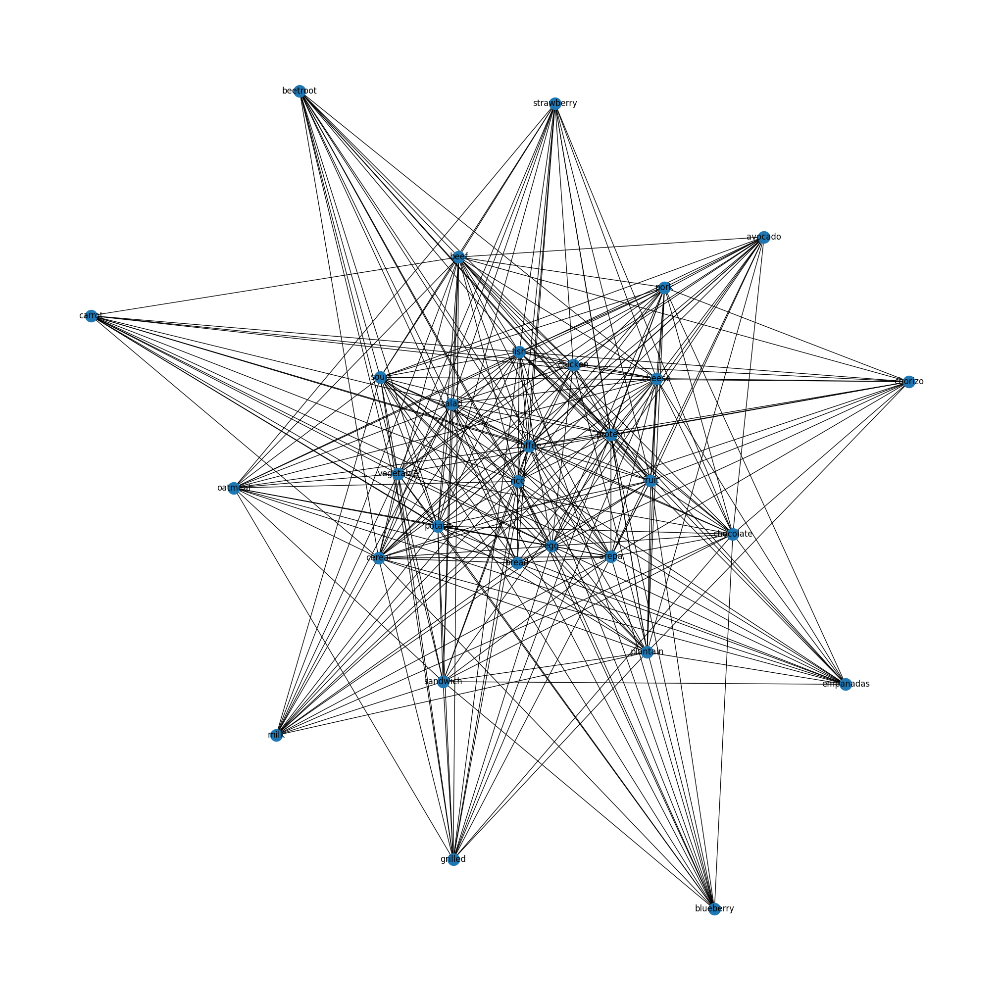

[[  0  26  78  13  13 247  13  91 117   0  91  26 312 234  26   0 260   0
   26   0   0   0 182 429   0 195 104  91   0   0]
 [ 26   0  12   0   0   0   0  14  18  44  14   0  48  36   0   0  40   0
    0   8  16  10  28   0  60  30  16  14   0  38]
 [ 78  12   0   6   0   0   6  42  54 132  42  12 144   0  12  66   0  12
   12  24   0  30  84 198 180  90  48  42  12   0]
 [ 13   0   6   0   0  19   0   7   9  22   0   0  24  18   0  11  20   0
    0   0   0   0  14  33  30  15   8   7   0  19]
 [ 13   0   0   0   0   0   0   7   0  22   7   0  24  18   0  11  20   0
    0   0   0   0  14  33  30  15   8   7   0  19]
 [247   0   0  19   0   0  19 133 171   0   0  38   0   0  38 209 380   0
   38  76 152   0   0   0 570 285   0 133  38   0]
 [ 13   0   6   0   0  19   0   7   9  22   0   0  24  18   0  11  20   0
    0   0   8   0  14   0  30  15   0   0   0  19]
 [ 91  14  42   7   7 133   7   0   0 154   0  14 168 126  14  77 140  14
   14  28  56  35   0   0   0 105   0   0  14 133]


In [ ]:
#cleaning and text preparation section -->
def clean_text(text):
    additional_stopwords = ['ve', 'we', 'overall', 'she', 'it', 'he', 'avoid',
                            'called', 'audition', 'adhere', 'after', 'brownie',
                            'apple', 'arepuelas']
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
all_network_labels = {} #dictionaty to keep all node lables
#functin to generate graphs
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 0.5:  # Probability for the edges.
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['noncarbonated','snack','source','accompanied','homemade','healthy','prefer','accompany','healty','pastry','fried','water','addition', 'afternoon', 'almost', 'alone', 'along', 'also', 'although', 'always', 'amount', 'another', 'anything', 'appetite', 'approximately', 'arepas', 'around', 'available', 'baby', 'back', 'balanced', 'based', 'basic', 'beverage', 'breakfast', 'breast', 'breastfeeding', 'carbohydrate', 'carnivorous', 'change', 'chickpea','choice', 'cola', 'cold', 'come', 'common', 'compared', 'complement', 'completely', 'consistent', 'consisting', 'consists', 'constant', 'consume', 'cooked', 'cookie', 'cooking', 'cooky', 'corn', 'could', 'course', 'crackling', 'cu', 'cucumber', 'cupcake', 'currently', 'cut', 'daily', 'dairy', 'decrease', 'depending', 'detrimental', 'diet', 'dinner', 'dish', 'dont', 'drink', 'eating', 'effort', 'either', 'eliminated', 'eliminating', 'else', 'empanada', 'emphasize', 'enjoy', 'especially', 'even', 'evening', 'every', 'everything', 'except', 'exclusively', 'fall', 'fast', 'favorite', 'feel', 'find', 'focus', 'focusing', 'follow', 'following', 'food', 'form', 'frequently', 'generally', 'going', 'good', 'grain', 'gram', 'grape', 'green', 'guava', 'habit', 'hardly', 'health', 'healthier', 'healthily', 'herbal', 'home', 'hour', 'house', 'hungry', 'hurry', 'improving', 'include', 'includes', 'including', 'increased', 'indulge', 'instance', 'intake', 'interestingly', 'item', 'juice', 'kind', 'known', 'lack', 'later', 'le', 'leftover', 'legume', 'level', 'light', 'lighter', 'like', 'liquid', 'little', 'lunch', 'lunchtime', 'made', 'main', 'mainly', 'maintain', 'make', 'many', 'mashed', 'maybe', 'meal', 'mean', 'meat', 'menu', 'method', 'midday', 'midmorning', 'might', 'missing', 'moderate', 'mogolla', 'morning', 'mostly', 'moving', 'much', 'night', 'normal', 'nowadays', 'oat', 'occasion', 'occasionally', 'often', 'option', 'packaged', 'pancake', 'pand', 'part', 'particular', 'passion', 'paste', 'peach', 'pear', 'penchant', 'pevery', 'piece', 'pineapple', 'plate', 'plenty', 'pof', 'possible', 'prepare', 'prepared', 'primarily', 'quick', 'quite', 'rarely', 'really', 'reason', 'reduced', 'refined', 'regular', 'regularly', 'rely', 'restaurant', 'restricting',  'scrambled', 'serving', 'significant', 'similar', 'since', 'situation', 'small', 'snacking', 'soda', 'solid', 'something', 'sometimes', 'sou' 'source', 'squash', 'start', 'started', 'steamed', 'stick', 'still', 'strict', 'strictly', 'substantial', 'sweet', 'taste', 'tend', 'though', 'three', 'throughout', 'time', 'toast', 'today', 'topped', 'towards', 'turn', 'type', 'typical', 'typically', 'unhealthy', 'urge', 'used', 'usual', 'usually', 'variation', 'variety', 'various', 'vary', 'way', 'week', 'well', 'white', 'without', 'work', 'would', 'year']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:30] #Select the top nodes
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20)) #Fig size
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
p1c = p1cons.apply(clean_text)
network1 = create_red(p1c, 'network1')


# Obtener y mostrar la matriz de adyacencia
adjacency_matrix = nx.adjacency_matrix(network1).toarray()
print(adjacency_matrix)


Now, this dictionary preints the nodes and its frequency in the graph. It helps to delete nodes.

In [ ]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network1)
dfx

,Node,Total Co-occurrence Frequency
23,protein,6765
24,rice,5700
12,coffee,5088
13,egg,4068
9,chicken,4004
16,fruit,3840
25,salad,3540
22,potato,2730
15,fish,2596
0,arepa,2574


This chunk of code helps to pas a list of strings and it converts it into a simple list of individual strings...

It is pretty usefull when deleting nodes is necessary

In [ ]:

texto = """
protein	7260
22	rice	6690
9	coffee	5712
10	egg	4320
29	vegetable	4199
4	bread	3895
12	fruit	3820
19	potato	3570
7	chicken	3476
25	snack	3025
11	fish	3003
23	salad	2745
2	arepa	2717
6	cheese	2313
5	cereal	1869
17	plantain	1840
8	chocolate	1491
24	sandwich	1464
3	beef	1410
26	soup	1386
18	pork	1030
15	oatmeal	896
27	source	712
0	accompanied	669
14	homemade	660
13	healthy	618
28	strawberry	574
20	prefer	558
1	accompany	540
16	pizza
"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

'protein','rice','coffee','egg','vegetable','bread','fruit','potato','chicken','snack','fish','salad','arepa','cheese','cereal','plantain','chocolate','sandwich','beef','soup','pork','oatmeal','source','accompanied','homemade','healthy','strawberry','prefer','accompany','pizza'


#1N

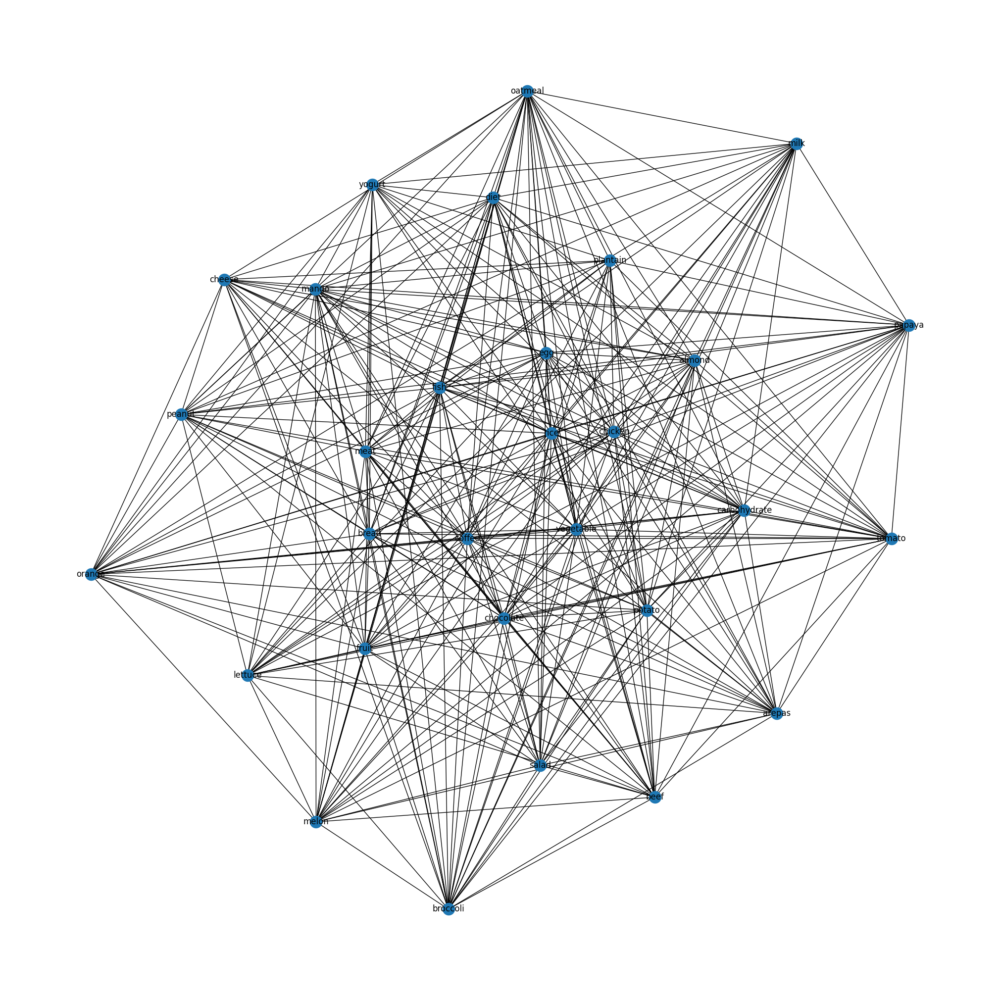

[[  0  28  28   0  21  56  49   0  91   0  42  98 105  70  42  35 119   0
   21  21   0   0   0   0  77 133  42  21 140  49]
 [ 28   0   0  80  12  32  28  76  52  76  24  56   0   0  24   0   0  16
    0  12  12  12  24   0  44  76  24  12  80   0]
 [ 28   0   0   0  12   0  28  76  52  76  24   0   0  40  24  20  68  16
    0  12  12  12  24  40  44  76  24  12  80   0]
 [  0  80   0   0  60   0 140 380 260   0 120   0 300 200 120 100 340  80
    0  60  60  60 120   0   0 380 120  60 400 140]
 [ 21  12  12  60   0  24  21  57  39  57   0   0  45  30  18  15  51  12
    9   9   0   9   0   0  33  57  18   0  60  21]
 [ 56  32   0   0  24   0  56 152 104 152  48 112 120  80   0  40   0  32
   24  24  24   0   0   0  88 152  48  24 160  56]
 [ 49  28  28 140  21  56   0   0  91 133  42  98 105  70   0  35   0   0
    0  21  21  21  42  70   0 133   0   0   0   0]
 [  0  76  76 380  57 152   0   0   0 361 114 266 285   0 114  95   0   0
   57  57  57  57   0 190 209   0   0  57   0 133]


In [ ]:
def clean_text(text):
    additional_stopwords = ['ve', 'we', 'overall', 'she', 'it', 'he', 'avoid',
                            'called', 'audition', 'adhere', 'after', 'brownie',
                            'apple', 'arepuelas']
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 0.5:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = [
'academic', 'accompanied','accompany', 'additionally', 'afternoon', 'along', 'also', 'although', 'always', 'animal', 'another', 'around', 'available', 'bar', 'based', 'basic', 'breakfast', 'broth', 'chickpea', 'class', 'consist', 'consisting', 'consists', 'consume', 'consumed', 'contain', 'cooky', 'corn', 'course', 'daily', 'dairy', 'delight', 'depending', 'depends', 'different', 'dinner', 'dish', 'diverse', 'dont', 'drink', 'early', 'eating', 'either', 'enjoy', 'evening', 'find', 'focus', 'followed', 'food', 'form', 'four', 'full', 'grain', 'granadilla', 'granola', 'green', 'home', 'hour', 'hunger', 'include', 'includes', 'including', 'incorporate', 'juice', 'kind', 'later', 'left', 'leftover', 'light', 'lighter', 'like', 'local', 'lunch', 'main', 'mandarin', 'meal', 'menu', 'midmorning', 'might', 'milkbased', 'morning', 'mostly', 'night', 'noon', 'nut', 'occasionally', 'often', 'option', 'otherwise', 'packaged', 'part', 'pea', 'piece', 'plain', 'plenty', 'portion', 'product', 'protein', 'pwith', 'raisin', 'rarely', 'regular', 'repeat', 'repeated', 'rest', 'right', 'room', 'routine', 'santafereño', 'scrambled', 'serving', 'side', 'similar', 'slice', 'small', 'smaller', 'snack', 'soda', 'something', 'sometimes', 'sou', 'soup', 'source', 'starch', 'start', 'studying', 'sweet', 'switch', 'though', 'three', 'throughout', 'time', 'toast', 'treat', 'turnover', 'type', 'typical', 'typically', 'university', 'usual', 'usually', 'varied', 'varies', 'variety', 'various', 'vary', 'well', 'whatever', 'wheat', 'whether', 'whole']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:30]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
p1n = p1noncons.apply(clean_text)
network1n = create_red(p1n, 'network1n')

# Obtener y mostrar la matriz de adyacencia
adjacency_matrix = nx.adjacency_matrix(network1n).toarray()
print(adjacency_matrix)

In [ ]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network1n)
dfx

,Node,Total Co-occurrence Frequency
25,rice,3876
9,coffee,3724
28,vegetable,3600
3,bread,3580
12,fish,3360
16,meat,2805
7,chicken,2793
11,egg,2758
8,chocolate,2730
24,potato,1771


In [ ]:
# Texto proporcionado
texto = """
15	melon	992
1	bean	992
8	cucumber	992
2	beef	992
"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

'melon','bean','cucumber','beef'


#P2-CHARACTERISTICS AND PREFERENCES

In [ ]:
p2cons= compared['P2-CHARACTERISTICS AND PREFERENCES-CONS'].astype(str)
p2noncons= compared['P2-CHARACTERISTICS AND PREFERENCES-NONCONS'].astype(str)

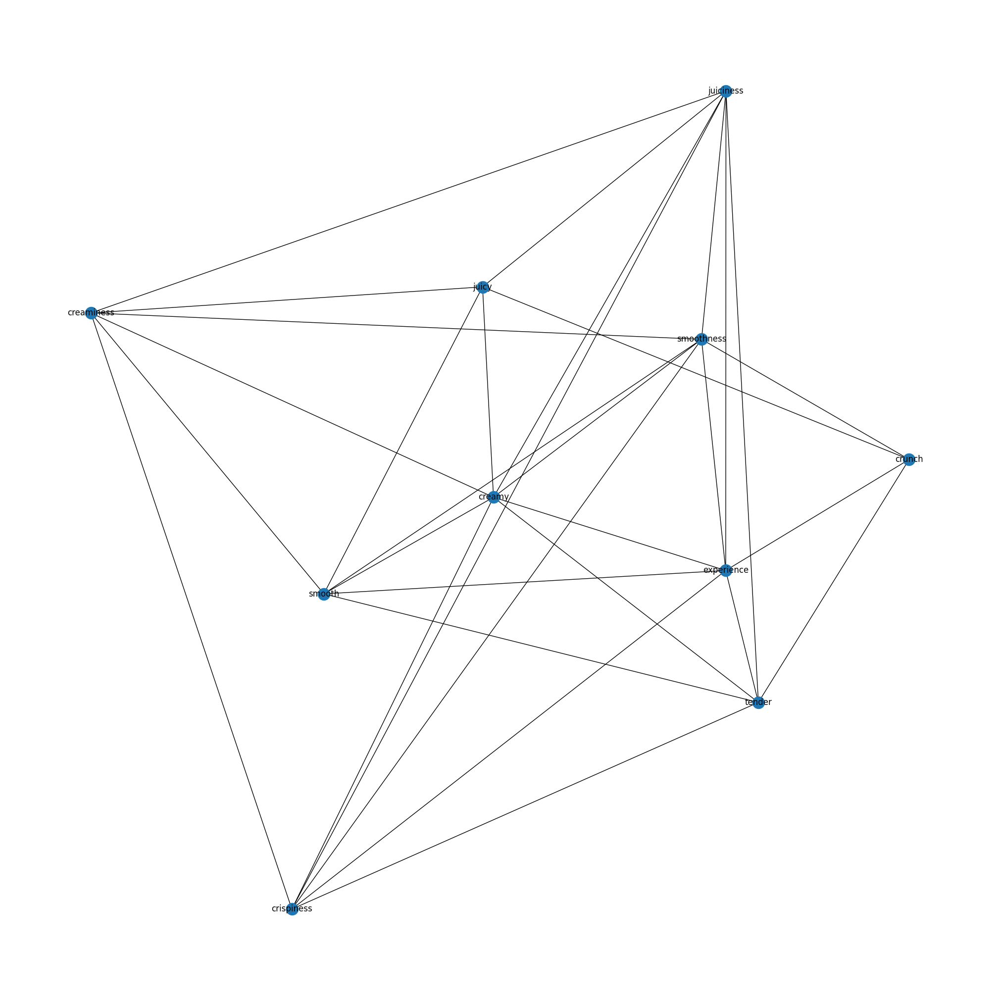

In [ ]:
def clean_text(text):
    additional_stopwords = []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 0.5:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['sweet','equilibrium','escape','everevolving','everexpanding','excites','enrich','expand','expectation','expedition','experiencing','experiment','explored','enriches','enhances','greasy','edible','dynamic','eager','eagerly','easy','ecstasy','edge','effect','enhance','egg','elevate','elevates','encountered','end','enduring','explorer','explosion','exquisite','gain','fork','fortunate','fracture','french','fry','full','gateway','extra','glide','global','go','goldenhued','graced','grease','fondness','foam','flood','flesh','finding','fillet','fiery','fettuccine','fattening','fascination','fascinating','farmer','familiar','fails','exudes','extremely','extraaged','zucchini','flavor','flaky','tactile','tahini','creative','wanted','universal','wall','voyage','vitality','vital','vendor','vast','vary','varies','varied','used','upon','unveil','universe','teeth','tasted','tangible','seasoned','side','shrimp','shredded','shred','sheer','shatters','share','served','sensorial','sense','seemingly','seem','seeing','seared','simply','scrambled','satisfy','sampling','sample','samosa','salty','salt','said','rough','rolled','roll','role','roasted','simple','single','taken','steak','sure','supple','sunsoaked','summary','succulence','substantial','sublime','strength','strand','story','stimulating','stew','step','state','slip','starting','stall','stage','spring','spread','spark','southeast','soup','snap','matter','small','slowly','maybe','ability','match','coating','city','clear','cling','clinging','coated','cold','chicharrón','colombi','companion','complexity','condiment','connecting','chickpea','chewy','consider','cause','cacophony','captivated','caramel','carbonara','carrot','case','celebration','chewiness','challenge','champion','change','char','cheddar','chef','connection','constant','dissolve','delectable','culminates','curious','dairy','deconstructed','deeply','defies','deliver','depends','derive','described','design','designed','desire','crystalline','crumbles','constantly','course','consumption','continue','continuing','control','cooling','corner','couscous','croissant','cracker','crackle','crackling','cradle','craftsm','creation','butterscotch','butter','bustling','appreciate','alone','although','amalgamation','angel','animalbased','approach','almond','approached','arepa','aroma','around','artisanal','artistry','almost','allure','bursting','addition','absorbing','accompanied','accompany','acidic','adapts','added','additional','allows','admit','adore','adorned','alive','all','allow','asia','assortment','avenue','brewery','blueberry','body','bold','bound','boundary','bowl','bridge','await','bright','brilliance','brings','brown','build','burger','black','beyond','beverage','best','beneath','beloved','believe','begin','become','beckon','beautifully','bar','banana','balanced','baguette','away','awakens','digestible','dog','master','innovation','impression','indulge','indulgence','infinity','infused','initial','innovative','imagine','insatiable','inspiration','instead','integrity','intense','international','important','iconic','intertwines','harm','guess','guilty','gustatory','hair','hand','happening','harmonizes','hummus','healthy','hedonistic','heirloom','hibiscus','home','honey','absolutely','intrigue','dream','local','light','lightness','liking','lingers','linguine','little','loses','leaving','lover','luxurious','maintaining','malaysi','mango','marbling','legume','le','intriguingly','joy','introduce','introduces','invite','itself','jam','japanese','juice','latin','kill','kind','kore','laksa','landscape','lasting','ground','green','greatest','excite','enthusiasm','entices','choice','immense','surprise','chip','practically','tangy','tantalizes','technique','spoonful','indi','preparation','coulis','steamed','ignites','surprising','coconut','combining','reveal','coming','complement','surrounded','homemade','strong','consume','street','strawberry','cookie','core','could','perfect','intertwine','spectacular','prepared','reason','embark','embodiment','first','filling','regarding','satisfaction','enthusiast','feast','ethereal','even','release','exciting','exotic','falafel','resistance','robust','experimentation','extraordinary','right','expression','ready','raspberry','quickly','prime','curiosity','custard','daring','tempura','pressure','snack','delivers','delve','dente','profile','earthy','profound','slight','dimension','discovering','discovery','diversity','divine','silkiness','drizzle','decadence','cocktail','revel','middle','amaze','beckons','noodle','beef','beer','uncharted','irresistible','inviting','twist','invigorating','moist','truly','blend','nourishment','lime','versatility','triple','bechamel','beauty','america','multisensory','mood','vinaigrette','vinegar','various','another','molten','animal','awaken','need','junk','back','unfolds','balsamic','challenging','bean','molecular','mind','boasting','vibrant','territory','think','melt','within','toasted','indulgent','wine','touch','additionally','marinated','catch','white','wonder','melting','cease','aged','breast','term','boundless','ajiaco','tenderness','market','intricate','captivates','quest','ramen','push','meaty','retaining','punctuated','region','rarely','related','miso','meringue','mixology','moderate','regional','modern','recipe','resonates','merge','remain','remains','remind','melted','reduce','reminder','pastry','protagonist','open','oasis','picturesque','obtained','picture','personally','occasional','perhaps','offering','olive','perceive','opened','mondongo','ordinary','oregano','paella','palatability','pancetta','paradise','penne','particular','pear','patty','pizza','place','playfulness','nuance','moroccaninspired','promise','morsel','mosaic','product','probably','mostly','mouthful','must','presented','presence','next','north','prepare','nostalgia','preference','poorly','pomegranate','point','novel','pleased','myriad','smell','revelation','river','undertake','understand','uncovered','unadulterated','ultimately','turning','turn','truck','trove','trip','trigger','tribute','treat','traveler','trattorias','transformed','tradition','totally','tossed','tooth','titillate','tingling','time','thrill','though','thick','thai','tend','tempting','undisputed','unfolding','unforgettable','weekend','yielding','would','wonderful','without','wide','whisk','whirlwind','whipped','wellseasoned','wellprepared','wellcrafted','welfare','weight','like','food','taste','bite','every','culinary','chicken','pasta','really','meat','sauce','also','fruit','dish','journey','world','cheese','offer','adventure','delight','come','chocolate','symphony','cuisine','palate','enjoy','contrast','fresh','testament','favorite','fusion','different','realm','endless','sens','salad','sensory','delightful','dont','mouth','exterior','interplay','satisfying','embrace','unique','protein','create','velvety','something','canvas','exploring','add','love','richness','ingredient','marriage','meal','hamburger','feel','never','refreshing','milk','natural','magic','possibility','perfectly','bud','layer','soft','rice','interior','together','color','savory','fish','find','exploration','balance','crisp','creating','thing','captivating','itali','take','delicate','playground','mushroom','many','make','lie','savor','harmonious','buttery','slightly','excitement','example','diverse','dessert','fast','essence','yield','becomes','well','matching','appeal','curry','spaghetti','adding','dance','vegetable','spice','especially','pleasure','lettuce','tomato','burst','masterpiece','combined','relish','prefer','juxtaposition','know','culture','opportunity','plate','blue','creates','cake','unexpected','cream','meet','gastronomy','much','pure','explore','crust','taco','delicious','making','mashed','marvel','releasing','sushi','bliss','variety','depth','dense','tart','whether','unknown','tantalizing','life','tapestry','crouton','trying','keep','array','baked','general','gelatinous','garlic','way','shell','found','ginger','avocado','form','attention','skin','flavorful','baking','sometimes','anticipation','always','result','dressing','succulent','ripe','sancocho','anything','give','seafood','apple','everything','bandeja','golden','source','rich','firm','provide','parmes','trout','paisa','pairing','textural','center','nut','presentation','connects','thrilling','treasure','comforting','nature','chew','transport','brittle','potato','umami','nothing','pleasant','nutty','tongue','contrasting','brie','cooking','mediterrane','tasty','work','true','craft','medley','truffle','caress','cooked','grainy','play','appreciation','accompanying','waiting','grape','platter','achieved','freshness','seeking','seed','gooey','peach','hard','nuttiness','savoring','harmony','health','flakiness','heart','gouda','silky','good','zing','freshly','fuel','paramount','zest','sharpness','short','showcase','part','gentle','paired','passion','pair','forget','gift','overall','plantain','zesty','weakness','orchestra','watermelon','hearty','salsa','satisfyingly','range','lava','moment']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:10]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
p2c = p2cons.apply(clean_text)
network2 = create_red(p2c, 'network2')

In [ ]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network2)
dfx

,Node,Total Co-occurrence Frequency
1,creamy,1386
4,experience,1200
3,crunch,988
9,tender,910
6,juicy,885
7,smooth,858
8,smoothness,624
0,creaminess,464
5,juiciness,243
2,crispiness,198


In [ ]:
# Texto proporcionado
texto = """

"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

In [ ]:
#print("Nodos en red3:", network2.nodes())

#2N

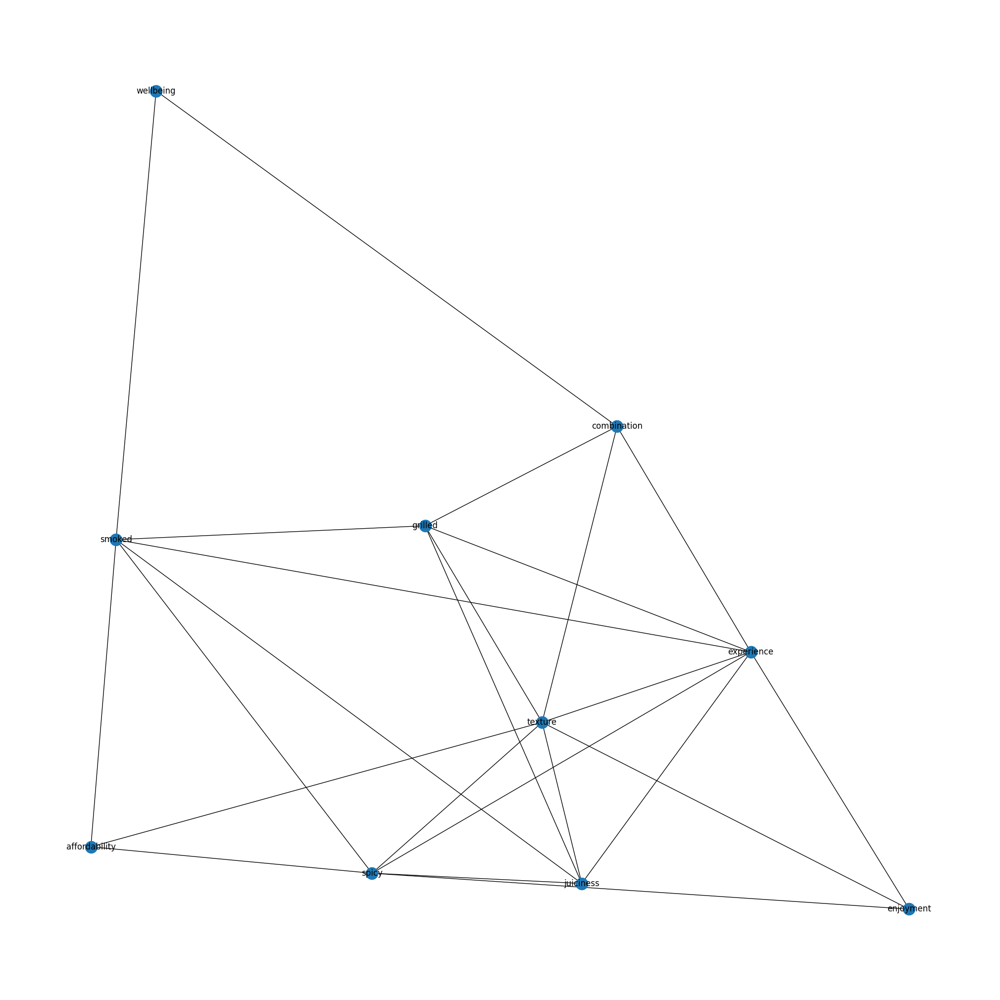

In [ ]:
def clean_text(text):
    additional_stopwords =  []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 0.5:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['sweet','lead','includes','inconvenience','increasing','incredible','indispensable','influence','lieu','infusing','ingenuity','ingestion','lesser','lane','integrate','investing','invigorate','involves','hydrated','leaf','leading','key','kitchen','illness','however','hungry','happiness','fond','fortifying','foster','fully','furnish','gastronomic','giving','goto','grand','guidance','guided','harbor','hungerinduced','heavenly','heavy','heightened','heritage','high','higher','hint','list','hue','hued','lingering','magical','loving','loyalty','primarily','process','proclivity','profusion','promoting','prompting','provides','pursuit','pwith','quite','rather','receive','saucy','skeletal','sumptuousness','supersedes','supporting','susceptible','sustain','thereby','thread','threequarters','preclude','precedence','power','mitigation','favor','mainly','malady','manifest','memory','mentioned','meticulous','midst','mindfulness','mine','mitigate','moisture','nutritional','mom','mouthwatering','mucilaginous','multiplicity','muscle','natto','navigate','nearterm','negative','neurological','notice','comfort','broad','buying','caloric','cardiovascular','category','catering','celebrated','celebrating','chameleonlike','charting','chilly','common','fare','companionship','compared','complemented','component','concoction','confection','conjures','consistently','constituent','constitutes','contain','contribute','bring','boost','boon','block','achieving','acid','adequate','advantage','adverse','affording','affords','agree','akin','allowing','alltime','along','amidst','amount','amplification','animosity','anticipate','appetite','area','artistic','augment','avert','aware','bear','better','conversely','cornerstone','efficient','effortlessly','elevated','elevating','embracing','emerge','emerges','enables','encapsulates','encompass','endeavor','enhanced','enough','ensure','ensures','ensuring','entail','escapade','everyday','evident','excellent','exceptional','excessive','exerts','expect','accentuated','efficiently','efficiency','echo','dancing','debate','decision','definitely','deleterious','derived','detrimental','developing','difference','diminish','disagree','dislike','distinct','distinctive','dividend','drastically','drawing','drawn','drinking','drop','earn','easytoeat','facet','diet','fat','essential','risk','grain','bone','carbohydrate','function','quality','energy','dietary','nutrient','juicy','eating','disease','help','salmon','consuming','vitamin','mojarra','mineral','nutritious','one','fatty','lentil','pea','towards','system','broccoli','daily','proper','whole','chronic','saturated','sugar','brain','diabetes','water','often','mental','intake','enjoyable','benefit','portion','fiber','improve','stand','size','inclination','worth','impact','hydration','day','processed','pumpkin','cook','crucial','furthermore','fried','repair','pivotal','functioning','avoiding','among','seasoning','melon','unwanted','solid','mandarin','maintain','squash','arroz','avoid','level','digestion','lasagna','bodily','element','pollo','inherent','pork','calorie','significant','extends','refined','formation','foremost','equal','firstly','resist','excess','remember','importance','fundamental','physical','lifestyle','linchpin','liquid','longterm','manifold','organ','might','option','opting','moderation','moreover','mother','necessary','neurodegenerative','oat','notwithstanding','nourishing','people','issue','great','informed','growth','habit','promote','probiotic','hold','prevent','immune','imperative','implication','preferred','including','incorporate','increase','incredibly','individual','indulging','effort','nutrition','created','amazing','underestimate','undesirable','unhealthy','controlling','summation','corn','counterpart','coupled','crafted','crave','craving','structure','unprocessed','antioxidant','dehydration','beneficial','constipation','consists','chewing','tissue','throughout','busy','building','broth','cherished','coffee','blood','cognitive','text','tender','bounty','type','talk','viscous','trans','sourced','active','warmth','speaking','advance','digestive','softer','adaptability','disorder','sodium','slippery','despite','slimy','adopting','effectively','adopt','offered','personal','pesky','unappealing','unbeatable','pillar','occupy','planning','tug','trust','offputting','occasion','plethora','wholesome','obviate','plus','wield','winwin','transformative','transform','posed','penchant','vivid','undeniable','okra','vibrantly','want','outcome','outlet','versatile','overconsumption','unwelcome','optimal','overly','operation','warms','overstated','unpleasant','overwhelming','position','onthego','packed','paradigm','onset','partaking','unparalleled','wellrounded','particularly','omega','patacones','underestimated','paying','tends','traditional','resorting','resolve','residue','requisite','require','stabilization','replete','repast','stable','staying','render','steadfast','steaming','steer','regimen','resort','spectrum','potential','special','situation','significance','sidestep','shortterm','shame','serve','sensation','select','seek','soothing','sou','soul','sound','routine','rival','steering','strike','reducing','substance','prevalent','preserving','preservation','present','preparing','tandem','prepackaged','teeming'
,'equilibrium','escape','everevolving','everexpanding','excites','enrich','expand','expectation','expedition','experiencing','experiment','explored','enriches','enhances','greasy','edible','dynamic','eager','eagerly','easy','ecstasy','edge','effect','enhance','egg','elevate','elevates','encountered','end','enduring','explorer','explosion','exquisite','gain','fork','fortunate','fracture','french','fry','full','gateway','extra','glide','global','go','goldenhued','graced','grease','fondness','foam','flood','flesh','finding','fillet','fiery','fettuccine','fattening','fascination','fascinating','farmer','familiar','fails','exudes','extremely','extraaged','zucchini','flavor','flaky','tactile','tahini','creative','wanted','universal','wall','voyage','vitality','vital','vendor','vast','vary','varies','varied','used','upon','unveil','universe','teeth','tasted','tangible','seasoned','side','shrimp','shredded','shred','sheer','shatters','share','served','sensorial','sense','seemingly','seem','seeing','seared','simply','scrambled','satisfy','sampling','sample','samosa','salty','salt','said','rough','rolled','roll','role','roasted','simple','single','taken','steak','sure','supple','sunsoaked','summary','succulence','substantial','sublime','strength','strand','story','stimulating','stew','step','state','slip','starting','stall','stage','spring','spread','spark','southeast','soup','snap','matter','small','slowly','maybe','ability','match','coating','city','clear','cling','clinging','coated','cold','chicharrón','colombi','companion','complexity','condiment','connecting','chickpea','chewy','consider','cause','cacophony','captivated','caramel','carbonara','carrot','case','celebration','chewiness','challenge','champion','change','char','cheddar','chef','connection','constant','dissolve','delectable','culminates','curious','dairy','deconstructed','deeply','defies','deliver','depends','derive','described','design','designed','desire','crystalline','crumbles','constantly','course','consumption','continue','continuing','control','cooling','corner','couscous','croissant','cracker','crackle','crackling','cradle','craftsm','creation','butterscotch','butter','bustling','appreciate','alone','although','amalgamation','angel','animalbased','approach','almond','approached','arepa','aroma','around','artisanal','artistry','almost','allure','bursting','addition','absorbing','accompanied','accompany','acidic','adapts','added','additional','allows','admit','adore','adorned','alive','all','allow','asia','assortment','avenue','brewery','blueberry','body','bold','bound','boundary','bowl','bridge','await','bright','brilliance','brings','brown','build','burger','black','beyond','beverage','best','beneath','beloved','believe','begin','become','beckon','beautifully','bar','banana','balanced','baguette','away','awakens','digestible','dog','master','innovation','impression','indulge','indulgence','infinity','infused','initial','innovative','imagine','insatiable','inspiration','instead','integrity','intense','international','important','iconic','intertwines','harm','guess','guilty','gustatory','hair','hand','happening','harmonizes','hummus','healthy','hedonistic','heirloom','hibiscus','home','honey','absolutely','intrigue','dream','local','light','lightness','liking','lingers','linguine','little','loses','leaving','lover','luxurious','maintaining','malaysi','mango','marbling','legume','le','intriguingly','joy','introduce','introduces','invite','itself','jam','japanese','juice','latin','kill','kind','kore','laksa','landscape','lasting','ground','green','greatest','excite','enthusiasm','entices','choice','immense','surprise','chip','practically','tangy','tantalizes','technique','spoonful','indi','preparation','coulis','steamed','ignites','surprising','coconut','combining','reveal','coming','complement','surrounded','homemade','strong','consume','street','strawberry','cookie','core','could','perfect','intertwine','spectacular','prepared','reason','embark','embodiment','first','filling','regarding','satisfaction','enthusiast','feast','ethereal','even','release','exciting','exotic','falafel','resistance','robust','experimentation','extraordinary','right','expression','ready','raspberry','quickly','prime','curiosity','custard','daring','tempura','pressure','snack','delivers','delve','dente','profile','earthy','profound','slight','dimension','discovering','discovery','diversity','divine','silkiness','drizzle','decadence','cocktail','revel','middle','amaze','beckons','noodle','beef','beer','uncharted','irresistible','inviting','twist','invigorating','moist','truly','blend','nourishment','lime','versatility','triple','bechamel','beauty','america','multisensory','mood','vinaigrette','vinegar','various','another','molten','animal','awaken','need','junk','back','unfolds','balsamic','challenging','bean','molecular','mind','boasting','vibrant','territory','think','melt','within','toasted','indulgent','wine','touch','additionally','marinated','catch','white','wonder','melting','cease','aged','breast','term','boundless','ajiaco','tenderness','market','intricate','captivates','quest','ramen','push','meaty','retaining','punctuated','region','rarely','related','miso','meringue','mixology','moderate','regional','modern','recipe','resonates','merge','remain','remains','remind','melted','reduce','reminder','pastry','protagonist','open','oasis','picturesque','obtained','picture','personally','occasional','perhaps','offering','olive','perceive','opened','mondongo','ordinary','oregano','paella','palatability','pancetta','paradise','penne','particular','pear','patty','pizza','place','playfulness','nuance','moroccaninspired','promise','morsel','mosaic','product','probably','mostly','mouthful','must','presented','presence','next','north','prepare','nostalgia','preference','poorly','pomegranate','point','novel','pleased','myriad','smell','revelation','river','undertake','understand','uncovered','unadulterated','ultimately','turning','turn','truck','trove','trip','trigger','tribute','treat','traveler','trattorias','transformed','tradition','totally','tossed','tooth','titillate','tingling','time','thrill','though','thick','thai','tend','tempting','undisputed','unfolding','unforgettable','weekend','yielding','would','wonderful','without','wide','whisk','whirlwind','whipped','wellseasoned','wellprepared','wellcrafted','welfare','weight','like','food','taste','bite','every','culinary','chicken','pasta','really','meat','sauce','also','fruit','dish','journey','world','cheese','offer','adventure','delight','come','chocolate','symphony','cuisine','palate','enjoy','contrast','fresh','testament','favorite','fusion','different','realm','endless','sens','salad','sensory','delightful','dont','mouth','exterior','interplay','satisfying','embrace','unique','protein','create','velvety','something','canvas','exploring','add','love','richness','ingredient','marriage','meal','hamburger','feel','never','refreshing','milk','natural','magic','possibility','perfectly','bud','layer','soft','rice','interior','together','color','savory','fish','find','exploration','balance','crisp','creating','thing','captivating','itali','take','delicate','playground','mushroom','many','make','lie','savor','harmonious','buttery','slightly','excitement','example','diverse','dessert','fast','essence','yield','becomes','well','matching','appeal','curry','spaghetti','adding','dance','vegetable','spice','especially','pleasure','lettuce','tomato','burst','masterpiece','combined','relish','prefer','juxtaposition','know','culture','opportunity','plate','blue','creates','cake','unexpected','cream','meet','gastronomy','much','pure','explore','crust','taco','delicious','making','mashed','marvel','releasing','sushi','bliss','variety','depth','dense','tart','whether','unknown','tantalizing','life','tapestry','crouton','trying','keep','array','baked','general','gelatinous','garlic','way','shell','found','ginger','avocado','form','attention','skin','flavorful','baking','sometimes','anticipation','always','result','dressing','succulent','ripe','sancocho','anything','give','seafood','apple','everything','bandeja','golden','source','rich','firm','provide','parmes','trout','paisa','pairing','textural','center','nut','presentation','connects','thrilling','treasure','comforting','nature','chew','transport','brittle','potato','umami','nothing','pleasant','nutty','tongue','contrasting','brie','cooking','mediterrane','tasty','work','true','craft','medley','truffle','caress','cooked','grainy','play','appreciation','accompanying','waiting','grape','platter','achieved','freshness','seeking','seed','gooey','peach','hard','nuttiness','savoring','harmony','health','flakiness','heart','gouda','silky','good','zing','freshly','fuel','paramount','zest','sharpness','short','showcase','part','gentle','paired','passion','pair','forget','gift','overall','plantain','zesty','weakness','orchestra','watermelon','hearty','salsa','satisfyingly','range','lava','moment']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:10]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
p2n = p2noncons.apply(clean_text)
network2n = create_red(p2n, 'network2n')

In [ ]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network2n)
dfx

,Node,Total Co-occurrence Frequency
8,texture,360
3,experience,108
7,spicy,99
5,juiciness,93
1,combination,84
4,grilled,64
0,affordability,52
2,enjoyment,52
6,smoked,48
9,wellbeing,18


In [ ]:
# Texto proporcionado
texto = """

"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

In [ ]:

#print("Nodos en red4:", network2n.nodes())


#P3- CHARACTERISTICS OF NON-PREFERRED FOODS-CONS'

In [ ]:
p3cons= compared['P3- CHARACTERISTICS OF NON-PREFERRED FOODS-CONS'].astype(str)
p3noncons= compared['P3- CHARACTERISTICS OF NON-PREFERRED FOODS-NONCONS'].astype(str)

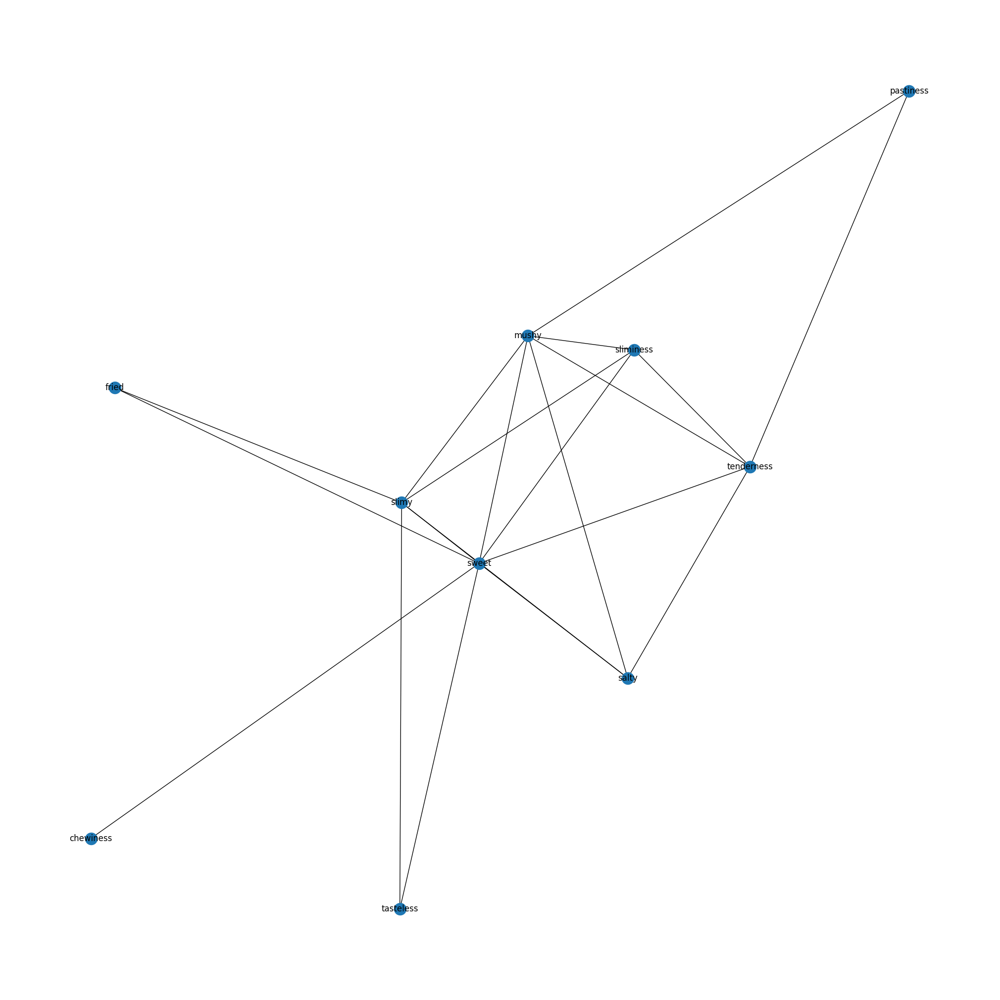

In [ ]:
def clean_text(text):
    additional_stopwords = []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 0.8:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['ecofriendly','crispness','crunch','familiarity','crisp','crispy','insect','sensation','smell','taste','flavor','texture','heightens','hesitate','hidden','hint','however','luster','cream','create','creating','cringe','culprit','dancing','daring','deeper','defies','distinct','distinction','diverge','engaging','enjoyment','enrich','entered','enthusiasm','enthusiast','enthusiastic','entice','enticing','entity','entomophagous','entranced','escapade','eschew','essential','etching','everevolving','evident','enigma','enduring','dog','endure','dominion','doubleedged','each','eager','echo','echoing','edge','egg','elaborate','elicits','else','embarked','encapsulated','encountered','encountering','ended','conspire','conjure','planet','back','ardent','arm','ascended','asserting','attention','attuned','audacious','awaken','backdrop','concoction','ball','barrier','base','basically','becomes','beetroot','behind','being','approach','appetizer','appearance','apart','abrasive','accept','accompanied','adventurous','adversary','adversity','aficionado','aftertaste','alien','align','ally','alone','already','always','anew','another','anymore','belies','best','beyond','celebrated','chance','chapter','character','cherished','chicken','chorus','cloud','colombi','combined','comforting','companion','completely','complexity','compose','composing','composition','celebration','celebrate','biggest','cautious','biting','blend','bling','boast','bocadillo','bordering','brick','bringing','broaden','burst','cabbage','captivated','capture','caress','carousel','cat','cauldron','evokes','evolved','evolving','minuscule','meaning','medley','memory','mention','mere','meticulously','mind','minimal','mirror','exchange','mojojoy','morph','morphed','morsel','mosaic','mouse','move','mayonnaise','maximum','match','masquerade','intrigued','intriguing','introduced','introduces','invoke','journeyed','kicker','lacking','later','lend','lettuce','lie','light','longing','abound','marked','marvel','munch','name','narrator','overly','parasite','participant','particular','path','patron','pattern','pausing','pave','peating','pedestal','people','perception','pfor','pineapple','pioneer','pizza','plain','paradox','natural','organ','neither','nonconsumers','nostalgia','note','nutritional','obligation','obviously','occasionally','odor','offputting','okay','one','onion','openmindedness','opportunity','or','orb','intrigue','intricate','intertwined','flit','follow','follows','foray','forced','forever','fragment','fragmentation','fruit','gastronomy','give','glassy','glide','good','goodness','grand','grappling','folk','fleeting','great','finger','excited','excitement','exciting','exist','expected','explain','extends','exudes','eye','familiar','fascination','fault','favorite','fear','feeling','figure','grayish','grew','interaction','illuminated','immediately','imparting','incredible','individual','indulgence','influence','infuse','ingredient','inherent','initial','initially','insectfood','instance','instead','insurmountable','intention','imagine','idea','grou','ibias','guess','guest','guinea','gusto','hand','handle','happen','happened','hard','headfirst','headscratcher','heavy','unite','canvas','beet','carrot','carry','cartilage','overbearing','problem','tolerate','together','dismiss','yeah','curiosity','distinctive','diving','redefined','drawn','refusing','ecoconscious','yielded','embraced','embracing','adorned','yielding','relinquish','endless','meltinthemouth','melon','melodious','enigmatic','enjoy','subtle','distaste','moment','dish','mouth','tiny','delicacy','anything','myriad','thought','range','deter','persistence','upon','aligns','tenaciously','mostly','intestinal','rhythm','poorly','plea','precursor','potent','predisposes','preferred','pleasant','rib','pof','preparation','prefer','rich','rice','revel','revelation','posse','resounding','reluctance','resonates','rabbit','reminiscent','rather','reminding','ready','real','reason','recoil','remembered','regular','relationship','remains','release','remaining','relinquished','relish','rapid','quite','resonate','quickly','pretty','prickly','resists','proceed','product','resilience','proteinpacked','prove','provided','provides','pungent','put','residue','quail','quick','proving','splendor','ripe','triumphant','transition','traversing','treat','tree','tricky','tried','trip','trust','transcends','tugging','ultimately','unabating','uncanny','unconventional','uncovered','uncovers','transient','trade','undertaken','thrill','tension','tentative','term','territory','thigh','though','threshold','thrive','tough','throatscratchers','throne','told','tomato','tongue','took','torment','understand','unease','tenacity','willingness','warm','went','whatever','whenever','whiff','wholeheartedly','wild','wind','waiting','worm','worry','woven','yang','yearning','yogurt','young','want','vivid','unexplored','unspoken','unfamiliar','unfurls','union','unites','unless','unrest','unseen','unwilling','vibrant','usually','varied','variety','velvety','venturing','verge','vibrancy','tender','tempting','robustness','signal','seriously','served','shake','shatters','shiver','shudder','shun','skepticism','sensory','slickness','slide','slip','slipperiness','slurper','snake','softness','serf','sends','solidity','savior','role','sail','sardine','satiate','satisfaction','satisfy','saving','scare','sell','screw','seafood','secret','seeking','seem','seemed','seems','solid','someone','temperament','symbol','surface','surrender','sushi','sustainability','sustainable','swallow','sword','takeaway','subtlety','taken','tantalizes','tasted','teeter','tell','telling','superhero','struggle','sonata','spinning','sou','soul','sound','source','specifically','spell','spine','plate','strike','started','steadfast','step','still','stimulate','stimulates','stopped','play','ability','plantbased','difficult','depending','derivative','despite','deterrent','detest','developed','devotee','dichotomy','digestion','conjures','dimension','disappointment','disciple','discordant','discovered','disdain','dissolve','distant','depend','demeanor','delightful','defy','consumed','contemplation','contradiction','converge','conviction','could','countless','crab','like','dont','food','culinary','journey','world','palate','bite','also','might','find','mashua','tapestry','tuber','thing','salad','experience','preference','something','aversion','every','tactile','sometimes','snack','diverse','realm','vegetable','embrace','symphony','entomophagy','adventure','offer','cuisine','strong','soup','aroma','challenge','tamarillo','cucumber','beckon','gelatinous','pasty','landscape','nature','even','certain','perspective','exploration','testament','color','think','lentil','chocolate','carnival','childhood','delight','feel','really','dislike','bud','narrative','unique','packaged','combination','often','either','international','meat','story','cooked','consume','possibility','pepper','whole','appreciate','dance','savory','table','banana','become','bell','milk','resistance','reminder','eating','juice','delicate','glossy','contrast','little','fig','chewy','challenging','come','friend','throat','time','make','take','pressure','satisfying','within','well','alternative','almost','beauty','kind','staple','sens','allure','animal','many','spectrum','akin','ride','discomfort','explore','sense','potato','exotic','maybe','exoskeleton','especially','lingers','reluctant','essence','creature','much','encounter','diversity','digest','thrilling','mainly','soft','redefine','finding','tale','evolution','different','stew','everything','emerges','navigate','substantial','others','unknown','hold','leaving','shiny','shimmering','unfolds','arracacha','wellprepared','scratchy','leave','identity','called','shape','learned','gustatory','peculiar','away','seek','serve','bring','unpleasant','harmonious','blood','unsung','harmony','kaleidoscope','bitter','part','presence','savor','hero','iridescent','clinging','line','robust','yield','consistency','insectbased','nutrition','fragrance','puree','pork','sipper','gastronomic','would','chew','cling','inviting','anticipation','open','appeal','level','gentle','strange','home','interplay','horizon','remain','issue','innovation','iridescence','humble','scratching','stir','linger','maestro','know','example','lingering','forget','form','formidable','fine','found','fret','slightest','life','structure','fervor','gateway','general','liver','long','simmering','grace','longer','look','grip','made','shimmer','exploring','slurpers','leaf','lead','stand','lack','yucca','discovery','right','critter','balance','unassuming','waltz','wanting','comfort','subcutaneous','provoke','obscure','weave','traverse','welcome','transit','novelty','transformation','nothing','traditional','convention','traded','armor','quest','country','prepared','quirk','uncharted','protein','promise','brittle','passion','present','bland','unveil','papaya','bowl','boyac','past','paint','brings','brittleness','pate','broccoli']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:10]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
# Aplicar la función clean_text a la copia de la columna
p3c = p3cons.apply(clean_text)
network3 = create_red(p3c, 'network3')

In [ ]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network3)
dfx

,Node,Total Co-occurrence Frequency
7,sweet,180
6,slimy,126
2,mushy,75
9,tenderness,54
4,salty,44
5,sliminess,44
1,fried,16
8,tasteless,16
3,pastiness,12
0,chewiness,9


In [ ]:
# Texto proporcionado
texto = """

"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

#3N

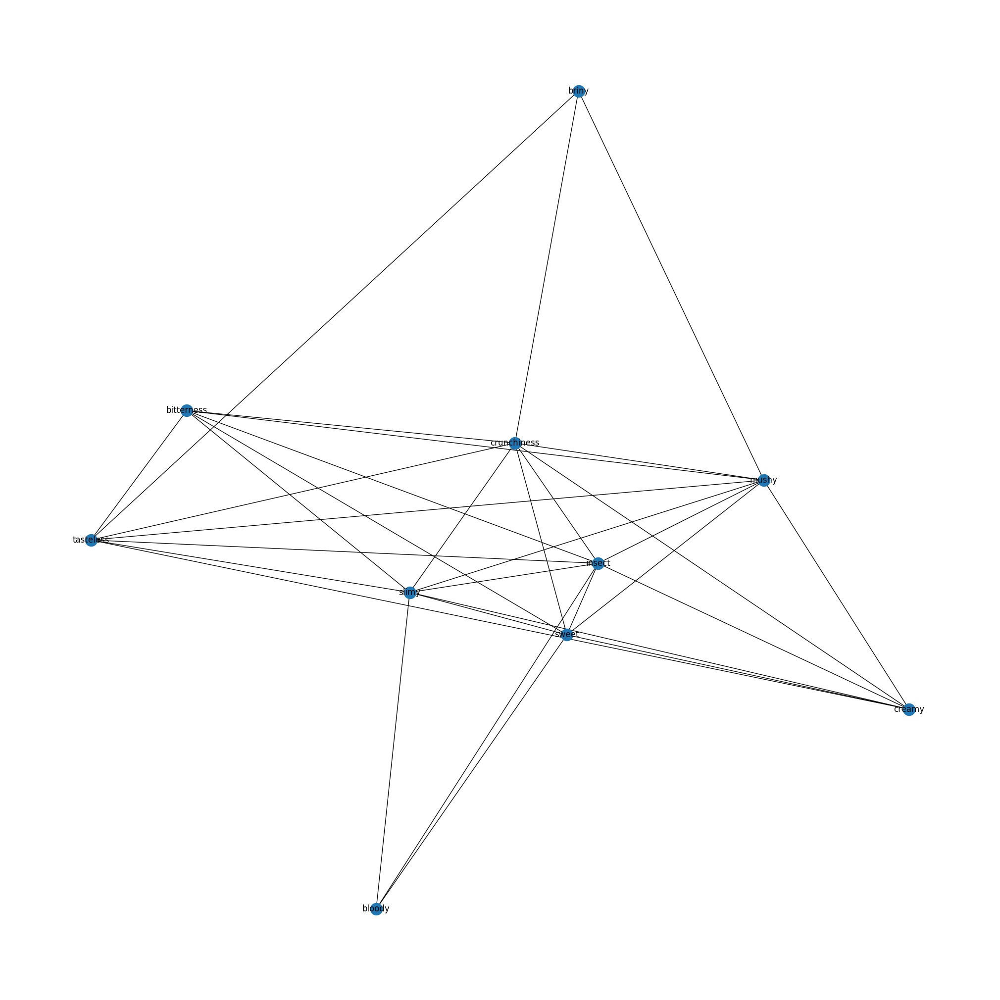

In [ ]:
def clean_text(text):
    additional_stopwords =  []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 0.8:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['familiarity','crisp','crispy','sensation','smell','taste','flavor','texture','consuming','avoid','chinese','fish','list','liking','trying','pumpkin','tend','shrimp','thanks','option','particularly','matter','pas','coffee','unappetizing','type','lechona','veggie','intestine','interest','personal','rat','combo','coconut','left','turnip','earthy','suit','nope','fond','clear','nogo','garlic','fried','uncomfortable','tibia','crunchy','health','stick','used','cauliflower','steer','catastrophe','draw','sweetness','involve','le','whether','perhaps','along','rubbery','making','japanese','yolk','spinach','pause','tends','party','deliver','enhance','enemy','sausage','throw','dining','processed','salty','runny','risk','scene','tied','tolimense','tendency','overpowering','technique','fuss','it','spreading','high','stuff','solve','ground','lose','goto','menu','mixed','mystery','sign','tamal','tarantula','short','opting','involved','deal','zone','consider','unsettling','boyacense','actually','ant','cocido','available','board','without','aware','wondering','chanfaina','clash','cunchito','wellcooked','bigbottom','choose','chunchullo','characteristic','item','willing','say','parade','aspect','willingly','stay','wrap','steak','history','perfectly','steal','cheese','charm','spoonful','impact','perceive','help','stellar','groove','bread','measure','nose','nightmare','befriend','need','show','better','offender','okra','milder','metabolism','mess','bit','mentioned','simply','keep','seedy','voice','visual','letdown','slurp','oriental','viscera','least','vibe','kitchen','kinda','sugar','gritty','shrim','pet','touch','rsvping','tenfoot','acquire','wrong','profile','them','enjoyable','rain','they','grainy','those','eats','fall','turned','count','earlier','duty','quality','dressing','drenched','unappealing','total','topic','toosweet','cross','trifecta','confused','flour','gooey','phase','remember','go','super','chunky','decided','plenty','plus','decline','unpredictable','pole','anyone','closer','flavorful','component','adventurer','finale','condiment','wheelhouse','remotely','response','resisted','reputation','shortlist','shine','seasoning','shedding','wide','worldwide','sauce','sandpaper','winning','rub','savoring','scent','shaped','rough','seduce','rooted','younger','revolt','revisit','selective','triple','spirit','wellbeing','upset','sum','supremely','sure','swallowing','regard','taking','talk','unnervingly','unleash','temptation','universe','test','unimpressed','underlying','thoroughly','threat','undercooked','uncooked','ticket','tickle','toward','towards','town','tread','trigger','tummy','trinity','unwillingness','succulent','sight','succulence','weather','way','significant','signify','similarly','single','wasabi','situation','slightly','warming','slippery','soon','spice','versatility','venture','heightens','hesitate','hidden','hint','however','luster','cream','create','creating','cringe','culprit','dancing','daring','deeper','defies','distinct','distinction','diverge','engaging','enjoyment','enrich','entered','enthusiasm','enthusiast','enthusiastic','entice','enticing','entity','entomophagous','entranced','escapade','eschew','essential','etching','everevolving','evident','enigma','enduring','dog','endure','dominion','doubleedged','each','eager','echo','echoing','edge','egg','elaborate','elicits','else','embarked','encapsulated','encountered','encountering','ended','conspire','conjure','planet','back','ardent','arm','ascended','asserting','attention','attuned','audacious','awaken','backdrop','concoction','ball','barrier','base','basically','becomes','beetroot','behind','being','approach','appetizer','appearance','apart','abrasive','accept','accompanied','adventurous','adversary','adversity','aficionado','aftertaste','alien','align','ally','alone','already','always','anew','another','anymore','belies','best','beyond','celebrated','chance','chapter','character','cherished','chicken','chorus','cloud','colombi','combined','comforting','companion','completely','complexity','compose','composing','composition','celebration','celebrate','biggest','cautious','biting','blend','bling','boast','bocadillo','bordering','brick','bringing','broaden','burst','cabbage','captivated','capture','caress','carousel','cat','cauldron','evokes','evolved','evolving','minuscule','meaning','medley','memory','mention','mere','meticulously','mind','minimal','mirror','exchange','mojojoy','morph','morphed','morsel','mosaic','mouse','move','mayonnaise','maximum','match','masquerade','intrigued','intriguing','introduced','introduces','invoke','journeyed','kicker','lacking','later','lend','lettuce','lie','light','longing','abound','marked','marvel','munch','name','narrator','overly','parasite','participant','particular','path','patron','pattern','pausing','pave','peating','pedestal','people','perception','pfor','pineapple','pioneer','pizza','plain','paradox','natural','organ','neither','nonconsumers','nostalgia','note','nutritional','obligation','obviously','occasionally','odor','offputting','okay','one','onion','openmindedness','opportunity','or','orb','intrigue','intricate','intertwined','flit','follow','follows','foray','forced','forever','fragment','fragmentation','fruit','gastronomy','give','glassy','glide','good','goodness','grand','grappling','folk','fleeting','great','finger','excited','excitement','exciting','exist','expected','explain','extends','exudes','eye','familiar','fascination','fault','favorite','fear','feeling','figure','grayish','grew','interaction','illuminated','immediately','imparting','incredible','individual','indulgence','influence','infuse','ingredient','inherent','initial','initially','insectfood','instance','instead','insurmountable','intention','imagine','idea','grou','ibias','guess','guest','guinea','gusto','hand','handle','happen','happened','hard','headfirst','headscratcher','heavy','unite','canvas','beet','carrot','carry','cartilage','overbearing','problem','tolerate','together','dismiss','yeah','curiosity','distinctive','diving','redefined','drawn','refusing','ecoconscious','yielded','embraced','embracing','adorned','yielding','relinquish','endless','meltinthemouth','melon','melodious','enigmatic','enjoy','subtle','distaste','moment','dish','mouth','tiny','delicacy','anything','myriad','thought','range','deter','persistence','upon','aligns','tenaciously','mostly','intestinal','rhythm','poorly','plea','precursor','potent','predisposes','preferred','pleasant','rib','pof','preparation','prefer','rich','rice','revel','revelation','posse','resounding','reluctance','resonates','rabbit','reminiscent','rather','reminding','ready','real','reason','recoil','remembered','regular','relationship','remains','release','remaining','relinquished','relish','rapid','quite','resonate','quickly','pretty','prickly','resists','proceed','product','resilience','proteinpacked','prove','provided','provides','pungent','put','residue','quail','quick','proving','splendor','ripe','triumphant','transition','traversing','treat','tree','tricky','tried','trip','trust','transcends','tugging','ultimately','unabating','uncanny','unconventional','uncovered','uncovers','transient','trade','undertaken','thrill','tension','tentative','term','territory','thigh','though','threshold','thrive','tough','throatscratchers','throne','told','tomato','tongue','took','torment','understand','unease','tenacity','willingness','warm','went','whatever','whenever','whiff','wholeheartedly','wild','wind','waiting','worm','worry','woven','yang','yearning','yogurt','young','want','vivid','unexplored','unspoken','unfamiliar','unfurls','union','unites','unless','unrest','unseen','unwilling','vibrant','usually','varied','variety','velvety','venturing','verge','vibrancy','tender','tempting','robustness','signal','seriously','served','shake','shatters','shiver','shudder','shun','skepticism','sensory','slickness','slide','slip','slipperiness','slurper','snake','softness','serf','sends','solidity','savior','role','sail','sardine','satiate','satisfaction','satisfy','saving','scare','sell','screw','seafood','secret','seeking','seem','seemed','seems','solid','someone','temperament','symbol','surface','surrender','sushi','sustainability','sustainable','swallow','sword','takeaway','subtlety','taken','tantalizes','tasted','teeter','tell','telling','superhero','struggle','sonata','spinning','sou','soul','sound','source','specifically','spell','spine','plate','strike','started','steadfast','step','still','stimulate','stimulates','stopped','play','ability','plantbased','difficult','depending','derivative','despite','deterrent','detest','developed','devotee','dichotomy','digestion','conjures','dimension','disappointment','disciple','discordant','discovered','disdain','dissolve','distant','depend','demeanor','delightful','defy','consumed','contemplation','contradiction','converge','conviction','could','countless','crab','like','dont','food','culinary','journey','world','palate','bite','also','might','find','mashua','tapestry','tuber','thing','salad','experience','preference','something','aversion','every','tactile','sometimes','snack','diverse','realm','vegetable','embrace','symphony','entomophagy','adventure','offer','cuisine','strong','soup','aroma','challenge','tamarillo','cucumber','beckon','gelatinous','pasty','landscape','nature','even','certain','perspective','exploration','testament','color','think','lentil','chocolate','carnival','childhood','delight','feel','really','dislike','bud','narrative','unique','packaged','combination','often','either','international','meat','story','cooked','consume','possibility','pepper','whole','appreciate','dance','savory','table','banana','become','bell','milk','resistance','reminder','eating','juice','delicate','glossy','contrast','little','fig','chewy','challenging','come','friend','throat','time','make','take','pressure','satisfying','within','well','alternative','almost','beauty','kind','staple','sens','allure','animal','many','spectrum','akin','squirm','vegetari','vast','starchy','various','value','staunch','usual','stem','sticking','storm','regarding','acceptables','refuse','cut','detail','despise','desire','desirable','described','derive','dealbreaker','day','culture','refusal','crunch','crucial','credit','craving','cook','contrary','continuing','contest','develop','direction','discerning','distinctly','faves','fat','fails','faced','experimenting','expectation','exactly','empty','embark','eludes','eggs','eater','easier','dude','double','done','dive','consumer','connotation','confusion','beloved','begin','battle','based','bane','attribute','association','assault','artificial','array','around','aromatic','appetizing','anytime','admit','adjective','additionally','blame','blur','concept','boat','combine','clashing','clarify','cholesterol','chewing','chalkboard','category','carefully','bypass','buying','burger','bueno','broth','brew','boundary','bother','book','favor','firm','first','overwhelm','overload','overcooked','overall','openminded','onto','oneway','onetwo','olfactory','oceanic','nuhuh','notsopleasant','non','never','navigating','nail','accompany','miss','overpowers','painted','meal','pasta','referred','referee','radar','questioning','question','puzzled','punch','pulse','provide','probably','praised','powerhouse','potential','popularity','polished','picky','pdue','melt','mark','fishy','horror','highlighting','heck','hearty','hanging','groundsladen','grilled','gravitating','going','gang','fusion','fullon','full','focus','flop','float','flip','flavoring','hit','inclination','main','inclined','magnifying','locally','liquid','legume','lastly','lackluster','known','juicy','jive','jasmine','is','invading','intense','integral','insects','incorporate','moving'
,'ride','discomfort','explore','sense','potato','exotic','maybe','exoskeleton','especially','lingers','reluctant','essence','creature','much','encounter','diversity','digest','thrilling','mainly','soft','redefine','finding','tale','evolution','different','stew','everything','emerges','navigate','substantial','others','unknown','hold','leaving','shiny','shimmering','unfolds','arracacha','wellprepared','scratchy','leave','identity','called','shape','learned','gustatory','peculiar','away','seek','serve','bring','unpleasant','harmonious','blood','unsung','harmony','kaleidoscope','bitter','part','presence','savor','hero','iridescent','clinging','line','robust','yield','consistency','insectbased','nutrition','fragrance','puree','pork','sipper','gastronomic','would','chew','cling','inviting','anticipation','open','appeal','level','gentle','strange','home','interplay','horizon','remain','issue','innovation','iridescence','humble','scratching','stir','linger','maestro','know','example','lingering','forget','form','formidable','fine','found','fret','slightest','life','structure','fervor','gateway','general','liver','long','simmering','grace','longer','look','grip','made','shimmer','exploring','slurpers','leaf','lead','stand','lack','yucca','discovery','right','critter','balance','unassuming','waltz','wanting','comfort','subcutaneous','provoke','obscure','weave','traverse','welcome','transit','novelty','transformation','nothing','traditional','convention','traded','armor','quest','country','prepared','quirk','uncharted','protein','promise','brittle','passion','present','bland','unveil','papaya','bowl','boyac','past','paint','brings','brittleness','pate','broccoli']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:10]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
# Aplicar la función clean_text a la copia de la columna
p3n = p3noncons.apply(clean_text)
network3n = create_red(p3n, 'network3n')

In [ ]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network3n)
dfx

,Node,Total Co-occurrence Frequency
8,sweet,817
7,slimy,784
5,insect,636
4,crunchiness,305
6,mushy,305
9,tasteless,132
0,bitterness,120
3,creamy,120
1,bloody,47
2,briny,26


In [ ]:
# Texto proporcionado
texto = """

"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

#4-CULTURAL BELIEFS ABOUT CONSUMPTION

In [ ]:
p4cons= compared['QUESTION 6 - CULTURAL BELIEFS ABOUT CONSUMPTION-CONS'].astype(str)
p4noncons= compared['P6-CULTURAL BELIEFS ABOUT CONSUMPTION- NONCONS'].astype(str)

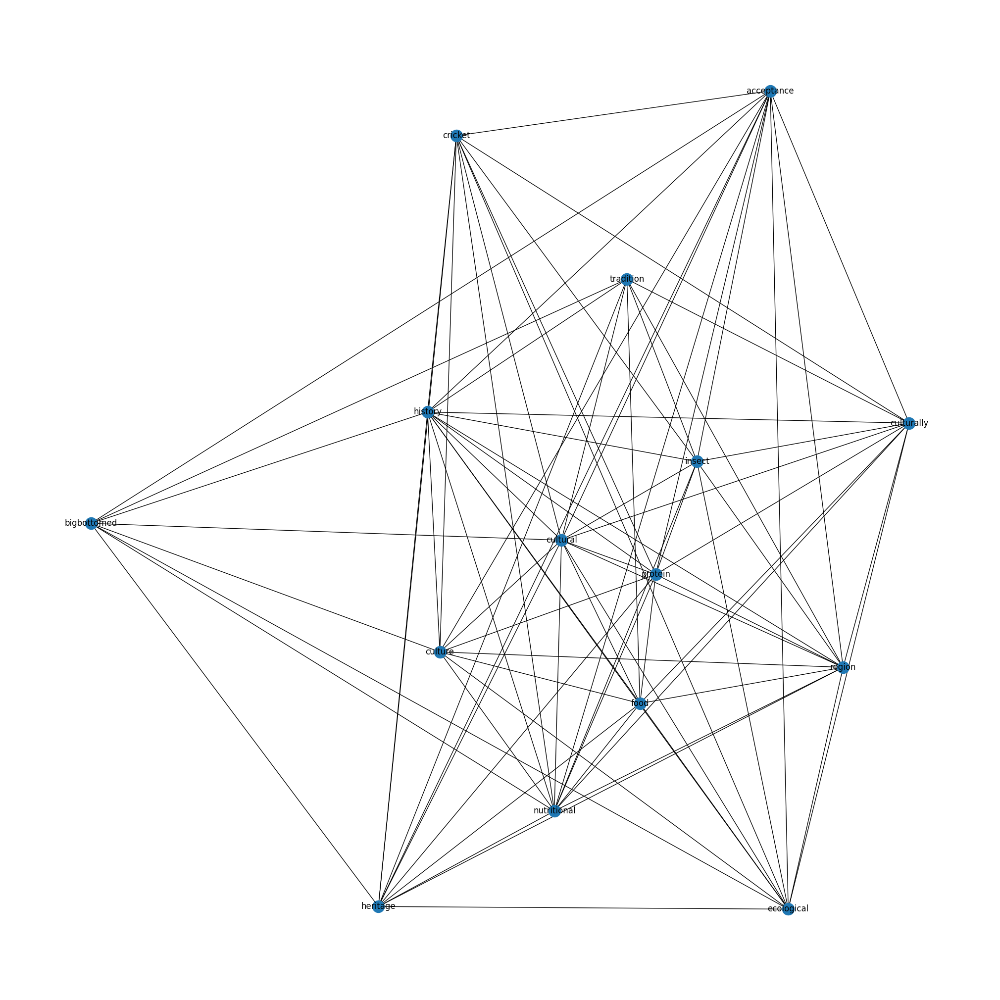

In [ ]:
def clean_text(text):
    additional_stopwords = []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 0.8:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['edibility','insectbased','entomophagy','folk','balance','sustainability','colombia','nutrient','familiarity','healthy','curious','relationship','related','regional','recognition','deeply','deal','realm','realize','hear','reaction','rational','rather','discovery','posed','everyday','portal','outsider','ordinary','embodiment','embody','onto','encounter','offense','occurs','engendering','nutritious','enlightening','enticing','novel','nostalgia','normalization','everevolving','overarching','place','point','pof','pleasantly','disposition','distinction','distinguish','planet','divide','eccentricity','driven','dynamic','eagerly','perceive','ease','passed','particular','ability','focus','le','landscape','foster','found','foundation','judge','journey','framed','free','located','farming','lower','mentioned','name','mutual','multifaceted','much','evolve','mirror','exemplifies','memory','fair','meateater','expansion','meal','express','matures','factor','maintaining','it','intriguingly','nature','intriguing','globe','inclination','going','importance','implication','grand','grapple','greater','grou','group','growing','hold','guided','handle','hesitation','head','healthier','given','indeed','influenced','integrating','intricately','intricacy','interwoven','intertwines','intersection','intergenerational','fusion','integrated','integral','acceptability','insecteating','futureoriented','futuristic','natural','need','reminiscent','discussion','delectable','delicacy','pwith','delicate','delve','desire','propels','determining','production','development','dialogue','dichotomy','difference','dinner','pragmatic','discourse','powerful','quirk','defy','range','daunting','remind','remains','relish','earth','contain','eaten','determines','bible','dessert','beyond','fulfill','appear','appeal','conventional','behind','exact','becoming','extends','fact','choose','back','exposure','familiar','challenge','coast','certainly','dislike','fiber','fine','comfort','functionality','baptist','amount','grown','adventure','crazy','daily','creature','greatest','bucaramanga','adding','agree','grows','emerge','embracing','element','embrace','accessible','ethos','affecting','boundary','debate','cooking','give','especially','getting','boyacá','cooky','couple','bridge','broader','change','center','celebration','cater','stood','capturing','stuff','spirit','steward','stretch','stand','carry','heat','complexity','changing','responsibility','security','scarcity','core','rollercoaster','country','rise','rich','response','seemingly','cringe','resonates','resistance','reservation','requires','repulsion','repugnant','conviction','converge','chowing','concept','solution','clarification','societal','snack','coming','commonplace','surprise','significantly','contribute','significant','connect','showcase','shot','connection','continuity','sentiment','supplanting','text','surprised','viewing','amazing','amid','viable','venturing','venture','varying','ancestral','valuable','unraveling','appeared','unknown','appetizing','appreciated','understanding','appreciation','allowing','viewpoint','captivating','aligns','yeah','acknowledging','wrap','adapting','wonder','without','address','winwin','willingness','wild','wield','affinity','agricultural','akin','alien','underscoring','underlying','underline','underlies','tied','thrives','threat','better','thinking','bewildering','testament','test','tends','board','table','sustenance','become','bat','touching','around','unconventional','uncharted','unappealing','ultimately','architect','arises','array','towards','translation','transformation','transform','associated','aversion','awareness','realization','render','invite','livestock','feel','level','lesson','flavor','learning','like','might','certain','dont','eating','people','consumption','thing','think','find','understand','different','strange','ant','something','part','culinary','love','taste','peanut','consume','good','would','others','santander','normal','belief','know','even','believe','preference','whether','impact','play','bottomed','big','role','pantry','beef','context','pork','interesting','depends','aspect','well','alternative','dietary','upbringing','society','maybe','consumed','unpleasant','individual','considering','humanity','experience','health','often','consuming','come','future','many','make','chicken','content','norm','world','topic','diet','type','cuisine','opportunity','personal','process','community','shape','custom','offer','went','crop','seem','could','area','spicy','background','animal','becomes','tapestry','still','exploration','another','childhood','choice','issue','kore','example','beneficial','unusual','lead','influence','tried','guess','habit','high','japanese','generation','rare','perspective','access','life','trait','provide','bag','problem','developed','source','resource','child','variety','environment','used','explore','similar','meat','common','potato','every','option','bought','never','everyone','chinese','pivotal','imagine','distinctive','great','dish','known','grow','perception','however','easily','form','exposed','lack','global','hinge','look','fascinating','palate','lens','instance','consideration','right','stomach','also','seems','seen','sense','video','shaping','though','resort','consider','specific','specie','unique','assimilate','concern','chunchullo','trying','respect','within','prospect','help','practice','surrounding','balanced','way','across','additionally','take','time','acceptable','depending','intricate','last','interplay','thought','traced','three','totally','john','tolerate','trend','potential','underscore','initially','year','hesitant','wrong','whole','welcome','honey','watch','husband','idea','identity','visited','view','impossible','vicente','incorporated','value','unfamiliar','information','ingrained','inconvenience','matter','terrified','okay','openness','seeing','salted','replacing','replace','regarding','peculiar','reason','really','person','raised','question','quantity','purpose','plate','property','promising','pleasant','product','prejudice','obtain','nuanced','term','shocking','limited','taught','locust','tasty','made','study','mean','stem','special','mexico','socorro','mostly','myriad','smaller','small','skin','skeptical','since','normalize','significance','relativity','young','anything','frequently','early','betulia','evoke','appropriate']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:15]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
# Aplicar la función clean_text a la copia de la columna
p4c = p4cons.apply(clean_text)
network4 = create_red(p4c, 'network4')

In [ ]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network4)
dfx

,Node,Total Co-occurrence Frequency
3,cultural,13056
10,insect,12741
7,food,7708
12,protein,6256
5,culture,4872
14,tradition,2977
11,nutritional,2910
9,history,2799
13,region,2691
4,culturally,2412


In [ ]:
# Texto proporcionado
texto = """
11	curiosity	316
15	ecology	316
34	nutrition	316
7	crosscultural	316
26	gastronomy	316
25	gastronomic	316
24	footprint	316
39	sustainable	316
40	taboo	316
18	edibility	316
32	insectbased	316
19	entomophagy	702
22	folk	702
2	balance	702
38	sustainability	702
5	colombia	702
33	nutrient	702
21	familiarity	702
28	healthy

"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

'curiosity','ecology','nutrition','crosscultural','gastronomy','gastronomic','footprint','sustainable','taboo','edibility','insectbased','entomophagy','folk','balance','sustainability','colombia','nutrient','familiarity','healthy'


#4N

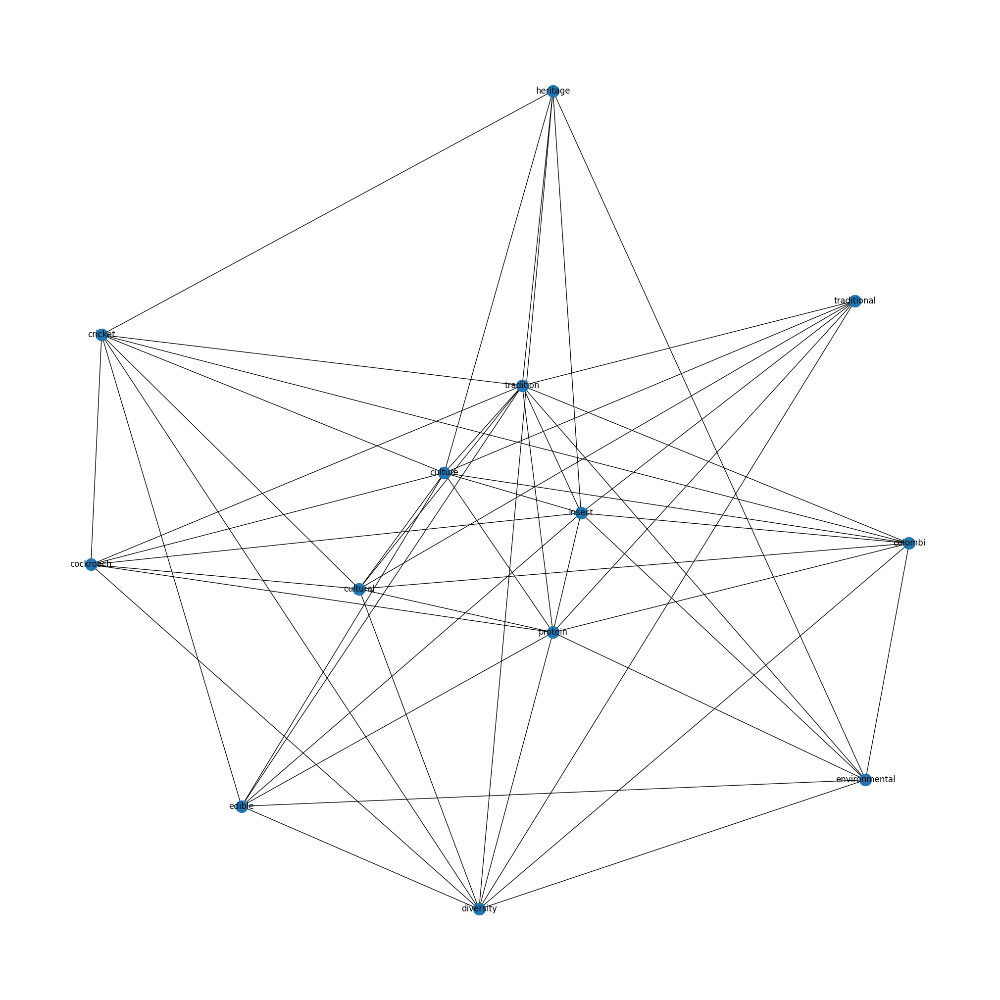

In [ ]:
def clean_text(text):
    additional_stopwords =  []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 0.8:
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['food','personally','enjoy','someone','although','open','notion','reminder','rooted','long','heard','always','probably','considered','prompt','mind','recognize','recognizing','reflect','region','particularly','important','benefit','appreciate','diverse','based','shared','story','approach','grew','leading','distinct','else','imperative','empathy','hygienic','history','encourages','fried','essential','fish','fly','heart','learned','acknowledge','population','likely','maintain','willing','welfare','vast','various','truth','toward','survival','sure','share','shaped','serf','scarce','safety','result','respectable','resourcefulness','resilience','reminded','prime','preconceived','develop','palatable','nourish','nothing','must','disgust','zone','china','admiration','chance','conclusion','crucial','attitude','affect','courage','compared','continues','celebrate','cheaper','profoundly','bite','challenging','pushing','rapid','rapidly','reality','realizing','biting','receives','relativism','relative','bug','reconsidering','reevaluate','cherished','reevaluating','broaden','remain','regarded','book','regular','reject','prioritized','deemed','presented','overcome','normalcy','notable','colored','nourishes','nourishment','number','observe','obtaining','offlimits','climate','openminded','outlook','overlooking','prepared','claim','paramount','partake','circumstance','path','chosen','picture','piqued','choosing','positive','possibility','repulsive','preconception','reminding','bigger','argument','apprehension','surviving','task','teach','territory','theme','thrive','appears','allows','align','transcending','unexpected','unimaginable','universally','unsettling','varied','adventurer','vary','admit','ventured','wallet','adaptability','wellcooked','wholeheartedly','adapt','window','withhold','worldview','worldwide','surprisingly','support','resonate','suitable','newfound','bias','respectful','best','reveals','being','routine','safe','safely','behavior','sample','became','science','beauty','awaits','attention','shrimp','social','aspire','sound','squeamish','squeamishness','stark','started','step','aside','strain','striving','struck','next','navigate','negatively','enjoying','enthusiasm','entirely','criticism','crab','ethical','everexpanding','evident','evolving','exchange','experiencing','experimenting','exploring','expressing','extend','eyeopening','farmed','fascination','feeling','fiction','finding','fluid','costeffective','convince','force','foreign','frequent','fresh','enjoys','criticize','frontier','critique','defines','delightful','delved','dense','depletion','description','despite','deem','differ','decline','disgusting','decent','dare','cultivation','dramatically','easier','cultivate','efficiency','efficient','elicit','elsewhere','embraced','emerges','crossed','emphasize','contrast','full','navigating','inherent','confess','inspired','interaction','intertwined','intrigued','introduced','judgment','large','completely','lifestyle','compelling','logic','logical','comparing','malleable','marked','marvel','mechanism','merely','microcosm','compare','mixed','modern','movie','comfortable','muster','mustered','narrative','deeper','inherently','ingenuity','gaining','informs','garnered','genuinely','globalization','globalized','grasshopper','hamburger','continue','contemplating','constantly','highlighting','highly','considers','honestly','honoring','horizon','humbling','humility','hygiene','consciously','ignored','act','immense','connecting','confront','impose','including','incorporate','increasing','increasingly','immed','curiosity','ecology','nutrition','crosscultural','gastronomy','gastronomic','footprint','sustainable','taboo','edibility','insectbased','entomophagy','folk','balance','sustainability','colombia','nutrient','familiarity','healthy','curious','relationship','related','regional','recognition','deeply','deal','realm','realize','hear','reaction','rational','rather','discovery','posed','everyday','portal','outsider','ordinary','embodiment','embody','onto','encounter','offense','occurs','engendering','nutritious','enlightening','enticing','novel','nostalgia','normalization','everevolving','overarching','place','point','pof','pleasantly','disposition','distinction','distinguish','planet','divide','eccentricity','driven','dynamic','eagerly','perceive','ease','passed','particular','ability','focus','le','landscape','foster','found','foundation','judge','journey','framed','free','located','farming','lower','mentioned','name','mutual','multifaceted','much','evolve','mirror','exemplifies','memory','fair','meateater','expansion','meal','express','matures','factor','maintaining','it','intriguingly','nature','intriguing','globe','inclination','going','importance','implication','grand','grapple','greater','grou','group','growing','hold','guided','handle','hesitation','head','healthier','given','indeed','influenced','integrating','intricately','intricacy','interwoven','intertwines','intersection','intergenerational','fusion','integrated','integral','acceptability','insecteating','futureoriented','futuristic','natural','need','reminiscent','discussion','delectable','delicacy','pwith','delicate','delve','desire','propels','determining','production','development','dialogue','dichotomy','difference','dinner','pragmatic','discourse','powerful','quirk','defy','range','daunting','remind','remains','relish','earth','contain','eaten','determines','bible','dessert','beyond','fulfill','appear','appeal','conventional','behind','exact','becoming','extends','fact','choose','back','exposure','familiar','challenge','coast','certainly','dislike','fiber','fine','comfort','functionality','baptist','amount','grown','adventure','crazy','daily','creature','greatest','bucaramanga','adding','agree','grows','emerge','embracing','element','embrace','accessible','ethos','affecting','boundary','debate','cooking','give','especially','getting','boyacá','cooky','couple','bridge','broader','change','center','celebration','cater','stood','capturing','stuff','spirit','steward','stretch','stand','carry','heat','complexity','changing','responsibility','security','scarcity','core','rollercoaster','country','rise','rich','response','seemingly','cringe','resonates','resistance','reservation','requires','repulsion','repugnant','conviction','converge','chowing','concept','solution','clarification','societal','snack','coming','commonplace','surprise','significantly','contribute','significant','connect','showcase','shot','connection','continuity','sentiment','supplanting','text','surprised','viewing','amazing','amid','viable','venturing','venture','varying','ancestral','valuable','unraveling','appeared','unknown','appetizing','appreciated','understanding','appreciation','allowing','viewpoint','captivating','aligns','yeah','acknowledging','wrap','adapting','wonder','without','address','winwin','willingness','wild','wield','affinity','agricultural','akin','alien','underscoring','underlying','underline','underlies','tied','thrives','threat','better','thinking','bewildering','testament','test','tends','board','table','sustenance','become','bat','touching','around','unconventional','uncharted','unappealing','ultimately','architect','arises','array','towards','translation','transformation','transform','associated','aversion','awareness','realization','render','invite','livestock','feel','level','lesson','flavor','learning','like','might','certain','dont','eating','people','consumption','thing','think','find','understand','different','strange','ant','something','part','culinary','love','taste','peanut','consume','good','would','others','santander','normal','belief','know','even','believe','preference','whether','impact','play','bottomed','big','role','pantry','beef','context','pork','interesting','depends','aspect','well','alternative','dietary','upbringing','society','maybe','consumed','unpleasant','individual','considering','humanity','experience','health','often','consuming','come','future','many','make','chicken','content','norm','world','topic','diet','type','cuisine','opportunity','personal','process','community','shape','custom','offer','went','crop','seem','could','area','spicy','background','animal','becomes','tapestry','still','exploration','another','childhood','choice','issue','kore','example','beneficial','unusual','lead','influence','tried','guess','habit','high','japanese','generation','rare','perspective','access','life','trait','provide','bag','problem','developed','source','resource','child','variety','environment','used','explore','similar','meat','common','potato','every','option','bought','never','everyone','chinese','pivotal','imagine','distinctive','great','dish','known','grow','perception','however','easily','form','exposed','lack','global','hinge','look','fascinating','palate','lens','instance','consideration','right','stomach','also','seems','seen','sense','video','shaping','though','resort','consider','specific','specie','unique','assimilate','concern','chunchullo','trying','respect','within','prospect','help','practice','surrounding','balanced','way','across','additionally','take','time','acceptable','depending','intricate','last','interplay','thought','traced','three','totally','john','tolerate','trend','potential','underscore','initially','year','hesitant','wrong','whole','welcome','honey','watch','husband','idea','identity','visited','view','impossible','vicente','incorporated','value','unfamiliar','information','ingrained','inconvenience','matter','terrified','okay','openness','seeing','salted','replacing','replace','regarding','peculiar','reason','really','person','raised','question','quantity','purpose','plate','property','promising','pleasant','product','prejudice','obtain','nuanced','term','shocking','limited','taught','locust','tasty','made','study','mean','stem','special','mexico','socorro','mostly','myriad','smaller','small','skin','skeptical','since','normalize','significance','relativity','young','anything','frequently','early','betulia','evoke','appropriate']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:13]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
# Aplicar la función clean_text a la copia de la columna
p4n = p4noncons.apply(clean_text)
network4n = create_red(p4n, 'network4n')

In [ ]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network4n)
dfx

,Node,Total Co-occurrence Frequency
9,insect,3355
4,culture,2553
10,protein,1815
11,tradition,1270
3,cultural,1071
7,environmental,273
1,colombi,264
0,cockroach,258
2,cricket,252
12,traditional,250


In [ ]:
# Texto proporcionado
texto = """

"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

In [ ]:
#plt.title('Question 4: Cultural beliefs about insect-food based consumption - Communities Bipartite Network')
#plt.axis('off')
#plt.legend(handles=combined_handles, loc='upper right', title="Nodes", bbox_to_anchor=(0.02, 0.98), fontsize=13)
#plt.savefig('P4.png', dpi=300, bbox_inches='tight')
#plt.show()

#P5-KNOWLEDGE ABOUT INSECTS

In [ ]:
p5cons= compared['QUESTION 7 - KNOWLEDGE ABOUT INSECTS-CONS\n'].astype(str)
p5noncons= compared['P7-KNOWLEDGE ABOUT INSECTS-NONCONS'].astype(str)

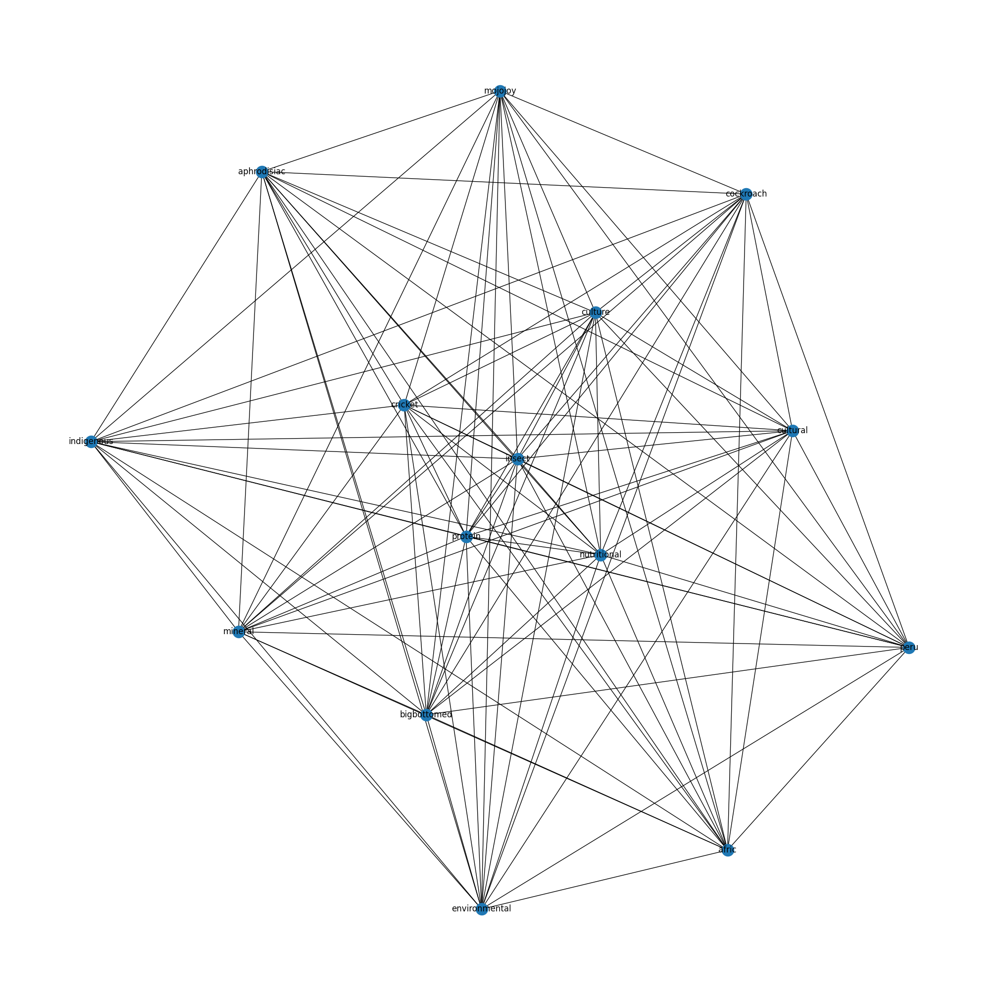

In [ ]:
def clean_text(text):
    additional_stopwords = []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 8:
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['food','personally','enjoy','someone','although','open','notion','reminder','rooted','long','heard','always','probably','considered','prompt','mind','recognize','recognizing','reflect','region','particularly','important','benefit','appreciate','diverse','based','shared','story','approach','grew','leading','distinct','else','imperative','empathy','hygienic','history','encourages','fried','essential','fish','fly','heart','learned','acknowledge','population','likely','maintain','willing','welfare','vast','various','truth','toward','survival','sure','share','shaped','serf','scarce','safety','result','respectable','resourcefulness','resilience','reminded','prime','preconceived','develop','palatable','nourish','nothing','must','disgust','zone','china','admiration','chance','conclusion','crucial','attitude','affect','courage','compared','continues','celebrate','cheaper','profoundly','bite','challenging','pushing','rapid','rapidly','reality','realizing','biting','receives','relativism','relative','bug','reconsidering','reevaluate','cherished','reevaluating','broaden','remain','regarded','book','regular','reject','prioritized','deemed','presented','overcome','normalcy','notable','colored','nourishes','nourishment','number','observe','obtaining','offlimits','climate','openminded','outlook','overlooking','prepared','claim','paramount','partake','circumstance','path','chosen','picture','piqued','choosing','positive','possibility','repulsive','preconception','reminding','bigger','argument','apprehension','surviving','task','teach','territory','theme','thrive','appears','allows','align','transcending','unexpected','unimaginable','universally','unsettling','varied','adventurer','vary','admit','ventured','wallet','adaptability','wellcooked','wholeheartedly','adapt','window','withhold','worldview','worldwide','surprisingly','support','resonate','suitable','newfound','bias','respectful','best','reveals','being','routine','safe','safely','behavior','sample','became','science','beauty','awaits','attention','shrimp','social','aspire','sound','squeamish','squeamishness','stark','started','step','aside','strain','striving','struck','next','navigate','negatively','enjoying','enthusiasm','entirely','criticism','crab','ethical','everexpanding','evident','evolving','exchange','experiencing','experimenting','exploring','expressing','extend','eyeopening','farmed','fascination','feeling','fiction','finding','fluid','costeffective','convince','force','foreign','frequent','fresh','enjoys','criticize','frontier','critique','defines','delightful','delved','dense','depletion','description','despite','deem','differ','decline','disgusting','decent','dare','cultivation','dramatically','easier','cultivate','efficiency','efficient','elicit','elsewhere','embraced','emerges','crossed','emphasize','contrast','full','navigating','inherent','confess','inspired','interaction','intertwined','intrigued','introduced','judgment','large','completely','lifestyle','compelling','logic','logical','comparing','malleable','marked','marvel','mechanism','merely','microcosm','compare','mixed','modern','movie','comfortable','muster','mustered','narrative','deeper','inherently','ingenuity','gaining','informs','garnered','genuinely','globalization','globalized','grasshopper','hamburger','continue','contemplating','constantly','highlighting','highly','considers','honestly','honoring','horizon','humbling','humility','hygiene','consciously','ignored','act','immense','connecting','confront','impose','including','incorporate','increasing','increasingly','immed','curiosity','ecology','nutrition','crosscultural','gastronomy','gastronomic','footprint','sustainable','taboo','edibility','insectbased','entomophagy','folk','balance','sustainability','colombia','nutrient','familiarity','healthy','curious','relationship','related','regional','recognition','deeply','deal','realm','realize','hear','reaction','rational','rather','discovery','posed','everyday','portal','outsider','ordinary','embodiment','embody','onto','encounter','offense','occurs','engendering','nutritious','enlightening','enticing','novel','nostalgia','normalization','everevolving','overarching','place','point','pof','pleasantly','disposition','distinction','distinguish','planet','divide','eccentricity','driven','dynamic','eagerly','perceive','ease','passed','particular','ability','focus','le','landscape','foster','found','foundation','judge','journey','framed','free','located','farming','lower','mentioned','name','mutual','multifaceted','much','evolve','mirror','exemplifies','memory','fair','meateater','expansion','meal','express','matures','factor','maintaining','it','intriguingly','nature','intriguing','globe','inclination','going','importance','implication','grand','grapple','greater','grou','group','growing','hold','guided','handle','hesitation','head','healthier','given','indeed','influenced','integrating','intricately','intricacy','interwoven','intertwines','intersection','intergenerational','fusion','integrated','integral','acceptability','insecteating','futureoriented','futuristic','natural','need','reminiscent','discussion','delectable','delicacy','pwith','delicate','delve','desire','propels','determining','production','development','dialogue','dichotomy','difference','dinner','pragmatic','discourse','powerful','quirk','defy','range','daunting','remind','remains','relish','earth','contain','eaten','determines','bible','dessert','beyond','fulfill','appear','appeal','conventional','behind','exact','becoming','extends','fact','choose','back','exposure','familiar','challenge','coast','certainly','dislike','fiber','fine','comfort','functionality','baptist','amount','grown','adventure','crazy','daily','creature','greatest','bucaramanga','adding','agree','grows','emerge','embracing','element','embrace','accessible','ethos','affecting','boundary','debate','cooking','give','especially','getting','boyacá','cooky','couple','bridge','broader','change','center','celebration','cater','stood','capturing','stuff','spirit','steward','stretch','stand','carry','heat','complexity','changing','responsibility','security','scarcity','core','rollercoaster','country','rise','rich','response','seemingly','cringe','resonates','resistance','reservation','requires','repulsion','repugnant','conviction','converge','chowing','concept','solution','clarification','societal','snack','coming','commonplace','surprise','significantly','contribute','significant','connect','showcase','shot','connection','continuity','sentiment','supplanting','text','surprised','viewing','amazing','amid','viable','venturing','venture','varying','ancestral','valuable','unraveling','appeared','unknown','appetizing','appreciated','understanding','appreciation','allowing','viewpoint','captivating','aligns','yeah','acknowledging','wrap','adapting','wonder','without','address','winwin','willingness','wild','wield','affinity','agricultural','akin','alien','underscoring','underlying','underline','underlies','tied','thrives','threat','better','thinking','bewildering','testament','test','tends','board','table','sustenance','become','bat','touching','around','unconventional','uncharted','unappealing','ultimately','architect','arises','array','towards','translation','transformation','transform','associated','aversion','awareness','realization','render','invite','livestock','feel','level','lesson','flavor','learning','like','might','certain','dont','eating','people','consumption','thing','think','find','understand','different','strange','ant','something','part','culinary','love','taste','peanut','consume','good','would','others','santander','normal','belief','know','even','believe','preference','whether','impact','play','bottomed','big','role','pantry','beef','context','pork','interesting','depends','aspect','well','alternative','dietary','upbringing','society','maybe','consumed','unpleasant','individual','considering','humanity','experience','health','often','consuming','come','future','many','make','chicken','content','norm','world','topic','diet','type','cuisine','opportunity','personal','process','community','shape','custom','offer','went','crop','seem','could','area','spicy','background','animal','becomes','tapestry','still','exploration','another','childhood','choice','issue','kore','example','beneficial','unusual','lead','influence','tried','guess','habit','high','japanese','generation','rare','perspective','access','life','trait','provide','bag','problem','developed','source','resource','child','variety','environment','used','explore','similar','meat','common','potato','every','option','bought','never','everyone','chinese','pivotal','imagine','distinctive','great','dish','known','grow','perception','however','easily','form','exposed','lack','global','hinge','look','fascinating','palate','lens','instance','consideration','right','stomach','also','seems','seen','sense','video','shaping','though','resort','consider','specific','specie','unique','assimilate','concern','chunchullo','trying','respect','within','prospect','help','practice','surrounding','balanced','way','across','additionally','take','time','acceptable','depending','intricate','last','interplay','thought','traced','three','totally','john','tolerate','trend','potential','underscore','initially','year','hesitant','wrong','whole','welcome','honey','watch','husband','idea','identity','visited','view','impossible','vicente','incorporated','value','unfamiliar','information','ingrained','inconvenience','matter','terrified','okay','openness','seeing','salted','replacing','replace','regarding','peculiar','reason','really','person','raised','question','quantity','purpose','plate','property','promising','pleasant','product','prejudice','obtain','nuanced','term','shocking','limited','taught','locust','tasty','made','study','mean','stem','special','mexico','socorro','mostly','myriad','smaller','small','skin','skeptical','since','normalize','significance','relativity','young','anything','frequently','early','betulia','evoke','appropriate','lauded','gamechanger','insecteating','gungho','guy','innate','initiative','ingredient','indulge','hard','hel','hidden','increasingly','incorporating','highlight','highly','includes','impressive','important','honest','image','illness','grounded','grew','gastronomic','great','larger','largebottomed','gathered','general','generally','getting','kind','kicker','japanese','invaluable','intrinsic','go','intricate','goody','interplay','interesting','interest','integration','integral','expert','nourishing','remedy','delve','deal','debate','deep','deeply','deeprooted','delf','progress','program','delicacy','prized','nourishment','prevalent','prevalence','pretty','delving','depicting','dining','dinner','discovered','pot','punch','daredevil','daily','custom','cool','corner','count','cousin','regular','reflecting','refer','recognize','crossed','crucially','crunch','really','honesty','rarely','rare','range','raising','radical','quirky','distant','distinctive','plethora','overview','endures','outstanding','others','engagement','onto','enhance','onecountry','enthusiasm','offputting','enturous','oddity','occur','everevolving','every','everything','nutrientdense','exceed','exhaustive','novel','overcome','emphasize','disturbing','palatable','plate','drawback','piqued','piece','phenomenon','drink','driving','personally','drop','persist','edible','pbalance','educated','past','efficient','either','elucidation','partaking','embraced','abundance','requires','reserved','somewhat','matter','someone','mentioned','menu','snack','sixlegged','positive','mind','showing','mounting','munching','security','scoop','science','rooted','right','notion','richness','nourished','resilient','numerous','horizon','delight','eater','free','anything','animal','frontier','exploration','call','gain','amount','glimpse','allure','gather','alive','become','case','giving','beef','foster','depth','arabi','bar','fatty','diversity','aversion','feed','family','fewer','finding','central','associated','carry','dismissed','asia','foodrelated','footprint','change','discovering','chef','climate','give','closer','curiosity','globe','habit','half','beverage','hesitation','consider','higher','creative','energy','boast','history','entrepreneur','access','acceptance','cooked','crunchy','everyday','conclusion','beneficial','africa','comparable','broaden','compared','compelling','component','grapple','fare','evolving','bugeating','squirm','societal','super','stand','brimming','buffet','stem','spicing','bottomed','substantial','solid','strange','specifically','captivating','captivate','captivatingly','south','something','summary','share','categorized','revealing','commonly','said','rudimentary','composition','comprehensive','confess','confined','reunion','common','resources','connection','context','resembles','continues','require','contributor','savor','claiming','smattering','shot','cent','sink','challenging','significant','side','showcasing','show','support','chowing','serving','cherished','seriously','chest','choice','seek','chow','boost','thought','bonanza','usual','adventure','affirm','warrant','want','vivid','vital','viewed','ailment','viable','veritable','alcoholic','ventured','veil','varying','americ','varies','analysis','and','advantage','address','weave','acquainted','yeah','would','worldwide','accustomed','wood','wonderful','wild','acknowledge','actually','additionally','add','wellversed','added','wellinformed','welldocumented','wellbeing','wellbalanced','adding','usually','appeal','bodybuilder','uninformed','toss','barrier','basic','time','throughout','three','remove','beckons','therefore','texture','testament','behind','beloved','tapestry','talking','talk','tale','table','big','totally','balanced','balance','type','unfamiliarity','undoubtedly','understand','underscoring','area','uncover','array','typically','assistance','aware','truly','trove','tried','astounding','attention','available','transition','transcended','renowned','rather','reminder','long','meet','flavor','meanwhile','folk','fondly','force','foreign','forget','longstanding','local','expect','loaded','form','linked','lineup','frequently','lift','less','legit','least','firmly','feeling','feature','feast','noting','noteworthy','expertise','notably','notable','normal','nonetheless','express','negative','extend','neck','extension','familiarity','mysterious','fan','munch','multivitamin','fantastic','modest','furthermore','food','like','source','might','know','even','knowledge','often','content','rich','region','world','offer','various','creature','essential','diet','consumed','acid','part','dont','people','meat','heard','traditional','limited','amino','resource','consume','contribute','example','tiny','aspect','idea','valuable','flour','production','practice','conventional','certain','come','concern','however','country','addressing','especially','insight','challenge','hold','experience','good','santander','fact','scarcity','farming','much','seem','also','consuming','embracing','deficiency','realm','provide','alleviate','global','high','addition','could','tequila','level','fried','specific','nutritious','adventurous','particularly','nutrition','different','concept','cuisine','indeed','curious','acting','novelty','including','america','considered','quality','avenue','subject','little','supplement','dietary','unconventional','tribe','term','learn','future','beetle','thing','think','latin','diverse','topic','larva','posse','include','eager','staple','profile','community','eating','nature','clay','make','value','grasshopper','single','many','unique','particular','place','play','incorporate','education','norm','overall','natural','landscape','gastronomy','known','gluten','found','livestock','making','intriguing','find','mere','dish','must','factor','option','need','never','exploring','explore','lack','note','excellent','innovative','evident','information','hesitate','incredibly','feel','human','significance','scientifically','relationship','remarkable','continue','understanding','contain','reveals','roasted','role','clear','verified','chinese','seems','seen','serve','chapulines','significantly','believe','take','beyond','sustenance','regarding','container','well','purpose','powerhouse','widespread','pressing','widely','across','probably','promise','whether','bug','crucial','way','touted','wide','wary','used','though','lead','initial','territory','variety','water','vary','impact','system','worth','russia','sure','stop','step','look','looking','interested','toward','traction','knowing','underestimated','made','wealth','abundantly','uncharted','indi','jungle','twist','turning','land','unusual','weird','indepth','treasure','venturing','translation','wellrounded','intricacy','video','potentially','spectrum','participant','replace','relatively','related','reduced','reassuring','online','opportunity','rearing','pack','read','reach','purposes','sound','providing','pasta','promising','perception','personal','pest','pressure','planet','pound','popular','represent','iron','critter','cricketbased','zinc','rival','vitamins','snail','omega'
]
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:15]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
p5c = p5cons.apply(clean_text)
network5 = create_red(p5c, 'network5')

In [ ]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network5)
dfx

,Node,Total Co-occurrence Frequency
9,insect,19210
14,protein,10320
12,nutritional,7366
4,cricket,5980
6,culture,3766
2,bigbottomed,3252
10,mineral,2200
5,cultural,1932
3,cockroach,1662
11,mojojoy,1662


In [ ]:
# Texto proporcionado
texto = """

"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

#5N

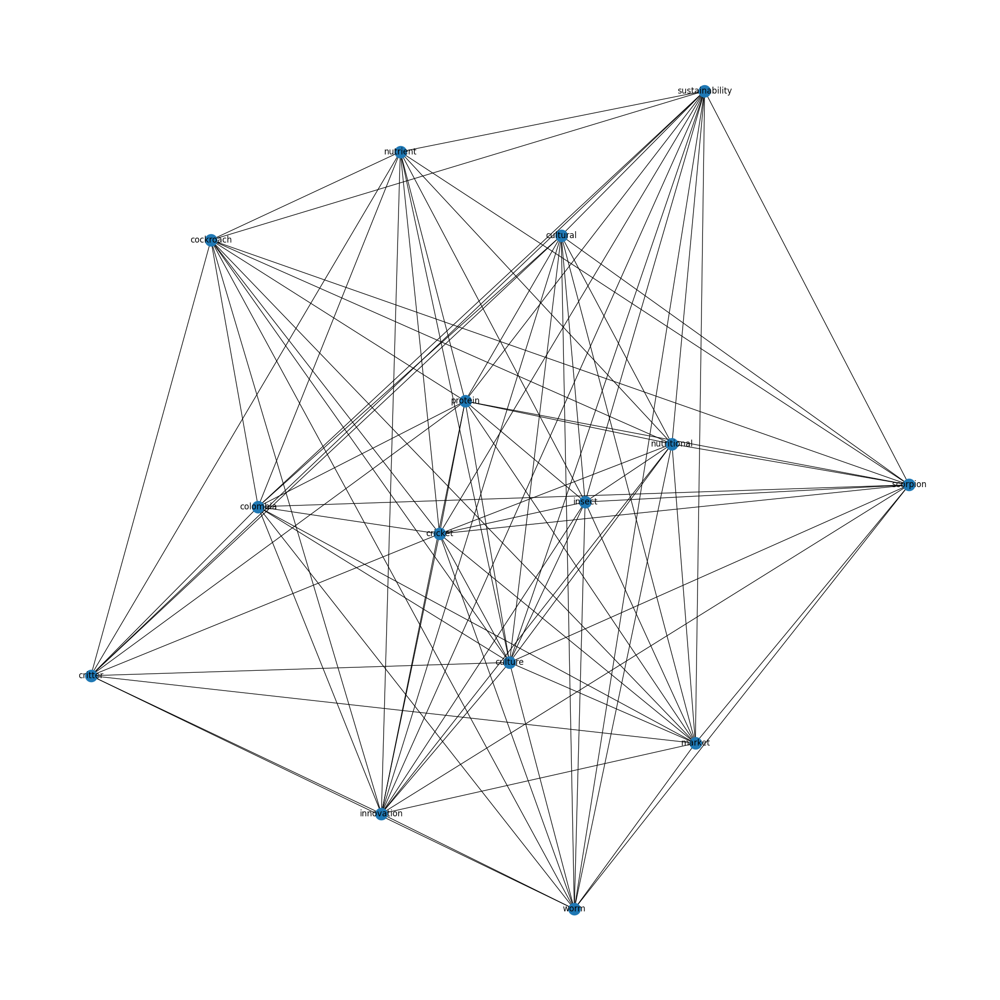

In [ ]:
def clean_text(text):
    additional_stopwords =  []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 0.8:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['food','personally','enjoy','someone','although','open','notion','reminder','rooted','long','heard','always','probably','considered','prompt','mind','recognize','recognizing','reflect','region','particularly','important','benefit','appreciate','diverse','based','shared','story','approach','grew','leading','distinct','else','imperative','empathy','hygienic','history','encourages','fried','essential','fish','fly','heart','learned','acknowledge','population','likely','maintain','willing','welfare','vast','various','truth','toward','survival','sure','share','shaped','serf','scarce','safety','result','respectable','resourcefulness','resilience','reminded','prime','preconceived','develop','palatable','nourish','nothing','must','disgust','zone','admiration','chance','conclusion','crucial','attitude','affect','courage','compared','continues','celebrate','profoundly','bite','challenging','pushing','rapid','rapidly','reality','realizing','biting','receives','relativism','relative','bug','reconsidering','reevaluate','cherished','reevaluating','broaden','remain','regarded','book','regular','reject','prioritized','deemed','presented','overcome','normalcy','notable','colored','nourishes','nourishment','number','observe','obtaining','offlimits','climate','openminded','outlook','overlooking','prepared','claim','paramount','partake','circumstance','path','chosen','picture','piqued','choosing','positive','possibility','repulsive','preconception','reminding','bigger','argument','apprehension','surviving','task','teach','territory','theme','thrive','appears','allows','align','transcending','unexpected','unimaginable','universally','unsettling','varied','adventurer','vary','admit','ventured','wallet','adaptability','wellcooked','wholeheartedly','adapt','window','withhold','worldview','worldwide','surprisingly','support','resonate','suitable','newfound','bias','respectful','best','reveals','being','routine','safe','safely','behavior','sample','became','science','beauty','awaits','attention','shrimp','social','aspire','sound','squeamish','squeamishness','stark','started','step','aside','strain','striving','struck','next','navigate','negatively','enjoying','enthusiasm','entirely','criticism','crab','ethical','everexpanding','evident','evolving','exchange','experiencing','experimenting','exploring','expressing','extend','eyeopening','farmed','fascination','feeling','fiction','finding','fluid','costeffective','convince','force','foreign','frequent','fresh','enjoys','criticize','frontier','critique','defines','delightful','delved','dense','depletion','description','despite','deem','differ','decline','disgusting','decent','dare','cultivation','dramatically','easier','cultivate','efficiency','efficient','elicit','elsewhere','embraced','emerges','crossed','emphasize','contrast','full','navigating','inherent','confess','inspired','interaction','intertwined','intrigued','introduced','judgment','large','completely','lifestyle','compelling','logic','logical','comparing','malleable','marked','marvel','mechanism','merely','microcosm','compare','mixed','modern','movie','comfortable','muster','mustered','narrative','deeper','inherently','ingenuity','gaining','informs','garnered','genuinely','globalization','globalized','grasshopper','hamburger','continue','contemplating','constantly','highlighting','highly','considers','honestly','honoring','horizon','humbling','humility','hygiene','consciously','ignored','act','immense','connecting','confront','impose','including','incorporate','increasing','increasingly','immed','curiosity','ecology','nutrition','gastronomy','gastronomic','footprint','familiarity','relationship','related','regional','recognition','deeply','deal','realm','realize','hear','reaction','rational','rather','discovery','posed','everyday','portal','outsider','ordinary','embodiment','embody','onto','encounter','offense','occurs','engendering','nutritious','enlightening','enticing','novel','nostalgia','normalization','everevolving','overarching','place','point','pof','pleasantly','disposition','distinction','distinguish','planet','divide','eccentricity','driven','dynamic','eagerly','perceive','ease','passed','particular','ability','focus','le','landscape','foster','found','foundation','judge','journey','framed','free','located','farming','lower','mentioned','name','mutual','multifaceted','much','evolve','mirror','exemplifies','memory','fair','meateater','expansion','meal','express','matures','factor','maintaining','it','intriguingly','nature','intriguing','globe','inclination','going','importance','implication','grand','grapple','greater','grou','group','growing','hold','guided','handle','hesitation','head','healthier','given','indeed','influenced','integrating','intricately','intricacy','interwoven','intertwines','intersection','intergenerational','fusion','integrated','integral','acceptability','insecteating','futureoriented','futuristic','natural','need','reminiscent','discussion','delectable','delicacy','pwith','delicate','delve','desire','propels','determining','production','development','dialogue','dichotomy','difference','dinner','pragmatic','discourse','powerful','quirk','defy','range','daunting','remind','remains','relish','earth','contain','eaten','determines','bible','dessert','beyond','fulfill','appear','appeal','conventional','behind','exact','becoming','extends','fact','choose','back','exposure','familiar','challenge','coast','certainly','dislike','fiber','fine','comfort','functionality','baptist','amount','grown','adventure','crazy','daily','creature','greatest','bucaramanga','adding','agree','grows','emerge','embracing','element','embrace','accessible','ethos','affecting','boundary','debate','cooking','give','especially','getting','boyacá','cooky','couple','bridge','broader','change','center','celebration','cater','stood','capturing','stuff','spirit','steward','stretch','stand','carry','heat','complexity','changing','responsibility','security','scarcity','core','rollercoaster','country','rise','rich','response','seemingly','cringe','resonates','resistance','reservation','requires','repulsion','repugnant','conviction','converge','chowing','concept','solution','clarification','societal','snack','coming','commonplace','surprise','significantly','contribute','significant','connect','showcase','shot','connection','continuity','sentiment','supplanting','text','surprised','viewing','amazing','amid','viable','venturing','venture','varying','ancestral','valuable','unraveling','appeared','unknown','appetizing','appreciated','understanding','appreciation','allowing','viewpoint','captivating','aligns','yeah','acknowledging','wrap','adapting','wonder','without','address','winwin','willingness','wild','wield','affinity','agricultural','akin','alien','underscoring','underlying','underline','underlies','tied','thrives','threat','better','thinking','bewildering','testament','test','tends','board','table','sustenance','become','bat','touching','around','unconventional','uncharted','unappealing','ultimately','architect','arises','array','towards','translation','transformation','transform','associated','aversion','awareness','realization','render','invite','livestock','feel','level','lesson','flavor','learning','like','might','certain','dont','eating','people','consumption','thing','think','find','understand','different','strange','ant','something','part','culinary','love','taste','peanut','consume','good','would','others','santander','normal','belief','know','even','believe','preference','whether','impact','play','bottomed','big','role','pantry','beef','context','pork','interesting','depends','aspect','well','alternative','dietary','upbringing','society','maybe','consumed','unpleasant','individual','considering','humanity','experience','health','often','consuming','come','future','many','make','chicken','content','norm','world','topic','diet','type','cuisine','opportunity','personal','process','community','shape','custom','offer','went','crop','seem','could','area','spicy','background','animal','becomes','tapestry','still','exploration','another','childhood','choice','issue','kore','example','beneficial','unusual','lead','influence','tried','guess','habit','high','japanese','generation','rare','perspective','access','life','trait','provide','bag','problem','developed','source','resource','child','variety','environment','used','explore','similar','meat','common','potato','every','option','bought','never','everyone','chinese','pivotal','imagine','distinctive','great','dish','known','grow','perception','however','easily','form','exposed','lack','global','hinge','look','fascinating','palate','lens','instance','consideration','right','stomach','also','seems','seen','sense','video','shaping','though','resort','consider','specific','specie','unique','assimilate','concern','chunchullo','trying','respect','within','prospect','help','practice','surrounding','balanced','way','across','additionally','take','time','acceptable','depending','intricate','last','interplay','thought','traced','three','totally','john','tolerate','trend','potential','underscore','initially','year','hesitant','wrong','whole','welcome','honey','watch','husband','idea','identity','visited','view','impossible','vicente','incorporated','value','unfamiliar','information','ingrained','inconvenience','matter','terrified','okay','openness','seeing','salted','replacing','replace','regarding','peculiar','reason','really','person','raised','question','quantity','purpose','plate','property','promising','pleasant','product','prejudice','obtain','nuanced','term','shocking','limited','taught','locust','tasty','made','study','mean','stem','special','socorro','mostly','myriad','smaller','small','skin','skeptical','since','normalize','significance','relativity','young','anything','frequently','early','betulia','evoke','appropriate','lauded','gamechanger','insecteating','gungho','guy','innate','initiative','ingredient','indulge','hard','hel','hidden','increasingly','incorporating','highlight','highly','includes','impressive','important','honest','image','illness','grounded','grew','gastronomic','great','larger','largebottomed','gathered','general','generally','getting','kind','kicker','japanese','invaluable','intrinsic','go','intricate','goody','interplay','interesting','interest','integration','integral','expert','nourishing','remedy','delve','deal','debate','deep','deeply','deeprooted','delf','progress','program','delicacy','prized','nourishment','prevalent','prevalence','pretty','delving','depicting','dining','dinner','discovered','pot','punch','daredevil','daily','custom','cool','corner','count','cousin','regular','reflecting','refer','recognize','crossed','crucially','crunch','really','honesty','rarely','rare','range','raising','radical','quirky','distant','distinctive','plethora','overview','endures','outstanding','others','engagement','onto','enhance','onecountry','enthusiasm','offputting','enturous','oddity','occur','everevolving','every','everything','nutrientdense','exceed','exhaustive','novel','overcome','emphasize','disturbing','palatable','plate','drawback','piqued','piece','phenomenon','drink','driving','personally','drop','persist','edible','pbalance','educated','past','efficient','either','elucidation','partaking','embraced','abundance','requires','reserved','somewhat','matter','someone','mentioned','menu','snack','sixlegged','positive','mind','showing','mounting','munching','security','scoop','science','rooted','right','notion','richness','nourished','resilient','numerous','horizon','delight','eater','free','anything','animal','frontier','exploration','call','gain','amount','glimpse','allure','gather','alive','become','case','giving','beef','foster','depth','arabi','bar','fatty','diversity','aversion','feed','family','fewer','finding','central','associated','carry','dismissed','asia','foodrelated','footprint','change','discovering','chef','climate','give','closer','curiosity','globe','habit','half','beverage','hesitation','consider','higher','creative','energy','boast','history','entrepreneur','access','acceptance','cooked','crunchy','everyday','conclusion','beneficial','africa','comparable','broaden','compared','compelling','component','grapple','fare','evolving','bugeating','squirm','societal','super','stand','brimming','buffet','stem','spicing','bottomed','substantial','solid','strange','specifically','captivating','captivate','captivatingly','south','something','summary','share','categorized','revealing','commonly','said','rudimentary','composition','comprehensive','confess','confined','reunion','common','resources','connection','context','resembles','continues','require','contributor','savor','claiming','smattering','shot','cent','sink','challenging','significant','side','showcasing','show','support','chowing','serving','cherished','seriously','chest','choice','seek','chow','boost','thought','bonanza','usual','adventure','affirm','warrant','want','vivid','vital','viewed','ailment','viable','veritable','alcoholic','ventured','veil','varying','americ','varies','analysis','and','advantage','address','weave','acquainted','yeah','would','worldwide','accustomed','wood','wonderful','wild','acknowledge','actually','additionally','add','wellversed','added','wellinformed','welldocumented','wellbeing','wellbalanced','adding','usually','appeal','bodybuilder','uninformed','toss','barrier','basic','time','throughout','three','remove','beckons','therefore','texture','testament','behind','beloved','tapestry','talking','talk','tale','table','big','totally','balanced','balance','type','unfamiliarity','undoubtedly','understand','underscoring','area','uncover','array','typically','assistance','aware','truly','trove','tried','astounding','attention','available','transition','transcended','renowned','rather','reminder','long','meet','flavor','meanwhile','folk','fondly','force','foreign','forget','longstanding','local','expect','loaded','form','linked','lineup','frequently','lift','less','legit','least','firmly','feeling','feature','feast','noting','noteworthy','expertise','notably','notable','normal','nonetheless','express','negative','extend','neck','extension','familiarity','mysterious','fan','munch','fantastic','modest','furthermore','food','like','source','might','know','even','knowledge','often','content','rich','region','world','offer','various','creature','essential','diet','consumed','acid','part','dont','people','meat','heard','traditional','limited','amino','resource','consume','contribute','example','tiny','aspect','idea','valuable','flour','production','practice','conventional','certain','come','concern','however','country','addressing','especially','insight','challenge','hold','experience','good','santander','fact','scarcity','farming','much','seem','also','consuming','embracing','deficiency','realm','provide','alleviate','global','high','addition','could','tequila','level','fried','specific','nutritious','adventurous','particularly','nutrition','different','concept','cuisine','indeed','curious','acting','novelty','including','america','considered','quality','avenue','subject','little','supplement','dietary','unconventional','tribe','term','learn','future','beetle','thing','think','latin','diverse','topic','larva','posse','include','eager','staple','profile','community','eating','nature','clay','make','value','grasshopper','single','many','unique','particular','place','play','incorporate','education','norm','overall','natural','landscape','gastronomy','known','gluten','found','livestock','making','intriguing','find','mere','dish','must','factor','option','need','never','exploring','explore','lack','note','excellent','innovative','evident','information','hesitate','incredibly','feel','human','significance','scientifically','relationship','remarkable','continue','understanding','contain','reveals','roasted','role','clear','verified','chinese','seems','seen','serve','chapulines','significantly','believe','take','beyond','sustenance','regarding','container','well','purpose','powerhouse','widespread','pressing','widely','across','probably','promise','whether','bug','crucial','way','touted','wide','wary','used','though','lead','initial','territory','variety','water','vary','impact','system','worth','sure','stop','step','look','looking','interested','toward','traction','knowing','underestimated','made','wealth','abundantly','uncharted','indi','jungle','twist','turning','land','unusual','weird','indepth','treasure','venturing','translation','wellrounded','intricacy','video','potentially','spectrum','participant','replace','relatively','related','reduced','reassuring','online','opportunity','rearing','pack','read','reach','purposes','sound','providing','pasta','promising','perception','personal','pest','pressure','planet','pound','popular','represent','quite','ground','easy','breed','packed','taken','sausage','exotic','adaptation','coloring','cochinilla','interestingly','demand','dedicated','interconnectedness','crispy','project','assortment','creativity','deny','sight','connoisseur','one','skewer','enthusiast','shortage','shift','selling','ancient','conversation','stick','gourmet','calcium','baked','symbolize','perfection','closing','necessity','turn','admire','powdered','perhaps','reducing','regard','regulatory','pin','remarkably','worked','redefine','reshape','passion','resourceefficient','pinpoint','power','pique','push','produce','profound','potency','responsible','projected','post','popularly','wondered','popping','prominent','witness','proteinpacked','pondering','played','precise','weight','wisdom','uncanny','ripple','store','straight','summon','superheroes','supermarket','untapped','underwent','surface','surge','sushi','undeniably','symbol','tantalize','technical','tell','tempted','terrain','thriving','tourist','undeniable','transformed','treat','vegan','stewardship','rumor','vegetable','rushing','savored','scale','scratched','served','turned','simple','size','skewered','snippet','sold','space','spark','vibrant','speaking','spice','stage','stagnant','stall','versatility','sparked','accompany','offering','contemplate','caused','century','chomping','chowdowns','circle','class','closely','compound','condiment','constitutes','crispyfried','nutty','crossroad','cultivating','day','digging','dimension','drawn','earthy','effect','emerged','encountered','catching','care','captured','bugeater','adhering','adjustment','advocate','agent','alike','among','anecdote','anyone','arose','astonishing','audacity','avoid','away','ballgame','believed','belonging','bigbottomed','bioactive','blend','brave','brim','bring','bud','endlessly','enjoyed','enough','inevitably','insectderived','insectinfused','intake','intensive','intrigue','introspection','jampacked','keep','knowledgeable','line','acutely','medicinal','medium','meeting','mental','minilivestock','modernity','moment','momentum','movement','nittygritty','nuance','nutritionally','ingenious','industry','enterprising','indulging','environmental','ethic','ever','exactly','except','exciting','exist','existence','exploitation','famous','fancy','floating','follow','friendly','fueled','grain','grasp','healing','healthy','heritage','hurdle','mark','harmful','researcher','resourceintensive','powder','ecologically']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:15]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
# Aplicar la función clean_text a la copia de la columna
p5n = p5noncons.apply(clean_text)
network5n = create_red(p5n, 'network5')

In [ ]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network5n)
dfx

,Node,Total Co-occurrence Frequency
7,insect,11252
11,protein,5382
2,cricket,4968
5,culture,2938
10,nutritional,2884
4,cultural,1552
6,innovation,1398
1,colombia,1392
8,market,1362
9,nutrient,1278


In [ ]:
# Texto proporcionado
texto = """
harmful	232
22	researcher
resourceintensive
	powder
	ecologically
"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

'harmful','researcher','resourceintensive','powder','ecologically'


In [ ]:
#plt.title('Question 5: Knowledge about insect-based food consumption all over the world - Communities Bipartite Network')
#plt.axis('off')
#plt.legend(handles=combined_handles, loc='upper right', title="Nodes", bbox_to_anchor=(0.02, 0.98), fontsize=13)
#plt.savefig('P5.png', dpi=300, bbox_inches='tight')
#plt.show()

In [ ]:
#print("p5c:", p5c.nodes())
#print("p5n:", p5n.nodes())


#6-KNOWLEDGE OF INSECT CONSUMPTION IN COLOMBIA

In [ ]:
p6cons= compared['8-KNOWLEDGE OF INSECT CONSUMPTION IN COLOMBIA-CONS'].astype(str)
p6noncons= compared['8-KNOWLEDGE OF INSECT CONSUMPTION IN COLOMBIA-NONCONS'].astype(str)

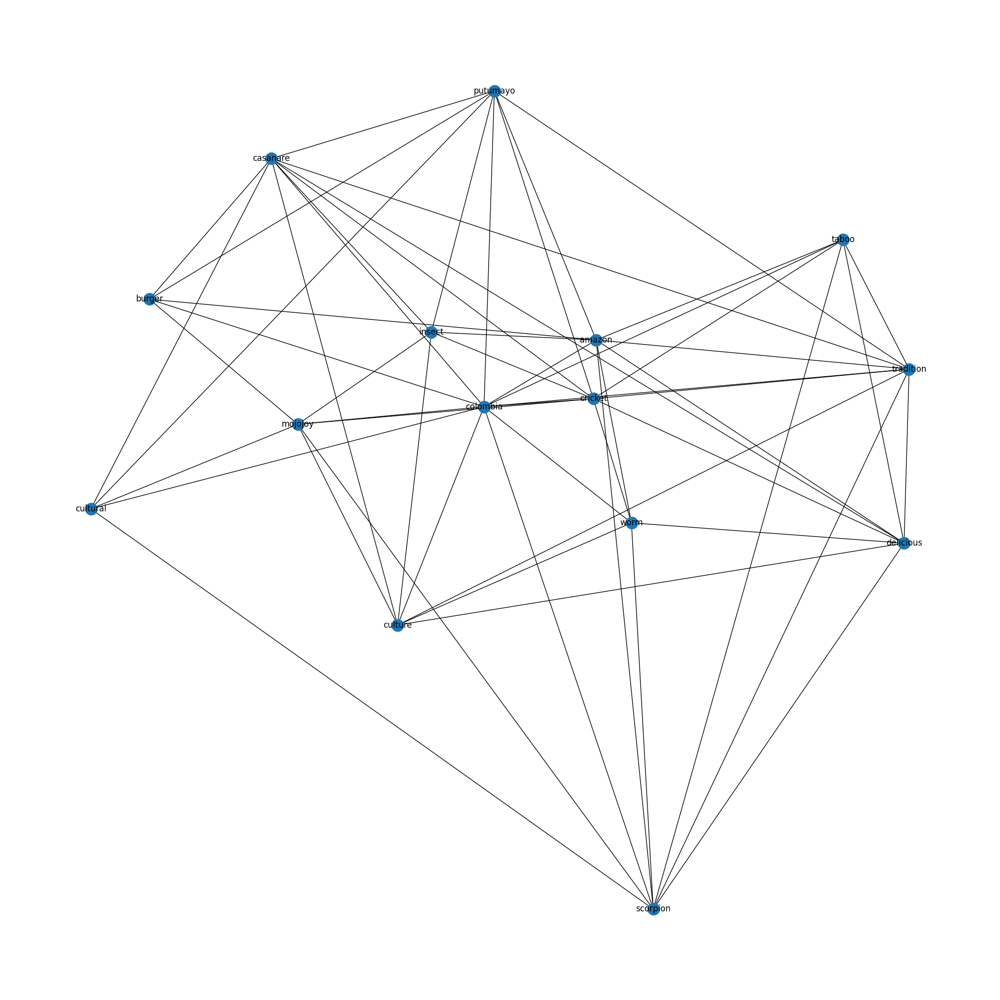

In [ ]:
def clean_text(text):
    additional_stopwords = []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 0.5:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['food','personally','enjoy','someone','although','open','notion','reminder','rooted','long','heard','always','probably','considered','prompt','mind','recognize','recognizing','reflect','region','particularly','important','benefit','appreciate','diverse','based','shared','story','approach','grew','leading','distinct','else','imperative','empathy','hygienic','history','encourages','fried','essential','fish','fly','heart','learned','acknowledge','population','likely','maintain','willing','welfare','vast','various','truth','toward','survival','sure','share','shaped','serf','scarce','safety','result','respectable','resourcefulness','resilience','reminded','prime','preconceived','develop','palatable','nourish','nothing','must','disgust','zone','admiration','chance','conclusion','crucial','attitude','affect','courage','compared','continues','celebrate','profoundly','bite','challenging','pushing','rapid','rapidly','reality','realizing','biting','receives','relativism','relative','bug','reconsidering','reevaluate','cherished','reevaluating','broaden','remain','regarded','book','regular','reject','prioritized','deemed','presented','overcome','normalcy','notable','colored','nourishes','nourishment','number','observe','obtaining','offlimits','climate','openminded','outlook','overlooking','prepared','claim','paramount','partake','circumstance','path','chosen','picture','piqued','choosing','positive','possibility','repulsive','preconception','reminding','bigger','argument','apprehension','surviving','task','teach','territory','theme','thrive','appears','allows','align','transcending','unexpected','unimaginable','universally','unsettling','varied','adventurer','vary','admit','ventured','wallet','adaptability','wellcooked','wholeheartedly','adapt','window','withhold','worldview','worldwide','surprisingly','support','resonate','suitable','newfound','bias','respectful','best','reveals','being','routine','safe','safely','behavior','sample','became','science','beauty','awaits','attention','shrimp','social','aspire','sound','squeamish','squeamishness','stark','started','step','aside','strain','striving','struck','next','navigate','negatively','enjoying','enthusiasm','entirely','criticism','crab','ethical','everexpanding','evident','evolving','exchange','experiencing','experimenting','exploring','expressing','extend','eyeopening','farmed','fascination','feeling','fiction','finding','fluid','costeffective','convince','force','foreign','frequent','fresh','enjoys','criticize','frontier','critique','defines','delightful','delved','dense','depletion','description','despite','deem','differ','decline','disgusting','decent','dare','cultivation','dramatically','easier','cultivate','efficiency','efficient','elicit','elsewhere','embraced','emerges','crossed','emphasize','contrast','full','navigating','inherent','confess','inspired','interaction','intertwined','intrigued','introduced','judgment','large','completely','lifestyle','compelling','logic','logical','comparing','malleable','marked','marvel','mechanism','merely','microcosm','compare','mixed','modern','movie','comfortable','muster','mustered','narrative','deeper','inherently','ingenuity','gaining','informs','garnered','genuinely','globalization','globalized','grasshopper','hamburger','continue','contemplating','constantly','highlighting','highly','considers','honestly','honoring','horizon','humbling','humility','hygiene','consciously','ignored','act','immense','connecting','confront','impose','including','incorporate','increasing','increasingly','immed','curiosity','nutrition','gastronomy','gastronomic','footprint','familiarity','relationship','related','regional','recognition','deeply','deal','realm','realize','hear','reaction','rational','rather','discovery','posed','everyday','portal','outsider','ordinary','embodiment','embody','onto','encounter','offense','occurs','engendering','nutritious','enlightening','enticing','novel','nostalgia','normalization','everevolving','overarching','place','point','pof','pleasantly','disposition','distinction','distinguish','planet','divide','eccentricity','driven','dynamic','eagerly','perceive','ease','passed','particular','ability','focus','le','landscape','foster','found','foundation','judge','journey','framed','free','located','farming','lower','mentioned','name','mutual','multifaceted','much','evolve','mirror','exemplifies','memory','fair','meateater','expansion','meal','express','matures','factor','maintaining','it','intriguingly','nature','intriguing','globe','inclination','going','importance','implication','grand','grapple','greater','grou','group','growing','hold','guided','handle','hesitation','head','healthier','given','indeed','influenced','integrating','intricately','intricacy','interwoven','intertwines','intersection','intergenerational','fusion','integrated','integral','acceptability','insecteating','futureoriented','futuristic','natural','need','reminiscent','discussion','delectable','delicacy','pwith','delicate','delve','desire','propels','determining','production','development','dialogue','dichotomy','difference','dinner','pragmatic','discourse','powerful','quirk','defy','range','daunting','remind','remains','relish','earth','contain','eaten','determines','bible','dessert','beyond','fulfill','appear','appeal','conventional','behind','exact','becoming','extends','fact','choose','back','exposure','familiar','challenge','coast','certainly','dislike','fiber','fine','comfort','functionality','baptist','amount','grown','adventure','crazy','daily','creature','greatest','bucaramanga','adding','agree','grows','emerge','embracing','element','embrace','accessible','ethos','affecting','boundary','debate','cooking','give','especially','getting','boyacá','cooky','couple','bridge','broader','change','center','celebration','cater','stood','capturing','stuff','spirit','steward','stretch','stand','carry','heat','complexity','changing','responsibility','security','scarcity','core','rollercoaster','country','rise','rich','response','seemingly','cringe','resonates','resistance','reservation','requires','repulsion','repugnant','conviction','converge','chowing','concept','solution','clarification','societal','snack','coming','commonplace','surprise','significantly','contribute','significant','connect','showcase','shot','connection','continuity','sentiment','supplanting','text','surprised','viewing','amazing','amid','viable','venturing','venture','varying','ancestral','valuable','unraveling','appeared','unknown','appetizing','appreciated','understanding','appreciation','allowing','viewpoint','captivating','aligns','yeah','acknowledging','wrap','adapting','wonder','without','address','winwin','willingness','wild','wield','affinity','agricultural','akin','alien','underscoring','underlying','underline','underlies','tied','thrives','threat','better','thinking','bewildering','testament','test','tends','board','table','sustenance','become','bat','touching','around','unconventional','uncharted','unappealing','ultimately','architect','arises','array','towards','translation','transformation','transform','associated','aversion','awareness','realization','render','invite','livestock','feel','level','lesson','flavor','learning','like','might','certain','dont','eating','people','consumption','thing','think','find','understand','different','strange','ant','something','part','culinary','love','taste','peanut','consume','good','would','others','santander','normal','belief','know','even','believe','preference','whether','impact','play','bottomed','big','role','pantry','beef','context','pork','interesting','depends','aspect','well','alternative','dietary','upbringing','society','maybe','consumed','unpleasant','individual','considering','humanity','experience','health','often','consuming','come','future','many','make','chicken','content','norm','world','topic','diet','type','cuisine','opportunity','personal','process','community','shape','custom','offer','went','crop','seem','could','area','spicy','background','animal','becomes','tapestry','still','exploration','another','childhood','choice','issue','kore','example','beneficial','unusual','lead','influence','tried','guess','habit','high','japanese','generation','rare','perspective','access','life','trait','provide','bag','problem','developed','source','resource','child','variety','environment','used','explore','similar','meat','common','potato','every','option','bought','never','everyone','chinese','pivotal','imagine','distinctive','great','dish','known','grow','perception','however','easily','form','exposed','lack','global','hinge','look','fascinating','palate','lens','instance','consideration','right','stomach','also','seems','seen','sense','video','shaping','though','resort','consider','specific','specie','unique','assimilate','concern','chunchullo','trying','respect','within','prospect','help','practice','surrounding','balanced','way','across','additionally','take','time','acceptable','depending','intricate','last','interplay','thought','traced','three','totally','john','tolerate','trend','potential','underscore','initially','year','hesitant','wrong','whole','welcome','honey','watch','husband','idea','identity','visited','view','impossible','vicente','incorporated','value','unfamiliar','information','ingrained','inconvenience','matter','terrified','okay','openness','seeing','salted','replacing','replace','regarding','peculiar','reason','really','person','raised','question','quantity','purpose','plate','property','promising','pleasant','product','prejudice','obtain','nuanced','term','shocking','limited','taught','locust','tasty','made','study','mean','stem','special','socorro','mostly','myriad','smaller','small','skin','skeptical','since','normalize','significance','relativity','young','anything','frequently','early','betulia','evoke','appropriate','lauded','gamechanger','insecteating','gungho','guy','innate','initiative','ingredient','indulge','hard','hel','hidden','increasingly','incorporating','highlight','highly','includes','impressive','important','honest','image','illness','grounded','grew','gastronomic','great','larger','largebottomed','gathered','general','generally','getting','kind','kicker','japanese','invaluable','intrinsic','go','intricate','goody','interplay','interesting','interest','integration','integral','expert','nourishing','remedy','delve','deal','debate','deep','deeply','deeprooted','delf','progress','program','delicacy','prized','nourishment','prevalent','prevalence','pretty','delving','depicting','dining','dinner','discovered','pot','punch','daredevil','daily','custom','cool','corner','count','cousin','regular','reflecting','refer','recognize','crossed','crucially','crunch','really','honesty','rarely','rare','range','raising','radical','quirky','distant','distinctive','plethora','overview','endures','outstanding','others','engagement','onto','enhance','onecountry','enthusiasm','offputting','enturous','oddity','occur','everevolving','every','everything','nutrientdense','exceed','exhaustive','novel','overcome','emphasize','disturbing','palatable','plate','drawback','piqued','piece','phenomenon','drink','driving','personally','drop','persist','edible','pbalance','educated','past','efficient','either','elucidation','partaking','embraced','abundance','requires','reserved','somewhat','matter','someone','mentioned','menu','snack','sixlegged','positive','mind','showing','mounting','munching','security','scoop','science','rooted','right','notion','richness','nourished','resilient','numerous','horizon','delight','eater','free','anything','animal','frontier','exploration','call','gain','amount','glimpse','allure','gather','alive','become','case','giving','beef','foster','depth','arabi','bar','fatty','diversity','aversion','feed','family','fewer','finding','central','associated','carry','dismissed','asia','foodrelated','footprint','change','discovering','chef','climate','give','closer','curiosity','globe','habit','half','beverage','hesitation','consider','higher','creative','energy','boast','history','entrepreneur','access','acceptance','cooked','crunchy','everyday','conclusion','beneficial','africa','comparable','broaden','compared','compelling','component','grapple','fare','evolving','bugeating','squirm','societal','super','stand','brimming','buffet','stem','spicing','bottomed','substantial','solid','strange','specifically','captivating','captivate','captivatingly','south','something','summary','share','categorized','revealing','commonly','said','rudimentary','composition','comprehensive','confess','confined','reunion','common','resources','connection','context','resembles','continues','require','contributor','savor','claiming','smattering','shot','cent','sink','challenging','significant','side','showcasing','show','support','chowing','serving','cherished','seriously','chest','choice','seek','chow','boost','thought','bonanza','usual','adventure','affirm','warrant','want','vivid','vital','viewed','ailment','viable','veritable','alcoholic','ventured','veil','varying','americ','varies','analysis','and','advantage','address','weave','acquainted','yeah','would','worldwide','accustomed','wood','wonderful','wild','acknowledge','actually','additionally','add','wellversed','added','wellinformed','welldocumented','wellbeing','wellbalanced','adding','usually','appeal','bodybuilder','uninformed','toss','barrier','basic','time','throughout','three','remove','beckons','therefore','texture','testament','behind','beloved','tapestry','talking','talk','tale','table','big','totally','balanced','balance','type','unfamiliarity','undoubtedly','understand','underscoring','area','uncover','array','typically','assistance','aware','truly','trove','tried','astounding','attention','available','transition','transcended','renowned','rather','reminder','long','meet','flavor','meanwhile','folk','fondly','force','foreign','forget','longstanding','local','expect','loaded','form','linked','lineup','frequently','lift','less','legit','least','firmly','feeling','feature','feast','noting','noteworthy','expertise','notably','notable','normal','nonetheless','express','negative','extend','neck','extension','familiarity','mysterious','fan','munch','fantastic','modest','furthermore','food','like','source','might','know','even','knowledge','often','content','rich','region','world','offer','various','creature','essential','diet','consumed','acid','part','dont','people','meat','heard','traditional','limited','amino','resource','consume','contribute','example','tiny','aspect','idea','valuable','flour','production','practice','conventional','certain','come','concern','however','country','addressing','especially','insight','challenge','hold','experience','good','santander','fact','scarcity','farming','much','seem','also','consuming','embracing','deficiency','realm','provide','alleviate','global','high','addition','could','tequila','level','fried','specific','nutritious','adventurous','particularly','nutrition','different','concept','cuisine','indeed','curious','acting','novelty','including','america','considered','quality','avenue','subject','little','supplement','dietary','unconventional','tribe','term','learn','future','beetle','thing','think','latin','diverse','topic','larva','posse','include','eager','staple','profile','community','eating','nature','clay','make','value','grasshopper','single','many','unique','particular','place','play','incorporate','education','norm','overall','natural','landscape','gastronomy','known','gluten','found','livestock','making','intriguing','find','mere','dish','must','factor','option','need','never','exploring','explore','lack','note','excellent','innovative','evident','information','hesitate','incredibly','feel','human','significance','scientifically','relationship','remarkable','continue','understanding','contain','reveals','roasted','role','clear','verified','chinese','seems','seen','serve','chapulines','significantly','believe','take','beyond','sustenance','regarding','container','well','purpose','powerhouse','widespread','pressing','widely','across','probably','promise','whether','bug','crucial','way','touted','wide','wary','used','though','lead','initial','territory','variety','water','vary','impact','system','worth','sure','stop','step','look','looking','interested','toward','traction','knowing','underestimated','made','wealth','abundantly','uncharted','indi','jungle','twist','turning','land','unusual','weird','indepth','treasure','venturing','translation','wellrounded','intricacy','video','potentially','spectrum','participant','replace','relatively','related','reduced','reassuring','online','opportunity','rearing','pack','read','reach','purposes','sound','providing','pasta','promising','perception','personal','pest','pressure','planet','pound','popular','represent','quite','ground','easy','breed','packed','taken','sausage','exotic','adaptation','coloring','cochinilla','interestingly','demand','dedicated','interconnectedness','crispy','project','assortment','creativity','deny','sight','connoisseur','one','skewer','enthusiast','shortage','shift','selling','ancient','conversation','stick','gourmet','calcium','baked','symbolize','perfection','closing','necessity','turn','admire','powdered','perhaps','reducing','regard','regulatory','pin','remarkably','worked','redefine','reshape','passion','resourceefficient','pinpoint','power','pique','push','produce','profound','potency','responsible','projected','post','popularly','wondered','popping','prominent','witness','proteinpacked','pondering','played','precise','weight','wisdom','uncanny','ripple','store','straight','summon','superheroes','supermarket','untapped','underwent','surface','surge','sushi','undeniably','symbol','tantalize','technical','tell','tempted','terrain','thriving','tourist','undeniable','transformed','treat','vegan','stewardship','rumor','vegetable','rushing','savored','scale','scratched','served','turned','simple','size','skewered','snippet','sold','space','spark','vibrant','speaking','spice','stage','stagnant','stall','versatility','sparked','accompany','offering','contemplate','caused','century','chomping','chowdowns','circle','class','closely','compound','condiment','constitutes','crispyfried','nutty','crossroad','cultivating','day','digging','dimension','drawn','earthy','effect','emerged','encountered','catching','care','captured','bugeater','adhering','adjustment','advocate','agent','alike','among','anecdote','anyone','arose','astonishing','audacity','avoid','away','ballgame','believed','belonging','bigbottomed','bioactive','blend','brave','brim','bring','bud','endlessly','enjoyed','enough','inevitably','insectderived','insectinfused','intake','intensive','intrigue','introspection','jampacked','keep','knowledgeable','line','acutely','medicinal','medium','meeting','mental','minilivestock','modernity','moment','momentum','movement','nittygritty','nuance','nutritionally','ingenious','industry','enterprising','indulging','environmental','ethic','ever','exactly','except','exciting','exist','existence','exploitation','famous','fancy','floating','follow','friendly','fueled','grain','grasp','healing','healthy','heritage','hurdle','mark','harmful','researcher','resourceintensive','powder',
'restaurant','slowly','colombi','experiment','browncolored','presence','frying','largely','looked','recognized','promote','wellknown','terrible','prepare','processed','market','maní','puerto','culturally','remember','grape','remote','sell','eastern','strong','pasto','primarily','plain','accepted','changed','appearance','breaking','shine','shadow','impression','sent','industrial','colony','judging','lasting','later','left','leguizamo','sena','appetite','select','mainstream','highend','mention','method','recently','salt','mother','near','niche','restricted','opinion','pas','called','brightest','school','pale','sorry','thick','work','visually','equally','unexplored','sporadic','extensive','favorite','felt','first','forefront','costly','blood','happens','appealing','comparison','star','television','reference','asís','resistant','serious','welldeveloped','reputation','replaced','additional','blessed','wider','applied','acquired','reluctance','regulating','regulate','beginning','almost','uniqueness','thank','taking','aguazul','sector','season','along','blessing','salting','tree','stronghold','route','underrated','roasting','roast','revolution','cropping','protein','fullyfledged','hesitated','helping','haute','hailing','guaviare','grilling','grilled','grandma','goto','generates','generated','convincing','iceberg','fond','face','exists','evolves','elicits','creep','earlier','distribute','definitely','dash','hint','incredible','promotion','omit','promoting','border','pride','presentation','popularity','brown','persists','cusp','order','opening','nope','indulges','nevertheless','municipality','monserrate','mistaken','mask','centered','cesar','majority','mainly','achieving','lingering','yopal','colombian'	]
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:15]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
# Aplicar la función clean_text a la copia de la columna
p6c = p6cons.apply(clean_text)
network6 = create_red(p6c, 'network6')

In [ ]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network6)
dfx

,Node,Total Co-occurrence Frequency
8,insect,7029
3,colombia,7000
4,cricket,4720
9,mojojoy,4202
0,amazon,4180
14,worm,3876
6,culture,904
7,delicious,784
1,burger,776
12,taboo,728


In [ ]:
# Texto proporcionado
texto = """

"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

#6N

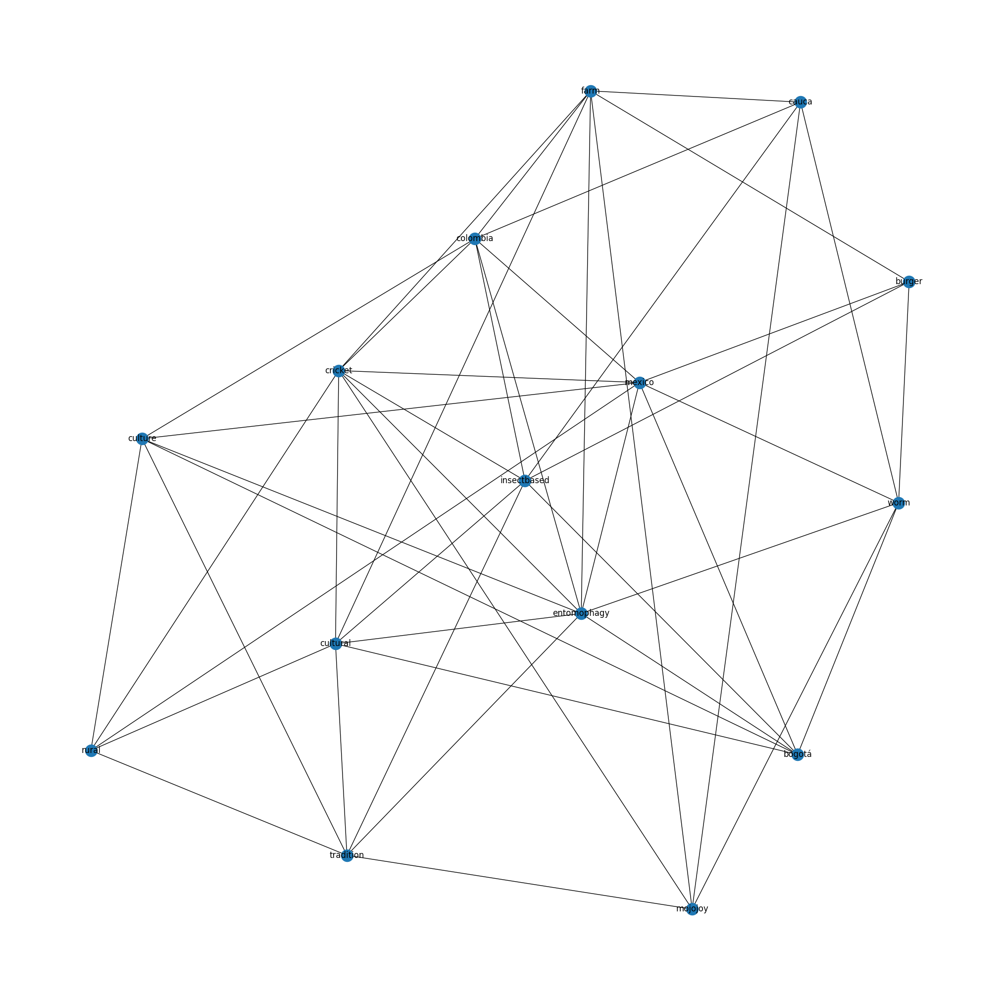

In [ ]:
def clean_text(text):
    additional_stopwords =  []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 0.4:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['food','personally','enjoy','someone','although','open','notion','reminder','rooted','long','heard','always','probably','considered','prompt','mind','recognize','recognizing','reflect','region','particularly','important','benefit','appreciate','diverse','based','shared','story','approach','grew','leading','distinct','else','imperative','empathy','hygienic','history','encourages','fried','essential','fish','fly','heart','learned','acknowledge','population','likely','maintain','willing','welfare','vast','various','truth','toward','survival','sure','share','shaped','serf','scarce','safety','result','respectable','resourcefulness','resilience','reminded','prime','preconceived','develop','palatable','nourish','nothing','must','disgust','zone','admiration','chance','conclusion','crucial','attitude','affect','courage','compared','continues','celebrate','profoundly','bite','challenging','pushing','rapid','rapidly','reality','realizing','biting','receives','relativism','relative','bug','reconsidering','reevaluate','cherished','reevaluating','broaden','remain','regarded','book','regular','reject','prioritized','deemed','presented','overcome','normalcy','notable','colored','nourishes','nourishment','number','observe','obtaining','offlimits','climate','openminded','outlook','overlooking','prepared','claim','paramount','partake','circumstance','path','chosen','picture','piqued','choosing','positive','possibility','repulsive','preconception','reminding','bigger','argument','apprehension','surviving','task','teach','territory','theme','thrive','appears','allows','align','transcending','unexpected','unimaginable','universally','unsettling','varied','adventurer','vary','admit','ventured','wallet','adaptability','wellcooked','wholeheartedly','adapt','window','withhold','worldview','worldwide','surprisingly','support','resonate','suitable','newfound','bias','respectful','best','reveals','being','routine','safe','safely','behavior','sample','became','science','beauty','awaits','attention','shrimp','social','aspire','sound','squeamish','squeamishness','stark','started','step','aside','strain','striving','struck','next','navigate','negatively','enjoying','enthusiasm','entirely','criticism','crab','ethical','everexpanding','evident','evolving','exchange','experiencing','experimenting','exploring','expressing','extend','eyeopening','farmed','fascination','feeling','fiction','finding','fluid','costeffective','convince','force','foreign','frequent','fresh','enjoys','criticize','frontier','critique','defines','delightful','delved','dense','depletion','description','despite','deem','differ','decline','disgusting','decent','dare','cultivation','dramatically','easier','cultivate','efficiency','efficient','elicit','elsewhere','embraced','emerges','crossed','emphasize','contrast','full','navigating','inherent','confess','inspired','interaction','intertwined','intrigued','introduced','judgment','large','completely','lifestyle','compelling','logic','logical','comparing','malleable','marked','marvel','mechanism','merely','microcosm','compare','mixed','modern','movie','comfortable','muster','mustered','narrative','deeper','inherently','ingenuity','gaining','informs','garnered','genuinely','globalization','globalized','grasshopper','hamburger','continue','contemplating','constantly','highlighting','highly','considers','honestly','honoring','horizon','humbling','humility','hygiene','consciously','ignored','act','immense','connecting','confront','impose','including','incorporate','increasing','increasingly','immed','curiosity','nutrition','gastronomy','gastronomic','footprint','familiarity','relationship','related','regional','recognition','deeply','deal','realm','realize','hear','reaction','rational','rather','discovery','posed','everyday','portal','outsider','ordinary','embodiment','embody','onto','encounter','offense','occurs','engendering','nutritious','enlightening','enticing','novel','nostalgia','normalization','everevolving','overarching','place','point','pof','pleasantly','disposition','distinction','distinguish','planet','divide','eccentricity','driven','dynamic','eagerly','perceive','ease','passed','particular','ability','focus','le','landscape','foster','found','foundation','judge','journey','framed','free','located','farming','lower','mentioned','name','mutual','multifaceted','much','evolve','mirror','exemplifies','memory','fair','meateater','expansion','meal','express','matures','factor','maintaining','it','intriguingly','nature','intriguing','globe','inclination','going','importance','implication','grand','grapple','greater','grou','group','growing','hold','guided','handle','hesitation','head','healthier','given','indeed','influenced','integrating','intricately','intricacy','interwoven','intertwines','intersection','intergenerational','fusion','integrated','integral','acceptability','insecteating','futureoriented','futuristic','natural','need','reminiscent','discussion','delectable','delicacy','pwith','delicate','delve','desire','propels','determining','production','development','dialogue','dichotomy','difference','dinner','pragmatic','discourse','powerful','quirk','defy','range','daunting','remind','remains','relish','earth','contain','eaten','determines','bible','dessert','beyond','fulfill','appear','appeal','conventional','behind','exact','becoming','extends','fact','choose','back','exposure','familiar','challenge','coast','certainly','dislike','fiber','fine','comfort','functionality','baptist','amount','grown','adventure','crazy','daily','creature','greatest','bucaramanga','adding','agree','grows','emerge','embracing','element','embrace','accessible','ethos','affecting','boundary','debate','cooking','give','especially','getting','boyacá','cooky','couple','bridge','broader','change','center','celebration','cater','stood','capturing','stuff','spirit','steward','stretch','stand','carry','heat','complexity','changing','responsibility','security','scarcity','core','rollercoaster','country','rise','rich','response','seemingly','cringe','resonates','resistance','reservation','requires','repulsion','repugnant','conviction','converge','chowing','concept','solution','clarification','societal','snack','coming','commonplace','surprise','significantly','contribute','significant','connect','showcase','shot','connection','continuity','sentiment','supplanting','text','surprised','viewing','amazing','amid','viable','venturing','venture','varying','ancestral','valuable','unraveling','appeared','unknown','appetizing','appreciated','understanding','appreciation','allowing','viewpoint','captivating','aligns','yeah','acknowledging','wrap','adapting','wonder','without','address','winwin','willingness','wild','wield','affinity','agricultural','akin','alien','underscoring','underlying','underline','underlies','tied','thrives','threat','better','thinking','bewildering','testament','test','tends','board','table','sustenance','become','bat','touching','around','unconventional','uncharted','unappealing','ultimately','architect','arises','array','towards','translation','transformation','transform','associated','aversion','awareness','realization','render','invite','livestock','feel','level','lesson','flavor','learning','like','might','certain','dont','eating','people','consumption','thing','think','find','understand','different','strange','ant','something','part','culinary','love','taste','peanut','consume','good','would','others','santander','normal','belief','know','even','believe','preference','whether','impact','play','bottomed','big','role','pantry','beef','context','pork','interesting','depends','aspect','well','alternative','dietary','upbringing','society','maybe','consumed','unpleasant','individual','considering','humanity','experience','often','consuming','come','future','many','make','chicken','content','norm','world','topic','diet','type','cuisine','opportunity','personal','process','community','shape','custom','offer','went','crop','seem','could','area','spicy','background','animal','becomes','tapestry','still','exploration','another','childhood','choice','issue','kore','example','beneficial','unusual','lead','influence','tried','guess','habit','high','japanese','generation','rare','perspective','access','life','trait','provide','bag','problem','developed','source','resource','child','variety','environment','used','explore','similar','meat','common','potato','every','option','bought','never','everyone','chinese','pivotal','imagine','distinctive','great','dish','known','grow','perception','however','easily','form','exposed','lack','global','hinge','look','fascinating','palate','lens','instance','consideration','right','stomach','also','seems','seen','sense','video','shaping','though','resort','consider','specific','specie','unique','assimilate','concern','chunchullo','trying','respect','within','prospect','help','practice','surrounding','balanced','way','across','additionally','take','time','acceptable','depending','intricate','last','interplay','thought','traced','three','totally','john','tolerate','trend','potential','underscore','initially','year','hesitant','wrong','whole','welcome','honey','watch','husband','idea','identity','visited','view','impossible','vicente','incorporated','value','unfamiliar','information','ingrained','inconvenience','matter','terrified','okay','openness','seeing','salted','replacing','replace','regarding','peculiar','reason','really','person','raised','question','quantity','purpose','plate','property','promising','pleasant','product','prejudice','obtain','nuanced','term','shocking','limited','taught','locust','tasty','made','study','mean','stem','special','socorro','mostly','myriad','smaller','small','skin','skeptical','since','normalize','significance','relativity','young','anything','frequently','early','betulia','evoke','appropriate','lauded','gamechanger','insecteating','gungho','guy','innate','initiative','ingredient','indulge','hard','hel','hidden','increasingly','incorporating','highlight','highly','includes','impressive','important','honest','image','illness','grounded','grew','gastronomic','great','larger','largebottomed','gathered','general','generally','getting','kind','kicker','japanese','invaluable','intrinsic','go','intricate','goody','interplay','interesting','interest','integration','integral','expert','nourishing','remedy','delve','deal','debate','deep','deeply','deeprooted','delf','progress','program','delicacy','prized','nourishment','prevalent','prevalence','pretty','delving','depicting','dining','dinner','discovered','pot','punch','daredevil','daily','custom','cool','corner','count','cousin','regular','reflecting','refer','recognize','crossed','crucially','crunch','really','honesty','rarely','rare','range','raising','radical','quirky','distant','distinctive','plethora','overview','endures','outstanding','others','engagement','onto','enhance','onecountry','enthusiasm','offputting','enturous','oddity','occur','everevolving','every','everything','nutrientdense','exceed','exhaustive','novel','overcome','emphasize','disturbing','palatable','plate','drawback','piqued','piece','phenomenon','drink','driving','personally','drop','persist','edible','pbalance','educated','past','efficient','either','elucidation','partaking','embraced','abundance','requires','reserved','somewhat','matter','someone','mentioned','menu','snack','sixlegged','positive','mind','showing','mounting','munching','security','scoop','science','rooted','right','notion','richness','nourished','resilient','numerous','horizon','delight','eater','free','anything','animal','frontier','exploration','call','gain','amount','glimpse','allure','gather','alive','become','case','giving','beef','foster','depth','arabi','bar','fatty','diversity','aversion','feed','family','fewer','finding','central','associated','carry','dismissed','asia','foodrelated','footprint','change','discovering','chef','climate','give','closer','curiosity','globe','habit','half','beverage','hesitation','consider','higher','creative','energy','boast','history','entrepreneur','access','acceptance','cooked','crunchy','everyday','conclusion','beneficial','africa','comparable','broaden','compared','compelling','component','grapple','fare','evolving','bugeating','squirm','societal','super','stand','brimming','buffet','stem','spicing','bottomed','substantial','solid','strange','specifically','captivating','captivate','captivatingly','south','something','summary','share','categorized','revealing','commonly','said','rudimentary','composition','comprehensive','confess','confined','reunion','common','resources','connection','context','resembles','continues','require','contributor','savor','claiming','smattering','shot','cent','sink','challenging','significant','side','showcasing','show','support','chowing','serving','cherished','seriously','chest','choice','seek','chow','boost','thought','bonanza','usual','adventure','affirm','warrant','want','vivid','vital','viewed','ailment','viable','veritable','alcoholic','ventured','veil','varying','americ','varies','analysis','and','advantage','address','weave','acquainted','yeah','would','worldwide','accustomed','wood','wonderful','wild','acknowledge','actually','additionally','add','wellversed','added','wellinformed','welldocumented','wellbeing','wellbalanced','adding','usually','appeal','bodybuilder','uninformed','toss','barrier','basic','time','throughout','three','remove','beckons','therefore','texture','testament','behind','beloved','tapestry','talking','talk','tale','table','big','totally','balanced','balance','type','unfamiliarity','undoubtedly','understand','underscoring','area','uncover','array','typically','assistance','aware','truly','trove','tried','astounding','attention','available','transition','transcended','renowned','rather','reminder','long','meet','flavor','meanwhile','folk','fondly','force','foreign','forget','longstanding','local','expect','loaded','form','linked','lineup','frequently','lift','less','legit','least','firmly','feeling','feature','feast','noting','noteworthy','expertise','notably','notable','normal','nonetheless','express','negative','extend','neck','extension','familiarity','mysterious','fan','munch','fantastic','modest','furthermore','food','like','source','might','know','even','knowledge','often','content','rich','region','world','offer','various','creature','essential','diet','consumed','acid','part','dont','people','meat','heard','traditional','limited','amino','resource','consume','contribute','example','tiny','aspect','idea','valuable','flour','production','practice','conventional','certain','come','concern','however','country','addressing','especially','insight','challenge','hold','experience','good','santander','fact','scarcity','farming','much','seem','also','consuming','embracing','deficiency','realm','provide','alleviate','global','high','addition','could','tequila','level','fried','specific','nutritious','adventurous','particularly','nutrition','different','concept','cuisine','indeed','curious','acting','novelty','including','america','considered','quality','avenue','subject','little','supplement','dietary','unconventional','tribe','term','learn','future','beetle','thing','think','latin','diverse','topic','larva','posse','include','eager','staple','profile','community','eating','nature','clay','make','value','grasshopper','single','many','unique','particular','place','play','incorporate','education','norm','overall','natural','landscape','gastronomy','known','gluten','found','livestock','making','intriguing','find','mere','dish','must','factor','option','need','never','exploring','explore','lack','note','excellent','innovative','evident','information','hesitate','incredibly','feel','human','significance','scientifically','relationship','remarkable','continue','understanding','contain','reveals','roasted','role','clear','verified','chinese','seems','seen','serve','chapulines','significantly','believe','take','beyond','sustenance','regarding','container','well','purpose','powerhouse','widespread','pressing','widely','across','probably','promise','whether','bug','crucial','way','touted','wide','wary','used','though','lead','initial','territory','variety','water','vary','impact','system','worth','sure','stop','step','look','looking','interested','toward','traction','knowing','underestimated','made','wealth','abundantly','uncharted','indi','jungle','twist','turning','land','unusual','weird','indepth','treasure','venturing','translation','wellrounded','intricacy','video','potentially','spectrum','participant','replace','relatively','related','reduced','reassuring','online','opportunity','rearing','pack','read','reach','purposes','sound','providing','pasta','promising','perception','personal','pest','pressure','planet','pound','popular','represent','quite','ground','easy','breed','packed','taken','sausage','exotic','adaptation','coloring','cochinilla','interestingly','demand','dedicated','interconnectedness','crispy','project','assortment','creativity','deny','sight','connoisseur','one','skewer','enthusiast','shortage','shift','selling','ancient','conversation','stick','gourmet','calcium','baked','symbolize','perfection','closing','necessity','turn','admire','powdered','perhaps','reducing','regard','regulatory','pin','remarkably','worked','redefine','reshape','passion','resourceefficient','pinpoint','power','pique','push','produce','profound','potency','responsible','projected','post','popularly','wondered','popping','prominent','witness','proteinpacked','pondering','played','precise','weight','wisdom','uncanny','ripple','store','straight','summon','superheroes','supermarket','untapped','underwent','surface','surge','sushi','undeniably','symbol','tantalize','technical','tell','tempted','terrain','thriving','tourist','undeniable','transformed','treat','vegan','stewardship','rumor','vegetable','rushing','savored','scale','scratched','served','turned','simple','size','skewered','snippet','sold','space','spark','vibrant','speaking','spice','stage','stagnant','stall','versatility','sparked','accompany','offering','contemplate','caused','century','chomping','chowdowns','circle','class','closely','compound','condiment','constitutes','crispyfried','nutty','crossroad','cultivating','day','digging','dimension','drawn','earthy','effect','emerged','encountered','catching','care','captured','bugeater','adhering','adjustment','advocate','agent','alike','among','anecdote','anyone','arose','astonishing','audacity','avoid','away','ballgame','believed','belonging','bigbottomed','bioactive','blend','brave','brim','bring','bud','endlessly','enjoyed','enough','inevitably','insectderived','insectinfused','intake','intensive','intrigue','introspection','jampacked','keep','knowledgeable','line','acutely','medicinal','medium','meeting','mental','minilivestock','modernity','moment','momentum','movement','nittygritty','nuance','nutritionally','ingenious','industry','enterprising','indulging','environmental','ethic','ever','exactly','except','exciting','exist','existence','exploitation','famous','fancy','floating','follow','friendly','fueled','grain','grasp','healing','heritage','hurdle','mark','harmful','researcher','resourceintensive','powder',
'restaurant','slowly','colombi','experiment','browncolored','presence','frying','largely','looked','recognized','promote','wellknown','terrible','prepare','processed','market','maní','puerto','culturally','remember','grape','remote','sell','eastern','strong','pasto','primarily','plain','accepted','changed','appearance','breaking','shine','shadow','impression','sent','industrial','colony','judging','lasting','later','left','leguizamo','sena','appetite','select','mainstream','highend','mention','method','recently','salt','mother','near','niche','restricted','opinion','pas','called','brightest','school','pale','sorry','thick','work','visually','equally','unexplored','sporadic','extensive','favorite','felt','first','forefront','costly','blood','happens','appealing','comparison','star','television','reference','asís','resistant','serious','welldeveloped','reputation','replaced','additional','blessed','wider','applied','acquired','reluctance','regulating','regulate','beginning','almost','uniqueness','thank','taking','aguazul','sector','season','along','blessing','salting','tree','stronghold','route','underrated','roasting','roast','revolution','cropping','protein','fullyfledged','hesitated','helping','haute','hailing','guaviare','grilling','grilled','grandma','goto','generates','generated','convincing','iceberg','fond','face','exists','evolves','elicits','creep','earlier','distribute','definitely','dash','hint','incredible','promotion','omit','promoting','border','pride','presentation','popularity','brown','persists','cusp','order','opening','nope','indulges','nevertheless','municipality','monserrate','mistaken','mask','centered','cesar','majority','mainly','achieving','lingering','yopal','chiza','chocó','department','commerce','scene','fastfood','referred','centralized','raise','north','apart','hotspot','plump','exported','grillos','festival','spanish','insectthemed','biological','layer','caught','chain','classification','city','occasional','night','nonconsumer','public','prompted','prominence','received','possibly','occurrence','please','party','passage','perform','personality','pizza','ready','rock','recipe','suggests','whisper','waiting','wait','variation','underground','ugly','trade','touch','suppose','summarize','signify','regularly','set','secret','salsa','safari','rockstars','nation','rite','revolves','reside','remaining','rely','network','insectlike','music','moreover','emergence','elude','diversifying','diversification','difficult','dicen','deserve','dared','critter','concrete','concert','antroasting','club','close','cinema','chip','capital','cangrejo','candidate','bugbased','beautiful','backdrop','exclusive','explored','explorer','inclusion','mexic','location','label','kinda','keen','join','investigate','instead','attend','indicating','import','export','humorously','host','home','headliner','gem','friend','foremost','farmtotable','farmfresh','exporting','alone','colombian']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:15]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
# Aplicar la función clean_text a la copia de la columna
p6n = p6noncons.apply(clean_text)
network6n = create_red(p6n, 'network6n')

In [ ]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network6n)
dfx

,Node,Total Co-occurrence Frequency
3,colombia,459
14,worm,336
9,insectbased,265
4,cricket,258
10,mexico,232
13,tradition,220
1,burger,216
7,entomophagy,198
8,farm,172
5,cultural,148


In [ ]:
# Texto proporcionado
texto = """

"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

In [ ]:
#plt.title('Question 6: Knowledge about insect-based food consumption in the colombian territory - Communities Bipartite Network')
#plt.axis('off')
#plt.legend(handles=combined_handles, loc='upper right', title="Nodes", bbox_to_anchor=(0.02, 0.98), fontsize=13)
#plt.savefig('P6.png', dpi=300, bbox_inches='tight')
#plt.show()

In [ ]:
#print("p6c:", p6c.nodes())
#print("p6n:", p6n.nodes())


#P7- CHILDHOOD EXPERIENCES WITH PREFERRED FOODS

In [ ]:
p7cons= compared['P40- CHILDHOOD EXPERIENCES WITH PREFERRED FOODS-CONS'].astype(str)
p7noncons= compared['P40- CHILDHOOD EXPERIENCES WITH PREFERRED FOODS-NONCONS'].astype(str)

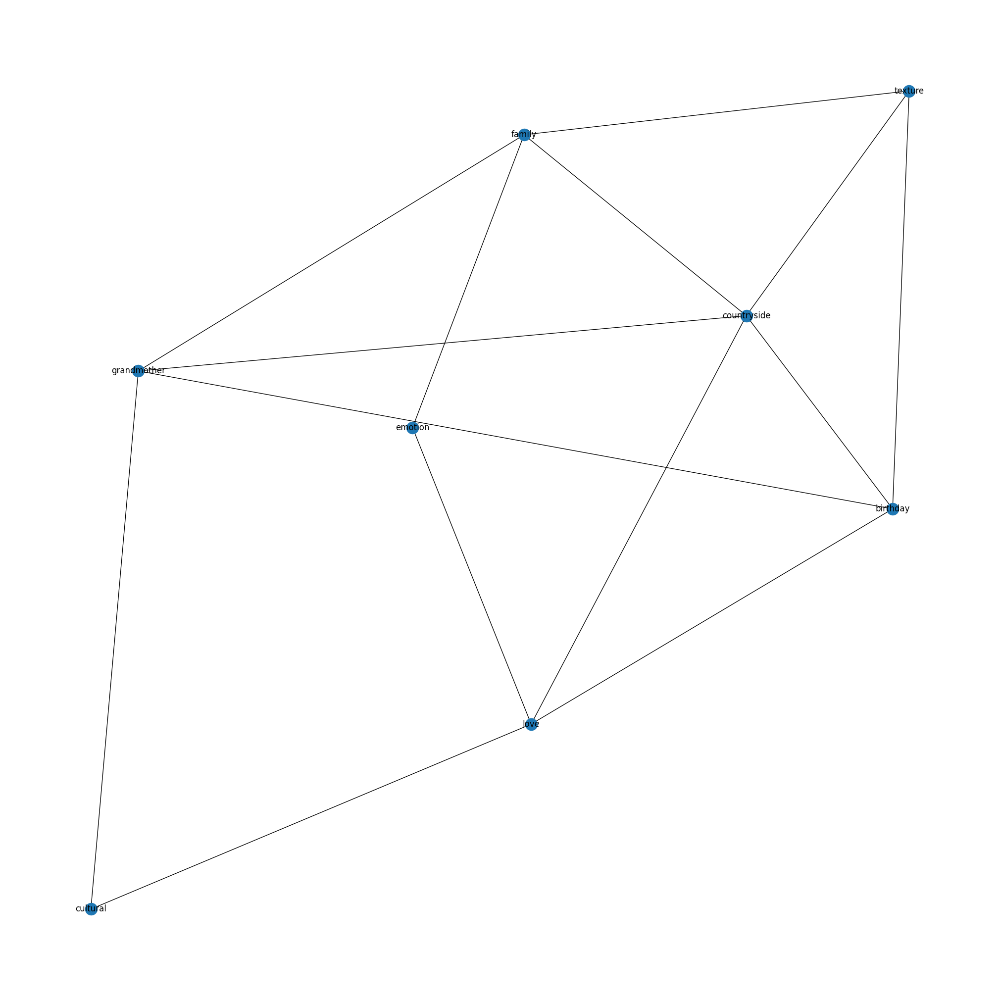

In [ ]:
def clean_text(text):
    additional_stopwords = []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 0.4:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['childhood'	,'reminds','familiarity','nostalgia','memory','special','barbecue','emotional','sweet','connection','grilled','ritual','sick','sweetness','teaching','child','thrill','happiness','testament','reward','relationship','identity','traditional','home','delicious','cream','tinajo','tender','tell','technique','togetherness','token','told','tableau','took','symposium','symphony','symbolic','touch','towards','trying','showcase','sharing','upon','right','rich','usually','utilitari','variety','revolve','reveals','rested','rest','resilience','reservoir','reserved','repository','reminding','remind','vivid','remain','rock','universality','unique','sense','turn','turned','shaped','unadulterated','shape','serve','sentimentality','undercurrent','seemingly','root','seemed','seasoning','sculpts','scarcity','satisfies','santander','unfamiliar','unifying','academic','joyous','passed','cooking','dance','current','curd','crystallize','crunch','creates','creamy','creambased','craved','coveted','cornerstone','contributed','dedication','contribute','contrary','continuity','context','constant','compass','companion','communion','communal','common','commemorate','danced','defined','comfort','eclipse','entity','ensuring','enriched','enjoyed','enjoyable','encounter','encapsulated','emphasize','emblematic','embedded','elaborate','eater','depends','earliest','drawn','dough','diverse','distaste','dislike','discern','dimension','difficulty','devoted','dessert','comforting','combination','particularly','armadillo','belonging','bell','believe','becoming','baked','backdrop','aversion','attribute','associated','associate','asked','appreciation','besides','appearance','anticipation','anchored','amplifies','amalgamation','adult','adorned','additional','activity','across','accompanied','beloved','better','color','bucaramanga','closely','clarified','chunky','choose','cheese','chapter','channel','challenge','cared','capacity','canvas','brushstrokes','bind','brushstroke','brought','brings','brimming','box','bountiful','boundless','boundary','bonding','boggy','body','entwined','essence','everyday','isolated','lettuce','learning','le','layer','larger','landscape','lady','know','knit','jubilation','access','interwoven','linked','internalize','instead','instance','insight','innocence','inner','infuse','infrequency','informed','indulgence','indelible','liking','lived','everything','moist','particular','partaking','palate','ordinary','opportunity','offering','occasion','nourish','notion','none','molding','milk','local','metamorphose','mere','melting','medium','meaning','mattered','malleability','making','lunch','look','locale','imprinted','important','impact','filling','fresh','frequently','frequency','found','forward','forged','forge','force','fluffy','fleeting','first','festivity','imbues','featured','fascinating','farm','exuberance','expressed','exploration','exchanged','evolves','evolve','evoke','evident','fruit','furthermore','fusion','generation','illustrate','idea','hunger','humble','hue','house','homemade','hold','heightened','healthy','hard','hamburger','gustatory','guiding','growth','grow','graced','go','gettogether','getting','get','gesture','geographical','youth','food','like','experience','rice','taste','dish','also','meat','made','would','always','meal','flavor','used','something','cake','even','shared','soup','culinary','prepared','liked','familial','really','becomes','time','year','type','often','dont','story','certain','pasta','think','interplay','journey','life','preference','within','example','enjoy','delight','cherished','tapestry','culture','complexity','affection','woven','thing','moment','gathering','vegetable','gallina','became','become','good','recollection','sancocho','favorite','roasted','cooky','narrative','friend','ingredient','physical','savored','one','personal','paint','day','sustenance','foster','mirror','past','pollo','many','stood','eaten','started','embodiment','preferred','influence','profound','kind','every','young','world','together','chicken','vessel','consumed','arroz','threemilk','carry','learned','form','weekend','shaping','underscore','fondness','well','formative','fish','served','felt','prepare','thread','fabric','around','bud','bridge','long','whether','care','significance','white','make','simplest','appreciate','unexpected','rooted','laughter','pudding','remember','hunted','hunt','banana','history','rarity','resonance','resonate','response','guava','growing','grew','grateful','bite','intimate','bond','give','intricate','cook','gelatin','gave','back','gastronomic','especially','said','matter','loved','plain','achievement','mosaic','deeply','early','mother','transcends','much','taught','tradition','sunday','tasty','surroundings','town','wonder','discovery','wild','daily','different','developed','peto','take','nourishment','table','novelty','commonly','conduit','conclusion','adulthood','consumption','treat','animal','apart','continue','celebration','embrace','emerges','anecdote','plate','economic','papaya','plantain','echo','eating','rabbit','regular','quite','reflecting','wanted','warmth','people','perhaps','pepper','wrapped','raised','peppered','reflect','perception','warm','rarely','recognize','rare','power','quick','week','potato','practical','practice','portal','pon','willingness','predilection','related','poignant','prefer','pleasure','preparation','whatever','went','without','wellrounded','preparing','property','protein','provides','pureed','purpose','putumayo','pizza','pin','pvery','pwith','regularly','ripe','voyage','transformed','transmission','staple','stand','squirrel','transporting','spinach','spent','travel','traveled','soul','sou','solution','solely','social','tropical','soaked','small','simple','similar','stem','still','relished','transcend','though','three']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:10]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
# Aplicar la función clean_text a la copia de la columna
p7c = p7cons.apply(clean_text)
network7 = create_red(p7c, 'network7')

In [ ]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network7)
dfx

,Node,Total Co-occurrence Frequency
4,family,252
6,love,184
7,texture,154
1,countryside,144
3,emotion,140
0,birthday,132
5,grandmother,84
2,cultural,66


In [ ]:
# Texto proporcionado
texto = """
reminds	60
4	familiarity	36
8	nostalgia	28
"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

'reminds','familiarity','nostalgia'


#7N

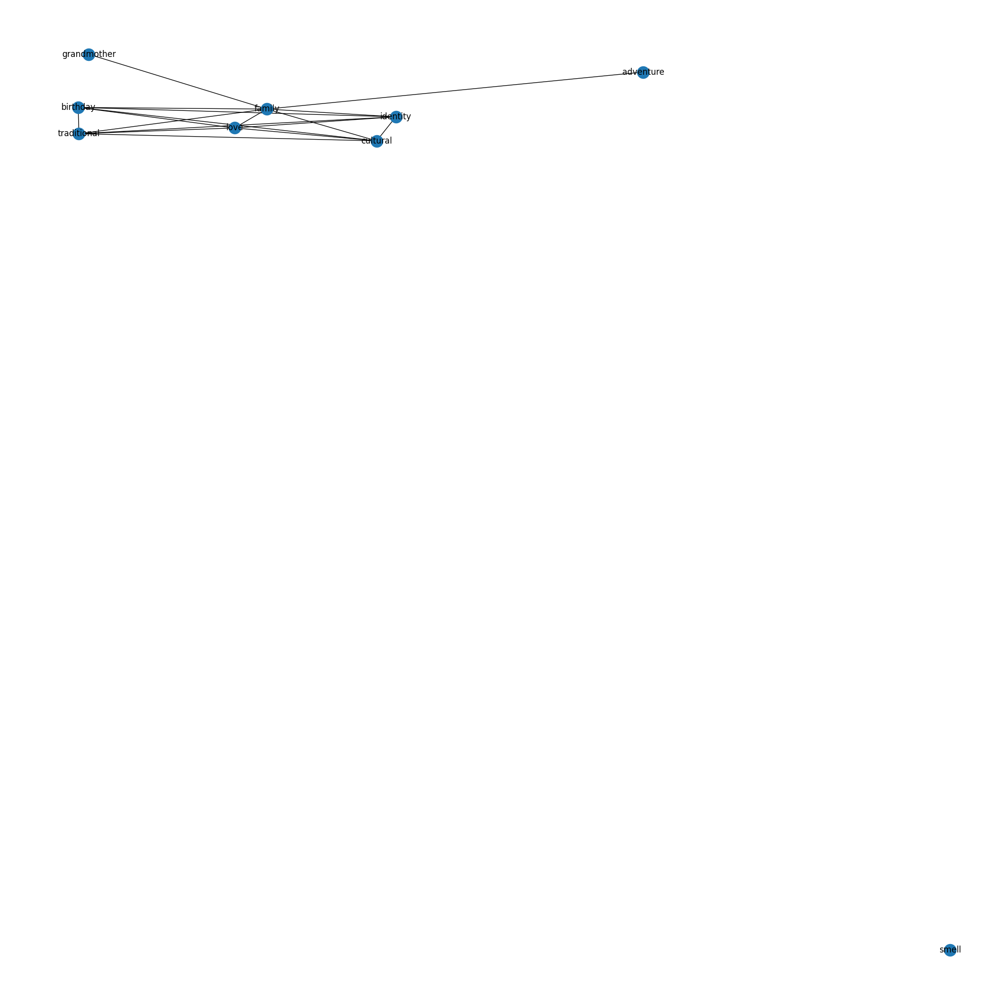

In [ ]:
def clean_text(text):
    additional_stopwords =  []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 0.9:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['trip','texture','childhood','memory','emotion','sweet','choldhood', 'insectbased','insect','interconnectedness','emotional','contemplate','land','instills','constantly','consisted','intertwine','intertwined','intertwining','intriguingly','juxtaposition','labor','laden','yucca','reward','chocolate','special','tale','bean','mango','connection','since','present','paisa','little','child','specific','dietary','unconventional','bandeja','allure','adaptation','nonconsumer','enjoying','delicacy','choice','cream','freshly','cooked','link','conversation','influenced','option','sticker','similarly','arepas','aroma','today','impression','illuminate','theme','guide','groundwork','parent','fantastic','fallen','exploring','tuna','unfold','whole','diet','fond','sometimes','positive','smooth','possibility','ongoing','novel','produced','never','nature','realm','received','mainly','recipe','recurring','linking','saturday','intersection','integrating','delicious','able','cuajada','bring','avocado','create','concept','consuming','creating','ajiaco','barbecue','chef','corn','cornbased','chocolatinas','chicharrón','satisfying','capsule','receiving','came','scent','cafam','reflects','relationship','remains','reliance','sancochos','reminiscent','repertoire','reveal','brush','ritual','rolled','rural','recall','define','cast','potentially','painted','part','pea','permeated','pick','picture','pinpoint','point','cheesy','characterized','potency','potential','poured','rather','powerful','precious','change','presentday','pretty','chance','product','profile','proteinrich','provide','question','sent','sensory','several','serf','serving','arequipe','thought','throughout','tie','anything','topping','touchstone','traced','anchor','tree','almost','ultimately','uncharted','uncover','affinity','various','veggie','vein','venture','weave','whenever','window','winner','aromatic','testament','tendril','sound','setting','show','sibling','silky','bounty','born','sister','smelled','based','soothing','source','tangible','speaks','baker','badge','spell','spot','steadfast','stomach','strongly','available','symbolizing','association','outing','nowadays','openness','coladas','extends','familiar','crop','feel','feeling','fell','find','fixed','fluid','forming','framed','framework','countryside','funny','future','game','genesis','goodness','grilled','count','cornbread','hanging','hardly','heart','cue','explore','experienced','delve','dialogue','deeprooted','deeper','differ','driven','dynamic','earlier','effort','element','dairy','emphasizing','exotic','encapsulate','curiosity','enshrining','enticing','environment','envueltos','etched','everevolving','everpresent','evolution','evolving','heritage','highlight','histori','motif','connected','conjures','locally','conjure','lunchbox','mainstream','complex','maybe','melgar','completely','might','come','lifelong','navigate','need','needed','collective','collecting','norm','normal','nostalgia','collected','delightful','okay','connoisseur','leading','home','ingrained','honest','honor','however','hug','hunting','illustrating','importance','cool','incorporate','continues','infuses','tinajo','tender','tell','technique','togetherness','token','told','tableau','took','symposium','symphony','symbolic','touch','towards','trying','showcase','sharing','upon','right','rich','usually','utilitari','variety','revolve','reveals','rested','rest','resilience','reservoir','reserved','repository','reminding','remind','vivid','remain','rock','universality','unique','sense','turn','turned','shaped','unadulterated','shape','serve','sentimentality','undercurrent','seemingly','root','seemed','seasoning','sculpts','scarcity','satisfies','santander','unfamiliar','unifying','academic','joyous','passed','cooking','dance','current','curd','crystallize','crunch','creates','creamy','creambased','craved','coveted','cornerstone','contributed','dedication','contribute','contrary','continuity','context','constant','compass','companion','communion','communal','common','commemorate','danced','defined','comfort','eclipse','entity','ensuring','enriched','enjoyed','enjoyable','encounter','encapsulated','emphasize','emblematic','embedded','elaborate','eater','depends','earliest','drawn','dough','diverse','distaste','dislike','discern','dimension','difficulty','devoted','dessert','comforting','combination','particularly','armadillo','belonging','bell','believe','becoming','baked','backdrop','aversion','attribute','associated','associate','asked','appreciation','besides','appearance','anticipation','anchored','amplifies','amalgamation','adult','adorned','additional','activity','across','accompanied','beloved','better','color','bucaramanga','closely','clarified','chunky','choose','cheese','chapter','channel','challenge','cared','capacity','canvas','brushstrokes','bind','brushstroke','brought','brings','brimming','box','bountiful','boundless','boundary','bonding','boggy','body','entwined','essence','everyday','isolated','lettuce','learning','le','layer','larger','landscape','lady','know','knit','jubilation','access','interwoven','linked','internalize','instead','instance','insight','innocence','inner','infuse','infrequency','informed','indulgence','indelible','liking','lived','everything','moist','particular','partaking','palate','ordinary','opportunity','offering','occasion','nourish','notion','none','molding','milk','local','metamorphose','mere','melting','medium','meaning','mattered','malleability','making','lunch','look','locale','imprinted','important','impact','filling','fresh','frequently','frequency','found','forward','forged','forge','force','fluffy','fleeting','first','festivity','imbues','featured','fascinating','farm','exuberance','expressed','exploration','exchanged','evolves','evolve','evoke','evident','fruit','furthermore','fusion','generation','illustrate','idea','hunger','humble','hue','house','homemade','hold','heightened','healthy','hard','hamburger','gustatory','guiding','growth','grow','graced','go','gettogether','getting','get','gesture','geographical','youth','food','like','experience','rice','taste','dish','also','meat','made','would','always','meal','flavor','used','something','cake','even','shared','soup','culinary','prepared','liked','familial','really','becomes','time','year','type','often','dont','story','certain','pasta','think','interplay','journey','life','preference','within','example','enjoy','delight','cherished','tapestry','culture','complexity','affection','woven','thing','moment','gathering','vegetable','gallina','became','become','good','recollection','sancocho','favorite','roasted','cooky','narrative','friend','ingredient','physical','savored','one','personal','paint','day','sustenance','foster','mirror','past','pollo','many','stood','eaten','started','embodiment','preferred','influence','profound','kind','every','young','world','together','chicken','vessel','consumed','arroz','threemilk','carry','learned','form','weekend','shaping','underscore','fondness','well','formative','fish','served','felt','prepare','thread','fabric','around','bud','bridge','long','whether','care','significance','white','make','simplest','appreciate','unexpected','rooted','laughter','pudding','remember','hunted','hunt','banana','history','rarity','resonance','resonate','response','guava','growing','grew','grateful','bite','intimate','bond','give','intricate','cook','gelatin','gave','back','gastronomic','especially','said','matter','loved','plain','achievement','mosaic','deeply','early','mother','transcends','much','taught','tradition','sunday','tasty','surroundings','town','wonder','discovery','wild','daily','different','developed','peto','take','nourishment','table','novelty','commonly','conduit','conclusion','adulthood','consumption','treat','animal','apart','continue','celebration','embrace','emerges','anecdote','plate','economic','papaya','plantain','echo','eating','rabbit','regular','quite','reflecting','wanted','warmth','people','perhaps','pepper','wrapped','raised','peppered','reflect','perception','warm','rarely','recognize','rare','power','quick','week','potato','practical','practice','portal','pon','willingness','predilection','related','poignant','prefer','pleasure','preparation','whatever','went','without','wellrounded','preparing','property','protein','provides','pureed','purpose','putumayo','pizza','pin','pvery','pwith','regularly','ripe','voyage','transformed','transmission','staple','stand','squirrel','transporting','spinach','spent','travel','traveled','soul','sou','solution','solely','social','tropical','soaked','small','simple','similar','stem','still','relished','transcend','though','three']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:10]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
# Aplicar la función clean_text a la copia de la columna
p7n = p7noncons.apply(clean_text)
network7n = create_red(p7n, 'network7n')

In [ ]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network7n)
dfx

,Node,Total Co-occurrence Frequency
3,family,378
5,identity,160
6,love,160
1,birthday,102
2,cultural,102
8,traditional,102
0,adventure,18
4,grandmother,18
7,smell,0


In [ ]:
# Texto proporcionado
texto = """
1	childhood	696
7	memory	209
3	emotion	108
8	sweet	84
"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

'childhood','memory','emotion','sweet'


In [ ]:
#print("p7c:", p7c.nodes())
#print("p7n:", p7n.nodes())

In [ ]:
#plt.title('Question 7: Childhood Experiences with Preferred Foods - Communities Bipartite Network')
#plt.axis('off')
#plt.legend(handles=combined_handles, loc='upper right', title="Nodes", bbox_to_anchor=(0.02, 0.98), fontsize=13)
#plt.savefig('P7.png', dpi=300, bbox_inches='tight')
#plt.show()

#P8- CHILDHOOD EXPERIENCES WITH NON-PREFERRED FOODS

In [ ]:
p8cons= compared['P50- CHILDHOOD EXPERIENCES WITH NON-PREFERRED FOODS\n-CONS'].astype(str)
p8noncons= compared['P50- CHILDHOOD EXPERIENCES WITH NON-PREFERRED FOODS\n – NONCONS'].astype(str)

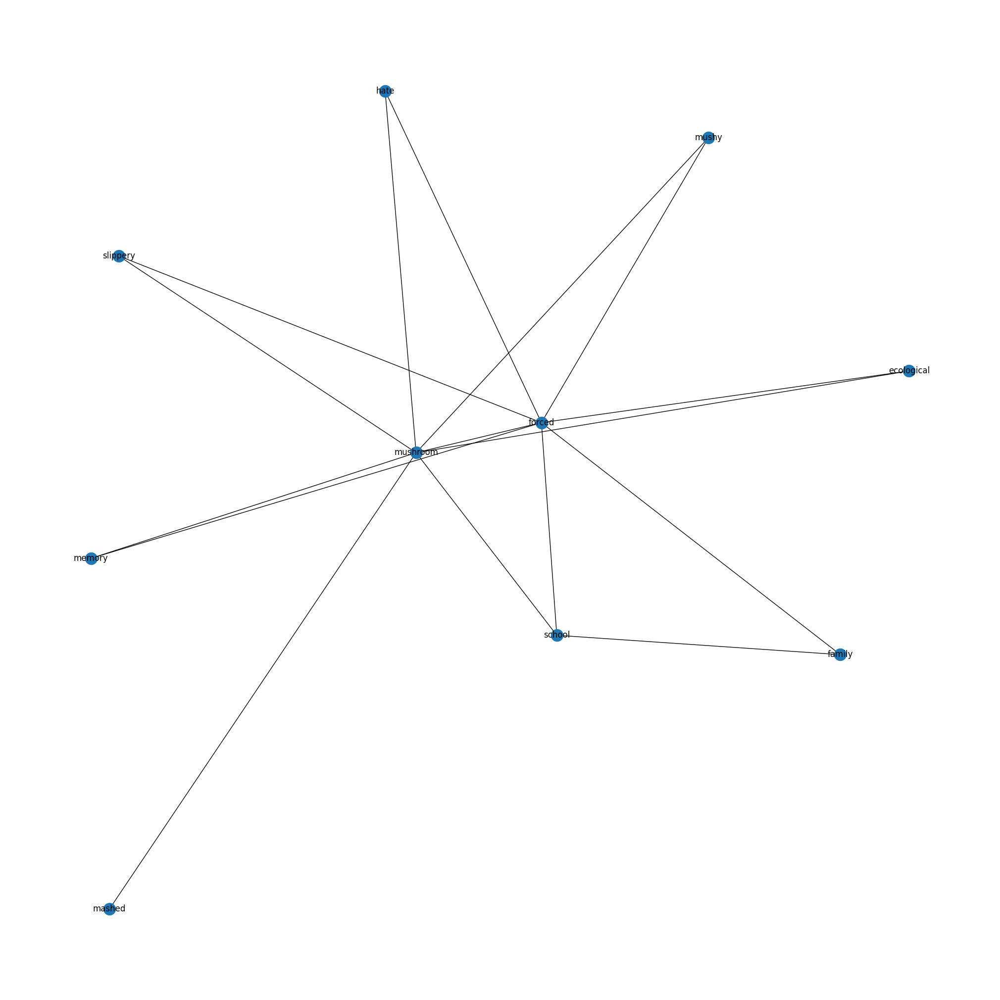

In [ ]:
def clean_text(text):
    additional_stopwords = []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 0.8:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['could','another','given','egg','problem','self','cabbage','despised','disliked','drink','matured','accept','repetitive','consume','help','okra','hide','juice','nemesis','left','limited','everyone','drinking','brussels','tried','anyone','tolerate','sprout','picky','peach','odds','piece','oncedespised','older','uninspiring','undertone','utterly','offputting','pile','overcome','nutritious','obligated','practically','merit','mind','minicabbages','muscle','worse','willingly','wellcooked','welcomed','napkin','way','newfound','ventured','normally','notice','pleasant','umami','precisely','strategically','resistance','result','revelation','richness','sauce','sautéed','seat','stubborn','secretly','stopped','side','simply','resembled','surprise','understand','reached','slyly','properly','pumpkin','typical','push','quickly','realized','terrible','realizing','reason','turnoff','reluctance','reluctantly','reminds','lasting','mashua','cringe','coaxing','cold','comprehend','consequence','consistency','convince','cosidos','cost','cuchuco','distribute','cultural','cundinamarca','cycle','decided','destined','develop','directly','discreetly','called','brother','boyacenses','bothered','adding','addition','agree','alone','amount','annoyed','anymore','appealing','appeared','appetizing','arrived','avoid','baffled','bane','beetroot','beneath','bland','distinct','doubt','insist','hardboiled','heat','herb','hope','hoping','huge','imported','issue','kiwi','actually','later','laugh','living','love','major','mamoncillo','happened','hand','green','grandmother','either','enough','everchanging','evolved','exciting','exhausted','existence','experiment','facility','fan','feed','fold','forever','fungi','garlic','gelatinous','gooey','younger','interconnectedness','contemplate','land','instills','constantly','consisted','intertwine','intertwined','intertwining','intriguingly','juxtaposition','labor','laden','yucca','reward','chocolate','special','tale','bean','mango','connection','since','present','paisa','little','child','specific','dietary','unconventional','bandeja','allure','adaptation','nonconsumer','enjoying','delicacy','choice','cream','freshly','cooked','link','conversation','influenced','option','sticker','similarly','arepas','aroma','today','impression','illuminate','theme','guide','groundwork','parent','fantastic','fallen','exploring','tuna','unfold','whole','diet','fond','sometimes','positive','smooth','possibility','ongoing','novel','produced','never','nature','realm','received','mainly','recipe','recurring','linking','saturday','intersection','integrating','delicious','able','cuajada','bring','avocado','create','concept','consuming','creating','ajiaco','barbecue','chef','corn','cornbased','chocolatinas','chicharrón','satisfying','capsule','receiving','came','scent','cafam','reflects','relationship','remains','reliance','sancochos','reminiscent','repertoire','reveal','brush','ritual','rolled','rural','recall','define','cast','potentially','painted','part','pea','permeated','pick','picture','pinpoint','point','cheesy','characterized','potency','potential','poured','rather','powerful','precious','change','presentday','pretty','chance','product','profile','proteinrich','provide','question','sent','sensory','several','serf','serving','arequipe','thought','throughout','tie','anything','topping','touchstone','traced','anchor','tree','almost','ultimately','uncharted','uncover','affinity','various','veggie','vein','venture','weave','whenever','window','winner','aromatic','testament','tendril','sound','setting','show','sibling','silky','bounty','born','sister','smelled','based','soothing','source','tangible','speaks','baker','badge','spell','spot','steadfast','stomach','strongly','available','symbolizing','association','outing','nowadays','openness','coladas','extends','familiar','crop','feel','feeling','fell','find','fixed','fluid','forming','framed','framework','countryside','funny','future','game','genesis','goodness','grilled','count','cornbread','hanging','hardly','heart','cue','explore','experienced','delve','dialogue','deeprooted','deeper','differ','driven','dynamic','earlier','effort','element','dairy','emphasizing','exotic','encapsulate','curiosity','enshrining','enticing','environment','envueltos','etched','everevolving','everpresent','evolution','evolving','heritage','highlight','histori','motif','connected','conjures','locally','conjure','lunchbox','mainstream','complex','maybe','melgar','completely','might','come','lifelong','navigate','need','needed','collective','collecting','norm','normal','nostalgia','collected','delightful','okay','connoisseur','leading','home','ingrained','honest','honor','however','hug','hunting','illustrating','importance','cool','incorporate','continues','infuses','tinajo','tender','tell','technique','togetherness','token','told','tableau','took','symposium','symphony','symbolic','touch','towards','trying','showcase','sharing','upon','right','rich','usually','utilitari','variety','revolve','reveals','rested','rest','resilience','reservoir','reserved','repository','reminding','remind','vivid','remain','rock','universality','unique','sense','turn','turned','shaped','unadulterated','shape','serve','sentimentality','undercurrent','seemingly','root','seemed','seasoning','sculpts','scarcity','satisfies','santander','unfamiliar','unifying','academic','joyous','passed','cooking','dance','current','curd','crystallize','crunch','creates','creamy','creambased','craved','coveted','cornerstone','contributed','dedication','contribute','contrary','continuity','context','constant','compass','companion','communion','communal','common','commemorate','danced','defined','comfort','eclipse','entity','ensuring','enriched','enjoyed','enjoyable','encounter','encapsulated','emphasize','emblematic','embedded','elaborate','eater','depends','earliest','drawn','dough','diverse','distaste','dislike','discern','dimension','difficulty','devoted','dessert','comforting','combination','particularly','armadillo','belonging','bell','believe','becoming','baked','backdrop','aversion','attribute','associated','associate','asked','appreciation','besides','appearance','anticipation','anchored','amplifies','amalgamation','adult','adorned','additional','activity','across','accompanied','beloved','better','color','bucaramanga','closely','clarified','chunky','choose','cheese','chapter','channel','challenge','cared','capacity','canvas','brushstrokes','bind','brushstroke','brought','brings','brimming','box','bountiful','boundless','boundary','bonding','boggy','body','entwined','essence','everyday','isolated','lettuce','learning','le','layer','larger','landscape','lady','know','knit','jubilation','access','interwoven','linked','internalize','instead','instance','insight','innocence','inner','infuse','infrequency','informed','indulgence','indelible','liking','lived','everything','moist','particular','partaking','palate','ordinary','opportunity','offering','occasion','nourish','notion','none','molding','milk','local','metamorphose','mere','melting','medium','meaning','mattered','malleability','making','lunch','look','locale','imprinted','important','impact','filling','fresh','frequently','frequency','found','forward','forged','forge','force','fluffy','fleeting','first','festivity','imbues','featured','fascinating','farm','exuberance','expressed','exploration','exchanged','evolves','evolve','evoke','evident','fruit','furthermore','fusion','generation','illustrate','idea','hunger','humble','hue','house','homemade','hold','heightened','healthy','hard','hamburger','gustatory','guiding','growth','grow','graced','go','gettogether','getting','get','gesture','geographical','youth','food','like','experience','rice','taste','dish','also','meat','made','would','always','meal','flavor','used','something','cake','even','shared','soup','culinary','prepared','liked','familial','really','becomes','time','year','type','often','dont','story','certain','pasta','think','interplay','journey','life','preference','within','example','enjoy','delight','cherished','tapestry','culture','complexity','affection','woven','thing','moment','gathering','vegetable','gallina','became','become','good','recollection','sancocho','favorite','roasted','cooky','narrative','friend','ingredient','physical','savored','one','personal','paint','day','sustenance','foster','mirror','past','pollo','many','stood','eaten','started','embodiment','preferred','influence','profound','kind','every','young','world','together','chicken','vessel','consumed','arroz','threemilk','carry','learned','form','weekend','shaping','underscore','fondness','well','formative','fish','served','felt','prepare','thread','fabric','around','bud','bridge','long','whether','care','significance','white','make','simplest','appreciate','unexpected','rooted','laughter','pudding','remember','hunted','hunt','banana','history','rarity','resonance','resonate','response','guava','growing','grew','grateful','bite','intimate','bond','give','intricate','cook','gelatin','gave','back','gastronomic','especially','said','matter','loved','plain','achievement','mosaic','deeply','early','mother','transcends','much','taught','tradition','sunday','tasty','surroundings','town','wonder','discovery','wild','daily','different','developed','peto','take','nourishment','table','novelty','commonly','conduit','conclusion','adulthood','consumption','treat','animal','apart','continue','celebration','embrace','emerges','anecdote','plate','economic','papaya','plantain','echo','eating','rabbit','regular','quite','reflecting','wanted','warmth','people','perhaps','pepper','wrapped','raised','peppered','reflect','perception','warm','rarely','recognize','rare','power','quick','week','potato','practical','practice','portal','pon','willingness','predilection','related','poignant','prefer','pleasure','preparation','whatever','went','without','wellrounded','preparing','property','protein','provides','pureed','purpose','putumayo','pizza','pin','pvery','pwith','regularly','ripe','voyage','transformed','transmission','staple','stand','squirrel','transporting','spinach','spent','travel','traveled','soul','sou','solution','solely','social','tropical','soaked','small','simple','similar','stem','still','relished','transcend','though','three','texture','soft','slimy','liver','earthy','smell','childhood','strong']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:10]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
# Aplicar la función clean_text a la copia de la columna
p8c = p8cons.apply(clean_text)
network8 = create_red(p8c, 'network8')

In [ ]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network8)
dfx

,Node,Total Co-occurrence Frequency
2,forced,180
6,mushroom,152
8,school,60
1,family,26
0,ecological,18
3,hate,18
5,memory,18
7,mushy,18
9,slippery,18
4,mashed,8


In [ ]:
# Texto proporcionado
texto = """
8	smell	44
0	childhood	36
9	strong	34
"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

'smell','childhood','strong'


#8N

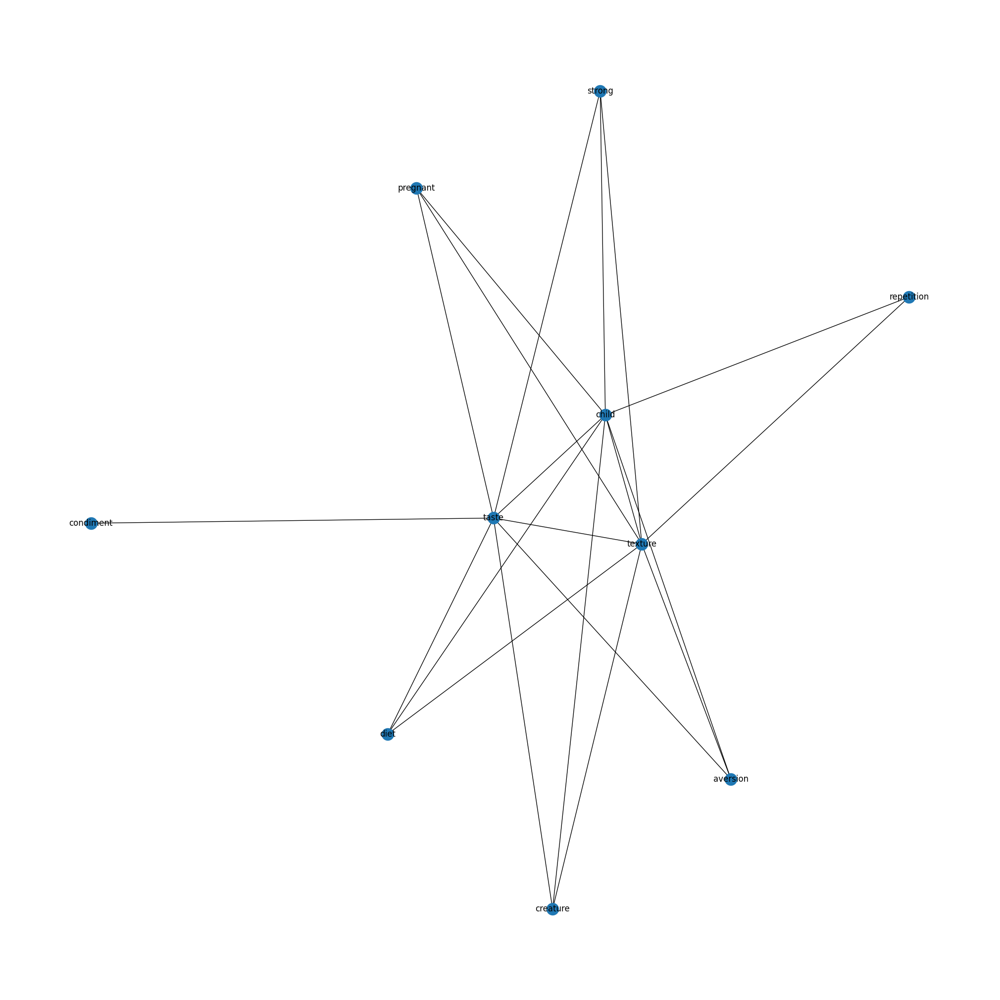

In [ ]:
def clean_text(text):
    additional_stopwords =  []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 0.9:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['food','pumpkin','experience','vegetable','smell','meat','like','made','used','cabbage','still','avoid','dislike','dont','developed','certain','since','soup','never','enjoy','mazorca','added','seasoning','sauce','pizza','ground','flavor','much','also','arracacha','time','although','nutritious','people','presence','prepare','wall','preferred','preference','possible','point','persists','perhaps','would','pea','pdessert','pvomiting','pasta','young','younger','particularly','pand','nutritional','older','pata','relative','reason','sick','started','stand','taken','sometimes','taught','someone','softboiled','thought','tiny','shrimplike','stick','tolerable','tomato','served','secretly','tried','unappealing','salcedo','unpleasant','removed','reminds','value','remember','similarly','acquire','nauseous','mother','consuming','cooked','corn','current','differently','distaste','eating','egg','ended','environment','especially','even','eventually','every','example','consumed','considered','bean','additionally','animal','appetizing','asked','associate','avoided','bought','chicken','broth','came','car','changua','chea','cherry','farm','first','foot','living','kid','knorr','learned','left','little','lived','long','jelly','maggi','mandarin','meal','meant','might','mistook','juice','insect','force','guatila','found','frequently','fundamental','gelatina','grew','habichuelas','initially','hamburger','hear','however','impression','included','influenced','yucca']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:10]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
# Aplicar la función clean_text a la copia de la columna
p8n = p8noncons.apply(clean_text)
network8n = create_red(p8n, 'network8n')

In [ ]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network8n)
dfx

,Node,Total Co-occurrence Frequency
8,taste,126
1,child,88
9,texture,69
0,aversion,28
3,creature,28
4,diet,28
5,pregnant,28
7,strong,28
6,repetition,14
2,condiment,7


In [ ]:
# Texto proporcionado
texto = """
taste	175
3	food	120
8	texture	96
0	child	88
5	pumpkin	84
2	experience	80
9	vegetable	75
6	smell	50
4	meat	48
"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

'taste','food','texture','child','pumpkin','experience','vegetable','smell','meat'


In [ ]:
#print("p8c:", p8c.nodes())
#print("p8n:", p8n.nodes())

In [ ]:
#plt.title('Question 8: Childhood experiences with disliked foods - Communities Bipartite Network')
#plt.axis('off')
#plt.legend(handles=combined_handles, loc='upper right', title="Nodes", bbox_to_anchor=(0.02, 0.98), fontsize=13)
#plt.savefig('P9.png', dpi=300, bbox_inches='tight')
#plt.show()

#P9-RECENT EXPERIENCES WITH PREFERRED FOODS

In [ ]:
p9cons= compared['P41-RECENT EXPERIENCES WITH PREFERRED FOODS-CONS'].astype(str)
p9noncons= compared['P41-RECENT EXPERIENCES WITH PREFERRED FOODS-NONCONS'].astype(str)

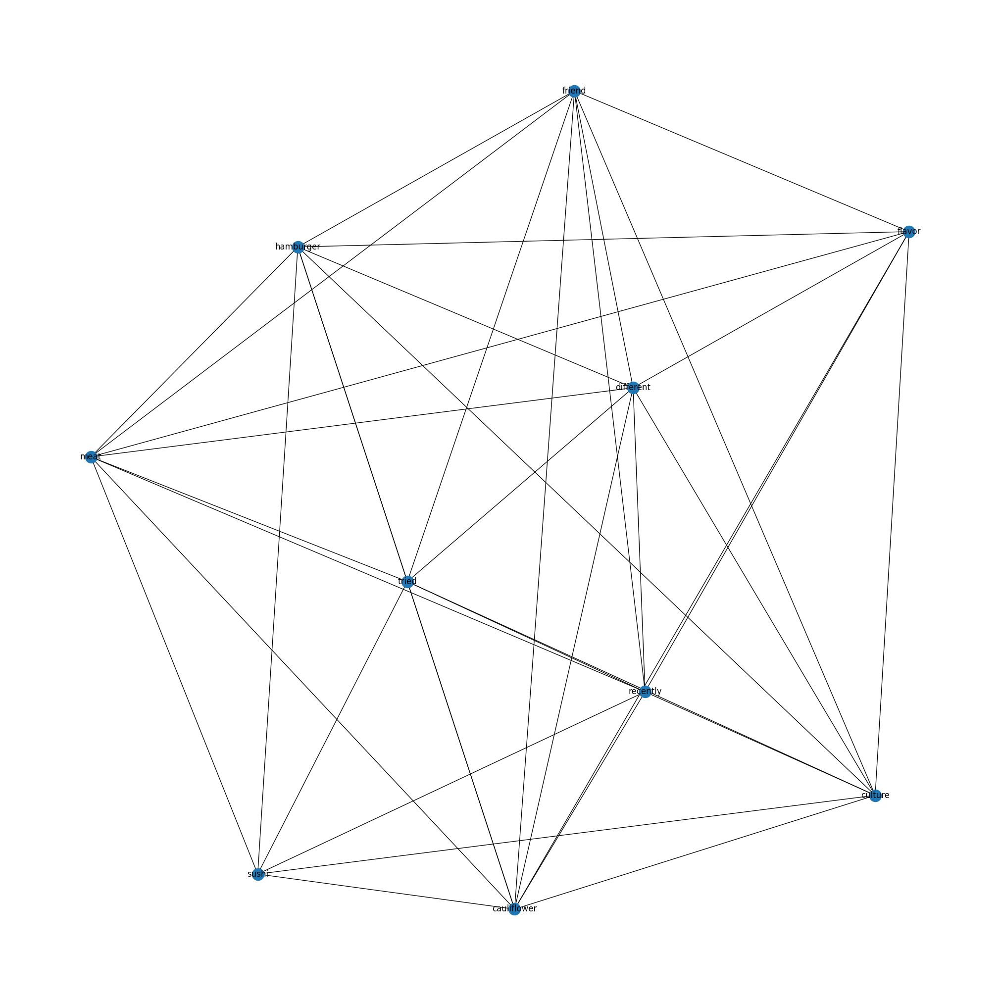

In [ ]:
def clean_text(text):
    additional_stopwords = []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 0.8:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['lifestyle','thing','food','like','differently','much','really','experience','started','dont','delicious','would','example','think','something','prepare','place','year','barley','liked','also','another','well','little','liking','diet','type','trying','small','moment','everything','impressed','many','particular','good','change','usually','cook','avocado','used','tomato','pepper','perception','nut','people','pea','trauma','pasta','trendy','pa','pistachio','order','tri','night','thanks','must','turkish','turn','milk','menu','mediumrare','typical','went','meal','maybe','within','never','pleasant','smelled','taste','soak','social','since','shrimp','setting','seems','sauce','love','russi','rice','restaurant','spinach','starting','representative','powdered','remember','regular','recipe','tasted','reason','tasting','pto','presentation','prepared','tatacoa','taught','preparation','made','added','looked','culinary','cholao','compacted','consume','cooked','country','cousin','cream','currently','look','decided','deliciously','desert','develo','developed','eaten','eating','egg','cheese','changed','challenge','celebratory','almost','anything','apart','appetite','arab','bean','bechamel','becoming','besides','birthday','bread','broccoli','buffet','cali','carbohydrate','celebration','employee','enjoy','enjoyable','great','group','health','helped','hungry','juicier','last','late','lately','almond','legume','lentil','lettuce','lived','living','location','grew','given','enjoyed','geographical','enjoying','especially','experienced','experiencing','exploring','exquisite','extremely','feel','fell','find','fine','first','fish','forced','found','framework','gastronomic','learn']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:10]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
# Aplicar la función clean_text a la copia de la columna
p9c = p9cons.apply(clean_text)
network9 = create_red(p9c, 'network9')

In [ ]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network9)
dfx

,Node,Total Co-occurrence Frequency
9,tried,252
2,different,145
8,sushi,138
7,recently,132
0,cauliflower,111
5,hamburger,99
4,friend,93
1,culture,72
6,meat,72
3,flavor,66


In [ ]:
# Texto proporcionado
texto = """

"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

#9N

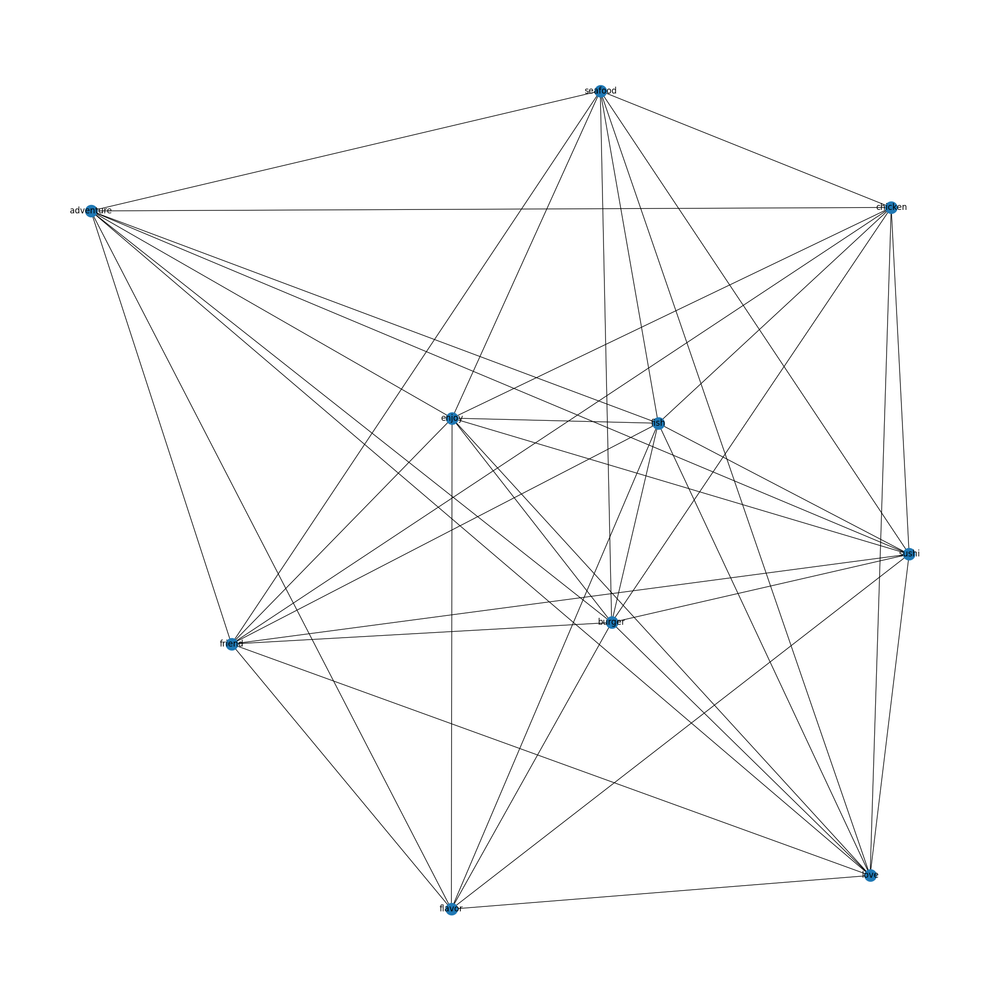

In [ ]:
def clean_text(text):
    additional_stopwords =  []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 0.8:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['gastronomy','food','gathering','social','like','thing','especially','trying','dish','used','good','started','hamburger','even','right','stuff','crepe','sometimes','lasagna','lately','made','coast','plate','bogota','taste','never','appreciate','waffle','shrimp','time','recently','different','delicious','onion','change','diet','surprisingly','mouth','found','developed','garlic','goodness','spaghetti','special','fry','fried','weird','snail','mature','pasta','occasion','muscle','moved','place','plantain','mexic','prawn','pregnancy','meat','mandarin','sausage','protein','pto','liked','life','recent','kid','jeno','itali','rome','salmon','restaurant','french','book','birthday','dislike','development','texture','brotherinlaw','bud','daughter','cream','crab','called','tomato','type','ceviche','cheese','trip','traveling','tri','also','unique','chinese','family','working','every','variety','eating','enthusiast','various','enjoyed','anchovy','surprise','squid','find','egg','unappealing','party','paradise','trust','quite','pand','rare','unknown','pretty','peace','prepared','whole','unconventional','power','pleasure','pleasant','value','rarely','person','understanding','upgraded','spiciness','response','really','sound','smooth','sneak','someone','take','sou','soup','treat','suddenly','story','start','want','standard','specifically','showed','showdown','shot','seeing','section','secret','second','wide','thought','roll','reward','tossing','translation','world','resist','rephrasing','repetitive','opened','actually','one','consume','consumption','cool','culinary','dance','delicate','deliciously','discover','either','enough','entirely','everyday','example','excitement','excites','explore','explosion','feast','fiesta','firework','first','form','full','funky','consuming','competition','gave','combo','affair','affinity','already','always','amazed','amazing','appeal','appreciating','arrival','avoid','become','begun','best','bite','bland','bumped','cared','certain','chance','check','childhood','clarity','clear','gamechanger','getting','often','later','adulting','liking','little','long','make','makeover','medium','meeting','mentor','menu','might','mild','mini','minivacation','missing','motivated','mystery','needed','note','occasionally','offbeat','offered','officially','level','know','give','knew','goto','guilty','guru','hanging','happened','healthy','highquality','hospital','hospitalized','importance','include','increase','indulging','influence','influenced','influencers','ingredient','innovative','integrating','introduced','italy','keep','kick','wrapped']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:10]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
# Aplicar la función clean_text a la copia de la columna
p9n = p9noncons.apply(clean_text)
network9n = create_red(p9n, 'network9n')

In [ ]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network9n)
dfx

,Node,Total Co-occurrence Frequency
1,burger,432
4,fish,432
3,enjoy,392
5,flavor,280
9,sushi,260
2,chicken,225
8,seafood,225
6,friend,212
7,love,162
0,adventure,110


In [ ]:
# Texto proporcionado
texto = """

"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

In [ ]:
#print("p9c:", p9c.nodes())
#print("p9n:", p9n.nodes())

In [ ]:
#plt.title('Question 9: Recent experiences with preferred foods - Communities Bipartite Network')
#plt.axis('off')
#plt.legend(handles=combined_handles, loc='upper right', title="Nodes", bbox_to_anchor=(0.02, 0.98), fontsize=13)
#plt.savefig('P9.png', dpi=300, bbox_inches='tight')
#plt.show()

#P10-RECENT EXPERIENCES WITH DISLIKED FOODS

In [ ]:
p10cons= compared['P51-RECENT EXPERIENCES WITH DISLIKED FOODS-CONS'].astype(str)
p10noncons= compared['P51-RECENT EXPERIENCES WITH DISLIKED FOODS-NONCONS'].astype(str)

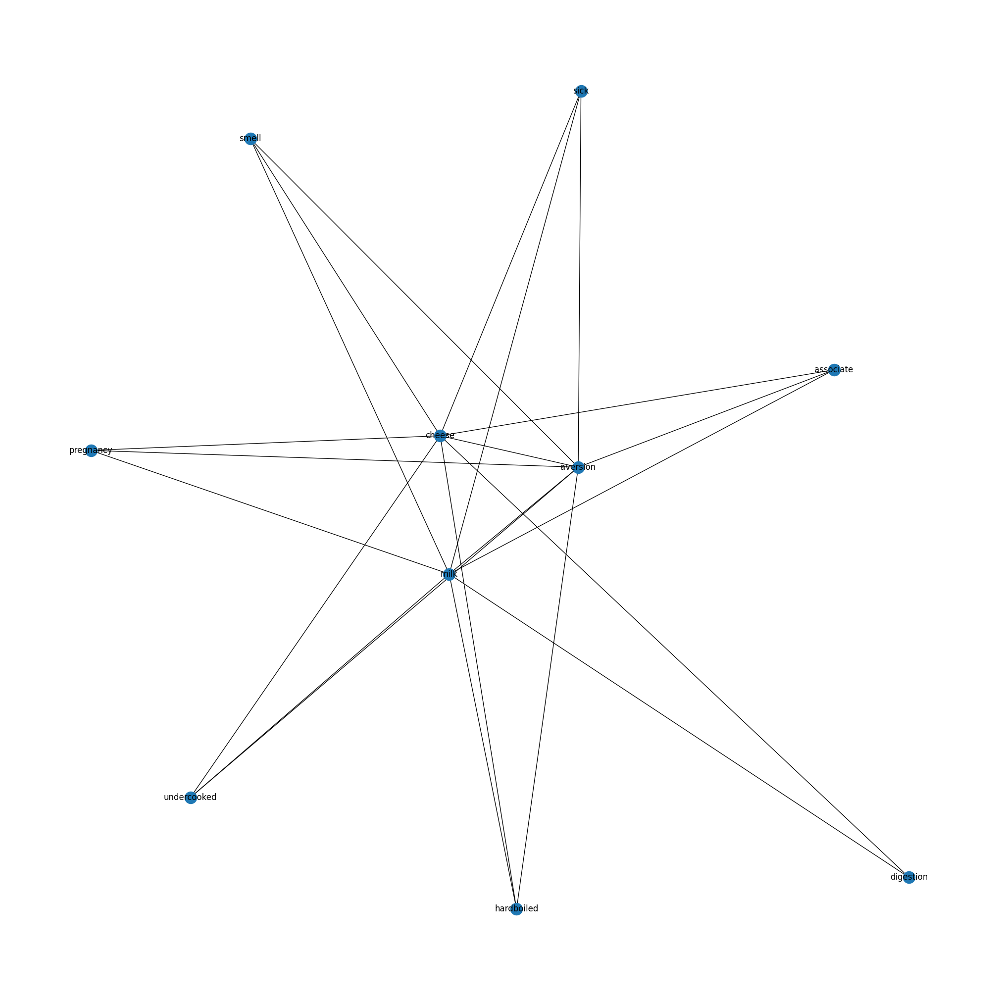

In [ ]:
def clean_text(text):
    additional_stopwords = []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 0.8:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['tried','taste','pepper','texture','weird','avoid','egg','sweet','diet','tasted','veggie','health','liver','lentil','glutenfree','like','food','chicken','dont','much','eating','bell','thing','experience','restaurant','dessert','back','even','know','never','anything','nope','bone','burger','something','nogo','dish','nugget','pizza','super','many','vegetable','place','fish','flavor','pas','past','home','fruit','hard','made','good','blood','cautious','sandwich','time','coffee','truck','love','lose','look','hair','take','healthy','vibe','water','well','happened','interest','might','mess','paisa','real','rice','right','pastry','salad','pasta','sausage','shrimp','paella','since','sound','spicy','stand','moving','stuff','popcorn','worth','green','family','certain','cake','drink','crunchy','either','depends','blue','bean','enough','day','consumption','consuming','dislike','always','contain','aged','agree','found','flour','garlic','color','cheeseboard','special','count','said','challenge','cream','starting','scene','soft','contains','sardine','completely','condiment','stick','sauce','shrim','serving','serve','snack','sushi','work','whether','whatever','watery','also','appeal','appreciate','usually','used','turned','trying','attention','avocado','tofu','think','banana','tend','bite','body','taco','bud','sure','cause','strong','crunch','reason','reputation','long','need','else','enemy','mouth','enjoy','enjoyable','menu','meal','especially','adventure','excellent','exciting','local','drinking','expensive','list','eye','left','learned','feel','keep','issue','follow','giving','happening','eater','nothing','repeat','rejected','reduced','hamburger','currently','rarely','ramen','processed','prepared','curry','prefer','postpregnancy','portion','daughter','poorly','plate','often','definitely','pineapple','people','developed','different','digest','party','dressing','otherwise','opened','one','added','yeah','tres','lech','thanks','stopped','stomach','zero','intolerance','must','ruin','service','fancy','bogotá','fearing','getting','urchin','took','strongly','slowly','pandemic','sprout','specific','soda','seemed','pain','mazamorra','care','chontaduro','carbonated','call','crime','resumed','revolted','cardboard','secondary','came','budget','simple','slime','brussels','smelling','repeatedly','redcolored','soap','careful','checking','changed','peppercrazy','pitaya','pool','realize','praise','pretty','price','psauce','pudding','quinoa','breath','oyster','tough','tripledecker','anymore','vowed','ancient','went','wife','wing','wobbly','worked','working','afraid','yikes','associated','toast','birth','specialized','breaking','spoiled','bracket','brace','became','tired','sunbath','tastiest','terrible','balut','tiny','overrated','curb','horrible','fertilized','fishshaped','foot','frog','gave','gelatin','cilantro','goodbye','halfshell','choy','hated','hawaii','hiding','hike','club','fear','cone','delicacy','cute','cutlet','cutting','dared','date','cool','diner','drowning','duck','ever','expiration','honestly','hunt','overkill','indigestion','mode','mold','movie','choked','nemesis','next','none','nono','chestnut','number','oceanflavored','onetime','onion','ordered','mild','accept','mayonnaise','killed','inferno','inherently','interested','joint','kick','leafy','looked','leaving','choking','leg','lesson','liverwurst','longer','abdominal']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:10]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
# Aplicar la función clean_text a la copia de la columna
p10c = p10cons.apply(clean_text)
network10 = create_red(p10c, 'network10')

In [ ]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network10)
dfx

,Node,Total Co-occurrence Frequency
2,cheese,96
5,milk,96
1,aversion,72
0,associate,30
4,hardboiled,30
6,pregnancy,30
7,sick,30
8,smell,30
9,undercooked,30
3,digestion,12


In [ ]:
# Texto proporcionado
texto = """
tried	918
6	taste	611
4	pepper	488
7	texture	413
9	weird	260

"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

'tried','taste','pepper','texture','weird'


#10N

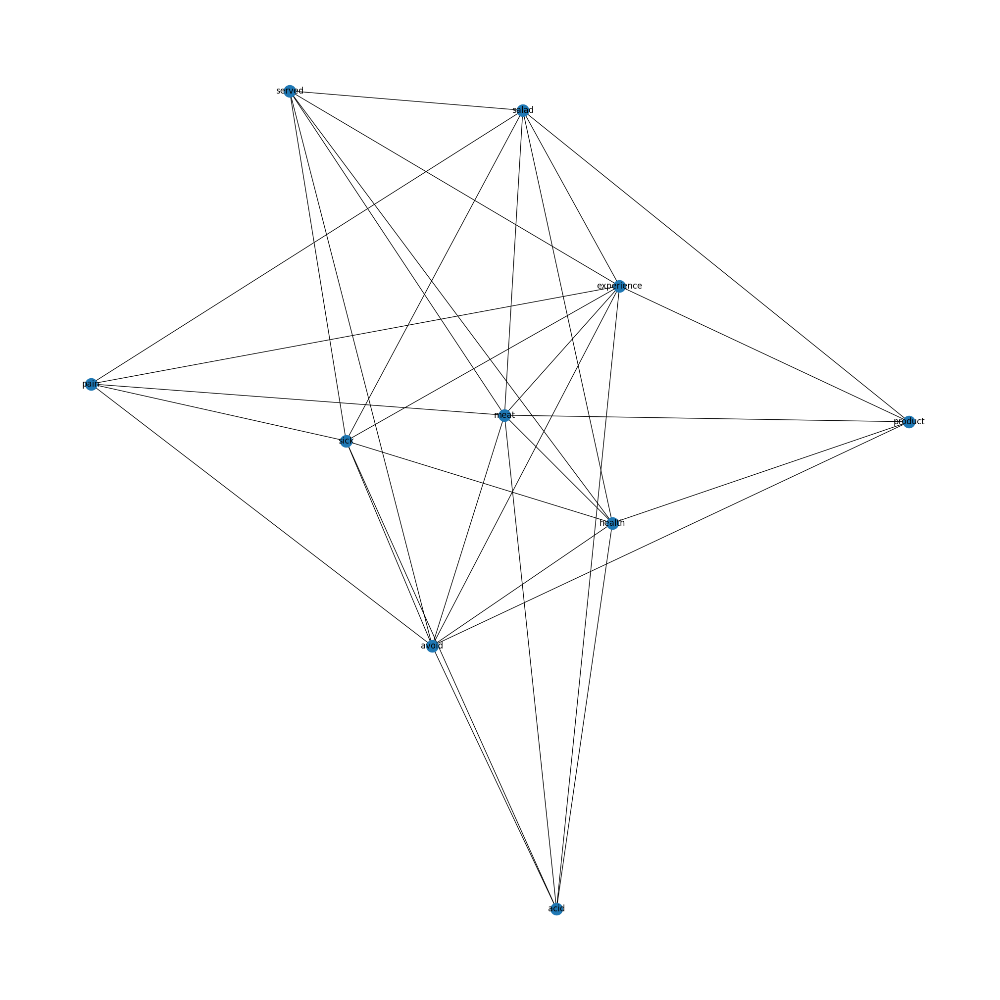

In [ ]:
def clean_text(text):
    additional_stopwords =  []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 0.8:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['feel','fish','feeling','safer','trauma','mushy','overcooked','combined','cleanse','caused','badtasting','food','like','dont','used','aversion','reason','certain','sometimes','consumption','taste','eating','recent','stand','dish','make','currently','sauce','rib','consume','made','acne','soup','pickle','yeah','grain','hard','body','high','heavy','life','grilled','mess','know','good','never','level','pomegranate','wrong','weak','wasting','want','vendor','uric','tomato','time','thick','sugary','stuff','stopped','spinach','something','seed','restaurant','gone','prepared','prefer','pork','reduced','much','either','flour','anymore','although','also','alone','cream','choice','dairy','developed','beetroot','even','burger','smart','skin','soft','simply','fruit','spicy','sound','sight','carnivore','spoiled','buying','steak','steer','similar','come','clear','safe','consumed','restrict','restricting','condition','right','rodizio','rough','share','completely','santa','company','scarred','seafood','sto','seemed','still','suero','train','tri','tricky','tried','trust','trusted','turn','amount','almost','well','without','wonder','worth','would','affecting','advised','year','tough','business','totally','bought','reputable','sure','surprise','swear','swell','tabasco','tell','texture','thing','thought','averse','tired','tolerate','appetizing','respect','reluctance','repulsed','except','invited','irritation','expect','large','learned','leather','left','lesson','enjoyable','ingredient','lip','list','liver','long','look','enjoy','making','marta','interesting','infection','repetitive','guava','gathering','general','getting','given','going','friend','flow','felt','guess','impression','hamburger','haunt','family','fair','expired','homemade','experiencing','house','meal','egg','easy','cross','perspective','pfor','disaster','diet','poorly','decided','precaution','cutting','pto','milk','queasy','cousin','recently','recommended','costeño','relationship','gamechanger','remind','peating','pasta','past','passed','mind','mouth','move','easily','need','negative','done','nogo','occasionally','often','overload','disgusted','parent','particularly','party','zone']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:10]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
# Aplicar la función clean_text a la copia de la columna
p10n = p10noncons.apply(clean_text)
network10n = create_red(p10n, 'network10n')

In [ ]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network10n)
dfx

,Node,Total Co-occurrence Frequency
4,meat,270
3,health,192
1,avoid,175
9,sick,175
2,experience,136
7,salad,132
8,served,72
0,acid,64
5,pain,60
6,product,58


In [ ]:
# Texto proporcionado
texto = """
8	feel	402
10	fish	174
9	feeling	118
20	safer	42
26	trauma	42
14	mushy	42
15	overcooked	42
6	combined	42
5	cleanse	42
4	caused	42
3	badtasting	42

"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

'feel','fish','feeling','safer','trauma','mushy','overcooked','combined','cleanse','caused','badtasting'


In [ ]:
#plt.title('Question 10: Recent experiences with disliked foods - Communities Bipartite Network')
#plt.axis('off')
#plt.legend(handles=combined_handles, loc='upper right', title="Nodes", bbox_to_anchor=(0.02, 0.98), fontsize=13)
#plt.savefig('P10.png', dpi=300, bbox_inches='tight')
#plt.show()

#Pickle

Downloading all simple networks as pickle objects.

In [ ]:
# Diccionario con todas las redes
all_networks = {
    'network1': network1, 'network1n': network1n, 'network2': network2, 'network2n': network2n,
    'network3': network3, 'network3n': network3n, 'network4': network4, 'network4n': network4n,
    'network5': network5, 'network5n': network5n, 'network6': network6, 'network6n': network6n,
    'network7': network7, 'network7n': network7n, 'network8': network8, 'network8n': network8n,
    'network9': network9, 'network9n': network9n, 'network10': network10, 'network10n': network10n
}
# Guardar cada red en un archivo separado
for name, network in all_networks.items():
    file_path = f'/content/drive/MyDrive/Projects/Insects/{name}_network.pickle'
    with open(file_path, 'wb') as f:
        pickle.dump(network, f)

# Exportar el diccionario de etiquetas
with open('all_network_labels.pickle', 'wb') as f:
    pickle.dump(all_network_labels, f)

#Preparing the networks

Shared nodes and edges for unification.

This step was useful to understand the structure of the full network.

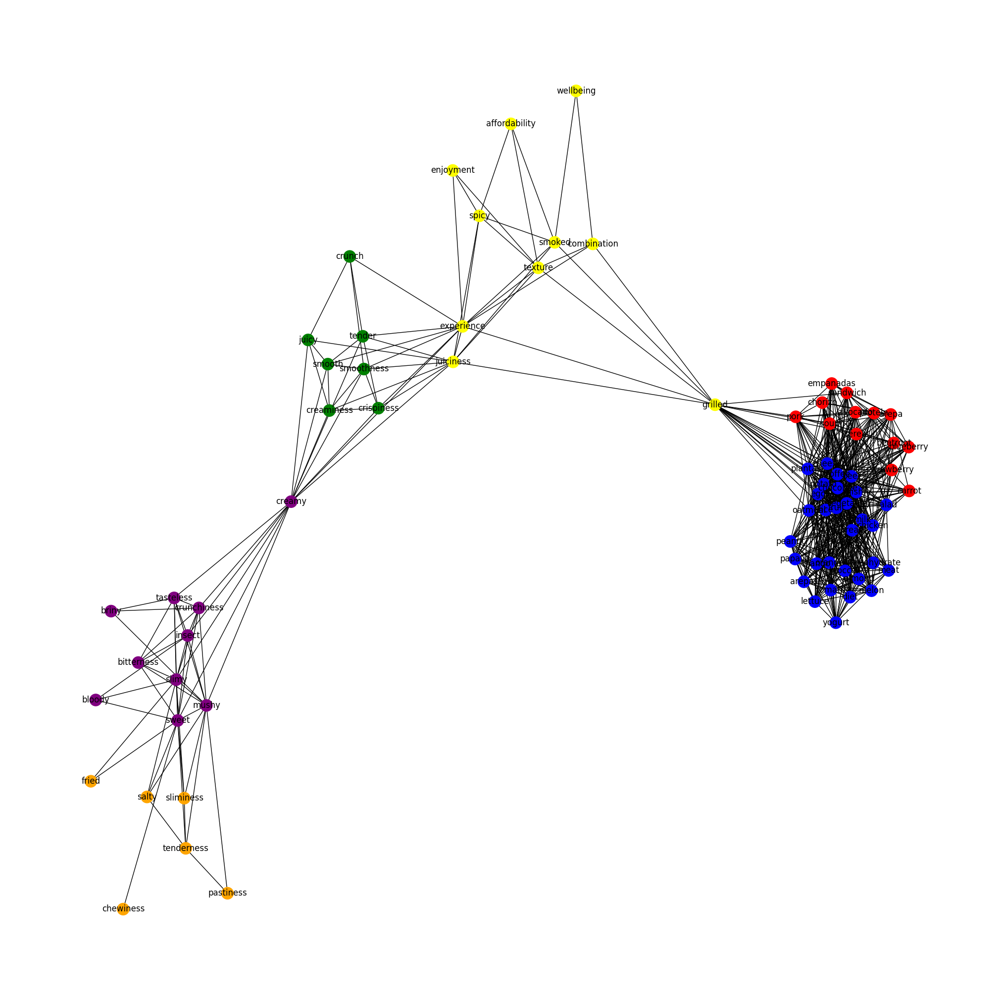

In [ ]:
networks = [network1, network1n, network2, network2n, network3, network3n]
colors = ['red', 'blue', 'green', 'yellow', 'orange', 'purple']  # Ajustar según el número de redes


combined_network = nx.Graph() # Combinar redes
for network, color in zip(networks, colors):
    for node, attrs in network.nodes(data=True):     # Añadir  color
        combined_network.add_node(node, color=color)
    for u, v, attrs in network.edges(data=True):
        combined_network.add_edge(u, v, color=color)

plt.figure(figsize=(20, 20))
pos = nx.spring_layout(combined_network)
nx.draw(combined_network, pos, node_color=[combined_network.nodes[n]['color'] for n in combined_network.nodes], with_labels=True)
plt.show()

# Exportar a GEXF
nx.write_gexf(combined_network, 'combined_network.gexf')


#GEXF para Gephi

I also tried to visualize the networks in Gephi; however, the program does not handle multiplex networks well. Therefore, I preferred to continue working with Python.

In [ ]:
import networkx as nx

# Diccionario con todas las redes
all_networks = {
    'network1': network1, 'network1n': network1n, 'network2': network2, 'network2n': network2n,
    'network3': network3, 'network3n': network3n, 'network4': network4, 'network4n': network4n,
    'network5': network5, 'network5n': network5n, 'network6': network6, 'network6n': network6n,
    'network7': network7, 'network7n': network7n, 'network8': network8, 'network8n': network8n,
    'network9': network9, 'network9n': network9n, 'network10': network10, 'network10n': network10n
}

# Guardar cada red en formato GEXF
for name, network in all_networks.items():
    file_path = f'/content/drive/MyDrive/Projects/Insects/{name}_network.gexf'
    nx.write_gexf(network, file_path)


#Upload networks

In [ ]:
network_names = [
    'network1', 'network1n', 'network2', 'network2n',
    'network3', 'network3n', 'network4', 'network4n',
    'network5', 'network5n', 'network6', 'network6n',
    'network7', 'network7n', 'network8', 'network8n',
    'network9', 'network9n', 'network10', 'network10n'
]

# Cargar todas las redes desde sus archivos
all_networks = {}
for name in network_names:
    file_path = f'/content/drive/MyDrive/Projects/Insects/{name}_network.pickle'
    with open(file_path, 'rb') as f:
        all_networks[name] = pickle.load(f)


# Ruta al archivo donde se guardó el diccionario
file_path = '/content/drive/MyDrive/Projects/Insects/all_network_labels.pickle'

# Cargar el diccionario desde el archivo
with open(file_path, 'rb') as f:
    all_network_labels = pickle.load(f)

Renamed it all to not have issues in future.

In [ ]:
net1 = all_networks['network1'] #Eating Patterns C
net1n = all_networks['network1n'] #Eating Patterns N
net2 = all_networks['network2'] #Characteristics and preferences C
net2n = all_networks['network2n'] #Characteristics and preferences N
net3 = all_networks['network3'] #Characteristics non prefered food C
net3n = all_networks['network3n'] #Characteristics non prefered food N
#-------
net4 = all_networks['network4'] #Cultural C
net4n = all_networks['network4n'] #Cultural N
net5 = all_networks['network5'] #Knowledge Int C
net5n = all_networks['network5n'] #Knowledge Int N
net6 = all_networks['network6'] #Knowledge Colombia C
net6n = all_networks['network6n'] #Knowledge Colombia N
#----- Chilhood Experiences
net7 = all_networks['network7']
net7n = all_networks['network7n']
net8 = all_networks['network8']
net8n = all_networks['network8n']
net9 = all_networks['network9']
net9n = all_networks['network9n']
net10 = all_networks['network10']
net10n = all_networks['network10n']
#To rename the networks is pretty important in the multiplex creation, since the multiplex code will assume the names given here.
net1.name = 'net1' #Eating Patterns C
net1n.name = 'net1n' #Eating Patterns N
net2.name = 'net2' #Characteristics and preferences C
net2n.name = 'net2n' #Characteristics and preferences N
net3.name = 'net3' #Characteristics non prefered food C
net3n.name = 'net3n' #Characteristics non prefered food N
#-------
net4.name = 'net4' #Cultural C
net4n.name = 'net4n' #Cultural N
net5.name = 'net5' #Knowledge Int C
net5n.name = 'net5n' #Knowledge Int N
net6.name = 'net6' #Knowledge Colombia C
net6n.name = 'net6n' #Knowledge Colombia N
#----- Chilhood Experiences
net7.name = 'net7' #childhood + prefered food C
net7n.name = 'net7n' #childhood + prefered food N
net8.name = 'net8' #childhood + non prefered food C
net8n.name = 'net8n' #childhood + non prefered food N
#----------------------------------------------------
net9.name = 'net9' #Recent + prefered food C
net9n.name = 'net9n' #Recent + prefered food N
net10.name = 'net10' #Recent + non prefered food C
net10n.name = 'net10n' #Recent + non prefered food N

#Multiplex

From that point, I will start organizing the code to create the multiplex network structure. As mentioned in the publication, we clustered the simple networks by organizing groups according to thematic axes.

#Eating paterns + Labels

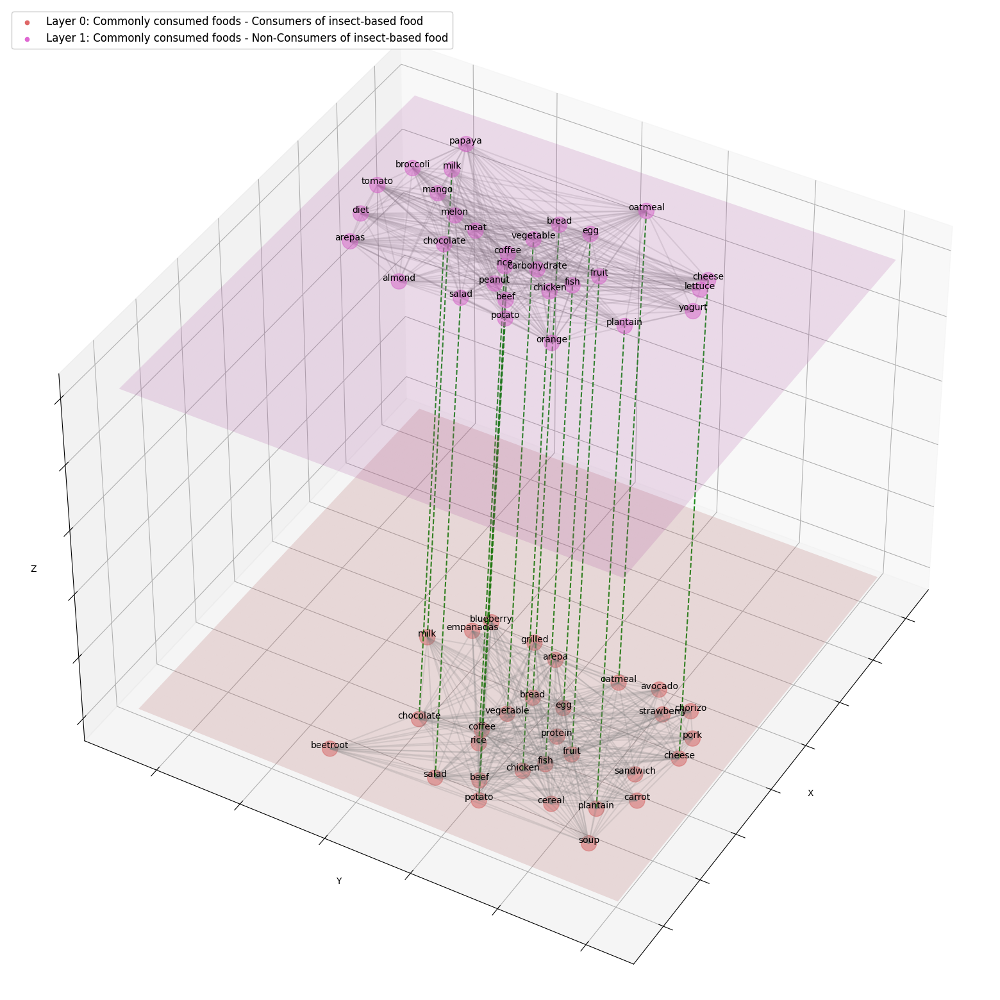

In [ ]:
class LayeredNetworkGraph(object):
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        self.graphs = graphs
        self.total_layers = len(graphs)
        self.node_labels = node_labels
        self.layout = layout
        if ax:
            self.ax = ax
        else:
            fig = plt.figure()
            self.ax = fig.add_subplot(111, projection='3d')
        self.get_nodes()
        self.get_edges_within_layers()
        self.get_edges_between_layers_by_shared_nodes()
        self.get_node_positions()
        self.draw()
    def get_nodes(self):
        self.nodes = []
        for z, g in enumerate(self.graphs):
            self.nodes.extend([(node, z) for node in g.nodes()])
    def get_edges_within_layers(self):
        self.edges_within_layers = []
        for z, g in enumerate(self.graphs):
            self.edges_within_layers.extend([((source, z), (target, z)) for source, target in g.edges()])
    def get_edges_between_layers_by_shared_nodes(self):
        self.edges_between_layers = []
        for z1, g in enumerate(self.graphs[:-1]):
            z2 = z1 + 1
            h = self.graphs[z2]
            shared_nodes = set(g.nodes()) & set(h.nodes())
            self.edges_between_layers.extend([((node, z1), (node, z2)) for node in shared_nodes])
    def get_node_positions(self, *args, **kwargs):
        composition = self.graphs[0]
        for h in self.graphs[1:]:
            composition = nx.compose(composition, h)
        pos = self.layout(composition, *args, **kwargs)
        self.node_positions = dict()
        for z, g in enumerate(self.graphs):
            layer_offset = z * 10  # Desplazamiento en z
            network_name = g.name
            x_layer_offset = network_offsets.get(network_name, {}).get('x_offset', 0) * z
            y_layer_offset = network_offsets.get(network_name, {}).get('y_offset', 0) * z
            self.node_positions.update({
                (node, z): (pos[node][0] + x_layer_offset, pos[node][1] + y_layer_offset, layer_offset)
                for node in g.nodes()
            })
    def draw_nodes(self, nodes, color,alpha =None, *args, **kwargs):
        x, y, z = zip(*[self.node_positions[node] for node in nodes])
        self.ax.scatter(x, y, z, color=color, alpha = 0.5, *args, **kwargs)
    def draw_edges(self, edges, *args, **kwargs):
        segments = [(self.node_positions[source], self.node_positions[target]) for source, target in edges]
        line_collection = Line3DCollection(segments, *args, **kwargs)
        self.ax.add_collection3d(line_collection)
    def get_extent(self, pad=0.1):
        xyz = np.array(list(self.node_positions.values()))
        xmin, ymin, _ = np.min(xyz, axis=0)
        xmax, ymax, _ = np.max(xyz, axis=0)
        dx = xmax - xmin
        dy = ymax - ymin
        return (xmin - pad * dx, xmax + pad * dx), \
            (ymin - pad * dy, ymax + pad * dy)
    def draw_plane(self, z, *args, **kwargs):
        network_name = self.graphs[z].name
        color = legend_info.get(network_name, '#CCCCCC')
        (xmin, xmax), (ymin, ymax) = self.get_extent(pad=0.1)
        u = np.linspace(xmin, xmax, 150)
        v = np.linspace(ymin, ymax, 150)
        U, V = np.meshgrid(u, v)
        layer_offset = z * 10
        W = layer_offset * np.ones_like(U)
        self.ax.plot_surface(U, V, W, color=color, *args, **kwargs)
    def synchronize_labels(self):
        missing_labels = set(self.node_positions.keys()) - set(self.node_labels.keys())
        for node in missing_labels:
            self.node_labels[node] = f"Nodo {node[0]}"
        extra_labels = set(self.node_labels.keys()) - set(self.node_positions.keys())
        for node in extra_labels:
            del self.node_labels[node]
    def draw(self):
        self.draw_edges(self.edges_within_layers, color='black', alpha=0.3, linestyle='-', zorder=2)
        self.draw_edges(self.edges_between_layers, color='Red', alpha=0.8, linestyle='--', zorder=2)
        for z in range(self.total_layers):
            self.draw_plane(z, alpha=0.2, zorder=1)
            color = legend_info.get(self.graphs[z].name, 'default_color')
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
        if self.node_labels:
            self.draw_node_labels(self.node_labels,
                                  horizontalalignment='center',
                                  verticalalignment='center',
                                  zorder=100)

    def draw_node_labels(self, labels, font_size=9, color='black', **kwargs):  # Tamaño de fuente reducido
        for node, (x, y, z) in self.node_positions.items():
            label = labels.get(node, f'{node[0]}')
            self.ax.text(x, y, z, label, fontsize=font_size, color=color, alpha=0.7, **kwargs)  # Añadida transparencia
    def calculate_heuristics(self):
        self.original_degrees = {node: degree for net in self.graphs for node, degree in net.degree()}
        self.apply_hemln_pg()
    def apply_hemln_pg(self):
        degrees_per_layer = [dict(net.degree()) for net in [net1, net1n]]
        # Calcular el grado promedio en cada capa
        avg_degrees = [sum(degrees.values()) / len(degrees) for degrees in degrees_per_layer]
        # Identificar los nodos 'hub' en cada capa
        hubs_per_layer_pg = []
        for degrees, avg_degree in zip(degrees_per_layer, avg_degrees):
            hubs = [node for node, degree in degrees.items() if degree >= avg_degree]
            hubs_per_layer_pg.append(hubs)
        # Inicializar los grados actualizados de todos los nodos; nodos no 'hub' empiezan en cero
        updated_degrees_pg = {node: (degrees[node] if node in hubs else 0)
                              for degrees, hubs in zip(degrees_per_layer, hubs_per_layer_pg)
                              for node in degrees}
        # Incrementar el grado de los nodos 'hub' basándose en conexiones intercapas
        for i, net in enumerate([net1, net1n]):
            #print(f"Procesando capa {i}...")  # Depurador: Indica la capa que se está procesando
            for hub in hubs_per_layer_pg[i]:
                next_layer_index = (i + 1) % len(degrees_per_layer)
                grado_original = updated_degrees_pg[hub]
                #print(f"Grado original de '{hub}': {grado_original}") # grado original del nodo 'hub'
                for neighbor in net[hub]:
                    if neighbor in hubs_per_layer_pg[next_layer_index]:
                        updated_degrees_pg[hub] += 1
                        #print(f" Incrementing the grade of '{hub}' cze it has a connection with '{neighbor}'")

                # Depurador: Imprime el grado actualizado del nodo 'hub'
                #print(f"Grado actualizado de '{hub}': {updated_degrees_pg[hub]}")
            #print("")  # Línea en blanco para separar la salida entre capas
        # Calcular el nuevo grado promedio solo de los nodos 'hub' actualizados
        new_avg_degrees_pg = sum(updated_degrees_pg.values()) / len([node for node in updated_degrees_pg if updated_degrees_pg[node] > 0])
        # HeMLN-AG: Actualizar grados de todos los nodos considerando conexiones entre capas
        updated_degrees_ag = {}
        for i, net in enumerate([net1, net1n]):
            for node in net.nodes():
                # Grado interno (dentro de la misma capa)
                internal_degree = degrees_per_layer[i][node]
                # Grado externo (conexiones con la siguiente capa)
                external_degree = sum(1 for neighbor in net[node] if neighbor in [net1, net1n][(i + 1) % 2].nodes())
                updated_degrees_ag[node] = internal_degree + external_degree
        # Calcular el grado promedio actualizado
        new_avg_degrees_ag = sum(updated_degrees_ag.values()) / len(updated_degrees_ag)
        self.updated_degrees_ag = updated_degrees_ag
        self.updated_degrees_pg = updated_degrees_pg

node_labels = {}
for z, g in enumerate([net1, net1n]):
    for node in g.nodes():
        node_labels[(node, z)] = f'{node}'


class ModifiedLayeredNetworkGraph(LayeredNetworkGraph): #Se encarga únicamente de las comunidades de las redes.
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        super().__init__(graphs, node_labels=node_labels, layout=layout, ax=ax)
        """Determine edges between layers based on community detection."""
    def order_nodes_by_community(self):
        multiplex_network = nx.Graph()
        for z, g in enumerate(self.graphs):
            g = nx.relabel_nodes(g, {n: (n, z) for n in g.nodes()})
            multiplex_network = nx.compose(multiplex_network, g)
        partition = community_louvain.best_partition(multiplex_network)
        community_sizes = defaultdict(int)
        for node, community in partition.items():
            community_sizes[community] += 1
        ordered_nodes = {}
        for z, g in enumerate(self.graphs):
            nodes_in_layer = [(n, community_sizes[partition[(n, z)]]) for n in g.nodes()]
            nodes_in_layer.sort(key=lambda x: x[1], reverse=True)
            ordered_nodes[z] = [node for node, _ in nodes_in_layer]
    def draw(self):
        self.draw_edges(self.edges_between_layers, color='green', alpha=0.9, linestyle='--', zorder=2)
        self.draw_edges(self.edges_within_layers, color='grey', alpha=0.2, linestyle='-', zorder=1)
        for z in range(self.total_layers):
            self.draw_plane(z, alpha=0.18, zorder=1)
        for z in range(self.total_layers):
            color = legend_info[list(legend_info.keys())[z]]  # Obtiene el color de la leyenda
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
class NodeLabelPrinter:
    def __init__(self, ax, node_positions, node_labels, font_size=10, color='black'):
        self.ax = ax
        self.node_positions = node_positions
        self.node_labels = node_labels
        self.font_size = font_size
        self.color = color
    def print_labels(self):
        for node, position in self.node_positions.items():
            if node in self.node_labels:
                x, y, z = position
                label = self.node_labels.get(node, 'Nodo')
                self.ax.text(x, y, z + 0.1, label, fontsize=self.font_size, color=self.color,
                             ha='center', va='center', zorder=11)
legend_info = {
    'net1':'#DF6767',
    'net1n':'#DF67D2'
}
legend_infou = {
    'Layer 0: Commonly consumed foods - Consumers of insect-based food':'#DF6767',
    'Layer 1: Commonly consumed foods - Non-Consumers of insect-based food':'#DF67D2'
}
network_offsets = {
    'net1': {'x_offset': 0.5, 'y_offset': 0.5}, #naranja
    'net1n': {'x_offset': -1.5, 'y_offset': -0.5}, #rosado
}

"""# En la función add_legend_with_degrees:
def add_legend_with_degrees(ax, graph, node_labels):
    legend_text = "Node Degrees:\n"
    for node, label in node_labels.items():
        # Aquí, asegúrate de que estás accediendo a los atributos correctos de 'graph'
        internal_degree = graph.original_degrees.get(node[0], 'N/A')  # node[0] es el nombre del nodo sin la coordenada z
        external_degree = graph.updated_degrees_ag.get(node[0], 'N/A')
        legend_text += f"{label}: IntD {internal_degree}, IntraD {external_degree}\n"

ax.text2D(0.95, 0.2, legend_text, transform=ax.transAxes) """
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(111, projection='3d')
ax.view_init(elev=40, azim=30) #Elevación y Eje Z
graph = ModifiedLayeredNetworkGraph([net1, net1n],
                                    node_labels=node_labels,
                                    layout=lambda G: nx.spring_layout(G, k=4, iterations=10),
                                    ax=ax)
graph.order_nodes_by_community()
graph.calculate_heuristics()
label_printer = NodeLabelPrinter(ax, graph.node_positions, node_labels)
label_printer.print_labels()
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
for label, color in legend_infou.items():
    ax.scatter([], [], c=color, label=label)
legend_color = ax.legend(loc='upper left', frameon=True, fontsize=12)
ax.add_artist(legend_color)
#add_legend_with_degrees(ax, graph, node_labels)
ax.set_xticklabels([])
ax.set_yticklabels([])
ax.set_zticklabels([])
plt.draw()
plt.show()

fig.savefig('Multinetwork1.JPEG', format='JPEG', dpi=300)

These are just my personal notes for a better understanding of an algorithm we want to introduce using the same topic.

#Descripción algoritmo HeMLN-PG/HeMLN-AG


**HeMLN-PG (Heurística de Precisión para Redes Multicapa Heterogéneas)**

Inicia un conjunto vacío DHi,j  para almacenar los nodos centrales de la red compuesta.

Para cada par (u,v) en el conjunto Xi,j , que representa conexiones intercapas:

Si u es un nodo central en la capa i y su grado es exactamente 1, incrementa su grado en 1.

De lo contrario, establece el grado de u en 1 si no es un nodo central.

Para cada nodo v que es un nodo central en la capa j:

Si v no es un nodo central en la capa i o su grado es exactamente 1, incrementa su grado en 1.

Si no, establece el grado de v en 1.

Calcula el grado promedio avgDegi,j  de la red multicapa compuesta utilizando la fórmula 2∗(∣Ei ∣+∣Ej ∣+∣Xi,j ∣)/(∣Vi ∣+∣Vj ∣).

Para cada nodo u, si su grado actual es mayor o igual que avgDegi,j , incluye a u en el conjunto de nodos centrales DHi,j .

**HeMLN-AG (Heurística de Exactitud para Redes Multicapa Heterogéneas)**

1. Actualizar el grado de todos los nodos:

-Extiende el paso anterior a todos los nodos, no solo a los 'hub'.

-Incrementa el grado de cada nodo con el número de conexiones intercapas.

2. Considerar tanto los falsos positivos como los falsos negativos:

-Revisa y ajusta los grados de nodos que pueden haber sido mal identificados como 'hub' o que fueron omitidos incorrectamente.

3.Estimar el grado promedio actualizado:

-Calcula el nuevo grado promedio incorporando las actualizaciones de grado de todos los nodos.

Info adicional muy útil:

1. Actualizar el Grado de Todos los Nodos:

Calcula el grado de cada nodo en todas las capas, incluyendo conexiones dentro de su capa y entre diferentes capas.

Actualiza el grado de cada nodo sumando el número de conexiones que tiene con nodos en otras capas.

2. Revisar y Ajustar Grados:

Identifica nodos que pueden haber sido mal clasificados como 'hub' o que fueron omitidos incorrectamente.

Ajusta sus grados para reflejar más precisamente su importancia en la red.
Estimar el Grado Promedio Actualizado:

3. Calcula el nuevo grado promedio de todos los nodos en la red después de haber hecho las actualizaciones.

Esta medida te dará una idea de la conectividad promedio en la red después de considerar las conexiones intercapas.

4. Análisis Final:

Utiliza los grados actualizados para identificar nodos clave en la red.

Analiza cómo los cambios en los grados afectan la estructura y dinámica de la red multicapa.

In [ ]:
# Calcular los grados de cada nodo en todas las capas
degrees_per_layer = [dict(net.degree()) for net in [net1, net1n]]

In [ ]:
degrees_per_layer

[{'arepa': 20,
  'avocado': 18,
  'beef': 23,
  'beetroot': 17,
  'blueberry': 15,
  'bread': 16,
  'carrot': 15,
  'cereal': 22,
  'cheese': 22,
  'chicken': 16,
  'chocolate': 20,
  'chorizo': 15,
  'coffee': 24,
  'egg': 22,
  'empanadas': 16,
  'fish': 22,
  'fruit': 20,
  'grilled': 16,
  'milk': 16,
  'oatmeal': 17,
  'plantain': 18,
  'pork': 18,
  'potato': 21,
  'protein': 20,
  'rice': 21,
  'salad': 21,
  'sandwich': 16,
  'soup': 22,
  'strawberry': 17,
  'vegetable': 18},
 {'almond': 21,
  'arepas': 21,
  'beef': 22,
  'bread': 21,
  'broccoli': 23,
  'carbohydrate': 22,
  'cheese': 19,
  'chicken': 19,
  'chocolate': 23,
  'coffee': 23,
  'diet': 23,
  'egg': 21,
  'fish': 24,
  'fruit': 21,
  'lettuce': 19,
  'mango': 24,
  'meat': 18,
  'melon': 22,
  'milk': 20,
  'oatmeal': 26,
  'orange': 23,
  'papaya': 22,
  'peanut': 22,
  'plantain': 16,
  'potato': 20,
  'rice': 25,
  'salad': 19,
  'tomato': 23,
  'vegetable': 22,
  'yogurt': 18}]

In [ ]:
# Calcular el grado promedio en cada capa
avg_degrees = [sum(degrees.values()) / len(degrees) for degrees in degrees_per_layer]

In [ ]:
avg_degrees

[18.8, 21.4]

In [ ]:
# Identificar los nodos 'hub' en cada capa
hubs_per_layer_pg = []
for degrees, avg_degree in zip(degrees_per_layer, avg_degrees):
    hubs = [node for node, degree in degrees.items() if degree >= avg_degree]
    """Aquí, todo depende del criterio para identificar lo que es un 'hub' que en este caso se incluye a todos los nodos >= al promedio, pero
    depende de cada investigador cómo promediar la cosa, it could be only those nodes > than the average or = to the average, it deepends on everyone"""
    hubs_per_layer_pg.append(hubs)

In [ ]:
hubs_per_layer_pg

[['arepa',
  'beef',
  'cereal',
  'cheese',
  'chocolate',
  'coffee',
  'egg',
  'fish',
  'fruit',
  'potato',
  'protein',
  'rice',
  'salad',
  'soup'],
 ['beef',
  'broccoli',
  'carbohydrate',
  'chocolate',
  'coffee',
  'diet',
  'fish',
  'mango',
  'melon',
  'oatmeal',
  'orange',
  'papaya',
  'peanut',
  'rice',
  'tomato',
  'vegetable']]

In [ ]:
# Inicializar los grados actualizados de todos los nodos; nodos no 'hub' empiezan en cero
updated_degrees_pg = {node: (degrees[node] if node in hubs else 0)
                      for degrees, hubs in zip(degrees_per_layer, hubs_per_layer_pg)
                      for node in degrees}

In [ ]:
updated_degrees_pg

{'arepa': 20,
 'avocado': 0,
 'beef': 22,
 'beetroot': 0,
 'blueberry': 0,
 'bread': 0,
 'carrot': 0,
 'cereal': 22,
 'cheese': 0,
 'chicken': 0,
 'chocolate': 23,
 'chorizo': 0,
 'coffee': 23,
 'egg': 0,
 'empanadas': 0,
 'fish': 24,
 'fruit': 0,
 'grilled': 0,
 'milk': 0,
 'oatmeal': 26,
 'plantain': 0,
 'pork': 0,
 'potato': 0,
 'protein': 20,
 'rice': 25,
 'salad': 0,
 'sandwich': 0,
 'soup': 22,
 'strawberry': 0,
 'vegetable': 22,
 'almond': 0,
 'arepas': 0,
 'broccoli': 23,
 'carbohydrate': 22,
 'diet': 23,
 'lettuce': 0,
 'mango': 24,
 'meat': 0,
 'melon': 22,
 'orange': 23,
 'papaya': 22,
 'peanut': 22,
 'tomato': 23,
 'yogurt': 0}

In [ ]:
# Incrementar el grado de los nodos 'hub' basándose en conexiones intercapas
for i, net in enumerate([net1, net1n]):
    print(f"Procesando capa {i}...")  # Depurador: Indica la capa que se está procesando
    for hub in hubs_per_layer_pg[i]:
        next_layer_index = (i + 1) % len(degrees_per_layer)
        grado_original = updated_degrees_pg[hub]
        print(f"Grado original de '{hub}': {grado_original}") # grado original del nodo 'hub'
        for neighbor in net[hub]:
            if neighbor in hubs_per_layer_pg[next_layer_index]:
                updated_degrees_pg[hub] += 1
                print(f"   Incrementando grado de '{hub}' por conexión con '{neighbor}' en la siguiente capa")

        # Depurador: Imprime el grado actualizado del nodo 'hub'
        print(f"Grado actualizado de '{hub}': {updated_degrees_pg[hub]}")
    print("")  # Línea en blanco para separar la salida entre capas

Procesando capa 0...
Grado original de 'arepa': 20
   Incrementando grado de 'arepa' por conexión con 'beef' en la siguiente capa
   Incrementando grado de 'arepa' por conexión con 'chocolate' en la siguiente capa
   Incrementando grado de 'arepa' por conexión con 'coffee' en la siguiente capa
Grado actualizado de 'arepa': 23
Grado original de 'beef': 22
   Incrementando grado de 'beef' por conexión con 'chocolate' en la siguiente capa
   Incrementando grado de 'beef' por conexión con 'coffee' en la siguiente capa
   Incrementando grado de 'beef' por conexión con 'fish' en la siguiente capa
   Incrementando grado de 'beef' por conexión con 'oatmeal' en la siguiente capa
   Incrementando grado de 'beef' por conexión con 'rice' en la siguiente capa
Grado actualizado de 'beef': 27
Grado original de 'cereal': 22
   Incrementando grado de 'cereal' por conexión con 'beef' en la siguiente capa
   Incrementando grado de 'cereal' por conexión con 'coffee' en la siguiente capa
   Incrementando g

In [ ]:
# Calcular el nuevo grado promedio solo de los nodos 'hub' actualizados
new_avg_degrees_pg = sum(updated_degrees_pg.values()) / len([node for node in updated_degrees_pg if updated_degrees_pg[node] > 0])
new_avg_degrees_pg

25.84

In [ ]:
# Calcular los grados de cada nodo en todas las capas
degrees_per_layer = [dict(net.degree()) for net in [net1, net1n]]

# Identificar los nodos 'hub' en cada capa (Se mantiene la definición original del usuario para 'hub')
hubs_per_layer = [{node for node, degree in degrees.items() if degree > 0} for degrees in degrees_per_layer]

# Inicializar los grados actualizados de todos los nodos
updated_degrees = {node: 0 for net in [net1, net1n] for node in net}

# Actualizar grados basándose en conexiones intercapas
for (u, v) in net1.edges():  # Asumiendo que net1.edges() devuelve todos los bordes intercapas
    if u in hubs_per_layer[0]:
        updated_degrees[u] += 1
    else:
        updated_degrees[u] = 1  # Establece el grado a 1 si no es un nodo 'hub'

    if v in hubs_per_layer[1]:
        updated_degrees[v] += 1
    else:
        updated_degrees[v] = 1  # Establece el grado a 1 si no es un nodo 'hub'

# Calcular el grado promedio
total_degrees = sum(updated_degrees.values())
total_nodes = len(updated_degrees)
avg_degree = 2 * total_degrees / total_nodes

# Inicializar DH_ij
DH_ij = set()

# Incluir nodos en DH_ij si su grado es mayor o igual al promedio calculado
for node, degree in updated_degrees.items():
    if degree >= avg_degree:
        DH_ij.add(node)

# Imprimir el conjunto de nodos centrales DH_ij y el grado promedio
print("Nodos centrales DH_ij:", DH_ij)
print("Grado promedio:", avg_degree)


In [ ]:
# HeMLN-AG: Actualizar grados de todos los nodos considerando conexiones entre capas
updated_degrees_ag = {}
for i, net in enumerate([net1, net1n]):
    for node in net.nodes():
        # Grado interno (dentro de la misma capa)
        internal_degree = degrees_per_layer[i][node]
        # Grado externo (conexiones con la siguiente capa)
        external_degree = sum(1 for neighbor in net[node] if neighbor in [net1, net1n][(i + 1) % 2].nodes())
        updated_degrees_ag[node] = internal_degree + external_degree

updated_degrees_ag

{'arepa': 30,
 'avocado': 31,
 'beef': 33,
 'beetroot': 29,
 'blueberry': 25,
 'bread': 30,
 'carrot': 28,
 'cereal': 34,
 'cheese': 29,
 'chicken': 28,
 'chocolate': 35,
 'chorizo': 25,
 'coffee': 35,
 'egg': 31,
 'empanadas': 26,
 'fish': 36,
 'fruit': 31,
 'grilled': 28,
 'milk': 29,
 'oatmeal': 40,
 'plantain': 26,
 'pork': 29,
 'potato': 30,
 'protein': 32,
 'rice': 38,
 'salad': 31,
 'sandwich': 26,
 'soup': 34,
 'strawberry': 31,
 'vegetable': 33,
 'almond': 33,
 'arepas': 32,
 'broccoli': 37,
 'carbohydrate': 35,
 'diet': 35,
 'lettuce': 29,
 'mango': 37,
 'meat': 28,
 'melon': 34,
 'orange': 37,
 'papaya': 35,
 'peanut': 35,
 'tomato': 35,
 'yogurt': 26}

In [ ]:
# Calcular el grado promedio actualizado
new_avg_degrees_ag = sum(updated_degrees_ag.values()) / len(updated_degrees_ag)
new_avg_degrees_ag

31.613636363636363

#Characteristics + Labels

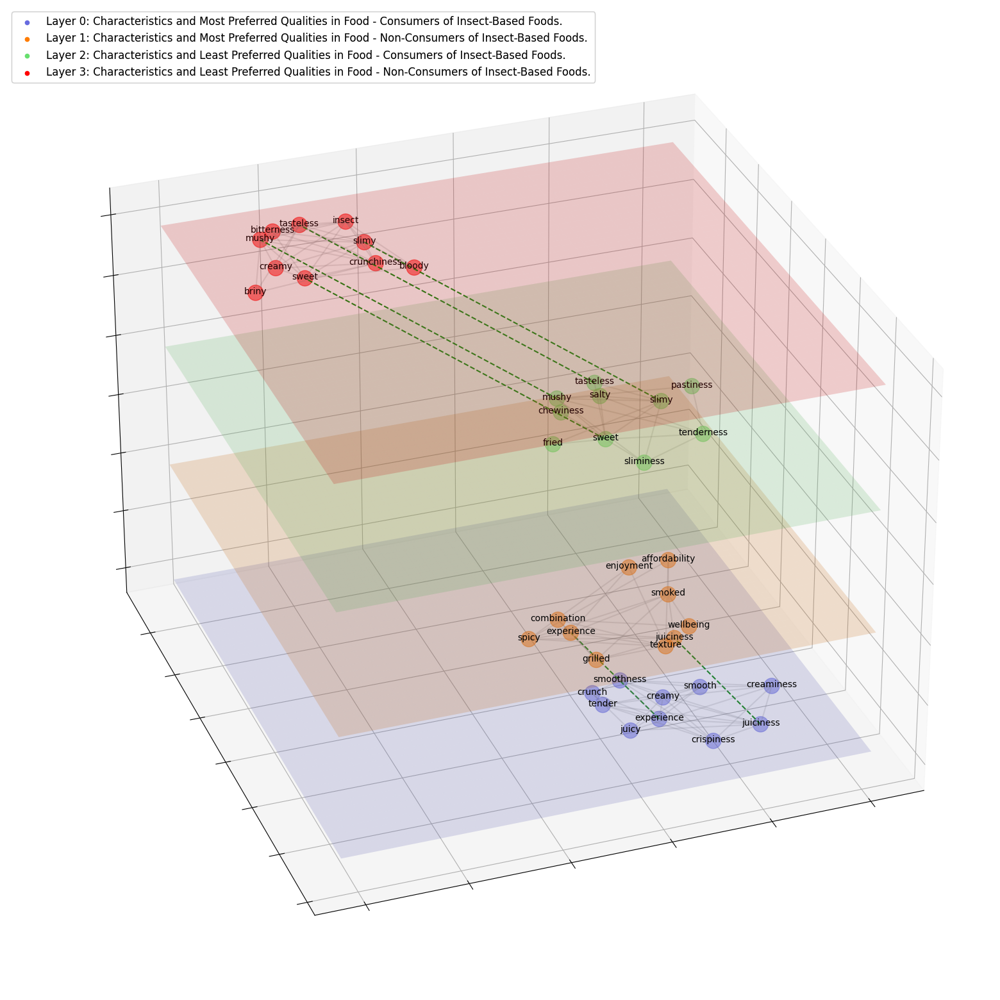

In [ ]:
class LayeredNetworkGraph(object):
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        self.graphs = graphs
        self.total_layers = len(graphs)
        self.node_labels = node_labels
        self.layout = layout
        if ax:
            self.ax = ax
        else:
            fig = plt.figure()
            self.ax = fig.add_subplot(111, projection='3d')
        self.get_nodes()
        self.get_edges_within_layers()
        self.get_edges_between_layers_by_shared_nodes()
        self.get_node_positions()
        self.draw()
    def get_nodes(self):
        self.nodes = []
        for z, g in enumerate(self.graphs):
            self.nodes.extend([(node, z) for node in g.nodes()])
    def get_edges_within_layers(self):
        self.edges_within_layers = []
        for z, g in enumerate(self.graphs):
            self.edges_within_layers.extend([((source, z), (target, z)) for source, target in g.edges()])
    def get_edges_between_layers_by_shared_nodes(self):
        self.edges_between_layers = []
        for z1, g in enumerate(self.graphs[:-1]):
            z2 = z1 + 1
            h = self.graphs[z2]
            shared_nodes = set(g.nodes()) & set(h.nodes())
            self.edges_between_layers.extend([((node, z1), (node, z2)) for node in shared_nodes])
    def get_node_positions(self, *args, **kwargs):
        composition = self.graphs[0]
        for h in self.graphs[1:]:
            composition = nx.compose(composition, h)
        pos = self.layout(composition, *args, **kwargs)
        self.node_positions = dict()
        for z, g in enumerate(self.graphs):
            layer_offset = z * 10  # Desplazamiento en z
            network_name = g.name
            x_layer_offset = network_offsets.get(network_name, {}).get('x_offset', 0) * z
            y_layer_offset = network_offsets.get(network_name, {}).get('y_offset', 0) * z
            self.node_positions.update({
                (node, z): (pos[node][0] + x_layer_offset, pos[node][1] + y_layer_offset, layer_offset)
                for node in g.nodes()
            })
    def draw_nodes(self, nodes, color,alpha =None, *args, **kwargs):
        x, y, z = zip(*[self.node_positions[node] for node in nodes])
        self.ax.scatter(x, y, z, color=color, alpha = 0.5, *args, **kwargs)
    def draw_edges(self, edges, *args, **kwargs):
        segments = [(self.node_positions[source], self.node_positions[target]) for source, target in edges]
        line_collection = Line3DCollection(segments, *args, **kwargs)
        self.ax.add_collection3d(line_collection)
    def get_extent(self, pad=0.1):
        xyz = np.array(list(self.node_positions.values()))
        xmin, ymin, _ = np.min(xyz, axis=0)
        xmax, ymax, _ = np.max(xyz, axis=0)
        dx = xmax - xmin
        dy = ymax - ymin
        return (xmin - pad * dx, xmax + pad * dx), \
            (ymin - pad * dy, ymax + pad * dy)
    def draw_plane(self, z, *args, **kwargs):
        network_name = self.graphs[z].name
        color = legend_info.get(network_name, '#CCCCCC')
        (xmin, xmax), (ymin, ymax) = self.get_extent(pad=0.1)
        u = np.linspace(xmin, xmax, 150)
        v = np.linspace(ymin, ymax, 150)
        U, V = np.meshgrid(u, v)
        layer_offset = z * 10
        W = layer_offset * np.ones_like(U)
        self.ax.plot_surface(U, V, W, color=color, *args, **kwargs)
    def synchronize_labels(self):
        missing_labels = set(self.node_positions.keys()) - set(self.node_labels.keys())
        for node in missing_labels:
            self.node_labels[node] = f"Nodo {node[0]}"
        extra_labels = set(self.node_labels.keys()) - set(self.node_positions.keys())
        for node in extra_labels:
            del self.node_labels[node]
    def draw(self):
        self.draw_edges(self.edges_within_layers, color='black', alpha=0.3, linestyle='-', zorder=2)
        self.draw_edges(self.edges_between_layers, color='Red', alpha=0.8, linestyle='--', zorder=2)
        for z in range(self.total_layers):
            self.draw_plane(z, alpha=0.2, zorder=1)
            color = legend_info.get(self.graphs[z].name, 'default_color')
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
        if self.node_labels:
            self.draw_node_labels(self.node_labels,
                                  horizontalalignment='center',
                                  verticalalignment='center',
                                  zorder=100)

    def draw_node_labels(self, labels, font_size=9, color='black', **kwargs):  # Tamaño de fuente reducido
        for node, (x, y, z) in self.node_positions.items():
            label = labels.get(node, f'{node[0]}')
            self.ax.text(x, y, z, label, fontsize=font_size, color=color, alpha=0.7, **kwargs)  # Añadida transparencia
    def calculate_heuristics(self):
        self.original_degrees = {node: degree for net in self.graphs for node, degree in net.degree()}
        self.apply_hemln_pg()
    def apply_hemln_pg(self):
        degrees_per_layer = [dict(net.degree()) for net in [net2, net2n, net3, net3n]]
        # Calcular el grado promedio en cada capa
        avg_degrees = [sum(degrees.values()) / len(degrees) for degrees in degrees_per_layer]
        # Identificar los nodos 'hub' en cada capa
        hubs_per_layer_pg = []
        for degrees, avg_degree in zip(degrees_per_layer, avg_degrees):
            hubs = [node for node, degree in degrees.items() if degree >= avg_degree]
            hubs_per_layer_pg.append(hubs)
        # Inicializar los grados actualizados de todos los nodos; nodos no 'hub' empiezan en cero
        updated_degrees_pg = {node: (degrees[node] if node in hubs else 0)
                              for degrees, hubs in zip(degrees_per_layer, hubs_per_layer_pg)
                              for node in degrees}
        # Incrementar el grado de los nodos 'hub' basándose en conexiones intercapas
        for i, net in enumerate([net2, net2n, net3, net3n]):
            #print(f"Procesando capa {i}...")  # Depurador: Indica la capa que se está procesando
            for hub in hubs_per_layer_pg[i]:
                next_layer_index = (i + 1) % len(degrees_per_layer)
                grado_original = updated_degrees_pg[hub]
                #print(f"Grado original de '{hub}': {grado_original}") # grado original del nodo 'hub'
                for neighbor in net[hub]:
                    if neighbor in hubs_per_layer_pg[next_layer_index]:
                        updated_degrees_pg[hub] += 1
                        #print(f" Incrementing the grade of '{hub}' cze it has a connection with '{neighbor}'")

                # Depurador: Imprime el grado actualizado del nodo 'hub'
                #print(f"Grado actualizado de '{hub}': {updated_degrees_pg[hub]}")
            #print("")  # Línea en blanco para separar la salida entre capas
        # Calcular el nuevo grado promedio solo de los nodos 'hub' actualizados
        new_avg_degrees_pg = sum(updated_degrees_pg.values()) / len([node for node in updated_degrees_pg if updated_degrees_pg[node] > 0])
        # HeMLN-AG: Actualizar grados de todos los nodos considerando conexiones entre capas
        updated_degrees_ag = {}
        for i, net in enumerate([net2, net2n, net3, net3n]):
            for node in net.nodes():
                # Grado interno (dentro de la misma capa)
                internal_degree = degrees_per_layer[i][node]
                # Grado externo (conexiones con la siguiente capa)
                external_degree = sum(1 for neighbor in net[node] if neighbor in [net2, net2n, net3, net3n][(i + 1) % 2].nodes())
                updated_degrees_ag[node] = internal_degree + external_degree
        # Calcular el grado promedio actualizado
        new_avg_degrees_ag = sum(updated_degrees_ag.values()) / len(updated_degrees_ag)
        self.updated_degrees_ag = updated_degrees_ag
        self.updated_degrees_pg = updated_degrees_pg
node_labels = {}
for z, g in enumerate([net2, net2n, net3, net3n]):
    for node in g.nodes():
        node_labels[(node, z)] = f'{node}'
class ModifiedLayeredNetworkGraph(LayeredNetworkGraph): #Se encarga únicamente de las comunidades de las redes.
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        super().__init__(graphs, node_labels=node_labels, layout=layout, ax=ax)
        """Determine edges between layers based on community detection."""
    def order_nodes_by_community(self):
        multiplex_network = nx.Graph()
        for z, g in enumerate(self.graphs):
            g = nx.relabel_nodes(g, {n: (n, z) for n in g.nodes()})
            multiplex_network = nx.compose(multiplex_network, g)
        partition = community_louvain.best_partition(multiplex_network)
        community_sizes = defaultdict(int)
        for node, community in partition.items():
            community_sizes[community] += 1
        ordered_nodes = {}
        for z, g in enumerate(self.graphs):
            nodes_in_layer = [(n, community_sizes[partition[(n, z)]]) for n in g.nodes()]
            nodes_in_layer.sort(key=lambda x: x[1], reverse=True)
            ordered_nodes[z] = [node for node, _ in nodes_in_layer]
    def draw(self):
        self.draw_edges(self.edges_between_layers, color='green', alpha=0.9, linestyle='--', zorder=2)
        self.draw_edges(self.edges_within_layers, color='grey', alpha=0.2, linestyle='-', zorder=1)
        for z in range(self.total_layers):
            self.draw_plane(z, alpha=0.18, zorder=1)
        for z in range(self.total_layers):
            color = legend_info[list(legend_info.keys())[z]]  # Obtiene el color de la leyenda
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
class NodeLabelPrinter:
    def __init__(self, ax, node_positions, node_labels, font_size=10, color='black'):
        self.ax = ax
        self.node_positions = node_positions
        self.node_labels = node_labels
        self.font_size = font_size
        self.color = color
    def print_labels(self):
        for node, position in self.node_positions.items():
            if node in self.node_labels:
                x, y, z = position
                label = self.node_labels.get(node, 'Nodo')
                self.ax.text(x, y, z + 0.1, label, fontsize=self.font_size, color=self.color,
                             ha='center', va='center', zorder=11)
legend_info = {
    'net2':'#676BDF',#Layer 0
    'net2n':'#FF7C00',#Layer 1
    'net3':'#67DF6E',#Layer 2
    'net3n':'#FF0000'#Layer 3
}
legend_infou = {
    'Layer 0: Characteristics and Most Preferred Qualities in Food - Consumers of Insect-Based Foods.':'#676BDF',
    'Layer 1: Characteristics and Most Preferred Qualities in Food - Non-Consumers of Insect-Based Foods.':'#FF7C00',
    'Layer 2: Characteristics and Least Preferred Qualities in Food - Consumers of Insect-Based Foods.':'#67DF6E',
    'Layer 3: Characteristics and Least Preferred Qualities in Food - Non-Consumers of Insect-Based Foods.':'#FF0000'
}
network_offsets = {
    'net2': {'x_offset': 0, 'y_offset': -1}, #Layer 0
    'net2n': {'x_offset': 1, 'y_offset': 0.3}, #Layer 1
    'net3': {'x_offset': 0.3, 'y_offset': -0.5}, #Layer 2
    'net3n': {'x_offset': 1, 'y_offset': -1}, #Layer 3
}
"""# En la función add_legend_with_degrees:
def add_legend_with_degrees(ax, graph, node_labels):
    legend_text = "Node Degrees:\n"
    for node, label in node_labels.items():
        # Aquí, asegúrate de que estás accediendo a los atributos correctos de 'graph'
        internal_degree = graph.original_degrees.get(node[0], 'N/A')  # node[0] es el nombre del nodo sin la coordenada z
        external_degree = graph.updated_degrees_ag.get(node[0], 'N/A')
        legend_text += f"{label}: IntD {internal_degree}, IntraD {external_degree}\n"

    ax.text2D(0.95, 0.2, legend_text, transform=ax.transAxes) """
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(111, projection='3d')
ax.view_init(elev=30, azim=70) #Elevación y Eje Z
graph = ModifiedLayeredNetworkGraph([net2, net2n, net3, net3n],
                                    node_labels=node_labels,
                                    layout=lambda G: nx.spring_layout(G, k=3, iterations=10),
                                    ax=ax)
graph.order_nodes_by_community()
graph.calculate_heuristics()
label_printer = NodeLabelPrinter(ax, graph.node_positions, node_labels)
label_printer.print_labels()
#ax.set_xlabel('X')
#ax.set_ylabel('Y')
#ax.set_zlabel('Z')
for label, color in legend_infou.items():
    ax.scatter([], [], c=color, label=label)
legend_color = ax.legend(loc='upper left', frameon=True, fontsize=12)
ax.add_artist(legend_color)
#add_legend_with_degrees(ax, graph, node_labels)
ax.set_xticklabels([])
ax.set_yticklabels([])
ax.set_zticklabels([])
plt.draw()
plt.show()
fig.savefig('Multinetwork2.JPEG', format='JPEG', dpi=300)

In [ ]:
color

'#FF0000'

In [ ]:
# Calcular los grados de cada nodo en todas las capas
degrees_per_layer = [dict(net.degree()) for net in [net2, net2n, net3, net3n]]

In [ ]:
degrees_per_layer

[{'creamy': 6,
  'crunchy': 4,
  'experience': 6,
  'grilled': 6,
  'juicy': 7,
  'sensation': 7,
  'smooth': 5,
  'softness': 6,
  'sweet': 3,
  'texture': 8},
 {'affordability': 4,
  'combination': 5,
  'enjoyment': 6,
  'experience': 6,
  'grilled': 5,
  'juiciness': 7,
  'spicy': 6,
  'sweet': 5,
  'texture': 4,
  'wellbeing': 6},
 {'chewiness': 2,
  'crispness': 5,
  'crunch': 6,
  'mushy': 5,
  'pastiness': 4,
  'salty': 5,
  'sliminess': 4,
  'slimy': 7,
  'sweet': 6,
  'tenderness': 8},
 {'bitterness': 6,
  'bloody': 3,
  'briny': 3,
  'creamy': 6,
  'crunchiness': 8,
  'insect': 8,
  'mushy': 8,
  'slimy': 8,
  'sweet': 7,
  'tasteless': 7}]

In [ ]:
# Calcular el grado promedio en cada capa
avg_degrees = [sum(degrees.values()) / len(degrees) for degrees in degrees_per_layer]

In [ ]:
avg_degrees

[5.8, 5.4, 5.2, 6.4]

In [ ]:
# Identificar los nodos 'hub' en cada capa
hubs_per_layer_pg = []
for degrees, avg_degree in zip(degrees_per_layer, avg_degrees):
    hubs = [node for node, degree in degrees.items() if degree >= avg_degree]
    """Aquí, todo depende del criterio para identificar lo que es un 'hub' que en este caso se incluye a todos los nodos >= al promedio, pero
    depende de cada investigador cómo promediar la cosa, it could be only those nodes > than the average or = to the average, it deepends on everyone"""
    hubs_per_layer_pg.append(hubs)

In [ ]:
hubs_per_layer_pg

[['creamy',
  'experience',
  'grilled',
  'juicy',
  'sensation',
  'softness',
  'texture'],
 ['enjoyment', 'experience', 'juiciness', 'spicy', 'wellbeing'],
 ['crunch', 'slimy', 'sweet', 'tenderness'],
 ['crunchiness', 'insect', 'mushy', 'slimy', 'sweet', 'tasteless']]

In [ ]:
# Inicializar los grados actualizados de todos los nodos; nodos no 'hub' empiezan en cero
updated_degrees_pg = {node: (degrees[node] if node in hubs else 0)
                      for degrees, hubs in zip(degrees_per_layer, hubs_per_layer_pg)
                      for node in degrees}

In [ ]:
updated_degrees_pg

{'creamy': 0,
 'crunchy': 0,
 'experience': 6,
 'grilled': 0,
 'juicy': 7,
 'sensation': 7,
 'smooth': 0,
 'softness': 6,
 'sweet': 7,
 'texture': 0,
 'affordability': 0,
 'combination': 0,
 'enjoyment': 6,
 'juiciness': 7,
 'spicy': 6,
 'wellbeing': 6,
 'chewiness': 0,
 'crispness': 0,
 'crunch': 6,
 'mushy': 8,
 'pastiness': 0,
 'salty': 0,
 'sliminess': 0,
 'slimy': 8,
 'tenderness': 8,
 'bitterness': 0,
 'bloody': 0,
 'briny': 0,
 'crunchiness': 8,
 'insect': 8,
 'tasteless': 7}

In [ ]:
# Incrementar el grado de los nodos 'hub' basándose en conexiones intercapas
for i, net in enumerate([net2, net2n, net3, net3n]):
    print(f"Procesando capa {i}...")  # Depurador: Indica la capa que se está procesando
    for hub in hubs_per_layer_pg[i]:
        next_layer_index = (i + 1) % len(degrees_per_layer)
        grado_original = updated_degrees_pg[hub]
        print(f"Grado original de '{hub}': {grado_original}") # grado original del nodo 'hub'
        for neighbor in net[hub]:
            if neighbor in hubs_per_layer_pg[next_layer_index]:
                updated_degrees_pg[hub] += 1
                print(f"   Incrementando grado de '{hub}' por conexión con '{neighbor}' en la siguiente capa")

        # Depurador: Imprime el grado actualizado del nodo 'hub'
        print(f"Grado actualizado de '{hub}': {updated_degrees_pg[hub]}")
    print("")  # Línea en blanco para separar la salida entre capas

Procesando capa 0...
Grado original de 'creamy': 0
Grado actualizado de 'creamy': 0
Grado original de 'experience': 6
Grado actualizado de 'experience': 6
Grado original de 'grilled': 0
   Incrementando grado de 'grilled' por conexión con 'experience' en la siguiente capa
Grado actualizado de 'grilled': 1
Grado original de 'juicy': 7
   Incrementando grado de 'juicy' por conexión con 'experience' en la siguiente capa
Grado actualizado de 'juicy': 8
Grado original de 'sensation': 7
   Incrementando grado de 'sensation' por conexión con 'experience' en la siguiente capa
Grado actualizado de 'sensation': 8
Grado original de 'softness': 6
Grado actualizado de 'softness': 6
Grado original de 'texture': 0
   Incrementando grado de 'texture' por conexión con 'experience' en la siguiente capa
Grado actualizado de 'texture': 1

Procesando capa 1...
Grado original de 'enjoyment': 6
   Incrementando grado de 'enjoyment' por conexión con 'sweet' en la siguiente capa
Grado actualizado de 'enjoyment

In [ ]:
# Calcular el nuevo grado promedio solo de los nodos 'hub' actualizados
new_avg_degrees_pg = sum(updated_degrees_pg.values()) / len([node for node in updated_degrees_pg if updated_degrees_pg[node] > 0])
new_avg_degrees_pg

7.166666666666667

In [ ]:
# HeMLN-AG: Actualizar grados de todos los nodos considerando conexiones entre capas
updated_degrees_ag = {}
for i, net in enumerate([net2, net2n, net3, net3n]):
    for node in net.nodes():
        # Grado interno (dentro de la misma capa)
        internal_degree = degrees_per_layer[i][node]
        # Grado externo (conexiones con la siguiente capa)
        external_degree = sum(1 for neighbor in net[node] if neighbor in [net2, net2n, net3, net3n][(i + 1) % 2].nodes())
        updated_degrees_ag[node] = internal_degree + external_degree

updated_degrees_ag

{'creamy': 7,
 'crunchy': 6,
 'experience': 8,
 'grilled': 7,
 'juicy': 10,
 'sensation': 10,
 'smooth': 7,
 'softness': 9,
 'sweet': 8,
 'texture': 5,
 'affordability': 5,
 'combination': 6,
 'enjoyment': 9,
 'juiciness': 10,
 'spicy': 9,
 'wellbeing': 9,
 'chewiness': 3,
 'crispness': 6,
 'crunch': 6,
 'mushy': 10,
 'pastiness': 5,
 'salty': 6,
 'sliminess': 5,
 'slimy': 10,
 'tenderness': 9,
 'bitterness': 7,
 'bloody': 4,
 'briny': 3,
 'crunchiness': 10,
 'insect': 10,
 'tasteless': 8}

In [ ]:
# Calcular el grado promedio actualizado
new_avg_degrees_ag = sum(updated_degrees_ag.values()) / len(updated_degrees_ag)
new_avg_degrees_ag

7.32258064516129

#Cultural Beleifs + Labels


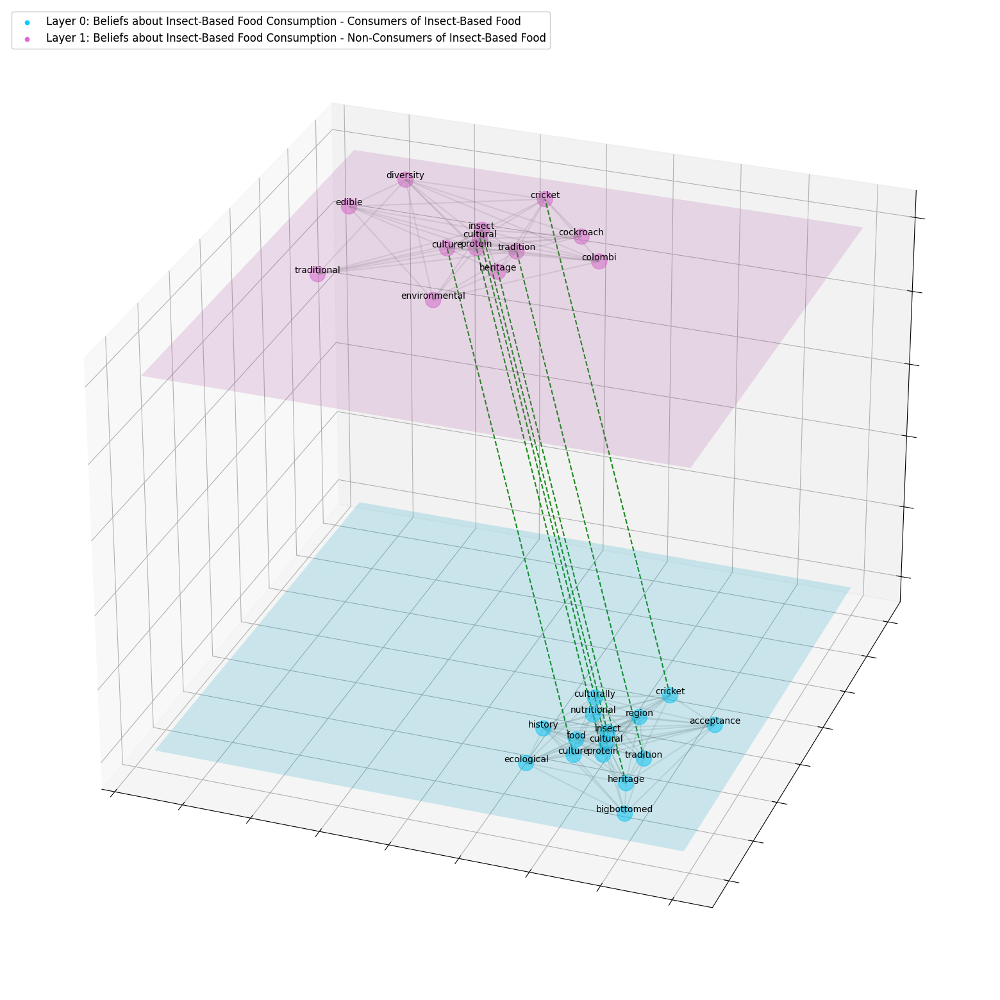

In [ ]:
class LayeredNetworkGraph(object):
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        self.graphs = graphs
        self.total_layers = len(graphs)
        self.node_labels = node_labels
        self.layout = layout
        if ax:
            self.ax = ax
        else:
            fig = plt.figure()
            self.ax = fig.add_subplot(111, projection='3d')
        self.get_nodes()
        self.get_edges_within_layers()
        self.get_edges_between_layers_by_shared_nodes()
        self.get_node_positions()
        self.draw()
    def get_nodes(self):
        self.nodes = []
        for z, g in enumerate(self.graphs):
            self.nodes.extend([(node, z) for node in g.nodes()])
    def get_edges_within_layers(self):
        self.edges_within_layers = []
        for z, g in enumerate(self.graphs):
            self.edges_within_layers.extend([((source, z), (target, z)) for source, target in g.edges()])
    def get_edges_between_layers_by_shared_nodes(self):
        self.edges_between_layers = []
        for z1, g in enumerate(self.graphs[:-1]):
            z2 = z1 + 1
            h = self.graphs[z2]
            shared_nodes = set(g.nodes()) & set(h.nodes())
            self.edges_between_layers.extend([((node, z1), (node, z2)) for node in shared_nodes])
    def get_node_positions(self, *args, **kwargs):
        composition = self.graphs[0]
        for h in self.graphs[1:]:
            composition = nx.compose(composition, h)
        pos = self.layout(composition, *args, **kwargs)
        self.node_positions = dict()
        for z, g in enumerate(self.graphs):
            layer_offset = z * 10  # Desplazamiento en z
            network_name = g.name
            x_layer_offset = network_offsets.get(network_name, {}).get('x_offset', 0) * z
            y_layer_offset = network_offsets.get(network_name, {}).get('y_offset', 0) * z
            self.node_positions.update({
                (node, z): (pos[node][0] + x_layer_offset, pos[node][1] + y_layer_offset, layer_offset)
                for node in g.nodes()
            })
    def draw_nodes(self, nodes, color,alpha =None, *args, **kwargs):
        x, y, z = zip(*[self.node_positions[node] for node in nodes])
        self.ax.scatter(x, y, z, color=color, alpha = 0.5, *args, **kwargs)
    def draw_edges(self, edges, *args, **kwargs):
        segments = [(self.node_positions[source], self.node_positions[target]) for source, target in edges]
        line_collection = Line3DCollection(segments, *args, **kwargs)
        self.ax.add_collection3d(line_collection)
    def get_extent(self, pad=0.1):
        xyz = np.array(list(self.node_positions.values()))
        xmin, ymin, _ = np.min(xyz, axis=0)
        xmax, ymax, _ = np.max(xyz, axis=0)
        dx = xmax - xmin
        dy = ymax - ymin
        return (xmin - pad * dx, xmax + pad * dx), \
            (ymin - pad * dy, ymax + pad * dy)
    def draw_plane(self, z, *args, **kwargs):
        network_name = self.graphs[z].name
        color = legend_info.get(network_name, '#CCCCCC')
        (xmin, xmax), (ymin, ymax) = self.get_extent(pad=0.1)
        u = np.linspace(xmin, xmax, 150)
        v = np.linspace(ymin, ymax, 150)
        U, V = np.meshgrid(u, v)
        layer_offset = z * 10
        W = layer_offset * np.ones_like(U)
        self.ax.plot_surface(U, V, W, color=color, *args, **kwargs)
    def synchronize_labels(self):
        missing_labels = set(self.node_positions.keys()) - set(self.node_labels.keys())
        for node in missing_labels:
            self.node_labels[node] = f"Nodo {node[0]}"
        extra_labels = set(self.node_labels.keys()) - set(self.node_positions.keys())
        for node in extra_labels:
            del self.node_labels[node]
    def draw(self):
        self.draw_edges(self.edges_within_layers, color='black', alpha=0.3, linestyle='-', zorder=2)
        self.draw_edges(self.edges_between_layers, color='Red', alpha=0.8, linestyle='--', zorder=2)
        for z in range(self.total_layers):
            self.draw_plane(z, alpha=0.2, zorder=1)
            color = legend_info.get(self.graphs[z].name, 'default_color')
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
        if self.node_labels:
            self.draw_node_labels(self.node_labels,
                                  horizontalalignment='center',
                                  verticalalignment='center',
                                  zorder=100)

    def draw_node_labels(self, labels, font_size=9, color='black', **kwargs):  # Tamaño de fuente reducido
        for node, (x, y, z) in self.node_positions.items():
            label = labels.get(node, f'{node[0]}')
            self.ax.text(x, y, z, label, fontsize=font_size, color=color, alpha=0.7, **kwargs)  # Añadida transparencia
    def calculate_heuristics(self):
        self.original_degrees = {node: degree for net in self.graphs for node, degree in net.degree()}
        self.apply_hemln_pg()
    def apply_hemln_pg(self):
        degrees_per_layer = [dict(net.degree()) for net in [net4, net4n]]
        # Calcular el grado promedio en cada capa
        avg_degrees = [sum(degrees.values()) / len(degrees) for degrees in degrees_per_layer]
        # Identificar los nodos 'hub' en cada capa
        hubs_per_layer_pg = []
        for degrees, avg_degree in zip(degrees_per_layer, avg_degrees):
            hubs = [node for node, degree in degrees.items() if degree >= avg_degree]
            hubs_per_layer_pg.append(hubs)
        # Inicializar los grados actualizados de todos los nodos; nodos no 'hub' empiezan en cero
        updated_degrees_pg = {node: (degrees[node] if node in hubs else 0)
                              for degrees, hubs in zip(degrees_per_layer, hubs_per_layer_pg)
                              for node in degrees}
        # Incrementar el grado de los nodos 'hub' basándose en conexiones intercapas
        for i, net in enumerate([net4, net4n]):
            #print(f"Procesando capa {i}...")  # Depurador: Indica la capa que se está procesando
            for hub in hubs_per_layer_pg[i]:
                next_layer_index = (i + 1) % len(degrees_per_layer)
                grado_original = updated_degrees_pg[hub]
                #print(f"Grado original de '{hub}': {grado_original}") # grado original del nodo 'hub'
                for neighbor in net[hub]:
                    if neighbor in hubs_per_layer_pg[next_layer_index]:
                        updated_degrees_pg[hub] += 1
                        #print(f" Incrementing the grade of '{hub}' cze it has a connection with '{neighbor}'")

                # Depurador: Imprime el grado actualizado del nodo 'hub'
                #print(f"Grado actualizado de '{hub}': {updated_degrees_pg[hub]}")
            #print("")  # Línea en blanco para separar la salida entre capas
        # Calcular el nuevo grado promedio solo de los nodos 'hub' actualizados
        new_avg_degrees_pg = sum(updated_degrees_pg.values()) / len([node for node in updated_degrees_pg if updated_degrees_pg[node] > 0])
        # HeMLN-AG: Actualizar grados de todos los nodos considerando conexiones entre capas
        updated_degrees_ag = {}
        for i, net in enumerate([net4, net4n]):
            for node in net.nodes():
                # Grado interno (dentro de la misma capa)
                internal_degree = degrees_per_layer[i][node]
                # Grado externo (conexiones con la siguiente capa)
                external_degree = sum(1 for neighbor in net[node] if neighbor in [net4, net4n][(i + 1) % 2].nodes())
                updated_degrees_ag[node] = internal_degree + external_degree
        # Calcular el grado promedio actualizado
        new_avg_degrees_ag = sum(updated_degrees_ag.values()) / len(updated_degrees_ag)
        self.updated_degrees_ag = updated_degrees_ag
        self.updated_degrees_pg = updated_degrees_pg
node_labels = {}
for z, g in enumerate([net4, net4n]):
    for node in g.nodes():
        node_labels[(node, z)] = f'{node}'
class ModifiedLayeredNetworkGraph(LayeredNetworkGraph): #Se encarga únicamente de las comunidades de las redes.
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        super().__init__(graphs, node_labels=node_labels, layout=layout, ax=ax)
        """Determine edges between layers based on community detection."""
    def order_nodes_by_community(self):
        multiplex_network = nx.Graph()
        for z, g in enumerate(self.graphs):
            g = nx.relabel_nodes(g, {n: (n, z) for n in g.nodes()})
            multiplex_network = nx.compose(multiplex_network, g)
        partition = community_louvain.best_partition(multiplex_network)
        community_sizes = defaultdict(int)
        for node, community in partition.items():
            community_sizes[community] += 1
        ordered_nodes = {}
        for z, g in enumerate(self.graphs):
            nodes_in_layer = [(n, community_sizes[partition[(n, z)]]) for n in g.nodes()]
            nodes_in_layer.sort(key=lambda x: x[1], reverse=True)
            ordered_nodes[z] = [node for node, _ in nodes_in_layer]
    def draw(self):
        self.draw_edges(self.edges_between_layers, color='green', alpha=0.9, linestyle='--', zorder=2)
        self.draw_edges(self.edges_within_layers, color='grey', alpha=0.2, linestyle='-', zorder=1)
        for z in range(self.total_layers):
            self.draw_plane(z, alpha=0.18, zorder=1)
        for z in range(self.total_layers):
            color = legend_info[list(legend_info.keys())[z]]  # Obtiene el color de la leyenda
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
class NodeLabelPrinter:
    def __init__(self, ax, node_positions, node_labels, font_size=10, color='black'):
        self.ax = ax
        self.node_positions = node_positions
        self.node_labels = node_labels
        self.font_size = font_size
        self.color = color
    def print_labels(self):
        for node, position in self.node_positions.items():
            if node in self.node_labels:
                x, y, z = position
                label = self.node_labels.get(node, 'Nodo')
                self.ax.text(x, y, z + 0.1, label, fontsize=self.font_size, color=self.color,
                             ha='center', va='center', zorder=11)
legend_info = {
    'net4':'#03CDFE',
    'net4n':'#DF67D2'
}
legend_infou = {
    'Layer 0: Beliefs about Insect-Based Food Consumption - Consumers of Insect-Based Food':'#03CDFE',
    'Layer 1: Beliefs about Insect-Based Food Consumption - Non-Consumers of Insect-Based Food':'#DF67D2'
}
network_offsets = {
    'net4': {'x_offset': -0.5, 'y_offset': -0.5}, #Azul
    'net4n': {'x_offset': -1.5, 'y_offset': 1.5}, #Purpura
}
"""# En la función add_legend_with_degrees:
def add_legend_with_degrees(ax, graph, node_labels):
    legend_text = "Node Degrees:\n"
    for node, label in node_labels.items():
        # Aquí, asegúrate de que estás accediendo a los atributos correctos de 'graph'
        internal_degree = graph.original_degrees.get(node[0], 'N/A')  # node[0] es el nombre del nodo sin la coordenada z
        external_degree = graph.updated_degrees_ag.get(node[0], 'N/A')
        legend_text += f"{label}: IntD {internal_degree}, IntraD {external_degree}\n"

    ax.text2D(0.95, 0.5, legend_text, transform=ax.transAxes)"""
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(111, projection='3d')
ax.view_init(elev=28, azim=-70) #Elevación y Eje Z
graph = ModifiedLayeredNetworkGraph([net4, net4n],
                                    node_labels=node_labels,
                                    layout=lambda G: nx.spring_layout(G, k=4, iterations=15),
                                    ax=ax)
graph.order_nodes_by_community()
graph.calculate_heuristics()
label_printer = NodeLabelPrinter(ax, graph.node_positions, node_labels)
label_printer.print_labels()
#ax.set_xlabel('X')
#ax.set_ylabel('Y')
#ax.set_zlabel('Z')
for label, color in legend_infou.items():
    ax.scatter([], [], c=color, label=label)
legend_color = ax.legend(loc='upper left', frameon=True, fontsize=12)
ax.add_artist(legend_color)
#add_legend_with_degrees(ax, graph, node_labels)
ax.set_xticklabels([])
ax.set_yticklabels([])
ax.set_zticklabels([])
plt.draw()
plt.show()
fig.savefig('Multinetwork3.JPEG', format='JPEG', dpi=300)

#Knowledge + Labels

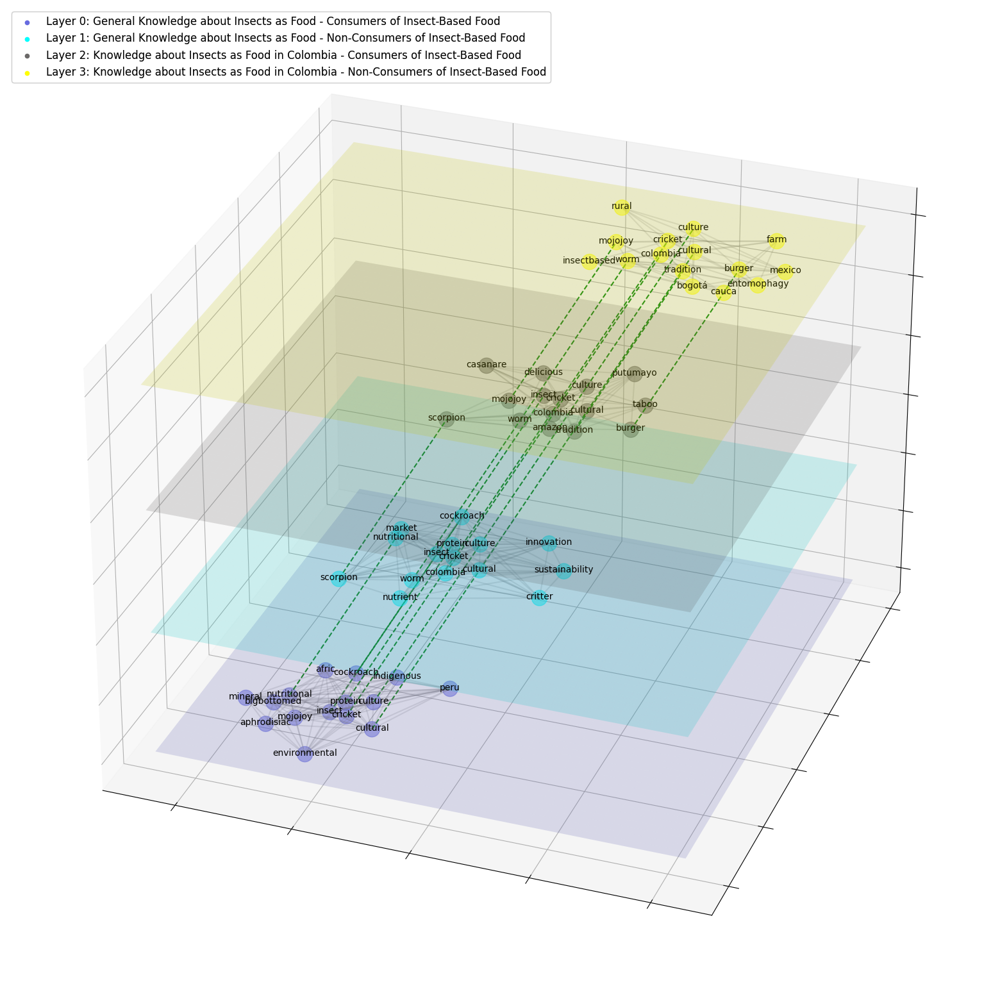

In [ ]:
class LayeredNetworkGraph(object):
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        self.graphs = graphs
        self.total_layers = len(graphs)
        self.node_labels = node_labels
        self.layout = layout
        if ax:
            self.ax = ax
        else:
            fig = plt.figure()
            self.ax = fig.add_subplot(111, projection='3d')
        self.get_nodes()
        self.get_edges_within_layers()
        self.get_edges_between_layers_by_shared_nodes()
        self.get_node_positions()
        self.draw()
    def get_nodes(self):
        self.nodes = []
        for z, g in enumerate(self.graphs):
            self.nodes.extend([(node, z) for node in g.nodes()])
    def get_edges_within_layers(self):
        self.edges_within_layers = []
        for z, g in enumerate(self.graphs):
            self.edges_within_layers.extend([((source, z), (target, z)) for source, target in g.edges()])
    def get_edges_between_layers_by_shared_nodes(self):
        self.edges_between_layers = []
        for z1, g in enumerate(self.graphs[:-1]):
            z2 = z1 + 1
            h = self.graphs[z2]
            shared_nodes = set(g.nodes()) & set(h.nodes())
            self.edges_between_layers.extend([((node, z1), (node, z2)) for node in shared_nodes])
    def get_node_positions(self, *args, **kwargs):
        composition = self.graphs[0]
        for h in self.graphs[1:]:
            composition = nx.compose(composition, h)
        pos = self.layout(composition, *args, **kwargs)
        self.node_positions = dict()
        for z, g in enumerate(self.graphs):
            layer_offset = z * 10  # Desplazamiento en z
            network_name = g.name
            x_layer_offset = network_offsets.get(network_name, {}).get('x_offset', 0) * z
            y_layer_offset = network_offsets.get(network_name, {}).get('y_offset', 0) * z
            self.node_positions.update({
                (node, z): (pos[node][0] + x_layer_offset, pos[node][1] + y_layer_offset, layer_offset)
                for node in g.nodes()
            })
    def draw_nodes(self, nodes, color,alpha =None, *args, **kwargs):
        x, y, z = zip(*[self.node_positions[node] for node in nodes])
        self.ax.scatter(x, y, z, color=color, alpha = 0.5, *args, **kwargs)
    def draw_edges(self, edges, *args, **kwargs):
        segments = [(self.node_positions[source], self.node_positions[target]) for source, target in edges]
        line_collection = Line3DCollection(segments, *args, **kwargs)
        self.ax.add_collection3d(line_collection)
    def get_extent(self, pad=0.1):
        xyz = np.array(list(self.node_positions.values()))
        xmin, ymin, _ = np.min(xyz, axis=0)
        xmax, ymax, _ = np.max(xyz, axis=0)
        dx = xmax - xmin
        dy = ymax - ymin
        return (xmin - pad * dx, xmax + pad * dx), \
            (ymin - pad * dy, ymax + pad * dy)
    def draw_plane(self, z, *args, **kwargs):
        network_name = self.graphs[z].name
        color = legend_info.get(network_name, '#CCCCCC')
        (xmin, xmax), (ymin, ymax) = self.get_extent(pad=0.1)
        u = np.linspace(xmin, xmax, 150)
        v = np.linspace(ymin, ymax, 150)
        U, V = np.meshgrid(u, v)
        layer_offset = z * 10
        W = layer_offset * np.ones_like(U)
        self.ax.plot_surface(U, V, W, color=color, *args, **kwargs)
    def synchronize_labels(self):
        missing_labels = set(self.node_positions.keys()) - set(self.node_labels.keys())
        for node in missing_labels:
            self.node_labels[node] = f"Nodo {node[0]}"
        extra_labels = set(self.node_labels.keys()) - set(self.node_positions.keys())
        for node in extra_labels:
            del self.node_labels[node]
    def draw(self):
        self.draw_edges(self.edges_within_layers, color='black', alpha=0.3, linestyle='-', zorder=2)
        self.draw_edges(self.edges_between_layers, color='Red', alpha=0.8, linestyle='--', zorder=2)
        for z in range(self.total_layers):
            self.draw_plane(z, alpha=0.2, zorder=1)
            color = legend_info.get(self.graphs[z].name, 'default_color')
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
        if self.node_labels:
            self.draw_node_labels(self.node_labels,
                                  horizontalalignment='center',
                                  verticalalignment='center',
                                  zorder=100)

    def draw_node_labels(self, labels, font_size=9, color='black', **kwargs):  # Tamaño de fuente reducido
        for node, (x, y, z) in self.node_positions.items():
            label = labels.get(node, f'{node[0]}')
            self.ax.text(x, y, z, label, fontsize=font_size, color=color, alpha=0.7, **kwargs)  # Añadida transparencia
    def calculate_heuristics(self):
        self.original_degrees = {node: degree for net in self.graphs for node, degree in net.degree()}
        self.apply_hemln_pg()
    def apply_hemln_pg(self):
        degrees_per_layer = [dict(net.degree()) for net in [net5, net5n, net6, net6n]]
        # Calcular el grado promedio en cada capa
        avg_degrees = [sum(degrees.values()) / len(degrees) for degrees in degrees_per_layer]
        # Identificar los nodos 'hub' en cada capa
        hubs_per_layer_pg = []
        for degrees, avg_degree in zip(degrees_per_layer, avg_degrees):
            hubs = [node for node, degree in degrees.items() if degree >= avg_degree]
            hubs_per_layer_pg.append(hubs)
        # Inicializar los grados actualizados de todos los nodos; nodos no 'hub' empiezan en cero
        updated_degrees_pg = {node: (degrees[node] if node in hubs else 0)
                              for degrees, hubs in zip(degrees_per_layer, hubs_per_layer_pg)
                              for node in degrees}
        # Incrementar el grado de los nodos 'hub' basándose en conexiones intercapas
        for i, net in enumerate([net5, net5n, net6, net6n]):
            #print(f"Procesando capa {i}...")  # Depurador: Indica la capa que se está procesando
            for hub in hubs_per_layer_pg[i]:
                next_layer_index = (i + 1) % len(degrees_per_layer)
                grado_original = updated_degrees_pg[hub]
                #print(f"Grado original de '{hub}': {grado_original}") # grado original del nodo 'hub'
                for neighbor in net[hub]:
                    if neighbor in hubs_per_layer_pg[next_layer_index]:
                        updated_degrees_pg[hub] += 1
                        #print(f" Incrementing the grade of '{hub}' cze it has a connection with '{neighbor}'")

                # Depurador: Imprime el grado actualizado del nodo 'hub'
                #print(f"Grado actualizado de '{hub}': {updated_degrees_pg[hub]}")
            #print("")  # Línea en blanco para separar la salida entre capas
        # Calcular el nuevo grado promedio solo de los nodos 'hub' actualizados
        new_avg_degrees_pg = sum(updated_degrees_pg.values()) / len([node for node in updated_degrees_pg if updated_degrees_pg[node] > 0])
        # HeMLN-AG: Actualizar grados de todos los nodos considerando conexiones entre capas
        updated_degrees_ag = {}
        for i, net in enumerate([net5, net5n, net6, net6n]):
            for node in net.nodes():
                # Grado interno (dentro de la misma capa)
                internal_degree = degrees_per_layer[i][node]
                # Grado externo (conexiones con la siguiente capa)
                external_degree = sum(1 for neighbor in net[node] if neighbor in [net5, net5n, net6, net6n][(i + 1) % 2].nodes())
                updated_degrees_ag[node] = internal_degree + external_degree
        # Calcular el grado promedio actualizado
        new_avg_degrees_ag = sum(updated_degrees_ag.values()) / len(updated_degrees_ag)
        self.updated_degrees_ag = updated_degrees_ag
        self.updated_degrees_pg = updated_degrees_pg
node_labels = {}
for z, g in enumerate([net5, net5n, net6, net6n]):
    for node in g.nodes():
        node_labels[(node, z)] = f'{node}'
class ModifiedLayeredNetworkGraph(LayeredNetworkGraph): #Se encarga únicamente de las comunidades de las redes.
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        super().__init__(graphs, node_labels=node_labels, layout=layout, ax=ax)
        """Determine edges between layers based on community detection."""
    def order_nodes_by_community(self):
        multiplex_network = nx.Graph()
        for z, g in enumerate(self.graphs):
            g = nx.relabel_nodes(g, {n: (n, z) for n in g.nodes()})
            multiplex_network = nx.compose(multiplex_network, g)
        partition = community_louvain.best_partition(multiplex_network)
        community_sizes = defaultdict(int)
        for node, community in partition.items():
            community_sizes[community] += 1
        ordered_nodes = {}
        for z, g in enumerate(self.graphs):
            nodes_in_layer = [(n, community_sizes[partition[(n, z)]]) for n in g.nodes()]
            nodes_in_layer.sort(key=lambda x: x[1], reverse=True)
            ordered_nodes[z] = [node for node, _ in nodes_in_layer]
    def draw(self):
        self.draw_edges(self.edges_between_layers, color='green', alpha=0.9, linestyle='--', zorder=2)
        self.draw_edges(self.edges_within_layers, color='grey', alpha=0.2, linestyle='-', zorder=1)
        for z in range(self.total_layers):
            self.draw_plane(z, alpha=0.18, zorder=1)
        for z in range(self.total_layers):
            color = legend_info[list(legend_info.keys())[z]]  # Obtiene el color de la leyenda
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
class NodeLabelPrinter:
    def __init__(self, ax, node_positions, node_labels, font_size=10, color='black'):
        self.ax = ax
        self.node_positions = node_positions
        self.node_labels = node_labels
        self.font_size = font_size
        self.color = color
    def print_labels(self):
        for node, position in self.node_positions.items():
            if node in self.node_labels:
                x, y, z = position
                label = self.node_labels.get(node, 'Nodo')
                self.ax.text(x, y, z + 0.1, label, fontsize=self.font_size, color=self.color,
                             ha='center', va='center', zorder=11)
legend_info = {
    'net5':'#676BDF',
    'net5n':'#03FEFE',
    'net6':'#6B6968',
    'net6n':'#FEFE03'
}
legend_infou = {
'Layer 0: General Knowledge about Insects as Food - Consumers of Insect-Based Food': '#676BDF',
'Layer 1: General Knowledge about Insects as Food - Non-Consumers of Insect-Based Food': '#03FEFE',
'Layer 2: Knowledge about Insects as Food in Colombia - Consumers of Insect-Based Food': '#6B6968',
'Layer 3: Knowledge about Insects as Food in Colombia - Non-Consumers of Insect-Based Food': '#FEFE03'
}
network_offsets = {
    'net5': {'x_offset': 0, 'y_offset':0}, #morado
    'net5n': {'x_offset':0.6, 'y_offset': 1}, #Aguamarina
    'net6': {'x_offset': 0.6, 'y_offset':1}, #negra
    'net6n': {'x_offset':0.6, 'y_offset': 1}, #Amarilla -> Toda la visualización depende de dónde está la primera y la últoma red.
}
"""# En la función add_legend_with_degrees:
def add_legend_with_degrees(ax, graph, node_labels):
    legend_text = "Node Degrees:\n"
    for node, label in node_labels.items():
        # Aquí, asegúrate de que estás accediendo a los atributos correctos de 'graph'
        internal_degree = graph.original_degrees.get(node[0], 'N/A')  # node[0] es el nombre del nodo sin la coordenada z
        external_degree = graph.updated_degrees_ag.get(node[0], 'N/A')
        legend_text += f"{label}: IntD {internal_degree}, IntraD {external_degree}\n"

    ax.text2D(0.99, 0.2, legend_text, transform=ax.transAxes) """
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(111, projection='3d')
ax.view_init(elev=30, azim=-70) #Elevación y Eje Z
graph = ModifiedLayeredNetworkGraph([net5, net5n, net6, net6n],
                                    node_labels=node_labels,
                                    layout=lambda G: nx.spring_layout(G, k=4, iterations=10),
                                    ax=ax)
graph.order_nodes_by_community()
graph.calculate_heuristics()
label_printer = NodeLabelPrinter(ax, graph.node_positions, node_labels)
label_printer.print_labels()
#ax.set_xlabel('X')
#ax.set_ylabel('Y')
#ax.set_zlabel('Z')
for label, color in legend_infou.items():
    ax.scatter([], [], c=color, label=label)
legend_color = ax.legend(loc='upper left', frameon=True, fontsize=12)
ax.add_artist(legend_color)
#add_legend_with_degrees(ax, graph, node_labels)
ax.set_xticklabels([])
ax.set_yticklabels([])
ax.set_zticklabels([])
plt.draw()
plt.show()
fig.savefig('Multinetwork4.JPEG', format='JPEG', dpi=300)

In [ ]:
# Calcular los grados de cada nodo en todas las capas
degrees_per_layer = [dict(net.degree()) for net in [net5, net5n, net6, net6n]]

In [ ]:
degrees_per_layer

[{'afric': 14,
  'aphrodisiac': 14,
  'bigbottomed': 14,
  'cockroach': 14,
  'cricket': 14,
  'cultural': 14,
  'culture': 14,
  'environmental': 14,
  'indigenous': 14,
  'insect': 14,
  'mineral': 14,
  'mojojoy': 14,
  'nutritional': 14,
  'peru': 14,
  'protein': 14},
 {'cockroach': 12,
  'colombia': 12,
  'cricket': 13,
  'critter': 11,
  'cultural': 11,
  'culture': 14,
  'innovation': 14,
  'insect': 11,
  'market': 13,
  'nutrient': 11,
  'nutritional': 12,
  'protein': 13,
  'scorpion': 13,
  'sustainability': 14,
  'worm': 12},
 {'amazon': 9,
  'burger': 5,
  'casanare': 9,
  'colombia': 12,
  'cricket': 9,
  'cultural': 5,
  'culture': 7,
  'delicious': 8,
  'insect': 6,
  'mojojoy': 7,
  'putumayo': 8,
  'scorpion': 8,
  'taboo': 6,
  'tradition': 9,
  'worm': 6},
 {'bogotá': 6,
  'burger': 4,
  'cauca': 5,
  'colombia': 7,
  'cricket': 8,
  'cultural': 7,
  'culture': 6,
  'entomophagy': 9,
  'farm': 7,
  'insectbased': 7,
  'mexico': 8,
  'mojojoy': 5,
  'rural': 5,
  't

In [ ]:
# Calcular el grado promedio en cada capa
avg_degrees = [sum(degrees.values()) / len(degrees) for degrees in degrees_per_layer]

In [ ]:
avg_degrees

[14.0, 12.4, 7.6, 6.4]

In [ ]:
# Identificar los nodos 'hub' en cada capa
hubs_per_layer_pg = []
for degrees, avg_degree in zip(degrees_per_layer, avg_degrees):
    hubs = [node for node, degree in degrees.items() if degree >= avg_degree]
    """Aquí, todo depende del criterio para identificar lo que es un 'hub' que en este caso se incluye a todos los nodos >= al promedio, pero
    depende de cada investigador cómo promediar la cosa, it could be only those nodes > than the average or = to the average, it deepends on everyone"""
    hubs_per_layer_pg.append(hubs)

In [ ]:
hubs_per_layer_pg

[['afric',
  'aphrodisiac',
  'bigbottomed',
  'cockroach',
  'cricket',
  'cultural',
  'culture',
  'environmental',
  'indigenous',
  'insect',
  'mineral',
  'mojojoy',
  'nutritional',
  'peru',
  'protein'],
 ['cricket',
  'culture',
  'innovation',
  'market',
  'protein',
  'scorpion',
  'sustainability'],
 ['amazon',
  'casanare',
  'colombia',
  'cricket',
  'delicious',
  'putumayo',
  'scorpion',
  'tradition'],
 ['colombia',
  'cricket',
  'cultural',
  'entomophagy',
  'farm',
  'insectbased',
  'mexico']]

In [ ]:
# Inicializar los grados actualizados de todos los nodos; nodos no 'hub' empiezan en cero
updated_degrees_pg = {node: (degrees[node] if node in hubs else 0)
                      for degrees, hubs in zip(degrees_per_layer, hubs_per_layer_pg)
                      for node in degrees}

In [ ]:
updated_degrees_pg

{'afric': 14,
 'aphrodisiac': 14,
 'bigbottomed': 14,
 'cockroach': 0,
 'cricket': 8,
 'cultural': 7,
 'culture': 0,
 'environmental': 14,
 'indigenous': 14,
 'insect': 0,
 'mineral': 14,
 'mojojoy': 0,
 'nutritional': 0,
 'peru': 14,
 'protein': 13,
 'colombia': 7,
 'critter': 0,
 'innovation': 14,
 'market': 13,
 'nutrient': 0,
 'scorpion': 8,
 'sustainability': 14,
 'worm': 0,
 'amazon': 9,
 'burger': 0,
 'casanare': 9,
 'delicious': 8,
 'putumayo': 8,
 'taboo': 0,
 'tradition': 0,
 'bogotá': 0,
 'cauca': 0,
 'entomophagy': 9,
 'farm': 7,
 'insectbased': 7,
 'mexico': 8,
 'rural': 0}

In [ ]:
# Incrementar el grado de los nodos 'hub' basándose en conexiones intercapas
for i, net in enumerate([net5, net5n, net6, net6n]):
    print(f"Procesando capa {i}...")  # Depurador: Indica la capa que se está procesando
    for hub in hubs_per_layer_pg[i]:
        next_layer_index = (i + 1) % len(degrees_per_layer)
        grado_original = updated_degrees_pg[hub]
        print(f"Grado original de '{hub}': {grado_original}") # grado original del nodo 'hub'
        for neighbor in net[hub]:
            if neighbor in hubs_per_layer_pg[next_layer_index]:
                updated_degrees_pg[hub] += 1
                print(f"   Incrementando grado de '{hub}' por conexión con '{neighbor}' en la siguiente capa")

        # Depurador: Imprime el grado actualizado del nodo 'hub'
        print(f"Grado actualizado de '{hub}': {updated_degrees_pg[hub]}")
    print("")  # Línea en blanco para separar la salida entre capas

Procesando capa 0...
Grado original de 'afric': 14
   Incrementando grado de 'afric' por conexión con 'cricket' en la siguiente capa
   Incrementando grado de 'afric' por conexión con 'culture' en la siguiente capa
   Incrementando grado de 'afric' por conexión con 'protein' en la siguiente capa
Grado actualizado de 'afric': 17
Grado original de 'aphrodisiac': 14
   Incrementando grado de 'aphrodisiac' por conexión con 'cricket' en la siguiente capa
   Incrementando grado de 'aphrodisiac' por conexión con 'culture' en la siguiente capa
   Incrementando grado de 'aphrodisiac' por conexión con 'protein' en la siguiente capa
Grado actualizado de 'aphrodisiac': 17
Grado original de 'bigbottomed': 14
   Incrementando grado de 'bigbottomed' por conexión con 'cricket' en la siguiente capa
   Incrementando grado de 'bigbottomed' por conexión con 'culture' en la siguiente capa
   Incrementando grado de 'bigbottomed' por conexión con 'protein' en la siguiente capa
Grado actualizado de 'bigbottom

In [ ]:
# Calcular el nuevo grado promedio solo de los nodos 'hub' actualizados
new_avg_degrees_pg = sum(updated_degrees_pg.values()) / len([node for node in updated_degrees_pg if updated_degrees_pg[node] > 0])
new_avg_degrees_pg

11.655172413793103

In [ ]:
# HeMLN-AG: Actualizar grados de todos los nodos considerando conexiones entre capas
updated_degrees_ag = {}
for i, net in enumerate([net5, net5n, net6, net6n]):
    for node in net.nodes():
        # Grado interno (dentro de la misma capa)
        internal_degree = degrees_per_layer[i][node]
        # Grado externo (conexiones con la siguiente capa)
        external_degree = sum(1 for neighbor in net[node] if neighbor in [net5, net5n, net6, net6n][(i + 1) % 2].nodes())
        updated_degrees_ag[node] = internal_degree + external_degree

updated_degrees_ag

{'afric': 21,
 'aphrodisiac': 21,
 'bigbottomed': 21,
 'cockroach': 16,
 'cricket': 10,
 'cultural': 8,
 'culture': 6,
 'environmental': 21,
 'indigenous': 21,
 'insect': 8,
 'mineral': 21,
 'mojojoy': 6,
 'nutritional': 18,
 'peru': 21,
 'protein': 19,
 'colombia': 9,
 'critter': 16,
 'innovation': 21,
 'market': 20,
 'nutrient': 17,
 'scorpion': 11,
 'sustainability': 21,
 'worm': 7,
 'amazon': 13,
 'burger': 4,
 'casanare': 14,
 'delicious': 12,
 'putumayo': 12,
 'taboo': 9,
 'tradition': 9,
 'bogotá': 8,
 'cauca': 6,
 'entomophagy': 12,
 'farm': 10,
 'insectbased': 9,
 'mexico': 10,
 'rural': 8}

In [ ]:
# Calcular el grado promedio actualizado
new_avg_degrees_ag = sum(updated_degrees_ag.values()) / len(updated_degrees_ag)
new_avg_degrees_ag

13.405405405405405

From that point, the networks are exactly the same. The only difference is that these have a numerical designation instead of tags on each node.

#Eating paterns Numerics

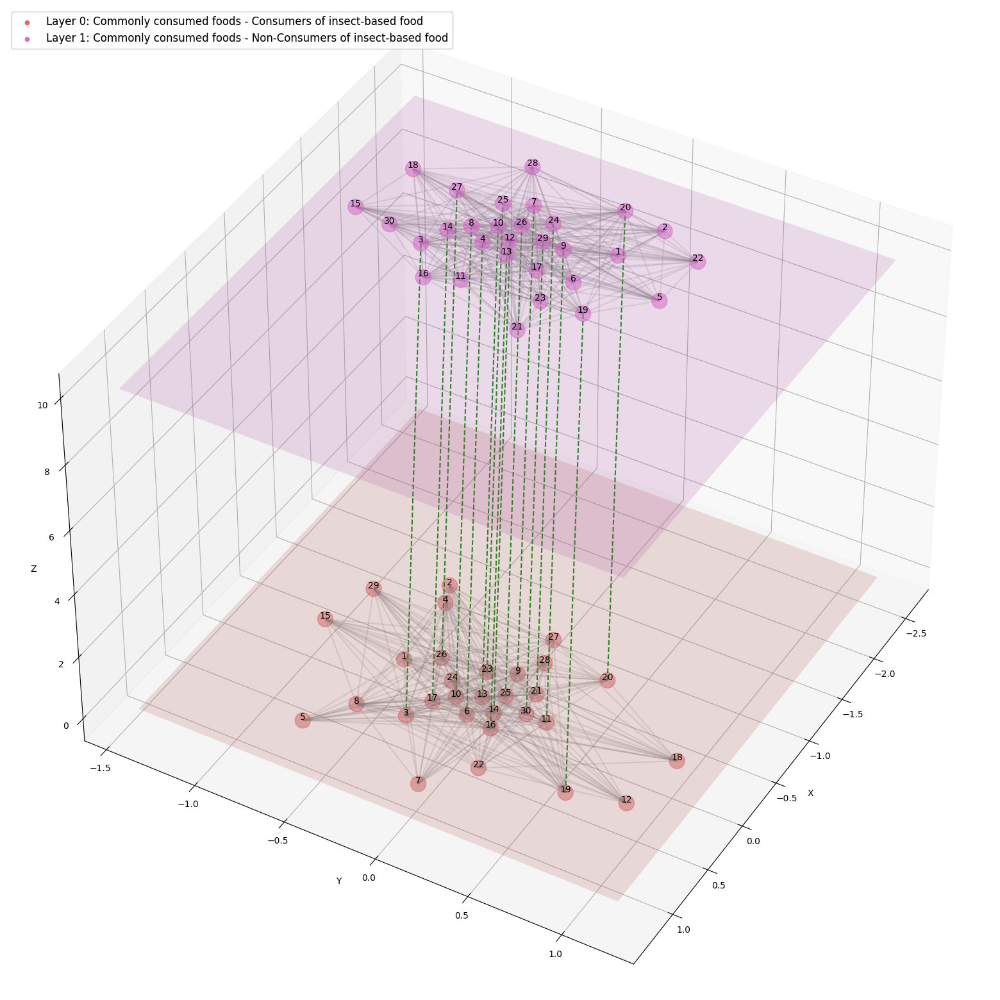

In [ ]:
class LayeredNetworkGraph(object):
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        self.graphs = graphs
        self.total_layers = len(graphs)
        self.node_labels = node_labels
        self.layout = layout
        if ax:
            self.ax = ax
        else:
            fig = plt.figure()
            self.ax = fig.add_subplot(111, projection='3d')
        self.get_nodes()
        self.get_edges_within_layers()
        self.get_edges_between_layers_by_shared_nodes()
        self.get_node_positions()
        self.draw()
    def get_nodes(self):
        self.nodes = []
        for z, g in enumerate(self.graphs):
            self.nodes.extend([(node, z) for node in g.nodes()])
    def get_edges_within_layers(self):
        self.edges_within_layers = []
        for z, g in enumerate(self.graphs):
            self.edges_within_layers.extend([((source, z), (target, z)) for source, target in g.edges()])
    def get_edges_between_layers_by_shared_nodes(self):
        self.edges_between_layers = []
        for z1, g in enumerate(self.graphs[:-1]):
            z2 = z1 + 1
            h = self.graphs[z2]
            shared_nodes = set(g.nodes()) & set(h.nodes())
            self.edges_between_layers.extend([((node, z1), (node, z2)) for node in shared_nodes])
    def get_node_positions(self, *args, **kwargs):
        composition = self.graphs[0]
        for h in self.graphs[1:]:
            composition = nx.compose(composition, h)
        pos = self.layout(composition, *args, **kwargs)
        self.node_positions = dict()
        for z, g in enumerate(self.graphs):
            layer_offset = z * 10  # Desplazamiento en z
            network_name = g.name
            x_layer_offset = network_offsets.get(network_name, {}).get('x_offset', 0) * z
            y_layer_offset = network_offsets.get(network_name, {}).get('y_offset', 0) * z
            self.node_positions.update({
                (node, z): (pos[node][0] + x_layer_offset, pos[node][1] + y_layer_offset, layer_offset)
                for node in g.nodes()
            })
    def draw_nodes(self, nodes, color,alpha =None, *args, **kwargs):
        x, y, z = zip(*[self.node_positions[node] for node in nodes])
        self.ax.scatter(x, y, z, color=color, alpha = 0.5, *args, **kwargs)
    def draw_edges(self, edges, *args, **kwargs):
        segments = [(self.node_positions[source], self.node_positions[target]) for source, target in edges]
        line_collection = Line3DCollection(segments, *args, **kwargs)
        self.ax.add_collection3d(line_collection)
    def get_extent(self, pad=0.1):
        xyz = np.array(list(self.node_positions.values()))
        xmin, ymin, _ = np.min(xyz, axis=0)
        xmax, ymax, _ = np.max(xyz, axis=0)
        dx = xmax - xmin
        dy = ymax - ymin
        return (xmin - pad * dx, xmax + pad * dx), \
            (ymin - pad * dy, ymax + pad * dy)
    def draw_plane(self, z, *args, **kwargs):
        network_name = self.graphs[z].name
        color = legend_info.get(network_name, '#CCCCCC')
        (xmin, xmax), (ymin, ymax) = self.get_extent(pad=0.1)
        u = np.linspace(xmin, xmax, 150)
        v = np.linspace(ymin, ymax, 150)
        U, V = np.meshgrid(u, v)
        layer_offset = z * 10
        W = layer_offset * np.ones_like(U)
        self.ax.plot_surface(U, V, W, color=color, *args, **kwargs)
    def synchronize_labels(self):
        missing_labels = set(self.node_positions.keys()) - set(self.node_labels.keys())
        for node in missing_labels:
            self.node_labels[node] = f"Nodo {node[0]}"
        extra_labels = set(self.node_labels.keys()) - set(self.node_positions.keys())
        for node in extra_labels:
            del self.node_labels[node]
    def draw(self):
        self.draw_edges(self.edges_within_layers, color='black', alpha=0.3, linestyle='-', zorder=2)
        self.draw_edges(self.edges_between_layers, color='Red', alpha=0.8, linestyle='--', zorder=2)
        for z in range(self.total_layers):
            self.draw_plane(z, alpha=0.2, zorder=1)
            color = legend_info.get(self.graphs[z].name, 'default_color')
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
        if self.node_labels:
            self.draw_node_labels(self.node_labels,
                                  horizontalalignment='center',
                                  verticalalignment='center',
                                  zorder=100)
    def draw_node_labels(self, labels, font_size=9, color='black', **kwargs):  # Tamaño de fuente reducido
        for node, (x, y, z) in self.node_positions.items():
            label = labels.get(node, f'{node[0]}')
            self.ax.text(x, y, z, label, fontsize=font_size, color=color, alpha=0.7, **kwargs)  # Añadida transparencia
node_labels = {}
for z, g in enumerate([net1, net1n]):
    for node in g.nodes():
        node_labels[(node, z)] = f'Nodo {node}'
class ModifiedLayeredNetworkGraph(LayeredNetworkGraph): #Se encarga únicamente de las comunidades de las redes.
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        super().__init__(graphs, node_labels=node_labels, layout=layout, ax=ax)
        """Determine edges between layers based on community detection."""
    def order_nodes_by_community(self):
        multiplex_network = nx.Graph()
        for z, g in enumerate(self.graphs):
            g = nx.relabel_nodes(g, {n: (n, z) for n in g.nodes()})
            multiplex_network = nx.compose(multiplex_network, g)
        partition = community_louvain.best_partition(multiplex_network)
        community_sizes = defaultdict(int)
        for node, community in partition.items():
            community_sizes[community] += 1
        ordered_nodes = {}
        for z, g in enumerate(self.graphs):
            nodes_in_layer = [(n, community_sizes[partition[(n, z)]]) for n in g.nodes()]
            nodes_in_layer.sort(key=lambda x: x[1], reverse=True)
            ordered_nodes[z] = [node for node, _ in nodes_in_layer]
        for z, nodes in ordered_nodes.items():
            for i, node in enumerate(nodes):
                self.node_labels[(node, z)] = f'{i + 1}'
    def draw(self):
        self.draw_edges(self.edges_between_layers, color='green', alpha=0.9, linestyle='--', zorder=2)
        self.draw_edges(self.edges_within_layers, color='grey', alpha=0.2, linestyle='-', zorder=1)
        for z in range(self.total_layers):
            self.draw_plane(z, alpha=0.18, zorder=1)
        for z in range(self.total_layers):
            color = legend_info[list(legend_info.keys())[z]]  # Obtiene el color de la leyenda
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
class NodeLabelPrinter:
    def __init__(self, ax, node_positions, node_labels, font_size=10, color='black'):
        self.ax = ax
        self.node_positions = node_positions
        self.node_labels = node_labels
        self.font_size = font_size
        self.color = color
    def print_labels(self):
        for node, position in self.node_positions.items():
            if node in self.node_labels:
                x, y, z = position
                label = self.node_labels[node]
                self.ax.text(x, y, z + 0.1, label, fontsize=self.font_size, color=self.color,
                             ha='center', va='center', zorder=11)
legend_info = {
    'net1':'#DF6767',
    'net1n':'#DF67D2'
}
legend_infou = {
    'Layer 0: Commonly consumed foods - Consumers of insect-based food':'#DF6767',
    'Layer 1: Commonly consumed foods - Non-Consumers of insect-based food':'#DF67D2'
}
network_offsets = {
    'net1': {'x_offset': 0.5, 'y_offset': 0.5}, #naranja
    'net1n': {'x_offset': -1.5, 'y_offset': -0.5}, #rosado
}
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(111, projection='3d')
ax.view_init(elev=40, azim=30) #Elevación y Eje Z
graph = ModifiedLayeredNetworkGraph([net1, net1n],
                                    node_labels=node_labels,
                                    layout=lambda G: nx.spring_layout(G, k=6, iterations=40),
                                    ax=ax)
graph.order_nodes_by_community()
label_printer = NodeLabelPrinter(ax, graph.node_positions, node_labels)
label_printer.print_labels()
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
for label, color in legend_infou.items():
    ax.scatter([], [], c=color, label=label)
legend_color = ax.legend(loc='upper left', frameon=True, fontsize=12)
ax.add_artist(legend_color)
plt.draw()
plt.show()

In [ ]:
shared_edges = {}
for source, target in graph.edges_between_layers:
    shared_edges[source] = target  # Mapear el nodo de la capa actual a su nodo conectado en la siguiente capa

data = []
for node in graph.nodes:
    connected_node_label = ''
    if node in shared_edges:
        connected_node = shared_edges[node]
        connected_node_label = connected_node[0], connected_node[1]  # Modificado para mostrar solo el número y la capa

    node_label_and_number = f"{node_labels.get(node, 'Nodo')} ({node[0]})"
    layer = node[1]
    degree = len([edge for edge in graph.edges_within_layers if node in edge])
    inter_layer_connections = len([target for edge in graph.edges_between_layers for target in edge if node in edge])
    inter_layer_centrality = degree + inter_layer_connections

    row = {
        'Node': node_label_and_number,
        'Interlayer Edge': connected_node_label,
        'Layer': layer,
        'IC': inter_layer_centrality
    }
    data.append(row)

df = pd.DataFrame(data, columns=['Node','Layer', 'Interlayer Edge'])
#df = df.to_latex(index= 0)
df


,Node,Layer,Interlayer Edge
0,1 (arepa),0,
1,2 (avocado),0,
2,3 (beef),0,"(beef, 1)"
3,4 (beetroot),0,
4,5 (blueberry),0,
5,6 (bread),0,"(bread, 1)"
6,7 (carrot),0,
7,8 (cereal),0,
8,9 (cheese),0,"(cheese, 1)"
9,10 (chicken),0,"(chicken, 1)"


#Characteristics Numerics

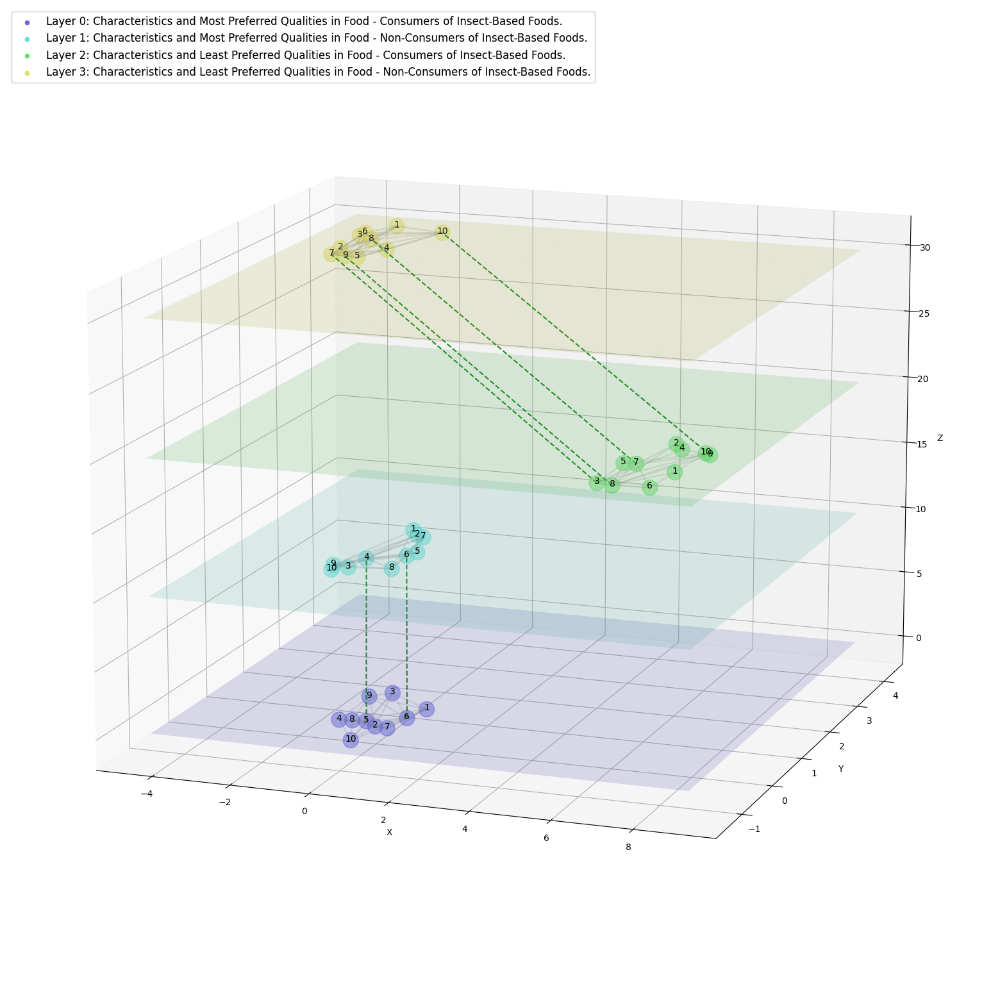

In [ ]:
class LayeredNetworkGraph(object):
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        self.graphs = graphs
        self.total_layers = len(graphs)
        self.node_labels = node_labels
        self.layout = layout
        if ax:
            self.ax = ax
        else:
            fig = plt.figure()
            self.ax = fig.add_subplot(111, projection='3d')
        self.get_nodes()
        self.get_edges_within_layers()
        self.get_edges_between_layers_by_shared_nodes()
        self.get_node_positions()
        self.draw()
    def get_nodes(self):
        self.nodes = []
        for z, g in enumerate(self.graphs):
            self.nodes.extend([(node, z) for node in g.nodes()])
    def get_edges_within_layers(self):
        self.edges_within_layers = []
        for z, g in enumerate(self.graphs):
            self.edges_within_layers.extend([((source, z), (target, z)) for source, target in g.edges()])
    def get_edges_between_layers_by_shared_nodes(self):
        self.edges_between_layers = []
        for z1, g in enumerate(self.graphs[:-1]):
            z2 = z1 + 1
            h = self.graphs[z2]
            shared_nodes = set(g.nodes()) & set(h.nodes())
            self.edges_between_layers.extend([((node, z1), (node, z2)) for node in shared_nodes])
    def get_node_positions(self, *args, **kwargs):
        composition = self.graphs[0]
        for h in self.graphs[1:]:
            composition = nx.compose(composition, h)
        pos = self.layout(composition, *args, **kwargs)
        self.node_positions = dict()
        for z, g in enumerate(self.graphs):
            layer_offset = z * 10  # Desplazamiento en z
            network_name = g.name
            x_layer_offset = network_offsets.get(network_name, {}).get('x_offset', 0) * z
            y_layer_offset = network_offsets.get(network_name, {}).get('y_offset', 0) * z
            self.node_positions.update({
                (node, z): (pos[node][0] + x_layer_offset, pos[node][1] + y_layer_offset, layer_offset)
                for node in g.nodes()
            })
    def draw_nodes(self, nodes, color,alpha =None, *args, **kwargs):
        x, y, z = zip(*[self.node_positions[node] for node in nodes])
        self.ax.scatter(x, y, z, color=color, alpha = 0.5, *args, **kwargs)
    def draw_edges(self, edges, *args, **kwargs):
        segments = [(self.node_positions[source], self.node_positions[target]) for source, target in edges]
        line_collection = Line3DCollection(segments, *args, **kwargs)
        self.ax.add_collection3d(line_collection)
    def get_extent(self, pad=0.1):
        xyz = np.array(list(self.node_positions.values()))
        xmin, ymin, _ = np.min(xyz, axis=0)
        xmax, ymax, _ = np.max(xyz, axis=0)
        dx = xmax - xmin
        dy = ymax - ymin
        return (xmin - pad * dx, xmax + pad * dx), \
            (ymin - pad * dy, ymax + pad * dy)
    def draw_plane(self, z, *args, **kwargs):
        network_name = self.graphs[z].name
        color = legend_info.get(network_name, '#CCCCCC')
        (xmin, xmax), (ymin, ymax) = self.get_extent(pad=0.1)
        u = np.linspace(xmin, xmax, 150)
        v = np.linspace(ymin, ymax, 150)
        U, V = np.meshgrid(u, v)
        layer_offset = z * 10
        W = layer_offset * np.ones_like(U)
        self.ax.plot_surface(U, V, W, color=color, *args, **kwargs)
    def synchronize_labels(self):
        missing_labels = set(self.node_positions.keys()) - set(self.node_labels.keys())
        for node in missing_labels:
            self.node_labels[node] = f"Nodo {node[0]}"
        extra_labels = set(self.node_labels.keys()) - set(self.node_positions.keys())
        for node in extra_labels:
            del self.node_labels[node]
    def draw(self):
        self.draw_edges(self.edges_within_layers, color='black', alpha=0.3, linestyle='-', zorder=2)
        self.draw_edges(self.edges_between_layers, color='Red', alpha=0.8, linestyle='--', zorder=2)
        for z in range(self.total_layers):
            self.draw_plane(z, alpha=0.2, zorder=1)
            color = legend_info.get(self.graphs[z].name, 'default_color')
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
        if self.node_labels:
            self.draw_node_labels(self.node_labels,
                                  horizontalalignment='center',
                                  verticalalignment='center',
                                  zorder=100)
    def draw_node_labels(self, labels, font_size=9, color='black', **kwargs):  # Tamaño de fuente reducido
        for node, (x, y, z) in self.node_positions.items():
            label = labels.get(node, f'{node[0]}')
            self.ax.text(x, y, z, label, fontsize=font_size, color=color, alpha=0.7, **kwargs)  # Añadida transparencia
node_labels = {}
for z, g in enumerate([net1, net1n]):
    for node in g.nodes():
        node_labels[(node, z)] = f'Nodo {node}'
class ModifiedLayeredNetworkGraph(LayeredNetworkGraph): #Se encarga únicamente de las comunidades de las redes.
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        super().__init__(graphs, node_labels=node_labels, layout=layout, ax=ax)
        """Determine edges between layers based on community detection."""
    def order_nodes_by_community(self):
        multiplex_network = nx.Graph()
        for z, g in enumerate(self.graphs):
            g = nx.relabel_nodes(g, {n: (n, z) for n in g.nodes()})
            multiplex_network = nx.compose(multiplex_network, g)
        partition = community_louvain.best_partition(multiplex_network)
        community_sizes = defaultdict(int)
        for node, community in partition.items():
            community_sizes[community] += 1
        ordered_nodes = {}
        for z, g in enumerate(self.graphs):
            nodes_in_layer = [(n, community_sizes[partition[(n, z)]]) for n in g.nodes()]
            nodes_in_layer.sort(key=lambda x: x[1], reverse=True)
            ordered_nodes[z] = [node for node, _ in nodes_in_layer]
        for z, nodes in ordered_nodes.items():
            for i, node in enumerate(nodes):
                self.node_labels[(node, z)] = f'{i + 1}'
    def draw(self):
        self.draw_edges(self.edges_between_layers, color='green', alpha=0.9, linestyle='--', zorder=2)
        self.draw_edges(self.edges_within_layers, color='grey', alpha=0.2, linestyle='-', zorder=1)
        for z in range(self.total_layers):
            self.draw_plane(z, alpha=0.18, zorder=1)
        for z in range(self.total_layers):
            color = legend_info[list(legend_info.keys())[z]]  # Obtiene el color de la leyenda
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
class NodeLabelPrinter:
    def __init__(self, ax, node_positions, node_labels, font_size=10, color='black'):
        self.ax = ax
        self.node_positions = node_positions
        self.node_labels = node_labels
        self.font_size = font_size
        self.color = color
    def print_labels(self):
        for node, position in self.node_positions.items():
            if node in self.node_labels:
                x, y, z = position
                label = self.node_labels[node]
                self.ax.text(x, y, z + 0.1, label, fontsize=self.font_size, color=self.color,
                             ha='center', va='center', zorder=11)
legend_info = {
    'net2':'#676BDF',
    'net2n':'#67DFD8',
    'net3':'#67DF6E',
    'net3n':'#DFDF67'
}
legend_infou = {
    'Layer 0: Characteristics and Most Preferred Qualities in Food - Consumers of Insect-Based Foods.':'#676BDF',
    'Layer 1: Characteristics and Most Preferred Qualities in Food - Non-Consumers of Insect-Based Foods.':'#67DFD8',
    'Layer 2: Characteristics and Least Preferred Qualities in Food - Consumers of Insect-Based Foods.':'#67DF6E',
    'Layer 3: Characteristics and Least Preferred Qualities in Food - Non-Consumers of Insect-Based Foods.':'#DFDF67'
}
network_offsets = {
    'net2': {'x_offset': 1.0, 'y_offset': 0.0}, #morado
    'net2n': {'x_offset': -0.9, 'y_offset': 1}, #Aguamarina
    'net3': {'x_offset': 3.5, 'y_offset': 0.0}, #verde
    'net3n': {'x_offset': -0.8, 'y_offset': 1}, #Amarilla -> Toda la visualización depende de dónde está la primera y la últoma red.
}
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(111, projection='3d')
ax.view_init(elev=14, azim=-70) #Elevación y Eje Z
graph = ModifiedLayeredNetworkGraph([net2, net2n, net3, net3n],
                                    node_labels=node_labels,
                                    layout=lambda G: nx.spring_layout(G, k=5, iterations=17),
                                    ax=ax)
graph.order_nodes_by_community()
label_printer = NodeLabelPrinter(ax, graph.node_positions, node_labels)
label_printer.print_labels()
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
# Código para la leyenda y para mostrar la gráfica
for label, color in legend_infou.items():
    ax.scatter([], [], c=color, label=label)
legend_color = ax.legend(loc='upper left', frameon=True, fontsize=12)
ax.add_artist(legend_color)
plt.draw()
plt.show()

In [ ]:
shared_edges = {}
for source, target in graph.edges_between_layers:
    shared_edges[source] = target  # Mapear el nodo de la capa actual a su nodo conectado en la siguiente capa

data = []
for node in graph.nodes:
    connected_node_label = ''
    if node in shared_edges:
        connected_node = shared_edges[node]
        connected_node_label = connected_node[0], connected_node[1]  # Modificado para mostrar solo el número y la capa

    node_label_and_number = f"{node_labels.get(node, 'Nodo')} ({node[0]})"
    layer = node[1]
    degree = len([edge for edge in graph.edges_within_layers if node in edge])
    inter_layer_connections = len([target for edge in graph.edges_between_layers for target in edge if node in edge])
    inter_layer_centrality = degree + inter_layer_connections

    row = {
        'Node': node_label_and_number,
        'Interlayer Edge': connected_node_label,
        'Layer': layer,
        'IC': inter_layer_centrality
    }
    data.append(row)

df2 = pd.DataFrame(data, columns=['Node','Layer', 'Interlayer Edge'])
#df2 = df2.to_latex(index= 0)
df2

,Node,Layer,Interlayer Edge
0,1 (creamy),0,
1,2 (crunchy),0,
2,3 (experience),0,"(experience, 1)"
3,4 (grilled),0,"(grilled, 1)"
4,5 (juicy),0,
5,6 (sensation),0,
6,7 (smooth),0,
7,8 (softness),0,
8,9 (sweet),0,"(sweet, 1)"
9,10 (texture),0,"(texture, 1)"


#Cultural Beleifs numeric

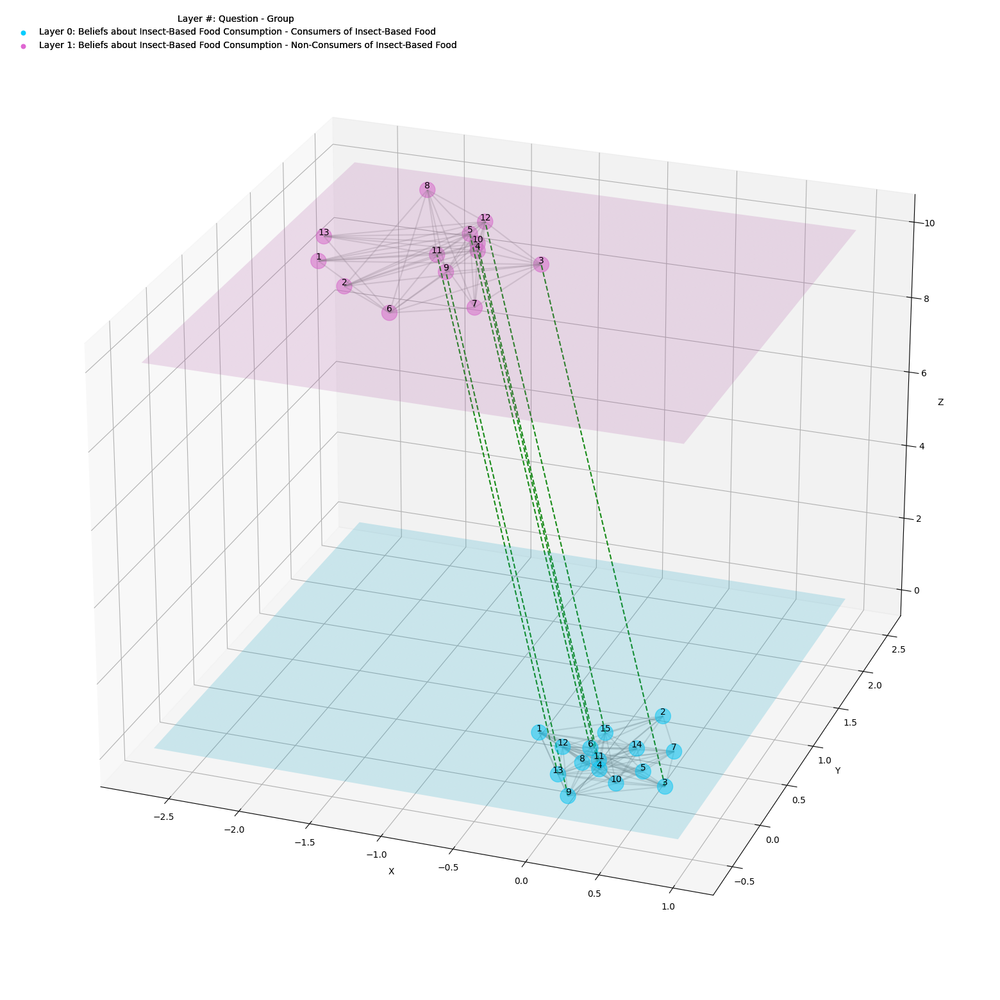

In [ ]:
class LayeredNetworkGraph(object):
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        self.graphs = graphs
        self.total_layers = len(graphs)
        self.node_labels = node_labels
        self.layout = layout
        if ax:
            self.ax = ax
        else:
            fig = plt.figure()
            self.ax = fig.add_subplot(111, projection='3d')
        self.get_nodes()
        self.get_edges_within_layers()
        self.get_edges_between_layers_by_shared_nodes()
        self.get_node_positions()
        self.draw()
    def get_nodes(self):
        self.nodes = []
        for z, g in enumerate(self.graphs):
            self.nodes.extend([(node, z) for node in g.nodes()])
    def get_edges_within_layers(self):
        self.edges_within_layers = []
        for z, g in enumerate(self.graphs):
            self.edges_within_layers.extend([((source, z), (target, z)) for source, target in g.edges()])
    def get_edges_between_layers_by_shared_nodes(self):
        self.edges_between_layers = []
        for z1, g in enumerate(self.graphs[:-1]):
            z2 = z1 + 1
            h = self.graphs[z2]
            shared_nodes = set(g.nodes()) & set(h.nodes())
            self.edges_between_layers.extend([((node, z1), (node, z2)) for node in shared_nodes])
    def get_node_positions(self, *args, **kwargs):
        composition = self.graphs[0]
        for h in self.graphs[1:]:
            composition = nx.compose(composition, h)
        pos = self.layout(composition, *args, **kwargs)
        self.node_positions = dict()
        for z, g in enumerate(self.graphs):
            layer_offset = z * 10  # Desplazamiento en z
            network_name = g.name
            x_layer_offset = network_offsets.get(network_name, {}).get('x_offset', 0) * z
            y_layer_offset = network_offsets.get(network_name, {}).get('y_offset', 0) * z
            self.node_positions.update({
                (node, z): (pos[node][0] + x_layer_offset, pos[node][1] + y_layer_offset, layer_offset)
                for node in g.nodes()
            })
    def draw_nodes(self, nodes, color,alpha =None, *args, **kwargs):
        x, y, z = zip(*[self.node_positions[node] for node in nodes])
        self.ax.scatter(x, y, z, color=color, alpha = 0.5, *args, **kwargs)
    def draw_edges(self, edges, *args, **kwargs):
        segments = [(self.node_positions[source], self.node_positions[target]) for source, target in edges]
        line_collection = Line3DCollection(segments, *args, **kwargs)
        self.ax.add_collection3d(line_collection)
    def get_extent(self, pad=0.1):
        xyz = np.array(list(self.node_positions.values()))
        xmin, ymin, _ = np.min(xyz, axis=0)
        xmax, ymax, _ = np.max(xyz, axis=0)
        dx = xmax - xmin
        dy = ymax - ymin
        return (xmin - pad * dx, xmax + pad * dx), \
            (ymin - pad * dy, ymax + pad * dy)
    def draw_plane(self, z, *args, **kwargs):
        network_name = self.graphs[z].name
        color = legend_info.get(network_name, '#CCCCCC')
        (xmin, xmax), (ymin, ymax) = self.get_extent(pad=0.1)
        u = np.linspace(xmin, xmax, 150)
        v = np.linspace(ymin, ymax, 150)
        U, V = np.meshgrid(u, v)
        layer_offset = z * 10
        W = layer_offset * np.ones_like(U)
        self.ax.plot_surface(U, V, W, color=color, *args, **kwargs)
    def synchronize_labels(self):
        missing_labels = set(self.node_positions.keys()) - set(self.node_labels.keys())
        for node in missing_labels:
            self.node_labels[node] = f"Nodo {node[0]}"
        extra_labels = set(self.node_labels.keys()) - set(self.node_positions.keys())
        for node in extra_labels:
            del self.node_labels[node]
    def draw(self):
        self.draw_edges(self.edges_within_layers, color='black', alpha=0.3, linestyle='-', zorder=2)
        self.draw_edges(self.edges_between_layers, color='Red', alpha=0.8, linestyle='--', zorder=2)
        for z in range(self.total_layers):
            self.draw_plane(z, alpha=0.2, zorder=1)
            color = legend_info.get(self.graphs[z].name, 'default_color')
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
        if self.node_labels:
            self.draw_node_labels(self.node_labels,
                                  horizontalalignment='center',
                                  verticalalignment='center',
                                  zorder=100)
    def draw_node_labels(self, labels, font_size=9, color='black', **kwargs):  # Tamaño de fuente reducido
        for node, (x, y, z) in self.node_positions.items():
            label = labels.get(node, f'{node[0]}')
            self.ax.text(x, y, z, label, fontsize=font_size, color=color, alpha=0.7, **kwargs)  # Añadida transparencia
node_labels = {}
for z, g in enumerate([net1, net1n]):
    for node in g.nodes():
        node_labels[(node, z)] = f'Nodo {node}'
class ModifiedLayeredNetworkGraph(LayeredNetworkGraph): #Se encarga únicamente de las comunidades de las redes.
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        super().__init__(graphs, node_labels=node_labels, layout=layout, ax=ax)
        """Determine edges between layers based on community detection."""
    def order_nodes_by_community(self):
        multiplex_network = nx.Graph()
        for z, g in enumerate(self.graphs):
            g = nx.relabel_nodes(g, {n: (n, z) for n in g.nodes()})
            multiplex_network = nx.compose(multiplex_network, g)
        partition = community_louvain.best_partition(multiplex_network)
        community_sizes = defaultdict(int)
        for node, community in partition.items():
            community_sizes[community] += 1
        ordered_nodes = {}
        for z, g in enumerate(self.graphs):
            nodes_in_layer = [(n, community_sizes[partition[(n, z)]]) for n in g.nodes()]
            nodes_in_layer.sort(key=lambda x: x[1], reverse=True)
            ordered_nodes[z] = [node for node, _ in nodes_in_layer]
        for z, nodes in ordered_nodes.items():
            for i, node in enumerate(nodes):
                self.node_labels[(node, z)] = f'{i + 1}'
    def draw(self):
        self.draw_edges(self.edges_between_layers, color='green', alpha=0.9, linestyle='--', zorder=2)
        self.draw_edges(self.edges_within_layers, color='grey', alpha=0.25, linestyle='-', zorder=1)
        for z in range(self.total_layers):
            self.draw_plane(z, alpha=0.18, zorder=1)
        for z in range(self.total_layers):
            color = legend_info[list(legend_info.keys())[z]]  # Obtiene el color de la leyenda
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
class NodeLabelPrinter:
    def __init__(self, ax, node_positions, node_labels, font_size=10, color='black'):
        self.ax = ax
        self.node_positions = node_positions
        self.node_labels = node_labels
        self.font_size = font_size
        self.color = color
    def print_labels(self):
        for node, position in self.node_positions.items():
            if node in self.node_labels:
                x, y, z = position
                label = self.node_labels[node]
                self.ax.text(x, y, z + 0.1, label, fontsize=self.font_size, color=self.color,
                             ha='center', va='center', zorder=11)

legend_info = {
    'net4':'#03CDFE',
    'net4n':'#DF67D2'
}
legend_infou = {
    'Layer 0: Beliefs about Insect-Based Food Consumption - Consumers of Insect-Based Food':'#03CDFE',
    'Layer 1: Beliefs about Insect-Based Food Consumption - Non-Consumers of Insect-Based Food':'#DF67D2'
}
network_offsets = {
    'net4': {'x_offset': -0.5, 'y_offset': -0.5}, #Azul
    'net4n': {'x_offset': -1.5, 'y_offset': 1.5}, #Purpura
}
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(111, projection='3d')
ax.view_init(elev=25, azim=-70) #Elevación y Eje Z
graph = ModifiedLayeredNetworkGraph([net4, net4n],
                                    node_labels=node_labels,
                                    layout=lambda G: nx.spring_layout(G, k=5, iterations=30),
                                    ax=ax)
graph.order_nodes_by_community()
label_printer = NodeLabelPrinter(ax, graph.node_positions, node_labels)
label_printer.print_labels()
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
# Código para la leyenda y para mostrar la gráfica
for label, color in legend_infou.items():
    ax.scatter([], [], c=color, label=label)
legend_color = ax.legend(title="Layer #: Question - Group", loc='upper left', frameon=False)
ax.add_artist(legend_color)
plt.draw()
plt.show()

In [ ]:
shared_edges = {}
for source, target in graph.edges_between_layers:
    shared_edges[source] = target  # Mapear el nodo de la capa actual a su nodo conectado en la siguiente capa

data = []
for node in graph.nodes:
    connected_node_label = ''
    if node in shared_edges:
        connected_node = shared_edges[node]
        connected_node_label = connected_node[0], connected_node[1]  # Modificado para mostrar solo el número y la capa

    node_label_and_number = f"{node_labels.get(node, 'Nodo')} ({node[0]})"
    layer = node[1]
    degree = len([edge for edge in graph.edges_within_layers if node in edge])
    inter_layer_connections = len([target for edge in graph.edges_between_layers for target in edge if node in edge])
    inter_layer_centrality = degree + inter_layer_connections

    row = {
        'Node': node_label_and_number,
        'Interlayer Edge': connected_node_label,
        'Layer': layer,
        'IC': inter_layer_centrality
    }
    data.append(row)

df3 = pd.DataFrame(data, columns=['Node','Layer', 'Interlayer Edge'])
#df3 = df3.to_latex(index=0)
df3

,Node,Layer,Interlayer Edge
0,1 (acceptance),0,
1,2 (bigbottomed),0,
2,3 (cricket),0,"(cricket, 1)"
3,4 (cultural),0,"(cultural, 1)"
4,5 (culturally),0,
5,6 (culture),0,"(culture, 1)"
6,7 (ecological),0,
7,8 (food),0,
8,9 (heritage),0,"(heritage, 1)"
9,10 (history),0,


#Knowlwdge Numeric

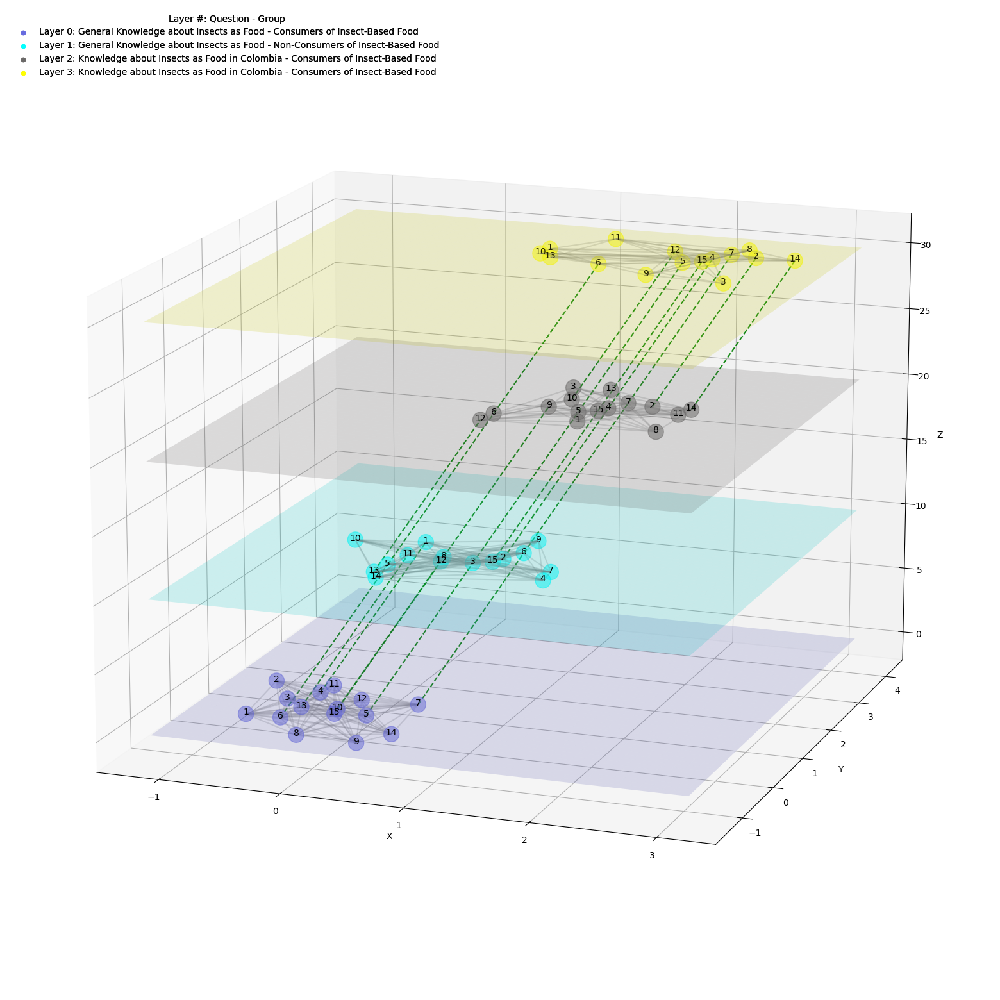

In [ ]:
class LayeredNetworkGraph(object):
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        self.graphs = graphs
        self.total_layers = len(graphs)
        self.node_labels = node_labels
        self.layout = layout
        if ax:
            self.ax = ax
        else:
            fig = plt.figure()
            self.ax = fig.add_subplot(111, projection='3d')
        self.get_nodes()
        self.get_edges_within_layers()
        self.get_edges_between_layers_by_shared_nodes()
        self.get_node_positions()
        self.draw()
    def get_nodes(self):
        self.nodes = []
        for z, g in enumerate(self.graphs):
            self.nodes.extend([(node, z) for node in g.nodes()])
    def get_edges_within_layers(self):
        self.edges_within_layers = []
        for z, g in enumerate(self.graphs):
            self.edges_within_layers.extend([((source, z), (target, z)) for source, target in g.edges()])
    def get_edges_between_layers_by_shared_nodes(self):
        self.edges_between_layers = []
        for z1, g in enumerate(self.graphs[:-1]):
            z2 = z1 + 1
            h = self.graphs[z2]
            shared_nodes = set(g.nodes()) & set(h.nodes())
            self.edges_between_layers.extend([((node, z1), (node, z2)) for node in shared_nodes])
    def get_node_positions(self, *args, **kwargs):
        composition = self.graphs[0]
        for h in self.graphs[1:]:
            composition = nx.compose(composition, h)
        pos = self.layout(composition, *args, **kwargs)
        self.node_positions = dict()
        for z, g in enumerate(self.graphs):
            layer_offset = z * 10  # Desplazamiento en z
            network_name = g.name
            x_layer_offset = network_offsets.get(network_name, {}).get('x_offset', 0) * z
            y_layer_offset = network_offsets.get(network_name, {}).get('y_offset', 0) * z
            self.node_positions.update({
                (node, z): (pos[node][0] + x_layer_offset, pos[node][1] + y_layer_offset, layer_offset)
                for node in g.nodes()
            })
    def draw_nodes(self, nodes, color,alpha =None, *args, **kwargs):
        x, y, z = zip(*[self.node_positions[node] for node in nodes])
        self.ax.scatter(x, y, z, color=color, alpha = 0.5, *args, **kwargs)
    def draw_edges(self, edges, *args, **kwargs):
        segments = [(self.node_positions[source], self.node_positions[target]) for source, target in edges]
        line_collection = Line3DCollection(segments, *args, **kwargs)
        self.ax.add_collection3d(line_collection)
    def get_extent(self, pad=0.1):
        xyz = np.array(list(self.node_positions.values()))
        xmin, ymin, _ = np.min(xyz, axis=0)
        xmax, ymax, _ = np.max(xyz, axis=0)
        dx = xmax - xmin
        dy = ymax - ymin
        return (xmin - pad * dx, xmax + pad * dx), \
            (ymin - pad * dy, ymax + pad * dy)
    def draw_plane(self, z, *args, **kwargs):
        network_name = self.graphs[z].name
        color = legend_info.get(network_name, '#CCCCCC')
        (xmin, xmax), (ymin, ymax) = self.get_extent(pad=0.1)
        u = np.linspace(xmin, xmax, 150)
        v = np.linspace(ymin, ymax, 150)
        U, V = np.meshgrid(u, v)
        layer_offset = z * 10
        W = layer_offset * np.ones_like(U)
        self.ax.plot_surface(U, V, W, color=color, *args, **kwargs)
    def synchronize_labels(self):
        missing_labels = set(self.node_positions.keys()) - set(self.node_labels.keys())
        for node in missing_labels:
            self.node_labels[node] = f"Nodo {node[0]}"
        extra_labels = set(self.node_labels.keys()) - set(self.node_positions.keys())
        for node in extra_labels:
            del self.node_labels[node]
    def draw(self):
        self.draw_edges(self.edges_within_layers, color='black', alpha=0.3, linestyle='-', zorder=2)
        self.draw_edges(self.edges_between_layers, color='Red', alpha=0.8, linestyle='--', zorder=2)
        for z in range(self.total_layers):
            self.draw_plane(z, alpha=0.2, zorder=1)
            color = legend_info.get(self.graphs[z].name, 'default_color')
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
        if self.node_labels:
            self.draw_node_labels(self.node_labels,
                                  horizontalalignment='center',
                                  verticalalignment='center',
                                  zorder=100)
    def draw_node_labels(self, labels, font_size=9, color='black', **kwargs):  # Tamaño de fuente reducido
        for node, (x, y, z) in self.node_positions.items():
            label = labels.get(node, f'{node[0]}')
            self.ax.text(x, y, z, label, fontsize=font_size, color=color, alpha=0.7, **kwargs)  # Añadida transparencia
node_labels = {}
for z, g in enumerate([net1, net1n]):
    for node in g.nodes():
        node_labels[(node, z)] = f'Nodo {node}'
class ModifiedLayeredNetworkGraph(LayeredNetworkGraph): #Se encarga únicamente de las comunidades de las redes.
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        super().__init__(graphs, node_labels=node_labels, layout=layout, ax=ax)
        """Determine edges between layers based on community detection."""
    def order_nodes_by_community(self):
        multiplex_network = nx.Graph()
        for z, g in enumerate(self.graphs):
            g = nx.relabel_nodes(g, {n: (n, z) for n in g.nodes()})
            multiplex_network = nx.compose(multiplex_network, g)
        partition = community_louvain.best_partition(multiplex_network)
        community_sizes = defaultdict(int)
        for node, community in partition.items():
            community_sizes[community] += 1
        ordered_nodes = {}
        for z, g in enumerate(self.graphs):
            nodes_in_layer = [(n, community_sizes[partition[(n, z)]]) for n in g.nodes()]
            nodes_in_layer.sort(key=lambda x: x[1], reverse=True)
            ordered_nodes[z] = [node for node, _ in nodes_in_layer]
        for z, nodes in ordered_nodes.items():
            for i, node in enumerate(nodes):
                self.node_labels[(node, z)] = f'{i + 1}'
    def draw(self):
        self.draw_edges(self.edges_between_layers, color='green', alpha=0.9, linestyle='--', zorder=2)
        self.draw_edges(self.edges_within_layers, color='grey', alpha=0.25, linestyle='-', zorder=1)
        for z in range(self.total_layers):
            self.draw_plane(z, alpha=0.18, zorder=1)
        for z in range(self.total_layers):
            color = legend_info[list(legend_info.keys())[z]]  # Obtiene el color de la leyenda
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
class NodeLabelPrinter:
    def __init__(self, ax, node_positions, node_labels, font_size=10, color='black'):
        self.ax = ax
        self.node_positions = node_positions
        self.node_labels = node_labels
        self.font_size = font_size
        self.color = color
    def print_labels(self):
        for node, position in self.node_positions.items():
            if node in self.node_labels:
                x, y, z = position
                label = self.node_labels[node]
                self.ax.text(x, y, z + 0.1, label, fontsize=self.font_size, color=self.color,
                             ha='center', va='center', zorder=11)
legend_info = {
    'net5':'#676BDF',
    'net5n':'#03FEFE',
    'net6':'#6B6968',
    'net6n':'#FEFE03'
}
legend_infou = {
'Layer 0: General Knowledge about Insects as Food - Consumers of Insect-Based Food': '#676BDF',
'Layer 1: General Knowledge about Insects as Food - Non-Consumers of Insect-Based Food': '#03FEFE',
'Layer 2: Knowledge about Insects as Food in Colombia - Consumers of Insect-Based Food': '#6B6968',
'Layer 3: Knowledge about Insects as Food in Colombia - Consumers of Insect-Based Food': '#FEFE03'
}
network_offsets = {
    'net5': {'x_offset': 0, 'y_offset':0}, #morado
    'net5n': {'x_offset':0.6, 'y_offset': 1}, #Aguamarina
    'net6': {'x_offset': 0.6, 'y_offset':1}, #negra
    'net6n': {'x_offset':0.6, 'y_offset': 1}, #Amarilla -> Toda la visualización depende de dónde está la primera y la últoma red.
}
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(111, projection='3d')
ax.view_init(elev=15, azim=-70) #Elevación y Eje Z
graph = ModifiedLayeredNetworkGraph([net5, net5n, net6, net6n],
                                    node_labels=node_labels,
                                    layout=lambda G: nx.spring_layout(G, k=6, iterations=20),
                                    ax=ax)
graph.order_nodes_by_community()
label_printer = NodeLabelPrinter(ax, graph.node_positions, node_labels)
label_printer.print_labels()
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
# Código para la leyenda y para mostrar la gráfica
for label, color in legend_infou.items():
    ax.scatter([], [], c=color, label=label)
legend_color = ax.legend(title="Layer #: Question - Group", loc='upper left', frameon=False)
ax.add_artist(legend_color)
plt.draw()
plt.show()

In [ ]:
shared_edges = {}
for source, target in graph.edges_between_layers:
    shared_edges[source] = target  # Mapear el nodo de la capa actual a su nodo conectado en la siguiente capa

data = []
for node in graph.nodes:
    connected_node_label = ''
    if node in shared_edges:
        connected_node = shared_edges[node]
        connected_node_label = connected_node[0], connected_node[1]  # Modificado para mostrar solo el número y la capa

    node_label_and_number = f"{node_labels.get(node, 'Nodo')} ({node[0]})"
    layer = node[1]
    degree = len([edge for edge in graph.edges_within_layers if node in edge])
    inter_layer_connections = len([target for edge in graph.edges_between_layers for target in edge if node in edge])
    inter_layer_centrality = degree + inter_layer_connections

    row = {
        'Node': node_label_and_number,
        'Interlayer Edge': connected_node_label,
        'Layer': layer,
        'IC': inter_layer_centrality
    }
    data.append(row)

df4 = pd.DataFrame(data, columns=['Node','Layer', 'Interlayer Edge'])
#df4 = df4.to_latex(index=0)
df4

,Node,Layer,Interlayer Edge
0,1 (afric),0,
1,2 (aphrodisiac),0,
2,3 (bigbottomed),0,
3,4 (cockroach),0,"(cockroach, 1)"
4,5 (cricket),0,"(cricket, 1)"
5,6 (cultural),0,"(cultural, 1)"
6,7 (culture),0,"(culture, 1)"
7,8 (environmental),0,
8,9 (indigenous),0,
9,10 (insect),0,"(insect, 1)"


#Childhood

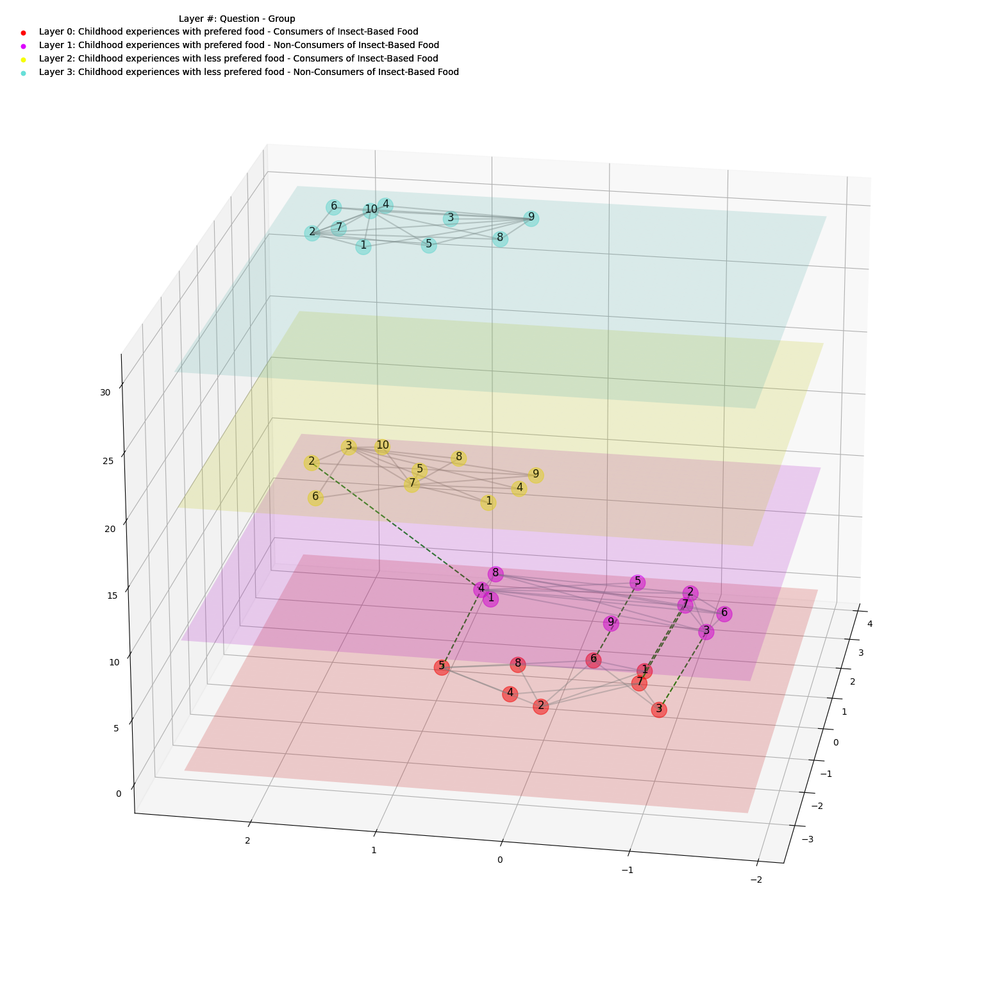

In [ ]:
class LayeredNetworkGraph(object):
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        self.graphs = graphs
        self.total_layers = len(graphs)
        self.node_labels = node_labels
        self.layout = layout
        if ax:
            self.ax = ax
        else:
            fig = plt.figure()
            self.ax = fig.add_subplot(111, projection='3d')
        self.eigenvector_centrality = {}
        self.get_nodes()
        self.get_edges_within_layers()
        self.calculate_eigenvector_centrality()  # Primero calcula la centralidad
        self.get_edges_between_layers_by_eigenvector_centrality()  # Luego obtén los bordes basados en la centralidad
        self.get_node_positions()
        self.draw()
    def get_nodes(self):
        self.nodes = []
        for z, g in enumerate(self.graphs):
            self.nodes.extend([(node, z) for node in g.nodes()])
    def get_edges_within_layers(self):
        self.edges_within_layers = []
        for z, g in enumerate(self.graphs):
            self.edges_within_layers.extend([((source, z), (target, z)) for source, target in g.edges()])
    def get_edges_between_layers_by_eigenvector_centrality(self):
        self.edges_between_layers_by_eigenvector_centrality = []
        for z1, g in enumerate(self.graphs[:-1]):
            z2 = z1 + 1
            h = self.graphs[z2]
            shared_nodes = set(g.nodes()) & set(h.nodes())
            sorted_nodes = sorted(shared_nodes, key=lambda n:self.eigenvector_centrality[(n, z1)], reverse=True)
            self.edges_between_layers_by_eigenvector_centrality.extend([((node, z1), (node, z2)) for node in sorted_nodes])
    def calculate_eigenvector_centrality(self):
        for z, g in enumerate(self.graphs):
            centrality = nx.eigenvector_centrality(g)
            self.eigenvector_centrality.update({(n, z): centrality[n] for n in g.nodes()})


    def get_node_positions(self, *args, **kwargs):
        composition = self.graphs[0]
        for h in self.graphs[1:]:
            composition = nx.compose(composition, h)
        pos = self.layout(composition, *args, **kwargs)
        self.node_positions = dict()

        for z, g in enumerate(self.graphs):
            layer_offset = z * 10  # Desplazamiento en z
            network_name = g.name
            # Obtén los desplazamientos de x e y para esta red específica
            x_layer_offset = network_offsets.get(network_name, {}).get('x_offset', 0) * z
            y_layer_offset = network_offsets.get(network_name, {}).get('y_offset', 0) * z

            # Actualiza las posiciones de los nodos con los desplazamientos personalizados
            self.node_positions.update({
                (node, z): (pos[node][0] + x_layer_offset, pos[node][1] + y_layer_offset, layer_offset)
                for node in g.nodes()
            })
    def draw_nodes(self, nodes, color,alpha =None, *args, **kwargs):
        x, y, z = zip(*[self.node_positions[node] for node in nodes])
        self.ax.scatter(x, y, z, color=color, alpha = 0.5, *args, **kwargs)
    def draw_edges(self, edges, *args, **kwargs):
        segments = [(self.node_positions[source], self.node_positions[target]) for source, target in edges]
        line_collection = Line3DCollection(segments, *args, **kwargs)
        self.ax.add_collection3d(line_collection)
    def get_extent(self, pad=0.1):
        xyz = np.array(list(self.node_positions.values()))
        xmin, ymin, _ = np.min(xyz, axis=0)
        xmax, ymax, _ = np.max(xyz, axis=0)
        dx = xmax - xmin
        dy = ymax - ymin
        return (xmin - pad * dx, xmax + pad * dx), \
            (ymin - pad * dy, ymax + pad * dy)
    def draw_plane(self, z, *args, **kwargs):
        network_name = self.graphs[z].name
        color = legend_info.get(network_name, '#CCCCCC')
        (xmin, xmax), (ymin, ymax) = self.get_extent(pad=0.1)
        u = np.linspace(xmin, xmax, 150)
        v = np.linspace(ymin, ymax, 150)
        U, V = np.meshgrid(u, v)
        layer_offset = z * 10
        W = layer_offset * np.ones_like(U)
        self.ax.plot_surface(U, V, W, color=color, *args, **kwargs)
    def synchronize_labels(self):
        # Asegura que cada nodo en node_positions tenga una etiqueta en node_labels.
        missing_labels = set(self.node_positions.keys()) - set(self.node_labels.keys())
        for node in missing_labels:
            self.node_labels[node] = f"Nodo {node[0]}"

        # Opcionalmente, también podría eliminar cualquier etiqueta que no tenga un nodo correspondiente.
        extra_labels = set(self.node_labels.keys()) - set(self.node_positions.keys())
        for node in extra_labels:
            del self.node_labels[node]
    def draw(self):
        self.draw_edges(self.edges_within_layers, color='black', alpha=0.3, linestyle='-', zorder=2)
        self.draw_edges(self.edges_between_layers, color='Red', alpha=0.8, linestyle='--', zorder=2)
        for z in range(self.total_layers):
            # Se llama a draw_plane con el color correcto
            self.draw_plane(z, alpha=0.2, zorder=1)
            color = legend_info.get(self.graphs[z].name, 'default_color')
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
        if self.node_labels:
            self.draw_node_labels(self.node_labels,
                                  horizontalalignment='center',
                                  verticalalignment='center',
                                  zorder=100)
    def draw_node_labels(self, labels, font_size=9, color='black', **kwargs):  # Tamaño de fuente reducido
        for node, (x, y, z) in self.node_positions.items():
            label = labels.get(node, f'{node[0]}')
            self.ax.text(x, y, z, label, fontsize=font_size, color=color, alpha=0.7, **kwargs)  # Añadida transparencia
node_labels = {}
for z, g in enumerate([net7, net7n, net8, net8n]):
    for node in g.nodes():
        node_labels[(node, z)] = f'Nodo {node}'
class ModifiedLayeredNetworkGraph(LayeredNetworkGraph): #Se encarga únicamente de las comunidades de las redes.
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        super().__init__(graphs, node_labels=node_labels, layout=layout, ax=ax)
        """Determine edges between layers based on community detection."""
    def order_nodes_by_community(self):
        multiplex_network = nx.Graph()
        for z, g in enumerate(self.graphs):
            g = nx.relabel_nodes(g, {n: (n, z) for n in g.nodes()})
            multiplex_network = nx.compose(multiplex_network, g)
        partition = community_louvain.best_partition(multiplex_network)
        community_sizes = defaultdict(int)
        for node, community in partition.items():
            community_sizes[community] += 1
        ordered_nodes = {}
        for z, g in enumerate(self.graphs):
            nodes_in_layer = [(n, community_sizes[partition[(n, z)]]) for n in g.nodes()]
            nodes_in_layer.sort(key=lambda x: x[1], reverse=True)
            ordered_nodes[z] = [node for node, _ in nodes_in_layer]
        # Actualiza las etiquetas de los nodos
        for z, nodes in ordered_nodes.items():
            for i, node in enumerate(nodes):
                self.node_labels[(node, z)] = f'{i + 1}'
    def draw(self):
        top_centrality_edges = self.edges_between_layers_by_eigenvector_centrality[:3]
        other_edges = self.edges_between_layers_by_eigenvector_centrality[3:]
        self.draw_edges(top_centrality_edges, color='green', alpha=0.9, linestyle='--', zorder=2)
        self.draw_edges(other_edges, color='green', alpha=0.9, linestyle='--', zorder=2)
        self.draw_edges(self.edges_within_layers, color='grey', alpha=0.4, linestyle='-', zorder=1)
        # Dibuja planos para cada capa
        for z in range(self.total_layers):
            self.draw_plane(z, alpha=0.18, zorder=1)
        # Dibuja TODOS los nodos de TODAS las capas con el color correspondiente
        for z in range(self.total_layers):
            color = legend_info[list(legend_info.keys())[z]]  # Obtiene el color de la leyenda
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
class NodeLabelPrinter:
    def __init__(self, ax, node_positions, node_labels, font_size=12, color='black'):
        self.ax = ax
        self.node_positions = node_positions
        self.node_labels = node_labels
        self.font_size = font_size
        self.color = color
    def print_labels(self):
        for node, position in self.node_positions.items():
            if node in self.node_labels:
                x, y, z = position
                label = self.node_labels[node]
                self.ax.text(x, y, z + 0.1, label, fontsize=self.font_size, color=self.color,
                             ha='center', va='center', zorder=11)
legend_info = {
    'net7':'#FE0303',
    'net7n':'#DC03FE', #Morado
    'net8':'#F6FE03', #Amarillo
    'net8n':'#67DFD8',

}
legend_infou = {
    'Layer 0: Childhood experiences with prefered food - Consumers of Insect-Based Food':'#FE0303',
    'Layer 1: Childhood experiences with prefered food - Non-Consumers of Insect-Based Food':'#DC03FE',
    'Layer 2: Childhood experiences with less prefered food - Consumers of Insect-Based Food':'#F6FE03',
    'Layer 3: Childhood experiences with less prefered food - Non-Consumers of Insect-Based Food':'#67DFD8'
}
network_offsets = {
    'net7': {'x_offset': -1, 'y_offset': 0.5},
    'net7n': {'x_offset': -1.5, 'y_offset': -0.5}, #Morado
    'net8': {'x_offset': -1.0, 'y_offset': 0.4}, #Amarillo
    'net8n': {'x_offset': 0.8, 'y_offset': 0.5},
}
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(111, projection='3d')
ax.view_init(elev=22, azim=190) #Elevación y Eje Z
graph = ModifiedLayeredNetworkGraph([net7, net7n, net8, net8n],
                                    node_labels=node_labels,
                                    layout=lambda G: nx.spring_layout(G, k=3, iterations=3),
                                    ax=ax)
graph.calculate_eigenvector_centrality()
graph.get_edges_between_layers_by_eigenvector_centrality()
graph.order_nodes_by_community()
label_printer = NodeLabelPrinter(ax, graph.node_positions, node_labels)
label_printer.print_labels()

# Código para la leyenda y para mostrar la gráfica
for label, color in legend_infou.items():
    ax.scatter([], [], c=color, label=label)
legend_color = ax.legend(title="Layer #: Question - Group", loc='upper left', frameon=False)
ax.add_artist(legend_color)
plt.draw()
plt.show()
fig.savefig('Multinetwork5.svg', format='svg', dpi=300)

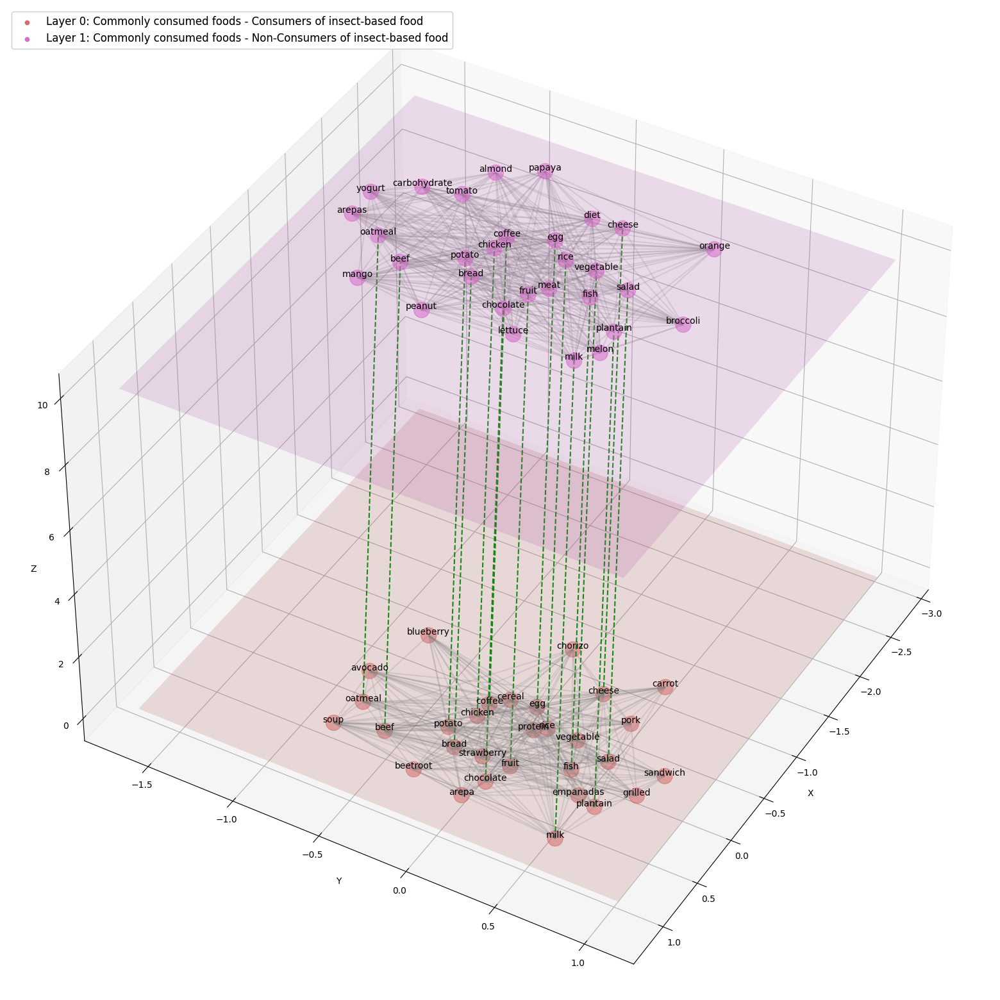

In [ ]:
class LayeredNetworkGraph(object):
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        self.graphs = graphs
        self.total_layers = len(graphs)
        self.node_labels = node_labels
        self.layout = layout
        if ax:
            self.ax = ax
        else:
            fig = plt.figure()
            self.ax = fig.add_subplot(111, projection='3d')
        self.get_nodes()
        self.get_edges_within_layers()
        self.get_edges_between_layers_by_shared_nodes()
        self.get_node_positions()
        self.draw()
    def get_nodes(self):
        self.nodes = []
        for z, g in enumerate(self.graphs):
            self.nodes.extend([(node, z) for node in g.nodes()])
    def get_edges_within_layers(self):
        self.edges_within_layers = []
        for z, g in enumerate(self.graphs):
            self.edges_within_layers.extend([((source, z), (target, z)) for source, target in g.edges()])
    def get_edges_between_layers_by_shared_nodes(self):
        self.edges_between_layers = []
        for z1, g in enumerate(self.graphs[:-1]):
            z2 = z1 + 1
            h = self.graphs[z2]
            shared_nodes = set(g.nodes()) & set(h.nodes())
            self.edges_between_layers.extend([((node, z1), (node, z2)) for node in shared_nodes])
    def get_node_positions(self, *args, **kwargs):
        composition = self.graphs[0]
        for h in self.graphs[1:]:
            composition = nx.compose(composition, h)
        pos = self.layout(composition, *args, **kwargs)
        self.node_positions = dict()
        for z, g in enumerate(self.graphs):
            layer_offset = z * 10  # Desplazamiento en z
            network_name = g.name
            x_layer_offset = network_offsets.get(network_name, {}).get('x_offset', 0) * z
            y_layer_offset = network_offsets.get(network_name, {}).get('y_offset', 0) * z
            self.node_positions.update({
                (node, z): (pos[node][0] + x_layer_offset, pos[node][1] + y_layer_offset, layer_offset)
                for node in g.nodes()
            })
    def draw_nodes(self, nodes, color,alpha =None, *args, **kwargs):
        x, y, z = zip(*[self.node_positions[node] for node in nodes])
        self.ax.scatter(x, y, z, color=color, alpha = 0.5, *args, **kwargs)
    def draw_edges(self, edges, *args, **kwargs):
        segments = [(self.node_positions[source], self.node_positions[target]) for source, target in edges]
        line_collection = Line3DCollection(segments, *args, **kwargs)
        self.ax.add_collection3d(line_collection)
    def get_extent(self, pad=0.1):
        xyz = np.array(list(self.node_positions.values()))
        xmin, ymin, _ = np.min(xyz, axis=0)
        xmax, ymax, _ = np.max(xyz, axis=0)
        dx = xmax - xmin
        dy = ymax - ymin
        return (xmin - pad * dx, xmax + pad * dx), \
            (ymin - pad * dy, ymax + pad * dy)
    def draw_plane(self, z, *args, **kwargs):
        network_name = self.graphs[z].name
        color = legend_info.get(network_name, '#CCCCCC')
        (xmin, xmax), (ymin, ymax) = self.get_extent(pad=0.1)
        u = np.linspace(xmin, xmax, 150)
        v = np.linspace(ymin, ymax, 150)
        U, V = np.meshgrid(u, v)
        layer_offset = z * 10
        W = layer_offset * np.ones_like(U)
        self.ax.plot_surface(U, V, W, color=color, *args, **kwargs)
    def synchronize_labels(self):
        missing_labels = set(self.node_positions.keys()) - set(self.node_labels.keys())
        for node in missing_labels:
            self.node_labels[node] = f"Nodo {node[0]}"
        extra_labels = set(self.node_labels.keys()) - set(self.node_positions.keys())
        for node in extra_labels:
            del self.node_labels[node]
    def draw(self):
        self.draw_edges(self.edges_within_layers, color='black', alpha=0.3, linestyle='-', zorder=2)
        self.draw_edges(self.edges_between_layers, color='Red', alpha=0.8, linestyle='--', zorder=2)
        for z in range(self.total_layers):
            self.draw_plane(z, alpha=0.2, zorder=1)
            color = legend_info.get(self.graphs[z].name, 'default_color')
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
        if self.node_labels:
            self.draw_node_labels(self.node_labels,
                                  horizontalalignment='center',
                                  verticalalignment='center',
                                  zorder=100)
    def draw_node_labels(self, labels, font_size=9, color='black', **kwargs):  # Tamaño de fuente reducido
        for node, (x, y, z) in self.node_positions.items():
            label = labels.get(node, f'{node[0]}')
            self.ax.text(x, y, z, label, fontsize=font_size, color=color, alpha=0.7, **kwargs)  # Añadida transparencia
node_labels = {}
for z, g in enumerate([net1, net1n]):
    for node in g.nodes():
        node_labels[(node, z)] = f'{node}'

class ModifiedLayeredNetworkGraph(LayeredNetworkGraph): #Se encarga únicamente de las comunidades de las redes.
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        super().__init__(graphs, node_labels=node_labels, layout=layout, ax=ax)
        """Determine edges between layers based on community detection."""
    def order_nodes_by_community(self):
        multiplex_network = nx.Graph()
        for z, g in enumerate(self.graphs):
            g = nx.relabel_nodes(g, {n: (n, z) for n in g.nodes()})
            multiplex_network = nx.compose(multiplex_network, g)
        partition = community_louvain.best_partition(multiplex_network)
        community_sizes = defaultdict(int)
        for node, community in partition.items():
            community_sizes[community] += 1
        ordered_nodes = {}
        for z, g in enumerate(self.graphs):
            nodes_in_layer = [(n, community_sizes[partition[(n, z)]]) for n in g.nodes()]
            nodes_in_layer.sort(key=lambda x: x[1], reverse=True)
            ordered_nodes[z] = [node for node, _ in nodes_in_layer]
    def draw(self):
        self.draw_edges(self.edges_between_layers, color='green', alpha=0.9, linestyle='--', zorder=2)
        self.draw_edges(self.edges_within_layers, color='grey', alpha=0.2, linestyle='-', zorder=1)
        for z in range(self.total_layers):
            self.draw_plane(z, alpha=0.18, zorder=1)
        for z in range(self.total_layers):
            color = legend_info[list(legend_info.keys())[z]]  # Obtiene el color de la leyenda
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
class NodeLabelPrinter:
    def __init__(self, ax, node_positions, node_labels, font_size=10, color='black'):
        self.ax = ax
        self.node_positions = node_positions
        self.node_labels = node_labels
        self.font_size = font_size
        self.color = color
    def print_labels(self):
        for node, position in self.node_positions.items():
            if node in self.node_labels:
                x, y, z = position
                label = self.node_labels.get(node, 'Nodo')
                self.ax.text(x, y, z + 0.1, label, fontsize=self.font_size, color=self.color,
                             ha='center', va='center', zorder=11)
legend_info = {
    'net1':'#DF6767',
    'net1n':'#DF67D2'
}
legend_infou = {
    'Layer 0: Commonly consumed foods - Consumers of insect-based food':'#DF6767',
    'Layer 1: Commonly consumed foods - Non-Consumers of insect-based food':'#DF67D2'
}
network_offsets = {
    'net1': {'x_offset': 0.5, 'y_offset': 0.5}, #naranja
    'net1n': {'x_offset': -1.5, 'y_offset': -0.5}, #rosado
}
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(111, projection='3d')
ax.view_init(elev=40, azim=30) #Elevación y Eje Z
graph = ModifiedLayeredNetworkGraph([net1, net1n],
                                    node_labels=node_labels,
                                    layout=lambda G: nx.spring_layout(G, k=4, iterations=10),
                                    ax=ax)
graph.order_nodes_by_community()
label_printer = NodeLabelPrinter(ax, graph.node_positions, node_labels)
label_printer.print_labels()
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
for label, color in legend_infou.items():
    ax.scatter([], [], c=color, label=label)
legend_color = ax.legend(loc='upper left', frameon=True, fontsize=12)
ax.add_artist(legend_color)
plt.draw()
plt.show()
fig.savefig('Multinetwork1.JPEG', format='JPEG', dpi=300)

#Teoria de redes.

François Chollet and J.J. Allaire. "Deep Learning with Python." Capítulo 6: Deep learning for text and sequences. Manning Publications, 2018.

Sebastian Raschka and Vahid Mirjalili. "Python Machine Learning, 3rd Edition." Capítulo 7: Text Mining. Packt Publishing, 2019. ---> se llama (3) Sebastian Raschka en el google drive


Jurafsky, D., & Martin, J. H. (2008). Speech and language processing (2nd ed.). Prentice Hall. ---> está guardado como ed3book.pdf en el drive ---> Muy buen documento para justificar y estructurar la metodología del documento.


Natural language processing (NLP) is a subfield of artificial intelligence that deals with the understanding and generation of human language. One of the most important tasks in NLP is text mining, which is the process of extracting valuable information from unstructured text data. (Jurafsky & Martin, 2008)

Vectorization is a technique that is used to represent text data in a way that can be easily processed by a computer. This is done by converting the text into a vector of numbers, where each number represents the frequency of a particular word or phrase in the text.

There are a number of different ways to vectorize text data, but one of the most common is to use ngrams. An ngram is a sequence of n consecutive words or phrases. For example, the trigram "the quick brown fox" is a sequence of three consecutive words.

Ngrams can be used to capture the meaning of text data by representing the relationships between words and phrases. This makes them a powerful tool for text mining tasks such as sentiment analysis, topic modeling, and information retrieval.

The use of ngrams for text vectorization is well-supported by the literature. In their book "Speech and Language Processing," Jurafsky and Martin (2008) discuss the use of ngrams for language modeling and information retrieval. They note that ngrams can be used to capture the statistical dependencies between words and phrases, which can be helpful for improving the performance of NLP tasks.

In their book "Deep Learning with Python," Chollet and Allaire (2018) also discuss the use of ngrams for text vectorization. They note that ngrams can be used to create a more expressive representation of text data, which can be helpful for improving the performance of deep learning models.

Finally, in their book "Python Machine Learning, 3rd Edition," Raschka and Mirjalili (2019) discuss the use of ngrams for text vectorization. They note that ngrams can be used to improve the performance of NLP tasks such as sentiment analysis and topic modeling.

In conclusion, the use of ngrams for text vectorization is well-supported by the literature. Ngrams can be used to capture the meaning of text data by representing the relationships between words and phrases. This makes them a powerful tool for text mining tasks such as sentiment analysis, topic modeling, and information retrieval.

#MultinetX Heterogenea


---
 trying new packages for the same result.

In [ ]:
!pip install git+https://github.com/nkoub/multinetx.git
from sklearn.decomposition import LatentDirichletAllocation
import multinetx as mx

In [ ]:
!pip install --upgrade multinetx

El detector de comunidades generaba un diccionario en las variables comunidades_net1 y comunidades_net1n con numeros enteros, entonces diseñé una función para transformar estos valores y así poder interpretarlos más adelante agrupando las comunidades y poder usarlas como criterio para seleccionar los pesos y demás.

```
  def agrupar_comunidades(comunidades):
    comunidades_agrupadas = {}
    for nodo, comunidad in comunidades.items():
        if comunidad in comunidades_agrupadas:
            comunidades_agrupadas[comunidad].add(nodo)
        else:
            comunidades_agrupadas[comunidad] = {nodo}
    return comunidades_agrupadas

```



Segun el estudio los meta nodos y meta asristas permiten ver el grafo HeMLN como un garfo simple (en perspectiva) la diferencia es que cada capa sería un nodo y las relaciones presentes entre ellas serán las aristas posibles entre las partes del grafo... así, la idea de componer un grafo bipartito identificando comunidades y sus relaciones etre las diferentes capas permite ver la totalidad de la pintura.

Si bien se tiene el grao bipartito conformado, hace falta la estructuración de la ultima etapa que es la identificación de un algoritmo de emparejamiento bipartito el cual permite entender las relaciones existentes entre nodos y capas del metagrafo.


En este orden de ideas se debe:

Definir una función de emparejamiento bipartito: Esta función calculará el emparejamiento entre las comunidades de diferentes capas basándose en un criterio de peso. que en este caso trabaremos bajo el criterio de peso de nodos, pero si se desea proponer algo más complejo, es posible agrgar argumentos al criterioq ue establezca el peso para cada nodo... en mi caso, por ser primiparo me iré con una solución "simple".

El emparejamiento máximo se logra entonces encontrando el conjunto de aristas que maximiza la suma de los pesos, considerando las restricciones bipartitas.

In [ ]:
# 1. Definir comunidades para cada capa

def convert_to_int_labels(G):
    """ Convierte los nodos del grafo G en etiquetas enteras para unificar formatos. """
    mapping = {node: i for i, node in enumerate(G.nodes())}
    return nx.relabel_nodes(G, mapping)
net1_int = convert_to_int_labels(net1)
net1n_int = convert_to_int_labels(net1n)
def detectar_comunidades(G):
    """ Detecta comunidades en un grafo G utilizando el algoritmo de Louvain. """
    return community_louvain.best_partition(G)

comunidades_net1 = detectar_comunidades(net1_int)
comunidades_net1n = detectar_comunidades(net1n_int)
def agrupar_comunidades(comunidades):
    """ Agrupa nodos en comunidades basándose en la detección previa. """
    comunidades_agrupadas = {}
    for nodo, comunidad in comunidades.items():
        if comunidad in comunidades_agrupadas:
            comunidades_agrupadas[comunidad].add(nodo)
        else:
            comunidades_agrupadas[comunidad] = {nodo}
    return comunidades_agrupadas
comunidades_agrupadas_net1 = agrupar_comunidades(comunidades_net1)
comunidades_agrupadas_net1n = agrupar_comunidades(comunidades_net1n)
print("Comunidades agrupadas en net1:", comunidades_agrupadas_net1, "\n")
print("Comunidades agrupadas en net1n:", comunidades_agrupadas_net1n, "\n")

#Calculo de pesos para el grafo B
def calcular_peso(comunidad1, comunidad2, propiedades_net1, propiedades_net1n):
    """ Calcula el peso de una arista entre dos comunidades basado en las propiedades de sus nodos. """
    peso_total = 0
    for nodo1 in comunidades_agrupadas_net1[comunidad1]:
        for nodo2 in comunidades_agrupadas_net1n[comunidad2]:
            peso_total += (propiedades_net1[nodo1]['grado'] + propiedades_net1n[nodo2]['grado']) / 2
    return peso_total / (len(comunidades_agrupadas_net1[comunidad1]) * len(comunidades_agrupadas_net1n[comunidad2]))
propiedades_net1 = {nodo: {'grado': net1_int.degree(nodo)} for nodo in net1_int.nodes()}
propiedades_net1n = {nodo: {'grado': net1n_int.degree(nodo)} for nodo in net1n_int.nodes()}
# 2. Construir un grafo bipartito con metadatos
def crear_grafo_bipartito(comunidades_agrupadas_net1, comunidades_agrupadas_net1n, propiedades_net1, propiedades_net1n):
    """ Crea un grafo bipartito utilizando comunidades agrupadas de dos redes y sus propiedades. """
    B = nx.Graph()

    # Añadir metanodos representando comunidades completas
    for comunidad in comunidades_agrupadas_net1:
        B.add_node(f"comunidad_net1_{comunidad}", bipartite=0)
    for comunidad in comunidades_agrupadas_net1n:
        B.add_node(f"comunidad_net1n_{comunidad}", bipartite=1)

    # Añadir metaaristas entre comunidades con pesos calculados
    for comunidad1 in comunidades_agrupadas_net1:
        for comunidad2 in comunidades_agrupadas_net1n:
            meta_peso = calcular_peso(comunidad1, comunidad2, propiedades_net1, propiedades_net1n)
            if meta_peso > 0:
                B.add_edge(f"comunidad_net1_{comunidad1}", f"comunidad_net1n_{comunidad2}", meta_weight=meta_peso)
    return B
grafo_bipartito = crear_grafo_bipartito(comunidades_agrupadas_net1, comunidades_agrupadas_net1n, propiedades_net1, propiedades_net1n)
print("Nodos del grafo bipartito:", grafo_bipartito.nodes(data=True), "\n")
print("Aristas del grafo bipartito:", grafo_bipartito.edges(data=True), "\n")

# 3. Asignar pesos a aristas y nodos en el grafo bipartito
# Calcula el peso total de las aristas entre dos comunidades en el grafo bipartito B para el diseño del grafo G.
def calcular_similitud(comunidad1, comunidad2, B):
    """
    Calcula la similitud entre dos comunidades basándose en atributos compartidos.
    Suponiendo que los nodos tienen un atributo 'etiquetas'.
    """
    etiquetas_comunidad1 = set()
    etiquetas_comunidad2 = set()

    for nodo in comunidad1:
        etiquetas_comunidad1.update(B.nodes[nodo].get('etiquetas', set()))

    for nodo in comunidad2:
        etiquetas_comunidad2.update(B.nodes[nodo].get('etiquetas', set()))

    etiquetas_comunes = etiquetas_comunidad1.intersection(etiquetas_comunidad2)
    total_etiquetas = etiquetas_comunidad1.union(etiquetas_comunidad2)

    if not total_etiquetas:
        return 0
    else:
        return len(etiquetas_comunes) / len(total_etiquetas)

def calcular_peso_aristas_entre_comunidades(comunidad1, comunidad2, B):
    """
    Calcula el peso total de las aristas entre dos comunidades en un grafo bipartito B.
    """
    peso_total = sum(B[u][v]['meta-weight'] for u in comunidad1 for v in comunidad2 if B.has_edge(u, v))
    num_conexiones = sum(1 for u in comunidad1 for v in comunidad2 if B.has_edge(u, v))
    densidad = num_conexiones / (len(comunidad1) * len(comunidad2))
    similitud = calcular_similitud(comunidad1, comunidad2, B)
    return (peso_total / num_conexiones if num_conexiones > 0 else 0) * similitud * densidad

# 4. Emparejamiento y composición de comunidades
# Convertir grafo bipartito a diccionario
def grafo_a_diccionario(B):
    diccionario_bipartito = {}
    for nodo in B.nodes():
        vecinos = B[nodo]
        diccionario_bipartito[nodo] = {vecino: B[nodo][vecino]['meta_weight'] for vecino in vecinos}
    return diccionario_bipartito

def emparejamiento_bipartito_maximo(B):
    """
    Encuentra el emparejamiento bipartito máximo que maximiza la suma total de los pesos de las aristas.
    """
    return nx.algorithms.matching.max_weight_matching(B, maxcardinality=False, weight='meta_weight')

# Aplicar las funciones
diccionario_bipartito = grafo_a_diccionario(grafo_bipartito)
matching = emparejamiento_bipartito_maximo(grafo_bipartito)
print("Matching:", matching)

"""# Crear MultilayerGraph y conectar comunidades según el emparejamiento
mg = mx.MultilayerGraph()
mg.add_layer(net1_int)
mg.add_layer(net1n_int)
for id_metanodo1, id_metanodo2 in matching:
    if id_metanodo1 in grafo_bipartito.nodes() and id_metanodo2 in grafo_bipartito.nodes():
        if grafo_bipartito.has_edge(id_metanodo1, id_metanodo2):
            meta_peso = grafo_bipartito[id_metanodo1][id_metanodo2]['meta_weight']
            mg.add_edge(id_metanodo1, id_metanodo2, weight=meta_peso)"""



In [ ]:
fig, axs = plt.subplots(1, 3, figsize=(15, 5))
# Visualización de la matriz de adyacencia
ax = axs[0]
ax.imshow(mx.adjacency_matrix(mg).todense(), origin='upper', interpolation='nearest', cmap=plt.cm.jet_r)
ax.set_title('Matriz de Adyacencia')
# Visualización de net1
ax = axs[1]
pos = nx.spring_layout(net1_int, k=2)
nx.draw(net1_int, pos, ax=ax, with_labels=True, node_color='skyblue')
ax.set_title('Red Net1')
# Visualización de net1n
ax = axs[2]
pos = nx.spring_layout(net1n_int, k=2)
nx.draw(net1n_int, pos, ax=ax, with_labels=True, node_color='lightgreen')
ax.set_title('Red Net1n')
plt.tight_layout()
plt.show()


In [ ]:
# Crear el MultilayerGraph y conectar comunidades según el emparejamiento
mg = mx.MultilayerGraph()
mg.add_layer(net1_int)
mg.add_layer(net1n_int)

# Agregar los nodos de las comunidades como metanodos
for comunidad in comunidades_agrupadas_net1:
    mg.add_node(f"comunidad_net1_{comunidad}", layer='meta')
for comunidad in comunidades_agrupadas_net1n:
    mg.add_node(f"comunidad_net1n_{comunidad}", layer='meta')

# Agregar las metaaristas basadas en el emparejamiento entre las comunidades
for id_metanodo1, id_metanodo2 in matching:
    # Obtener el peso de la metaarista del grafo bipartito
    meta_peso = grafo_bipartito[id_metanodo1][id_metanodo2]['meta_weight']
    # Conectar los nodos de las comunidades correspondientes en el MultilayerGraph
    for nodo1 in comunidades_agrupadas_net1[int(id_metanodo1.split('_')[-1])]:
        for nodo2 in comunidades_agrupadas_net1n[int(id_metanodo2.split('_')[-1])]:
            mg.add_edge(nodo1, nodo2, weight=meta_peso, layer='meta')

# Calcular posiciones de los nodos en la capa 0
pos_layer_0 = mx.fruchterman_reingold_layout(mg.get_layer(0), iterations=50)
# Calcular posiciones de los nodos en la capa 1 con un desplazamiento vertical
pos_layer_1 = {node: (x, y + 3) for node, (x, y) in mx.fruchterman_reingold_layout(mg.get_layer(1), iterations=50).items()}

# Asumimos que hay dos comunidades en cada capa para este ejemplo, ajustar según sea necesario
pos_layer_meta = {
    f"comunidad_net1_{0}": (0, -1),  # Posición para la comunidad 0 en net1
    f"comunidad_net1_{1}": (2, -1),  # Posición para la comunidad 1 en net1
    f"comunidad_net1n_{0}": (1, 4)   # Posición para la única comunidad en net1n
}

# Combinar las posiciones de todas las capas
pos = {**pos_layer_0, **pos_layer_1, **pos_layer_meta}

# Graficar la Matriz de Adyacencia Supra
fig = plt.figure(figsize=(15, 8))  # Ajusta el tamaño de la figura para una mejor visualización
ax1 = fig.add_subplot(121)
ax1.imshow(mx.adjacency_matrix(mg, weight='weight').todense(),
           origin='upper', interpolation='nearest', cmap=plt.cm.jet_r)
ax1.set_title('Supra Adjacency Matrix')

# Visualizar la Red Multiplex General
ax2 = fig.add_subplot(122)
ax2.axis('off')
ax2.set_title('General Multiplex Network')

# Dibuja la red multiplex
edges = mg.edges(data=True)
weights = [data['weight'] for _, _, data in edges]
mx.draw_networkx_nodes(mg, pos, ax=ax2, node_size=50, node_color='blue')
mx.draw_networkx_edges(mg, pos, ax=ax2, edge_color=weights, width=2, edge_cmap=plt.cm.jet_r)

plt.show()



#Metared

In [ ]:
class SimplifiedLayeredNetworkGraph:
    def __init__(self, graphs, matching, node_labels=None, layout=nx.spring_layout, ax=None):
        self.graphs = graphs
        self.matching = matching
        self.node_labels = node_labels
        self.layout = layout
        self.ax = ax if ax else plt.figure().add_subplot(111, projection='3d')
        self.nodes = []
        self.edges_within_layers = []
        self.edges_between_layers = []
        self.node_positions = {}
        self.initialize_graph()

    def initialize_graph(self):
        self.get_nodes()
        self.get_edges_within_layers()
        self.get_edges_between_layers()
        self.get_node_positions()

class ModifiedLayeredNetworkGraph(LayeredNetworkGraph):
    def __init__(self, graphs, matching, node_labels=None, layout=nx.spring_layout, ax=None):
        super().__init__(graphs, node_labels=node_labels, layout=layout, ax=ax)
        self.matching = matching  # Emparejamientos de la red bipartita

    def get_edges_between_layers(self):
        """Obtiene aristas entre capas basadas en los emparejamientos bipartitos."""
        self.edges_between_layers = []
        for edge in self.matching:
            node1, node2 = edge
            # Asume que node1 pertenece a la capa 0 y node2 a la capa 1
            self.edges_between_layers.append(((node1, 0), (node2, 1)))

    def draw(self):
        # Dibuja aristas dentro de cada capa
        self.draw_edges(self.edges_within_layers, color='grey', alpha=0.5, linestyle='-', zorder=1)
        # Dibuja aristas entre capas
        self.draw_edges(self.edges_between_layers, color='green', alpha=0.9, linestyle='--', zorder=2)
        # Dibuja nodos y planos de cada capa
        for z in range(self.total_layers):
            self.draw_plane(z, alpha=0.18, zorder=1)
            color = legend_info.get(self.graphs[z].name, 'default_color')
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
# Uso de la clase SimplifiedLayeredNetworkGraph
fig = plt.figure(figsize=(20, 20))
ax = fig.add_subplot(111, projection='3d')
ax.view_init(elev=40, azim=30)

graph = SimplifiedLayeredNetworkGraph(
    [net1, net1n],
    matching,
    node_labels=node_labels,
    layout=lambda G: nx.spring_layout(G, k=4.7, iterations=40),
    ax=ax
)

# Dibuja la red
graph.draw()

# Configuración de la leyenda y la visualización
# ...

plt.show()
# Uso de la clase SimplifiedLayeredNetworkGraph
fig = plt.figure(figsize=(20, 20))
ax = fig.add_subplot(111, projection='3d')
ax.view_init(elev=40, azim=30)

graph = SimplifiedLayeredNetworkGraph(
    [net1, net1n],
    matching,
    node_labels=node_labels,
    layout=lambda G: nx.spring_layout(G, k=4.7, iterations=40),
    ax=ax
)

# Dibuja la red
graph.draw()

# Configuración de la leyenda y la visualización
# ...

plt.show()
# Uso de la clase SimplifiedLayeredNetworkGraph
fig = plt.figure(figsize=(20, 20))
ax = fig.add_subplot(111, projection='3d')
ax.view_init(elev=40, azim=30)

graph = SimplifiedLayeredNetworkGraph(
    [net1, net1n],
    matching,
    node_labels=node_labels,
    layout=lambda G: nx.spring_layout(G, k=4.7, iterations=40),
    ax=ax
)

# Dibuja la red
graph.draw()

# Configuración de la leyenda y la visualización
# ...

plt.show()

